In [1]:
import os
import re
from collections import Counter
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
cm = 1/2.54

# force GPU device
os.environ["CUDA_VISIBLE_DEVICES"]='1'
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

from keras.src.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from keras.src.layers import SimpleRNN, LSTM, Dense, Dropout, Bidirectional
from keras import Sequential, Input
from keras.losses import CategoricalCrossentropy, CategoricalFocalCrossentropy
from keras.optimizers import Adam
from keras.models import load_model
from keras.metrics import CategoricalAccuracy, TopKCategoricalAccuracy


from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight

from utils import *

In [2]:
max_sequence_length = 100
experiment_name = 'feature_user_dropout'
top_k = 3

In [3]:
checkpoint_path = f'saves/{experiment_name}'
model_path = f'{checkpoint_path}/model.keras'
log_path = f'{checkpoint_path}/log.csv'
history_path = f'{checkpoint_path}/history.npy'

# ensure directory exists
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)

In [4]:
data_directory = '/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/'
unusable_threshold = 10
rare_threshold = 50
splits = (0.7, 0.15, 0.15)

max_sequence_length = 100

assert(sum(splits) == 1)

print(f'experiment parameters: \n{data_directory=} \n{unusable_threshold=} \n{rare_threshold=} \n{splits=} \n{max_sequence_length=}')

experiment parameters: 
data_directory='/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/' 
unusable_threshold=10 
rare_threshold=50 
splits=(0.7, 0.15, 0.15) 
max_sequence_length=100


In [5]:
total_classes = 0

# unusable classes will be removed from the dataset
unusable_classes = []
# rare classes will be oversampled
rare_classes = []

# all classes in training data (all classes - unusable classes)
classes = []

# walk all files, build unusable_classes, rare_classes
classes_occurrences = Counter()
for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    classes_occurrences[label] += 1

total_classes = len(classes_occurrences)
for label, count in classes_occurrences.items():
    if count < unusable_threshold:
        unusable_classes.append(label)
    elif count < rare_threshold:
        rare_classes.append(label)
        classes.append(label)
    else:
        classes.append(label)

print(f'Total classes: {total_classes}')
print(f'Unusable classes: {len(unusable_classes)}')
print(f'\t{unusable_classes}')
print(f'Rare classes: {len(rare_classes)}')
print(f'\t{rare_classes}')

labels_cardinality = len(set(classes))
print(f'Usable classes: {labels_cardinality}')

Total classes: 118
Unusable classes: 51
	['ping', 'pwd_mkdb', 'vi', 'tr', 'uname', 'msgs', 'screen', 'pw', 'bzip2', 'bzcat', 'nginx', 'stat', 'tail', 'smtp', 'kenv', 'nawk', 'ssh', 'chown', 'cut', 'php-fpm', 'jot', 'xz', 'diff', 'bounce', 'links', 'ipfw', 'touch', 'env', 'pfctl', 'minions', 'csh', 'kldstat', 'su', 'nohup', 'stty', 'df', 'limits', 'id', 'postmap', 'ifconfig', 'chkgrp', 'ipfstat', 'locale', 'devd', 'uniq', 'XIM', 'getty', 'which', 'init', 'test', 'nice']
Rare classes: 20
	['wc', 'grep', 'mktemp', 'less', 'tty', 'mailwrapper', 'kill', 'lockf', 'mount', 'tee', 'expr', 'ps', 'route', 'sed', 'cmp', 'egrep', 'sort', 'basename', 'awk', 'mail']
Usable classes: 67


In [6]:
# split into train, validation, test
labels_set = set()

filenames_all = []

filenames_train = []
filenames_val = []
filenames_test = []

for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    if label in unusable_classes:
        continue
    labels_set.add(label)
    filenames_all.append(filename)

# stratisfied split
test_vs_val = splits[2] / (splits[1] + splits[2])
filenames_train, filenames_val_test = train_test_split(filenames_all, test_size=splits[1]+splits[2], stratify=[class_from_filename(f) for f in filenames_all])
filenames_val, filenames_test = train_test_split(filenames_val_test, test_size=test_vs_val, stratify=[class_from_filename(f) for f in filenames_val_test])

print(f'Train: {len(filenames_train)}')
print(f'Validation: {len(filenames_val)}')
print(f'Test: {len(filenames_test)}')

# build labels_map in alphabetical order
labels_map = {}
for i, label in enumerate(sorted(labels_set)):
    labels_map[label] = i

Train: 150475
Validation: 32245
Test: 32245


In [7]:
# load data
count_files_read = 0
count_sequences_split = 0
count_splits = 0

preprocessor = Preprocessor(['TYPE', 'USERNAME'])

def parse_file(filename) -> tuple[list[int], list[list[int]]]:
    """
    Parse a file and return the vectorized data. Not a pure function (calls parse_line)!
    """
    global count_files_read, count_sequences_split, count_splits

    y_list: list[int] = []
    X_list: list[list[int]] = []
    y = class_from_filename(filename)
    y = labels_map[y]
    with open(os.path.join(data_directory, filename), 'r') as f:
        lines = f.readlines()
        count_files_read += 1
    if count_files_read % 50000 == 0:
        print(f'Files read: {count_files_read}')
    X = []
    for line in lines:
        line_res = preprocessor.process(line)
        event = line_res['TYPE']
        username = line_res['USERNAME']
        X.append((event, username))

    # check if sequence needs to be split
    if len(X) > max_sequence_length:
        count_sequences_split += 1
        count_splits += len(X) // max_sequence_length
        for i in range(0, len(X), max_sequence_length):
            y_list.append(y)
            X_list.append(X[i:i+max_sequence_length])
        assert len(X_list[0]) == max_sequence_length
    else:
        y_list.append(y)
        X_list.append(X)

    # transform elements to numpy arrays
    y_list = np.array(y_list)
    X_list = [np.array(x) for x in X_list]

    assert len(y_list) == len(X_list)
    return y_list, X_list


y_train = []
X_train = []
y_val = []
X_val = []
y_test = []
X_test = []

for filename in filenames_train:
    try:
        y_list, X_list = parse_file(filename)
    except Exception as e:
        print(f'Error parsing file: {filename}')
        raise e
    y_train.extend(y_list)
    X_train.extend(X_list)

for filename in filenames_val:
    y_list, X_list = parse_file(filename)
    y_val.extend(y_list)
    X_val.extend(X_list)

for filename in filenames_test:
    y_list, X_list = parse_file(filename)
    y_test.extend(y_list)
    X_test.extend(X_list)

assert len(X_train) == len(y_train)
assert len(X_val) == len(y_val)
assert len(X_test) == len(y_test)

print(f'Files read: {count_files_read}')
print(f'Sequences split: {count_sequences_split}')
print(f'Splits: {count_splits}')


event_types_map = preprocessor.event_types_map
users_map = preprocessor.users_map

event_types_cardinality = len(event_types_map)
username_cardinality = len(users_map)

print(f'Event types: {event_types_cardinality}')
print(f'Usernames: {username_cardinality}')

# print lengths
print(f'Train: {len(y_train)}')
print(f'Validation: {len(y_val)}')
print(f'Test: {len(y_test)}')

Files read: 50000


Files read: 100000


Files read: 150000


Files read: 200000


Files read: 214965
Sequences split: 22897
Splits: 132960
Event types: 29
Usernames: 16
Train: 247249
Validation: 48541
Test: 52084


In [8]:
# debug print all maps (sorted)
print('Event types:')
for k, v in sorted(event_types_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Usernames:')
for k, v in sorted(users_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

Event types:
0: EVENT_EXECUTE, 1: EVENT_OPEN, 2: EVENT_READ, 3: EVENT_CLOSE, 4: EVENT_MMAP, 5: EVENT_WRITE, 6: EVENT_EXIT, 7: EVENT_CONNECT, 8: EVENT_SENDTO, 9: EVENT_LSEEK, 10: EVENT_CHANGE_PRINCIPAL, 11: EVENT_LOGIN, 12: EVENT_MODIFY_PROCESS, 13: EVENT_FCNTL, 14: EVENT_RECVFROM, 15: EVENT_MPROTECT, 16: EVENT_CREATE_OBJECT, 17: EVENT_ACCEPT, 18: EVENT_UNLINK, 19: EVENT_FORK, 20: EVENT_MODIFY_FILE_ATTRIBUTES, 21: EVENT_LINK, 22: EVENT_RENAME, 23: EVENT_TRUNCATE, 24: EVENT_SIGNAL, 25: EVENT_OTHER, 26: EVENT_SENDMSG, 27: EVENT_RECVMSG, 28: EVENT_BIND, 
Usernames:
0: operator, 1: darpa, 2: root, 3: frank, 4: user, 5: charles, 6: george, 7: bob, 8: smmsp, 9: admin, 10: henry, 11: irene, 12: david, 13: postfix, 14: nobody, 15: _dhcp, 


In [9]:
# turn labels map into bidirectional map
for k, v in labels_map.copy().items():
    labels_map[v] = k

# turn feature maps into bidirectional maps
for k, v in event_types_map.copy().items():
    event_types_map[v] = k

for k, v in users_map.copy().items():
    users_map[v] = k

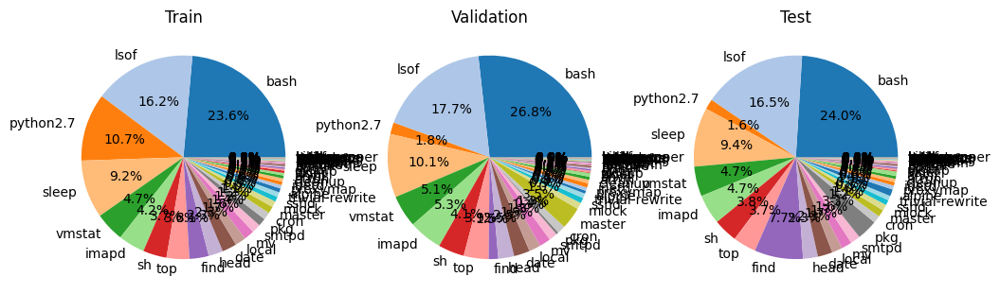

In [10]:
# print distributions in all 3 sets
train_distribution = Counter(y_train)
val_distribution = Counter(y_val)
test_distribution = Counter(y_test)

# plot 3 pie plots, use same colors for same classes
colors = plt.cm.tab20.colors
colors = [ colors[i % 20] for i in range(labels_cardinality) ]

# sort labels by occurence in training set
sorted_labels = sorted(train_distribution, key=train_distribution.get, reverse=True)

# sort all distributions by sorted_labels
train_distribution = [train_distribution[label] for label in sorted_labels]
val_distribution = [val_distribution[label] for label in sorted_labels]
test_distribution = [test_distribution[label] for label in sorted_labels]

# transform labels to names
sorted_labels = [labels_map[label] for label in sorted_labels]

fig, axs = plt.subplots(1, 3, figsize=(30*cm, 10*cm))
axs[0].pie(train_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[0].set_title('Train')
axs[1].pie(val_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[1].set_title('Validation')
axs[2].pie(test_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[2].set_title('Test')
plt.savefig(f'{checkpoint_path}/distributions.png')
plt.show()

In [11]:
# one-hot encode labels
y_train = np.eye(labels_cardinality)[y_train]
y_val = np.eye(labels_cardinality)[y_val]
y_test = np.eye(labels_cardinality)[y_test]

In [12]:
# one-hot encode features
# at this point, X_* are lists of tuples of vectorized features
def encode_features(sequence: np.ndarray) -> np.ndarray:
    # Precompute identity matrices
    event_eye = np.eye(event_types_cardinality)
    username_eye = np.eye(username_cardinality)

    # Initialize the output array with precomputed shapes
    encoded_seq = np.empty((len(sequence), event_eye.shape[1] + username_eye.shape[1]))

    for i, feature_vector in enumerate(sequence):
        event = event_eye[feature_vector[0]]
        username = username_eye[feature_vector[1]]

        # Concatenate all features into a single feature vector
        encoded_seq[i] = np.concatenate((event, username))

    return encoded_seq

X_train = [ encode_features(x) for x in X_train ]
X_val = [ encode_features(x) for x in X_val ]
X_test = [ encode_features(x) for x in X_test ]

In [13]:
feature_vector_cardinality = X_train[0].shape[1]

print(f'Feature vector cardinality: {feature_vector_cardinality}')

Feature vector cardinality: 45


In [14]:
X_train, y_train = shuffle(X_train, y_train)
X_val, y_val = shuffle(X_val, y_val)
X_test, y_test = shuffle(X_test, y_test)

build model

In [15]:
model = Sequential(layers=[
    Input(shape=(None, feature_vector_cardinality)),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=False, dropout=0.1, recurrent_dropout=0.1),
    Dense(labels_cardinality, activation='softmax')
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, None, 128)      │        22,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, None, 128)      │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_2 (SimpleRNN)        │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 67)             │         8,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 96,707 (377.76 KB)

 Trainable params: 96,707 (377.76 KB)

 Non-trainable params: 0 (0.00 B)

In [16]:
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=7,
        verbose=1,
        mode='auto'
    ),
    ModelCheckpoint(
        filepath=model_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=1,
        mode='auto',
        min_lr=1e-7
    ),
    CSVLogger(
        filename=log_path,
        append=True
    )
]

loss = CategoricalCrossentropy()
optimizer = Adam(learning_rate=0.0001)

# class weights
y_train_int = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_int),
    y=y_train_int
)
class_weights_dict = dict(enumerate(class_weights))

metrics = [
    CategoricalAccuracy(name='categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'top_{top_k}_categorical_accuracy'),
]

weighted_metrics = [
    CategoricalAccuracy(name='w_categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'w_top_{top_k}_categorical_accuracy'),
]

# 'categorical_focal_crossentropy'
# 'categorical_crossentropy'
model.compile(
    loss=loss,
    optimizer=optimizer,
    metrics=metrics,
    weighted_metrics=weighted_metrics,
)

train model

In [17]:
history = model.fit(
    x=Generator(X_train, y_train, 64, max_sequence_length),
    validation_data=Generator(X_val, y_val, 64, max_sequence_length),
    epochs=200,
    callbacks=callbacks,
    class_weight=class_weights_dict
)

# save history to file
with open(history_path, 'wb') as f:
    np.save(f, history.history)

Epoch 1/200


I0000 00:00:1723935608.231541 3224581 service.cc:145] XLA service 0x19961cd0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1723935608.231599 3224581 service.cc:153]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 Ti, Compute Capability 7.5


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 16:29:36 15s/step - categorical_accuracy: 0.0312 - loss: 3.7932 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0022 - w_top_3_categorical_accuracy: 0.0197

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 35ms/step - categorical_accuracy: 0.0234 - loss: 3.2677 - top_3_categorical_accuracy: 0.0642 - w_categorical_accuracy: 0.0019 - w_top_3_categorical_accuracy: 0.0171   

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 34ms/step - categorical_accuracy: 0.0189 - loss: 3.0675 - top_3_categorical_accuracy: 0.0557 - w_categorical_accuracy: 0.0017 - w_top_3_categorical_accuracy: 0.0148

I0000 00:00:1723935620.725587 3224581 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 34ms/step - categorical_accuracy: 0.0187 - loss: 3.0402 - top_3_categorical_accuracy: 0.0549 - w_categorical_accuracy: 0.0037 - w_top_3_categorical_accuracy: 0.0179

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 33ms/step - categorical_accuracy: 0.0184 - loss: 3.0249 - top_3_categorical_accuracy: 0.0535 - w_categorical_accuracy: 0.0052 - w_top_3_categorical_accuracy: 0.0205

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 32ms/step - categorical_accuracy: 0.0186 - loss: 3.0049 - top_3_categorical_accuracy: 0.0530 - w_categorical_accuracy: 0.0064 - w_top_3_categorical_accuracy: 0.0224

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0184 - loss: 2.9826 - top_3_categorical_accuracy: 0.0522 - w_categorical_accuracy: 0.0069 - w_top_3_categorical_accuracy: 0.0237

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0185 - loss: 2.9712 - top_3_categorical_accuracy: 0.0519 - w_categorical_accuracy: 0.0076 - w_top_3_categorical_accuracy: 0.0249

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0186 - loss: 2.9536 - top_3_categorical_accuracy: 0.0516 - w_categorical_accuracy: 0.0082 - w_top_3_categorical_accuracy: 0.0265

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0187 - loss: 2.9443 - top_3_categorical_accuracy: 0.0514 - w_categorical_accuracy: 0.0090 - w_top_3_categorical_accuracy: 0.0282

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0189 - loss: 2.9338 - top_3_categorical_accuracy: 0.0512 - w_categorical_accuracy: 0.0102 - w_top_3_categorical_accuracy: 0.0300

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0189 - loss: 2.9196 - top_3_categorical_accuracy: 0.0509 - w_categorical_accuracy: 0.0112 - w_top_3_categorical_accuracy: 0.0314

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0190 - loss: 2.9142 - top_3_categorical_accuracy: 0.0506 - w_categorical_accuracy: 0.0122 - w_top_3_categorical_accuracy: 0.0326

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0190 - loss: 2.9141 - top_3_categorical_accuracy: 0.0504 - w_categorical_accuracy: 0.0132 - w_top_3_categorical_accuracy: 0.0339

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0190 - loss: 2.9219 - top_3_categorical_accuracy: 0.0502 - w_categorical_accuracy: 0.0138 - w_top_3_categorical_accuracy: 0.0350

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.0189 - loss: 2.9276 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0143 - w_top_3_categorical_accuracy: 0.0358

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.0188 - loss: 2.9358 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0147 - w_top_3_categorical_accuracy: 0.0364

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0187 - loss: 2.9463 - top_3_categorical_accuracy: 0.0499 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0373

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0186 - loss: 2.9664 - top_3_categorical_accuracy: 0.0499 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0381

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0185 - loss: 2.9932 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0387

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0184 - loss: 3.0136 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0391

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.0183 - loss: 3.0308 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0395

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0182 - loss: 3.0451 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0398

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0181 - loss: 3.0627 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0400

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0180 - loss: 3.0804 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0400

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.0955 - top_3_categorical_accuracy: 0.0501 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0401

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1075 - top_3_categorical_accuracy: 0.0503 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0403

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1218 - top_3_categorical_accuracy: 0.0504 - w_categorical_accuracy: 0.0149 - w_top_3_categorical_accuracy: 0.0403

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1377 - top_3_categorical_accuracy: 0.0505 - w_categorical_accuracy: 0.0148 - w_top_3_categorical_accuracy: 0.0404

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1506 - top_3_categorical_accuracy: 0.0506 - w_categorical_accuracy: 0.0148 - w_top_3_categorical_accuracy: 0.0405

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1621 - top_3_categorical_accuracy: 0.0507 - w_categorical_accuracy: 0.0148 - w_top_3_categorical_accuracy: 0.0406

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1734 - top_3_categorical_accuracy: 0.0508 - w_categorical_accuracy: 0.0147 - w_top_3_categorical_accuracy: 0.0407

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0179 - loss: 3.1835 - top_3_categorical_accuracy: 0.0509 - w_categorical_accuracy: 0.0147 - w_top_3_categorical_accuracy: 0.0407

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0180 - loss: 3.1935 - top_3_categorical_accuracy: 0.0510 - w_categorical_accuracy: 0.0147 - w_top_3_categorical_accuracy: 0.0408

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0180 - loss: 3.2077 - top_3_categorical_accuracy: 0.0512 - w_categorical_accuracy: 0.0146 - w_top_3_categorical_accuracy: 0.0408

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0180 - loss: 3.2235 - top_3_categorical_accuracy: 0.0513 - w_categorical_accuracy: 0.0146 - w_top_3_categorical_accuracy: 0.0407

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0180 - loss: 3.2386 - top_3_categorical_accuracy: 0.0514 - w_categorical_accuracy: 0.0145 - w_top_3_categorical_accuracy: 0.0406

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0180 - loss: 3.2524 - top_3_categorical_accuracy: 0.0515 - w_categorical_accuracy: 0.0145 - w_top_3_categorical_accuracy: 0.0406

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0181 - loss: 3.2664 - top_3_categorical_accuracy: 0.0516 - w_categorical_accuracy: 0.0144 - w_top_3_categorical_accuracy: 0.0405

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0181 - loss: 3.2824 - top_3_categorical_accuracy: 0.0517 - w_categorical_accuracy: 0.0143 - w_top_3_categorical_accuracy: 0.0404

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0181 - loss: 3.2981 - top_3_categorical_accuracy: 0.0518 - w_categorical_accuracy: 0.0143 - w_top_3_categorical_accuracy: 0.0403

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0182 - loss: 3.3137 - top_3_categorical_accuracy: 0.0518 - w_categorical_accuracy: 0.0142 - w_top_3_categorical_accuracy: 0.0402

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0182 - loss: 3.3280 - top_3_categorical_accuracy: 0.0519 - w_categorical_accuracy: 0.0141 - w_top_3_categorical_accuracy: 0.0401

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0182 - loss: 3.3415 - top_3_categorical_accuracy: 0.0519 - w_categorical_accuracy: 0.0141 - w_top_3_categorical_accuracy: 0.0399

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0183 - loss: 3.3545 - top_3_categorical_accuracy: 0.0520 - w_categorical_accuracy: 0.0140 - w_top_3_categorical_accuracy: 0.0398

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0183 - loss: 3.3667 - top_3_categorical_accuracy: 0.0520 - w_categorical_accuracy: 0.0139 - w_top_3_categorical_accuracy: 0.0397

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0183 - loss: 3.3782 - top_3_categorical_accuracy: 0.0521 - w_categorical_accuracy: 0.0139 - w_top_3_categorical_accuracy: 0.0396

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0183 - loss: 3.3892 - top_3_categorical_accuracy: 0.0521 - w_categorical_accuracy: 0.0138 - w_top_3_categorical_accuracy: 0.0395

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0184 - loss: 3.3995 - top_3_categorical_accuracy: 0.0522 - w_categorical_accuracy: 0.0138 - w_top_3_categorical_accuracy: 0.0394

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0184 - loss: 3.4090 - top_3_categorical_accuracy: 0.0523 - w_categorical_accuracy: 0.0137 - w_top_3_categorical_accuracy: 0.0393

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0185 - loss: 3.4182 - top_3_categorical_accuracy: 0.0523 - w_categorical_accuracy: 0.0137 - w_top_3_categorical_accuracy: 0.0392

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0185 - loss: 3.4265 - top_3_categorical_accuracy: 0.0524 - w_categorical_accuracy: 0.0137 - w_top_3_categorical_accuracy: 0.0391

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0186 - loss: 3.4342 - top_3_categorical_accuracy: 0.0524 - w_categorical_accuracy: 0.0136 - w_top_3_categorical_accuracy: 0.0391

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0186 - loss: 3.4414 - top_3_categorical_accuracy: 0.0524 - w_categorical_accuracy: 0.0136 - w_top_3_categorical_accuracy: 0.0390

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0187 - loss: 3.4476 - top_3_categorical_accuracy: 0.0525 - w_categorical_accuracy: 0.0136 - w_top_3_categorical_accuracy: 0.0390

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0187 - loss: 3.4533 - top_3_categorical_accuracy: 0.0525 - w_categorical_accuracy: 0.0136 - w_top_3_categorical_accuracy: 0.0389

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0188 - loss: 3.4585 - top_3_categorical_accuracy: 0.0526 - w_categorical_accuracy: 0.0136 - w_top_3_categorical_accuracy: 0.0389

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0188 - loss: 3.4635 - top_3_categorical_accuracy: 0.0526 - w_categorical_accuracy: 0.0137 - w_top_3_categorical_accuracy: 0.0390

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0189 - loss: 3.4682 - top_3_categorical_accuracy: 0.0527 - w_categorical_accuracy: 0.0139 - w_top_3_categorical_accuracy: 0.0392

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0189 - loss: 3.4736 - top_3_categorical_accuracy: 0.0528 - w_categorical_accuracy: 0.0140 - w_top_3_categorical_accuracy: 0.0394

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0190 - loss: 3.4788 - top_3_categorical_accuracy: 0.0528 - w_categorical_accuracy: 0.0142 - w_top_3_categorical_accuracy: 0.0395

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0190 - loss: 3.4859 - top_3_categorical_accuracy: 0.0529 - w_categorical_accuracy: 0.0143 - w_top_3_categorical_accuracy: 0.0396

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0191 - loss: 3.4953 - top_3_categorical_accuracy: 0.0530 - w_categorical_accuracy: 0.0144 - w_top_3_categorical_accuracy: 0.0397

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0191 - loss: 3.5040 - top_3_categorical_accuracy: 0.0530 - w_categorical_accuracy: 0.0146 - w_top_3_categorical_accuracy: 0.0397

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0192 - loss: 3.5122 - top_3_categorical_accuracy: 0.0531 - w_categorical_accuracy: 0.0147 - w_top_3_categorical_accuracy: 0.0398

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0192 - loss: 3.5201 - top_3_categorical_accuracy: 0.0532 - w_categorical_accuracy: 0.0148 - w_top_3_categorical_accuracy: 0.0399

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0193 - loss: 3.5276 - top_3_categorical_accuracy: 0.0533 - w_categorical_accuracy: 0.0149 - w_top_3_categorical_accuracy: 0.0399

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0193 - loss: 3.5362 - top_3_categorical_accuracy: 0.0533 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0400

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0194 - loss: 3.5457 - top_3_categorical_accuracy: 0.0534 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0401

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0194 - loss: 3.5549 - top_3_categorical_accuracy: 0.0535 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0401

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0195 - loss: 3.5636 - top_3_categorical_accuracy: 0.0536 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0402

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0195 - loss: 3.5726 - top_3_categorical_accuracy: 0.0537 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0402

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0196 - loss: 3.5815 - top_3_categorical_accuracy: 0.0537 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0402

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0196 - loss: 3.5898 - top_3_categorical_accuracy: 0.0538 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0403

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0197 - loss: 3.5980 - top_3_categorical_accuracy: 0.0539 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0403

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0197 - loss: 3.6057 - top_3_categorical_accuracy: 0.0540 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0404

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0198 - loss: 3.6139 - top_3_categorical_accuracy: 0.0540 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0404

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0198 - loss: 3.6216 - top_3_categorical_accuracy: 0.0541 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0405

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0198 - loss: 3.6292 - top_3_categorical_accuracy: 0.0542 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0405

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0199 - loss: 3.6363 - top_3_categorical_accuracy: 0.0542 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0406

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0199 - loss: 3.6430 - top_3_categorical_accuracy: 0.0543 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0406

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0199 - loss: 3.6492 - top_3_categorical_accuracy: 0.0544 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0407

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0200 - loss: 3.6550 - top_3_categorical_accuracy: 0.0545 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0407

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0200 - loss: 3.6607 - top_3_categorical_accuracy: 0.0545 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0408

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0200 - loss: 3.6659 - top_3_categorical_accuracy: 0.0546 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0408

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0200 - loss: 3.6707 - top_3_categorical_accuracy: 0.0547 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0408

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0201 - loss: 3.6753 - top_3_categorical_accuracy: 0.0547 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0409

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0201 - loss: 3.6816 - top_3_categorical_accuracy: 0.0548 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0409

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0201 - loss: 3.6881 - top_3_categorical_accuracy: 0.0549 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0409

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0202 - loss: 3.6945 - top_3_categorical_accuracy: 0.0550 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0409

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0202 - loss: 3.7005 - top_3_categorical_accuracy: 0.0550 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0409

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0202 - loss: 3.7065 - top_3_categorical_accuracy: 0.0551 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0409

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0203 - loss: 3.7124 - top_3_categorical_accuracy: 0.0552 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0409

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0203 - loss: 3.7180 - top_3_categorical_accuracy: 0.0553 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0409

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0203 - loss: 3.7238 - top_3_categorical_accuracy: 0.0554 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0410

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0204 - loss: 3.7293 - top_3_categorical_accuracy: 0.0554 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0410

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0204 - loss: 3.7349 - top_3_categorical_accuracy: 0.0555 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0410

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0205 - loss: 3.7406 - top_3_categorical_accuracy: 0.0556 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0410

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0205 - loss: 3.7460 - top_3_categorical_accuracy: 0.0557 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0410

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0205 - loss: 3.7511 - top_3_categorical_accuracy: 0.0558 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0410

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0206 - loss: 3.7558 - top_3_categorical_accuracy: 0.0558 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0410

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0206 - loss: 3.7602 - top_3_categorical_accuracy: 0.0559 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0411

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0206 - loss: 3.7643 - top_3_categorical_accuracy: 0.0560 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0411

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0207 - loss: 3.7682 - top_3_categorical_accuracy: 0.0561 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0411

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0207 - loss: 3.7718 - top_3_categorical_accuracy: 0.0562 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0411

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0208 - loss: 3.7757 - top_3_categorical_accuracy: 0.0563 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0411

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0208 - loss: 3.7794 - top_3_categorical_accuracy: 0.0563 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0412

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0208 - loss: 3.7829 - top_3_categorical_accuracy: 0.0564 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0412

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0209 - loss: 3.7877 - top_3_categorical_accuracy: 0.0565 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0412

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0209 - loss: 3.7928 - top_3_categorical_accuracy: 0.0566 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0412

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0210 - loss: 3.7978 - top_3_categorical_accuracy: 0.0567 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0412

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0210 - loss: 3.8027 - top_3_categorical_accuracy: 0.0568 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0412

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0210 - loss: 3.8078 - top_3_categorical_accuracy: 0.0569 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0412

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0211 - loss: 3.8125 - top_3_categorical_accuracy: 0.0569 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0412

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0211 - loss: 3.8171 - top_3_categorical_accuracy: 0.0570 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0412

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0211 - loss: 3.8217 - top_3_categorical_accuracy: 0.0571 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0412

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0212 - loss: 3.8261 - top_3_categorical_accuracy: 0.0572 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0413

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0212 - loss: 3.8303 - top_3_categorical_accuracy: 0.0573 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0413

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0213 - loss: 3.8344 - top_3_categorical_accuracy: 0.0574 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0413

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0213 - loss: 3.8384 - top_3_categorical_accuracy: 0.0575 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0413

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0213 - loss: 3.8423 - top_3_categorical_accuracy: 0.0575 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0413

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0214 - loss: 3.8461 - top_3_categorical_accuracy: 0.0576 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0413

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0214 - loss: 3.8498 - top_3_categorical_accuracy: 0.0577 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0413

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0214 - loss: 3.8534 - top_3_categorical_accuracy: 0.0578 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0413

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0215 - loss: 3.8568 - top_3_categorical_accuracy: 0.0579 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0413

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0215 - loss: 3.8611 - top_3_categorical_accuracy: 0.0580 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0413

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0216 - loss: 3.8652 - top_3_categorical_accuracy: 0.0580 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0413

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0216 - loss: 3.8692 - top_3_categorical_accuracy: 0.0581 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0414

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0216 - loss: 3.8729 - top_3_categorical_accuracy: 0.0582 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0414

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0217 - loss: 3.8769 - top_3_categorical_accuracy: 0.0583 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0414

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0217 - loss: 3.8813 - top_3_categorical_accuracy: 0.0583 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0414

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0217 - loss: 3.8855 - top_3_categorical_accuracy: 0.0584 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0415

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0217 - loss: 3.8899 - top_3_categorical_accuracy: 0.0585 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0415

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0218 - loss: 3.8941 - top_3_categorical_accuracy: 0.0586 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0415

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0218 - loss: 3.8982 - top_3_categorical_accuracy: 0.0586 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0415

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0218 - loss: 3.9022 - top_3_categorical_accuracy: 0.0587 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0416

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0219 - loss: 3.9059 - top_3_categorical_accuracy: 0.0588 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0416

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0219 - loss: 3.9096 - top_3_categorical_accuracy: 0.0588 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0416

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0219 - loss: 3.9132 - top_3_categorical_accuracy: 0.0589 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0416

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0219 - loss: 3.9165 - top_3_categorical_accuracy: 0.0590 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0416

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 4:03 68ms/step - categorical_accuracy: 0.0220 - loss: 3.9198 - top_3_categorical_accuracy: 0.0590 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0417

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 4:02 68ms/step - categorical_accuracy: 0.0220 - loss: 3.9229 - top_3_categorical_accuracy: 0.0591 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0417

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 4:01 68ms/step - categorical_accuracy: 0.0220 - loss: 3.9259 - top_3_categorical_accuracy: 0.0592 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0417

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 4:00 67ms/step - categorical_accuracy: 0.0220 - loss: 3.9288 - top_3_categorical_accuracy: 0.0592 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0417

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 3:59 67ms/step - categorical_accuracy: 0.0221 - loss: 3.9315 - top_3_categorical_accuracy: 0.0593 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0417

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 3:58 67ms/step - categorical_accuracy: 0.0221 - loss: 3.9341 - top_3_categorical_accuracy: 0.0593 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0418

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 3:57 67ms/step - categorical_accuracy: 0.0221 - loss: 3.9370 - top_3_categorical_accuracy: 0.0594 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0418

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 3:56 66ms/step - categorical_accuracy: 0.0221 - loss: 3.9396 - top_3_categorical_accuracy: 0.0595 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0418

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 3:55 66ms/step - categorical_accuracy: 0.0222 - loss: 3.9421 - top_3_categorical_accuracy: 0.0595 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0418

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 3:54 66ms/step - categorical_accuracy: 0.0222 - loss: 3.9450 - top_3_categorical_accuracy: 0.0596 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0418

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 3:53 66ms/step - categorical_accuracy: 0.0222 - loss: 3.9480 - top_3_categorical_accuracy: 0.0596 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0418

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 3:52 65ms/step - categorical_accuracy: 0.0222 - loss: 3.9514 - top_3_categorical_accuracy: 0.0597 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0418

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 3:51 65ms/step - categorical_accuracy: 0.0222 - loss: 3.9546 - top_3_categorical_accuracy: 0.0597 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0418

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 3:50 65ms/step - categorical_accuracy: 0.0223 - loss: 3.9577 - top_3_categorical_accuracy: 0.0598 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0418

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 3:49 65ms/step - categorical_accuracy: 0.0223 - loss: 3.9608 - top_3_categorical_accuracy: 0.0598 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 3:48 64ms/step - categorical_accuracy: 0.0223 - loss: 3.9638 - top_3_categorical_accuracy: 0.0599 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 3:48 64ms/step - categorical_accuracy: 0.0223 - loss: 3.9668 - top_3_categorical_accuracy: 0.0600 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 3:47 64ms/step - categorical_accuracy: 0.0224 - loss: 3.9699 - top_3_categorical_accuracy: 0.0600 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 3:46 64ms/step - categorical_accuracy: 0.0224 - loss: 3.9729 - top_3_categorical_accuracy: 0.0601 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 3:45 64ms/step - categorical_accuracy: 0.0224 - loss: 3.9762 - top_3_categorical_accuracy: 0.0601 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 3:44 63ms/step - categorical_accuracy: 0.0224 - loss: 3.9795 - top_3_categorical_accuracy: 0.0602 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 3:43 63ms/step - categorical_accuracy: 0.0224 - loss: 3.9827 - top_3_categorical_accuracy: 0.0602 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 3:42 63ms/step - categorical_accuracy: 0.0225 - loss: 3.9857 - top_3_categorical_accuracy: 0.0603 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0419

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 3:42 63ms/step - categorical_accuracy: 0.0225 - loss: 3.9887 - top_3_categorical_accuracy: 0.0604 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0420

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 3:41 63ms/step - categorical_accuracy: 0.0225 - loss: 3.9916 - top_3_categorical_accuracy: 0.0604 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0420

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 3:40 62ms/step - categorical_accuracy: 0.0225 - loss: 3.9945 - top_3_categorical_accuracy: 0.0605 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0420

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 3:39 62ms/step - categorical_accuracy: 0.0226 - loss: 3.9974 - top_3_categorical_accuracy: 0.0605 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0420

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 3:38 62ms/step - categorical_accuracy: 0.0226 - loss: 4.0002 - top_3_categorical_accuracy: 0.0606 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0421

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 3:38 62ms/step - categorical_accuracy: 0.0226 - loss: 4.0032 - top_3_categorical_accuracy: 0.0607 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0421

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 3:37 62ms/step - categorical_accuracy: 0.0226 - loss: 4.0061 - top_3_categorical_accuracy: 0.0607 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0421

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 3:36 61ms/step - categorical_accuracy: 0.0227 - loss: 4.0089 - top_3_categorical_accuracy: 0.0608 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0422

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 3:35 61ms/step - categorical_accuracy: 0.0227 - loss: 4.0115 - top_3_categorical_accuracy: 0.0609 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0422

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 3:35 61ms/step - categorical_accuracy: 0.0227 - loss: 4.0141 - top_3_categorical_accuracy: 0.0609 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0422

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 3:34 61ms/step - categorical_accuracy: 0.0227 - loss: 4.0165 - top_3_categorical_accuracy: 0.0610 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0423

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 3:33 61ms/step - categorical_accuracy: 0.0228 - loss: 4.0189 - top_3_categorical_accuracy: 0.0610 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0423

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 3:32 61ms/step - categorical_accuracy: 0.0228 - loss: 4.0213 - top_3_categorical_accuracy: 0.0611 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0423

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 3:32 60ms/step - categorical_accuracy: 0.0228 - loss: 4.0236 - top_3_categorical_accuracy: 0.0612 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0424

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 3:31 60ms/step - categorical_accuracy: 0.0228 - loss: 4.0257 - top_3_categorical_accuracy: 0.0612 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0424

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 3:30 60ms/step - categorical_accuracy: 0.0229 - loss: 4.0278 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0425

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 3:30 60ms/step - categorical_accuracy: 0.0229 - loss: 4.0298 - top_3_categorical_accuracy: 0.0614 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0425

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 3:29 60ms/step - categorical_accuracy: 0.0229 - loss: 4.0316 - top_3_categorical_accuracy: 0.0614 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0425

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 3:28 60ms/step - categorical_accuracy: 0.0229 - loss: 4.0334 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0426

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 3:28 59ms/step - categorical_accuracy: 0.0230 - loss: 4.0352 - top_3_categorical_accuracy: 0.0616 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0426

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 3:27 59ms/step - categorical_accuracy: 0.0230 - loss: 4.0368 - top_3_categorical_accuracy: 0.0616 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0426

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 3:26 59ms/step - categorical_accuracy: 0.0230 - loss: 4.0384 - top_3_categorical_accuracy: 0.0617 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0427

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 3:26 59ms/step - categorical_accuracy: 0.0231 - loss: 4.0399 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0427

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 3:25 59ms/step - categorical_accuracy: 0.0231 - loss: 4.0413 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0428

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 3:24 59ms/step - categorical_accuracy: 0.0231 - loss: 4.0432 - top_3_categorical_accuracy: 0.0619 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0428

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 3:24 59ms/step - categorical_accuracy: 0.0231 - loss: 4.0451 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0429

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 3:23 58ms/step - categorical_accuracy: 0.0232 - loss: 4.0470 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0429

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 3:22 58ms/step - categorical_accuracy: 0.0232 - loss: 4.0488 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0429

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 3:22 58ms/step - categorical_accuracy: 0.0232 - loss: 4.0505 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0430

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 3:21 58ms/step - categorical_accuracy: 0.0233 - loss: 4.0521 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0430

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 3:21 58ms/step - categorical_accuracy: 0.0233 - loss: 4.0538 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0431

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 3:20 58ms/step - categorical_accuracy: 0.0233 - loss: 4.0556 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0431

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 3:19 58ms/step - categorical_accuracy: 0.0233 - loss: 4.0573 - top_3_categorical_accuracy: 0.0624 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0431

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 3:19 57ms/step - categorical_accuracy: 0.0234 - loss: 4.0590 - top_3_categorical_accuracy: 0.0625 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0432

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 3:18 57ms/step - categorical_accuracy: 0.0234 - loss: 4.0607 - top_3_categorical_accuracy: 0.0625 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0432

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 3:18 57ms/step - categorical_accuracy: 0.0234 - loss: 4.0624 - top_3_categorical_accuracy: 0.0626 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0432

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 3:17 57ms/step - categorical_accuracy: 0.0235 - loss: 4.0641 - top_3_categorical_accuracy: 0.0627 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0433

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 3:16 57ms/step - categorical_accuracy: 0.0235 - loss: 4.0656 - top_3_categorical_accuracy: 0.0628 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0433

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 3:16 57ms/step - categorical_accuracy: 0.0235 - loss: 4.0672 - top_3_categorical_accuracy: 0.0628 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0434

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 3:15 57ms/step - categorical_accuracy: 0.0236 - loss: 4.0687 - top_3_categorical_accuracy: 0.0629 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0434

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 3:15 57ms/step - categorical_accuracy: 0.0236 - loss: 4.0702 - top_3_categorical_accuracy: 0.0630 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0434

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 3:14 56ms/step - categorical_accuracy: 0.0236 - loss: 4.0717 - top_3_categorical_accuracy: 0.0630 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0435

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 3:14 56ms/step - categorical_accuracy: 0.0237 - loss: 4.0736 - top_3_categorical_accuracy: 0.0631 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0435

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 3:13 56ms/step - categorical_accuracy: 0.0237 - loss: 4.0754 - top_3_categorical_accuracy: 0.0632 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0435

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 3:13 56ms/step - categorical_accuracy: 0.0237 - loss: 4.0773 - top_3_categorical_accuracy: 0.0632 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0435

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 3:12 56ms/step - categorical_accuracy: 0.0237 - loss: 4.0791 - top_3_categorical_accuracy: 0.0633 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0436

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 3:12 56ms/step - categorical_accuracy: 0.0238 - loss: 4.0810 - top_3_categorical_accuracy: 0.0633 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0436

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 3:11 56ms/step - categorical_accuracy: 0.0238 - loss: 4.0827 - top_3_categorical_accuracy: 0.0634 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0436

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 3:11 56ms/step - categorical_accuracy: 0.0238 - loss: 4.0845 - top_3_categorical_accuracy: 0.0635 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0437

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 3:10 55ms/step - categorical_accuracy: 0.0239 - loss: 4.0863 - top_3_categorical_accuracy: 0.0635 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0437

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 3:10 55ms/step - categorical_accuracy: 0.0239 - loss: 4.0880 - top_3_categorical_accuracy: 0.0636 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0437

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 3:09 55ms/step - categorical_accuracy: 0.0239 - loss: 4.0897 - top_3_categorical_accuracy: 0.0637 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0437

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 3:09 55ms/step - categorical_accuracy: 0.0239 - loss: 4.0914 - top_3_categorical_accuracy: 0.0637 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0438

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 3:08 55ms/step - categorical_accuracy: 0.0240 - loss: 4.0930 - top_3_categorical_accuracy: 0.0638 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0438

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 3:08 55ms/step - categorical_accuracy: 0.0240 - loss: 4.0945 - top_3_categorical_accuracy: 0.0638 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0438

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 3:07 55ms/step - categorical_accuracy: 0.0240 - loss: 4.0959 - top_3_categorical_accuracy: 0.0639 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0438

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 3:07 55ms/step - categorical_accuracy: 0.0241 - loss: 4.0975 - top_3_categorical_accuracy: 0.0640 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0438

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 3:06 55ms/step - categorical_accuracy: 0.0241 - loss: 4.0991 - top_3_categorical_accuracy: 0.0640 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0439

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 3:06 54ms/step - categorical_accuracy: 0.0241 - loss: 4.1006 - top_3_categorical_accuracy: 0.0641 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0439

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 3:05 54ms/step - categorical_accuracy: 0.0241 - loss: 4.1020 - top_3_categorical_accuracy: 0.0641 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0439

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 3:05 54ms/step - categorical_accuracy: 0.0242 - loss: 4.1034 - top_3_categorical_accuracy: 0.0642 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0439

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 3:04 54ms/step - categorical_accuracy: 0.0242 - loss: 4.1047 - top_3_categorical_accuracy: 0.0643 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0440

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 3:04 54ms/step - categorical_accuracy: 0.0242 - loss: 4.1060 - top_3_categorical_accuracy: 0.0643 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0440

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 3:03 54ms/step - categorical_accuracy: 0.0242 - loss: 4.1072 - top_3_categorical_accuracy: 0.0644 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0440

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 3:03 54ms/step - categorical_accuracy: 0.0243 - loss: 4.1084 - top_3_categorical_accuracy: 0.0644 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0440

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 3:02 54ms/step - categorical_accuracy: 0.0243 - loss: 4.1096 - top_3_categorical_accuracy: 0.0645 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0440

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 3:02 54ms/step - categorical_accuracy: 0.0243 - loss: 4.1108 - top_3_categorical_accuracy: 0.0645 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 3:02 54ms/step - categorical_accuracy: 0.0243 - loss: 4.1119 - top_3_categorical_accuracy: 0.0646 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 3:01 53ms/step - categorical_accuracy: 0.0244 - loss: 4.1131 - top_3_categorical_accuracy: 0.0647 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 3:01 53ms/step - categorical_accuracy: 0.0244 - loss: 4.1143 - top_3_categorical_accuracy: 0.0647 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 3:00 53ms/step - categorical_accuracy: 0.0244 - loss: 4.1156 - top_3_categorical_accuracy: 0.0648 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 3:00 53ms/step - categorical_accuracy: 0.0244 - loss: 4.1170 - top_3_categorical_accuracy: 0.0648 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0441

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 2:59 53ms/step - categorical_accuracy: 0.0245 - loss: 4.1183 - top_3_categorical_accuracy: 0.0649 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 2:59 53ms/step - categorical_accuracy: 0.0245 - loss: 4.1197 - top_3_categorical_accuracy: 0.0649 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 2:59 53ms/step - categorical_accuracy: 0.0245 - loss: 4.1209 - top_3_categorical_accuracy: 0.0650 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 2:58 53ms/step - categorical_accuracy: 0.0245 - loss: 4.1222 - top_3_categorical_accuracy: 0.0651 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 2:58 53ms/step - categorical_accuracy: 0.0246 - loss: 4.1237 - top_3_categorical_accuracy: 0.0651 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 2:57 53ms/step - categorical_accuracy: 0.0246 - loss: 4.1253 - top_3_categorical_accuracy: 0.0652 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 2:57 52ms/step - categorical_accuracy: 0.0246 - loss: 4.1268 - top_3_categorical_accuracy: 0.0652 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0442

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 2:56 52ms/step - categorical_accuracy: 0.0246 - loss: 4.1283 - top_3_categorical_accuracy: 0.0653 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 2:56 52ms/step - categorical_accuracy: 0.0247 - loss: 4.1297 - top_3_categorical_accuracy: 0.0653 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 2:56 52ms/step - categorical_accuracy: 0.0247 - loss: 4.1310 - top_3_categorical_accuracy: 0.0654 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 2:55 52ms/step - categorical_accuracy: 0.0247 - loss: 4.1324 - top_3_categorical_accuracy: 0.0655 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 2:55 52ms/step - categorical_accuracy: 0.0247 - loss: 4.1337 - top_3_categorical_accuracy: 0.0655 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 2:54 52ms/step - categorical_accuracy: 0.0248 - loss: 4.1349 - top_3_categorical_accuracy: 0.0656 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 2:54 52ms/step - categorical_accuracy: 0.0248 - loss: 4.1362 - top_3_categorical_accuracy: 0.0656 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 2:54 52ms/step - categorical_accuracy: 0.0248 - loss: 4.1373 - top_3_categorical_accuracy: 0.0657 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0443

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 2:53 52ms/step - categorical_accuracy: 0.0248 - loss: 4.1385 - top_3_categorical_accuracy: 0.0657 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 2:53 52ms/step - categorical_accuracy: 0.0248 - loss: 4.1396 - top_3_categorical_accuracy: 0.0658 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 2:52 51ms/step - categorical_accuracy: 0.0249 - loss: 4.1407 - top_3_categorical_accuracy: 0.0658 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 2:52 51ms/step - categorical_accuracy: 0.0249 - loss: 4.1417 - top_3_categorical_accuracy: 0.0659 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 2:52 51ms/step - categorical_accuracy: 0.0249 - loss: 4.1426 - top_3_categorical_accuracy: 0.0659 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0249 - loss: 4.1436 - top_3_categorical_accuracy: 0.0660 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0250 - loss: 4.1446 - top_3_categorical_accuracy: 0.0661 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0444

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0250 - loss: 4.1455 - top_3_categorical_accuracy: 0.0661 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 2:50 51ms/step - categorical_accuracy: 0.0250 - loss: 4.1465 - top_3_categorical_accuracy: 0.0662 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 2:50 51ms/step - categorical_accuracy: 0.0250 - loss: 4.1474 - top_3_categorical_accuracy: 0.0662 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 51ms/step - categorical_accuracy: 0.0250 - loss: 4.1483 - top_3_categorical_accuracy: 0.0663 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 51ms/step - categorical_accuracy: 0.0251 - loss: 4.1492 - top_3_categorical_accuracy: 0.0663 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 51ms/step - categorical_accuracy: 0.0251 - loss: 4.1500 - top_3_categorical_accuracy: 0.0664 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 51ms/step - categorical_accuracy: 0.0251 - loss: 4.1508 - top_3_categorical_accuracy: 0.0665 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0445

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 51ms/step - categorical_accuracy: 0.0251 - loss: 4.1515 - top_3_categorical_accuracy: 0.0665 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 50ms/step - categorical_accuracy: 0.0252 - loss: 4.1523 - top_3_categorical_accuracy: 0.0666 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0252 - loss: 4.1530 - top_3_categorical_accuracy: 0.0666 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0252 - loss: 4.1537 - top_3_categorical_accuracy: 0.0667 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0252 - loss: 4.1543 - top_3_categorical_accuracy: 0.0667 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 2:46 50ms/step - categorical_accuracy: 0.0252 - loss: 4.1550 - top_3_categorical_accuracy: 0.0668 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 2:46 50ms/step - categorical_accuracy: 0.0253 - loss: 4.1557 - top_3_categorical_accuracy: 0.0669 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0446

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 2:46 50ms/step - categorical_accuracy: 0.0253 - loss: 4.1564 - top_3_categorical_accuracy: 0.0669 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0253 - loss: 4.1571 - top_3_categorical_accuracy: 0.0670 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0253 - loss: 4.1580 - top_3_categorical_accuracy: 0.0670 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0254 - loss: 4.1589 - top_3_categorical_accuracy: 0.0671 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 50ms/step - categorical_accuracy: 0.0254 - loss: 4.1598 - top_3_categorical_accuracy: 0.0672 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 50ms/step - categorical_accuracy: 0.0254 - loss: 4.1607 - top_3_categorical_accuracy: 0.0672 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 50ms/step - categorical_accuracy: 0.0254 - loss: 4.1616 - top_3_categorical_accuracy: 0.0673 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 50ms/step - categorical_accuracy: 0.0255 - loss: 4.1625 - top_3_categorical_accuracy: 0.0673 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0447

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 49ms/step - categorical_accuracy: 0.0255 - loss: 4.1634 - top_3_categorical_accuracy: 0.0674 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 49ms/step - categorical_accuracy: 0.0255 - loss: 4.1643 - top_3_categorical_accuracy: 0.0675 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0255 - loss: 4.1652 - top_3_categorical_accuracy: 0.0675 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0256 - loss: 4.1660 - top_3_categorical_accuracy: 0.0676 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0256 - loss: 4.1668 - top_3_categorical_accuracy: 0.0677 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0256 - loss: 4.1676 - top_3_categorical_accuracy: 0.0677 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0257 - loss: 4.1684 - top_3_categorical_accuracy: 0.0678 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0257 - loss: 4.1692 - top_3_categorical_accuracy: 0.0678 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 49ms/step - categorical_accuracy: 0.0257 - loss: 4.1699 - top_3_categorical_accuracy: 0.0679 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0448

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 49ms/step - categorical_accuracy: 0.0257 - loss: 4.1707 - top_3_categorical_accuracy: 0.0680 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 49ms/step - categorical_accuracy: 0.0258 - loss: 4.1714 - top_3_categorical_accuracy: 0.0680 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 49ms/step - categorical_accuracy: 0.0258 - loss: 4.1722 - top_3_categorical_accuracy: 0.0681 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 49ms/step - categorical_accuracy: 0.0258 - loss: 4.1730 - top_3_categorical_accuracy: 0.0682 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 49ms/step - categorical_accuracy: 0.0258 - loss: 4.1737 - top_3_categorical_accuracy: 0.0682 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 49ms/step - categorical_accuracy: 0.0259 - loss: 4.1744 - top_3_categorical_accuracy: 0.0683 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 49ms/step - categorical_accuracy: 0.0259 - loss: 4.1753 - top_3_categorical_accuracy: 0.0684 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0259 - loss: 4.1762 - top_3_categorical_accuracy: 0.0684 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0260 - loss: 4.1770 - top_3_categorical_accuracy: 0.0685 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0449

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0260 - loss: 4.1779 - top_3_categorical_accuracy: 0.0686 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0260 - loss: 4.1787 - top_3_categorical_accuracy: 0.0686 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0260 - loss: 4.1795 - top_3_categorical_accuracy: 0.0687 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0261 - loss: 4.1803 - top_3_categorical_accuracy: 0.0688 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0261 - loss: 4.1810 - top_3_categorical_accuracy: 0.0688 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0261 - loss: 4.1817 - top_3_categorical_accuracy: 0.0689 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0262 - loss: 4.1824 - top_3_categorical_accuracy: 0.0689 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0262 - loss: 4.1831 - top_3_categorical_accuracy: 0.0690 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 48ms/step - categorical_accuracy: 0.0262 - loss: 4.1839 - top_3_categorical_accuracy: 0.0691 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 48ms/step - categorical_accuracy: 0.0262 - loss: 4.1847 - top_3_categorical_accuracy: 0.0691 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0450

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 48ms/step - categorical_accuracy: 0.0263 - loss: 4.1854 - top_3_categorical_accuracy: 0.0692 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0451

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 48ms/step - categorical_accuracy: 0.0263 - loss: 4.1861 - top_3_categorical_accuracy: 0.0693 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0451

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 48ms/step - categorical_accuracy: 0.0263 - loss: 4.1868 - top_3_categorical_accuracy: 0.0693 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0451

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 48ms/step - categorical_accuracy: 0.0263 - loss: 4.1875 - top_3_categorical_accuracy: 0.0694 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0451

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 48ms/step - categorical_accuracy: 0.0264 - loss: 4.1881 - top_3_categorical_accuracy: 0.0695 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0451

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0264 - loss: 4.1888 - top_3_categorical_accuracy: 0.0695 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0451

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0264 - loss: 4.1894 - top_3_categorical_accuracy: 0.0696 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0451

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0265 - loss: 4.1901 - top_3_categorical_accuracy: 0.0696 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0451

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0265 - loss: 4.1908 - top_3_categorical_accuracy: 0.0697 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0265 - loss: 4.1915 - top_3_categorical_accuracy: 0.0698 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0265 - loss: 4.1923 - top_3_categorical_accuracy: 0.0698 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0266 - loss: 4.1931 - top_3_categorical_accuracy: 0.0699 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0266 - loss: 4.1939 - top_3_categorical_accuracy: 0.0700 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0266 - loss: 4.1947 - top_3_categorical_accuracy: 0.0700 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0267 - loss: 4.1956 - top_3_categorical_accuracy: 0.0701 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0452

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0267 - loss: 4.1964 - top_3_categorical_accuracy: 0.0701 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 47ms/step - categorical_accuracy: 0.0267 - loss: 4.1971 - top_3_categorical_accuracy: 0.0702 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 47ms/step - categorical_accuracy: 0.0268 - loss: 4.1979 - top_3_categorical_accuracy: 0.0703 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 47ms/step - categorical_accuracy: 0.0268 - loss: 4.1986 - top_3_categorical_accuracy: 0.0703 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 47ms/step - categorical_accuracy: 0.0268 - loss: 4.1994 - top_3_categorical_accuracy: 0.0704 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 47ms/step - categorical_accuracy: 0.0268 - loss: 4.2002 - top_3_categorical_accuracy: 0.0705 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0453

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 47ms/step - categorical_accuracy: 0.0269 - loss: 4.2009 - top_3_categorical_accuracy: 0.0705 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0454

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 47ms/step - categorical_accuracy: 0.0269 - loss: 4.2016 - top_3_categorical_accuracy: 0.0706 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0454

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 47ms/step - categorical_accuracy: 0.0269 - loss: 4.2023 - top_3_categorical_accuracy: 0.0706 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0454

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 47ms/step - categorical_accuracy: 0.0270 - loss: 4.2029 - top_3_categorical_accuracy: 0.0707 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0454

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0270 - loss: 4.2036 - top_3_categorical_accuracy: 0.0708 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0454

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0270 - loss: 4.2042 - top_3_categorical_accuracy: 0.0708 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0455

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0271 - loss: 4.2048 - top_3_categorical_accuracy: 0.0709 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0455

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0271 - loss: 4.2055 - top_3_categorical_accuracy: 0.0709 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0455

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0271 - loss: 4.2061 - top_3_categorical_accuracy: 0.0710 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0455

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0271 - loss: 4.2068 - top_3_categorical_accuracy: 0.0711 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0455

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0272 - loss: 4.2074 - top_3_categorical_accuracy: 0.0711 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0456

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0272 - loss: 4.2080 - top_3_categorical_accuracy: 0.0712 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0456

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0272 - loss: 4.2086 - top_3_categorical_accuracy: 0.0713 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0456

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0273 - loss: 4.2092 - top_3_categorical_accuracy: 0.0713 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0456

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0273 - loss: 4.2098 - top_3_categorical_accuracy: 0.0714 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0457

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0273 - loss: 4.2105 - top_3_categorical_accuracy: 0.0714 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0457

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 46ms/step - categorical_accuracy: 0.0274 - loss: 4.2111 - top_3_categorical_accuracy: 0.0715 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0457

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 46ms/step - categorical_accuracy: 0.0274 - loss: 4.2118 - top_3_categorical_accuracy: 0.0716 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0457

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 46ms/step - categorical_accuracy: 0.0274 - loss: 4.2126 - top_3_categorical_accuracy: 0.0716 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0457

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 46ms/step - categorical_accuracy: 0.0274 - loss: 4.2134 - top_3_categorical_accuracy: 0.0717 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0458

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 46ms/step - categorical_accuracy: 0.0275 - loss: 4.2142 - top_3_categorical_accuracy: 0.0717 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0458

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 46ms/step - categorical_accuracy: 0.0275 - loss: 4.2149 - top_3_categorical_accuracy: 0.0718 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0458

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 46ms/step - categorical_accuracy: 0.0275 - loss: 4.2157 - top_3_categorical_accuracy: 0.0719 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0458

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 46ms/step - categorical_accuracy: 0.0276 - loss: 4.2164 - top_3_categorical_accuracy: 0.0719 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0458

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 46ms/step - categorical_accuracy: 0.0276 - loss: 4.2172 - top_3_categorical_accuracy: 0.0720 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0459

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 46ms/step - categorical_accuracy: 0.0276 - loss: 4.2179 - top_3_categorical_accuracy: 0.0721 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0459

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0277 - loss: 4.2186 - top_3_categorical_accuracy: 0.0721 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0459

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0277 - loss: 4.2193 - top_3_categorical_accuracy: 0.0722 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0459

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0277 - loss: 4.2200 - top_3_categorical_accuracy: 0.0722 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0459

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0278 - loss: 4.2207 - top_3_categorical_accuracy: 0.0723 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0460

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0278 - loss: 4.2213 - top_3_categorical_accuracy: 0.0724 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0460

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0278 - loss: 4.2220 - top_3_categorical_accuracy: 0.0724 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0460

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0279 - loss: 4.2226 - top_3_categorical_accuracy: 0.0725 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0460

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0279 - loss: 4.2232 - top_3_categorical_accuracy: 0.0726 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0461

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0279 - loss: 4.2238 - top_3_categorical_accuracy: 0.0726 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0461

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0280 - loss: 4.2244 - top_3_categorical_accuracy: 0.0727 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0461

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0280 - loss: 4.2250 - top_3_categorical_accuracy: 0.0727 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0461

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0280 - loss: 4.2256 - top_3_categorical_accuracy: 0.0728 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0461

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0281 - loss: 4.2262 - top_3_categorical_accuracy: 0.0729 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0462

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0281 - loss: 4.2268 - top_3_categorical_accuracy: 0.0729 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0462

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0281 - loss: 4.2274 - top_3_categorical_accuracy: 0.0730 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0462

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0281 - loss: 4.2280 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0462

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0282 - loss: 4.2286 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0463

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 45ms/step - categorical_accuracy: 0.0282 - loss: 4.2292 - top_3_categorical_accuracy: 0.0732 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0463

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 45ms/step - categorical_accuracy: 0.0282 - loss: 4.2298 - top_3_categorical_accuracy: 0.0732 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0463

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 45ms/step - categorical_accuracy: 0.0283 - loss: 4.2304 - top_3_categorical_accuracy: 0.0733 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0463

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 45ms/step - categorical_accuracy: 0.0283 - loss: 4.2309 - top_3_categorical_accuracy: 0.0734 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0464

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 45ms/step - categorical_accuracy: 0.0283 - loss: 4.2315 - top_3_categorical_accuracy: 0.0734 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0464

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 45ms/step - categorical_accuracy: 0.0284 - loss: 4.2320 - top_3_categorical_accuracy: 0.0735 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0464

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 45ms/step - categorical_accuracy: 0.0284 - loss: 4.2326 - top_3_categorical_accuracy: 0.0736 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0464

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 45ms/step - categorical_accuracy: 0.0284 - loss: 4.2331 - top_3_categorical_accuracy: 0.0736 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0465

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 45ms/step - categorical_accuracy: 0.0285 - loss: 4.2336 - top_3_categorical_accuracy: 0.0737 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0465

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 45ms/step - categorical_accuracy: 0.0285 - loss: 4.2341 - top_3_categorical_accuracy: 0.0737 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0465

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0285 - loss: 4.2346 - top_3_categorical_accuracy: 0.0738 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0466

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0286 - loss: 4.2350 - top_3_categorical_accuracy: 0.0739 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0466

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0286 - loss: 4.2355 - top_3_categorical_accuracy: 0.0739 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0466

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0286 - loss: 4.2360 - top_3_categorical_accuracy: 0.0740 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0466

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0287 - loss: 4.2364 - top_3_categorical_accuracy: 0.0741 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0467

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0287 - loss: 4.2368 - top_3_categorical_accuracy: 0.0741 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0467

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0287 - loss: 4.2373 - top_3_categorical_accuracy: 0.0742 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0467

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0288 - loss: 4.2378 - top_3_categorical_accuracy: 0.0743 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0467

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0288 - loss: 4.2382 - top_3_categorical_accuracy: 0.0743 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0468

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0288 - loss: 4.2387 - top_3_categorical_accuracy: 0.0744 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0468

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0289 - loss: 4.2392 - top_3_categorical_accuracy: 0.0744 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0468

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0289 - loss: 4.2396 - top_3_categorical_accuracy: 0.0745 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0469

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0289 - loss: 4.2401 - top_3_categorical_accuracy: 0.0746 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0469

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0290 - loss: 4.2406 - top_3_categorical_accuracy: 0.0746 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0469

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0290 - loss: 4.2412 - top_3_categorical_accuracy: 0.0747 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0469

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0290 - loss: 4.2417 - top_3_categorical_accuracy: 0.0748 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0470

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 44ms/step - categorical_accuracy: 0.0291 - loss: 4.2422 - top_3_categorical_accuracy: 0.0748 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0470

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 44ms/step - categorical_accuracy: 0.0291 - loss: 4.2427 - top_3_categorical_accuracy: 0.0749 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0470

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 44ms/step - categorical_accuracy: 0.0291 - loss: 4.2432 - top_3_categorical_accuracy: 0.0750 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0470

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 44ms/step - categorical_accuracy: 0.0292 - loss: 4.2436 - top_3_categorical_accuracy: 0.0750 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0471

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 44ms/step - categorical_accuracy: 0.0292 - loss: 4.2441 - top_3_categorical_accuracy: 0.0751 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0471

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0292 - loss: 4.2445 - top_3_categorical_accuracy: 0.0752 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0471

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0293 - loss: 4.2450 - top_3_categorical_accuracy: 0.0752 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0472

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0293 - loss: 4.2454 - top_3_categorical_accuracy: 0.0753 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0472

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0293 - loss: 4.2459 - top_3_categorical_accuracy: 0.0754 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0472

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0294 - loss: 4.2464 - top_3_categorical_accuracy: 0.0754 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0472

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 44ms/step - categorical_accuracy: 0.0294 - loss: 4.2468 - top_3_categorical_accuracy: 0.0755 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0473

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 44ms/step - categorical_accuracy: 0.0294 - loss: 4.2473 - top_3_categorical_accuracy: 0.0755 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0473

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 44ms/step - categorical_accuracy: 0.0295 - loss: 4.2477 - top_3_categorical_accuracy: 0.0756 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0473

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 44ms/step - categorical_accuracy: 0.0295 - loss: 4.2481 - top_3_categorical_accuracy: 0.0757 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0474

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0295 - loss: 4.2485 - top_3_categorical_accuracy: 0.0757 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0474

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0296 - loss: 4.2489 - top_3_categorical_accuracy: 0.0758 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0474

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0296 - loss: 4.2492 - top_3_categorical_accuracy: 0.0759 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0474

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0296 - loss: 4.2496 - top_3_categorical_accuracy: 0.0759 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0475

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0297 - loss: 4.2500 - top_3_categorical_accuracy: 0.0760 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0475

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0297 - loss: 4.2503 - top_3_categorical_accuracy: 0.0761 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0475

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0298 - loss: 4.2507 - top_3_categorical_accuracy: 0.0761 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0476

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0298 - loss: 4.2511 - top_3_categorical_accuracy: 0.0762 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0476

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0298 - loss: 4.2515 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0476

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0299 - loss: 4.2519 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0476

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0299 - loss: 4.2523 - top_3_categorical_accuracy: 0.0764 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0477

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0299 - loss: 4.2527 - top_3_categorical_accuracy: 0.0765 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0477

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0300 - loss: 4.2530 - top_3_categorical_accuracy: 0.0765 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0477

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0300 - loss: 4.2533 - top_3_categorical_accuracy: 0.0766 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0477

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0300 - loss: 4.2537 - top_3_categorical_accuracy: 0.0767 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0478

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0301 - loss: 4.2541 - top_3_categorical_accuracy: 0.0767 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0478

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0301 - loss: 4.2544 - top_3_categorical_accuracy: 0.0768 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0478

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0301 - loss: 4.2547 - top_3_categorical_accuracy: 0.0769 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0478

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0302 - loss: 4.2551 - top_3_categorical_accuracy: 0.0769 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0479

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0302 - loss: 4.2555 - top_3_categorical_accuracy: 0.0770 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0479

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0303 - loss: 4.2559 - top_3_categorical_accuracy: 0.0771 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0479

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0303 - loss: 4.2563 - top_3_categorical_accuracy: 0.0771 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0479

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0303 - loss: 4.2568 - top_3_categorical_accuracy: 0.0772 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0480

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0304 - loss: 4.2573 - top_3_categorical_accuracy: 0.0773 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0480

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 43ms/step - categorical_accuracy: 0.0304 - loss: 4.2578 - top_3_categorical_accuracy: 0.0773 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0480

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0304 - loss: 4.2583 - top_3_categorical_accuracy: 0.0774 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0480

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0305 - loss: 4.2587 - top_3_categorical_accuracy: 0.0775 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0481

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0305 - loss: 4.2592 - top_3_categorical_accuracy: 0.0776 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0481

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0306 - loss: 4.2596 - top_3_categorical_accuracy: 0.0776 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0481

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0306 - loss: 4.2601 - top_3_categorical_accuracy: 0.0777 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0481

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 43ms/step - categorical_accuracy: 0.0306 - loss: 4.2605 - top_3_categorical_accuracy: 0.0778 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0482

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 43ms/step - categorical_accuracy: 0.0307 - loss: 4.2609 - top_3_categorical_accuracy: 0.0778 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0482

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 43ms/step - categorical_accuracy: 0.0307 - loss: 4.2613 - top_3_categorical_accuracy: 0.0779 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0482

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 43ms/step - categorical_accuracy: 0.0307 - loss: 4.2618 - top_3_categorical_accuracy: 0.0780 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0482

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 43ms/step - categorical_accuracy: 0.0308 - loss: 4.2622 - top_3_categorical_accuracy: 0.0780 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0483

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0308 - loss: 4.2627 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0483

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0309 - loss: 4.2631 - top_3_categorical_accuracy: 0.0782 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0483

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0309 - loss: 4.2635 - top_3_categorical_accuracy: 0.0782 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0483

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0309 - loss: 4.2639 - top_3_categorical_accuracy: 0.0783 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0484

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0310 - loss: 4.2643 - top_3_categorical_accuracy: 0.0784 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0484

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0310 - loss: 4.2647 - top_3_categorical_accuracy: 0.0784 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0484

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0311 - loss: 4.2651 - top_3_categorical_accuracy: 0.0785 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0484

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0311 - loss: 4.2654 - top_3_categorical_accuracy: 0.0786 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0484

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0311 - loss: 4.2658 - top_3_categorical_accuracy: 0.0787 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0485

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0312 - loss: 4.2661 - top_3_categorical_accuracy: 0.0787 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0485

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0312 - loss: 4.2664 - top_3_categorical_accuracy: 0.0788 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0485

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0313 - loss: 4.2667 - top_3_categorical_accuracy: 0.0789 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0485

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0313 - loss: 4.2671 - top_3_categorical_accuracy: 0.0789 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0486

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0313 - loss: 4.2674 - top_3_categorical_accuracy: 0.0790 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0486

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0314 - loss: 4.2677 - top_3_categorical_accuracy: 0.0791 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0486

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0314 - loss: 4.2680 - top_3_categorical_accuracy: 0.0792 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0487

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0315 - loss: 4.2683 - top_3_categorical_accuracy: 0.0792 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0487

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0315 - loss: 4.2685 - top_3_categorical_accuracy: 0.0793 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0487

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0316 - loss: 4.2688 - top_3_categorical_accuracy: 0.0794 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0487

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0316 - loss: 4.2691 - top_3_categorical_accuracy: 0.0794 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0488

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0316 - loss: 4.2694 - top_3_categorical_accuracy: 0.0795 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0488

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0317 - loss: 4.2696 - top_3_categorical_accuracy: 0.0796 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0488

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0317 - loss: 4.2699 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0488

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0318 - loss: 4.2701 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0489

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0318 - loss: 4.2704 - top_3_categorical_accuracy: 0.0798 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0489

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0319 - loss: 4.2706 - top_3_categorical_accuracy: 0.0799 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0489

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 42ms/step - categorical_accuracy: 0.0319 - loss: 4.2709 - top_3_categorical_accuracy: 0.0800 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0489

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0319 - loss: 4.2711 - top_3_categorical_accuracy: 0.0800 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0490

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0320 - loss: 4.2713 - top_3_categorical_accuracy: 0.0801 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0490

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0320 - loss: 4.2715 - top_3_categorical_accuracy: 0.0802 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0490

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0321 - loss: 4.2717 - top_3_categorical_accuracy: 0.0802 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0491

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0321 - loss: 4.2719 - top_3_categorical_accuracy: 0.0803 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0491

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0322 - loss: 4.2720 - top_3_categorical_accuracy: 0.0804 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0491

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 42ms/step - categorical_accuracy: 0.0322 - loss: 4.2722 - top_3_categorical_accuracy: 0.0805 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0491

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0322 - loss: 4.2724 - top_3_categorical_accuracy: 0.0805 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0492

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0323 - loss: 4.2726 - top_3_categorical_accuracy: 0.0806 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0492

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0323 - loss: 4.2728 - top_3_categorical_accuracy: 0.0807 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0492

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0324 - loss: 4.2730 - top_3_categorical_accuracy: 0.0808 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0492

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0324 - loss: 4.2731 - top_3_categorical_accuracy: 0.0808 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0493

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0325 - loss: 4.2733 - top_3_categorical_accuracy: 0.0809 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0493

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 42ms/step - categorical_accuracy: 0.0325 - loss: 4.2734 - top_3_categorical_accuracy: 0.0810 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0493

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0326 - loss: 4.2736 - top_3_categorical_accuracy: 0.0811 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0494

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0326 - loss: 4.2737 - top_3_categorical_accuracy: 0.0811 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0494

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0327 - loss: 4.2739 - top_3_categorical_accuracy: 0.0812 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0494

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0327 - loss: 4.2740 - top_3_categorical_accuracy: 0.0813 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0494

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0327 - loss: 4.2741 - top_3_categorical_accuracy: 0.0814 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0495

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0328 - loss: 4.2742 - top_3_categorical_accuracy: 0.0814 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0495

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0328 - loss: 4.2743 - top_3_categorical_accuracy: 0.0815 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0495

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0329 - loss: 4.2745 - top_3_categorical_accuracy: 0.0816 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0495

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0329 - loss: 4.2746 - top_3_categorical_accuracy: 0.0817 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0496

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0330 - loss: 4.2746 - top_3_categorical_accuracy: 0.0817 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0496

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0330 - loss: 4.2747 - top_3_categorical_accuracy: 0.0818 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0496

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0331 - loss: 4.2748 - top_3_categorical_accuracy: 0.0819 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0497

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0331 - loss: 4.2749 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0497

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0332 - loss: 4.2749 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0497

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0332 - loss: 4.2750 - top_3_categorical_accuracy: 0.0821 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0497

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0332 - loss: 4.2751 - top_3_categorical_accuracy: 0.0822 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0498

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0333 - loss: 4.2751 - top_3_categorical_accuracy: 0.0823 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0498

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0333 - loss: 4.2752 - top_3_categorical_accuracy: 0.0823 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0498

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0334 - loss: 4.2753 - top_3_categorical_accuracy: 0.0824 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0498

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0334 - loss: 4.2753 - top_3_categorical_accuracy: 0.0825 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0499

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0335 - loss: 4.2754 - top_3_categorical_accuracy: 0.0826 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0499

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0335 - loss: 4.2755 - top_3_categorical_accuracy: 0.0827 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0499

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0336 - loss: 4.2756 - top_3_categorical_accuracy: 0.0827 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0499

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0336 - loss: 4.2756 - top_3_categorical_accuracy: 0.0828 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0500

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0337 - loss: 4.2757 - top_3_categorical_accuracy: 0.0829 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0500

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0337 - loss: 4.2757 - top_3_categorical_accuracy: 0.0830 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0500

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 41ms/step - categorical_accuracy: 0.0338 - loss: 4.2758 - top_3_categorical_accuracy: 0.0830 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0501

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0338 - loss: 4.2758 - top_3_categorical_accuracy: 0.0831 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0501

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0339 - loss: 4.2759 - top_3_categorical_accuracy: 0.0832 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0501

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0339 - loss: 4.2759 - top_3_categorical_accuracy: 0.0833 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0501

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0340 - loss: 4.2759 - top_3_categorical_accuracy: 0.0833 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0502

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0340 - loss: 4.2760 - top_3_categorical_accuracy: 0.0834 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0502

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0340 - loss: 4.2761 - top_3_categorical_accuracy: 0.0835 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0502

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 41ms/step - categorical_accuracy: 0.0341 - loss: 4.2762 - top_3_categorical_accuracy: 0.0836 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0502

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0341 - loss: 4.2763 - top_3_categorical_accuracy: 0.0836 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0503

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0342 - loss: 4.2763 - top_3_categorical_accuracy: 0.0837 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0503

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0342 - loss: 4.2764 - top_3_categorical_accuracy: 0.0838 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0503

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0343 - loss: 4.2765 - top_3_categorical_accuracy: 0.0839 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0503

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0343 - loss: 4.2766 - top_3_categorical_accuracy: 0.0840 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0504

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0344 - loss: 4.2767 - top_3_categorical_accuracy: 0.0840 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0504

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0344 - loss: 4.2769 - top_3_categorical_accuracy: 0.0841 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0504

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 41ms/step - categorical_accuracy: 0.0345 - loss: 4.2770 - top_3_categorical_accuracy: 0.0842 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0505

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0345 - loss: 4.2771 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0505

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0346 - loss: 4.2772 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0505

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0346 - loss: 4.2773 - top_3_categorical_accuracy: 0.0844 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0505

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0347 - loss: 4.2774 - top_3_categorical_accuracy: 0.0845 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0506

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0347 - loss: 4.2775 - top_3_categorical_accuracy: 0.0846 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0506

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 41ms/step - categorical_accuracy: 0.0348 - loss: 4.2776 - top_3_categorical_accuracy: 0.0846 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0506

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0348 - loss: 4.2777 - top_3_categorical_accuracy: 0.0847 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0506

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0349 - loss: 4.2778 - top_3_categorical_accuracy: 0.0848 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0507

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0349 - loss: 4.2778 - top_3_categorical_accuracy: 0.0849 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0507

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0350 - loss: 4.2779 - top_3_categorical_accuracy: 0.0849 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0507

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0350 - loss: 4.2780 - top_3_categorical_accuracy: 0.0850 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0508

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0351 - loss: 4.2780 - top_3_categorical_accuracy: 0.0851 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0508

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0351 - loss: 4.2781 - top_3_categorical_accuracy: 0.0852 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0508

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0352 - loss: 4.2782 - top_3_categorical_accuracy: 0.0853 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0508

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0352 - loss: 4.2782 - top_3_categorical_accuracy: 0.0853 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0509

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0353 - loss: 4.2783 - top_3_categorical_accuracy: 0.0854 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0509

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0353 - loss: 4.2783 - top_3_categorical_accuracy: 0.0855 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0509

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0353 - loss: 4.2784 - top_3_categorical_accuracy: 0.0856 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0509

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0354 - loss: 4.2784 - top_3_categorical_accuracy: 0.0856 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0510

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0354 - loss: 4.2785 - top_3_categorical_accuracy: 0.0857 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0510

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0355 - loss: 4.2786 - top_3_categorical_accuracy: 0.0858 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0510

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0355 - loss: 4.2786 - top_3_categorical_accuracy: 0.0859 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0511

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0356 - loss: 4.2787 - top_3_categorical_accuracy: 0.0859 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0511

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0356 - loss: 4.2787 - top_3_categorical_accuracy: 0.0860 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0511

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0357 - loss: 4.2788 - top_3_categorical_accuracy: 0.0861 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0511

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0357 - loss: 4.2788 - top_3_categorical_accuracy: 0.0862 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0512

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0358 - loss: 4.2789 - top_3_categorical_accuracy: 0.0863 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0512

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0358 - loss: 4.2790 - top_3_categorical_accuracy: 0.0863 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0512

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0359 - loss: 4.2791 - top_3_categorical_accuracy: 0.0864 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0512

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0359 - loss: 4.2791 - top_3_categorical_accuracy: 0.0865 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0513

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0360 - loss: 4.2792 - top_3_categorical_accuracy: 0.0866 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0513

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0360 - loss: 4.2793 - top_3_categorical_accuracy: 0.0866 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0513

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0361 - loss: 4.2793 - top_3_categorical_accuracy: 0.0867 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0513

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0361 - loss: 4.2794 - top_3_categorical_accuracy: 0.0868 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0514

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0362 - loss: 4.2794 - top_3_categorical_accuracy: 0.0869 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0514

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0362 - loss: 4.2795 - top_3_categorical_accuracy: 0.0869 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0514

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0363 - loss: 4.2795 - top_3_categorical_accuracy: 0.0870 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0515

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0363 - loss: 4.2796 - top_3_categorical_accuracy: 0.0871 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0515

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0364 - loss: 4.2796 - top_3_categorical_accuracy: 0.0872 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0515

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 40ms/step - categorical_accuracy: 0.0364 - loss: 4.2796 - top_3_categorical_accuracy: 0.0873 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0515

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0365 - loss: 4.2796 - top_3_categorical_accuracy: 0.0873 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0516

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0365 - loss: 4.2796 - top_3_categorical_accuracy: 0.0874 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0516

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0366 - loss: 4.2796 - top_3_categorical_accuracy: 0.0875 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0516

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0366 - loss: 4.2796 - top_3_categorical_accuracy: 0.0876 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0517

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0367 - loss: 4.2796 - top_3_categorical_accuracy: 0.0876 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0517

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0367 - loss: 4.2796 - top_3_categorical_accuracy: 0.0877 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0517

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0368 - loss: 4.2796 - top_3_categorical_accuracy: 0.0878 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0517

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 40ms/step - categorical_accuracy: 0.0368 - loss: 4.2796 - top_3_categorical_accuracy: 0.0879 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0518

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0369 - loss: 4.2796 - top_3_categorical_accuracy: 0.0879 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0518

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0369 - loss: 4.2796 - top_3_categorical_accuracy: 0.0880 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0518

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0370 - loss: 4.2797 - top_3_categorical_accuracy: 0.0881 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0519

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0370 - loss: 4.2797 - top_3_categorical_accuracy: 0.0882 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0519

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0371 - loss: 4.2797 - top_3_categorical_accuracy: 0.0883 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0519

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0371 - loss: 4.2797 - top_3_categorical_accuracy: 0.0883 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0519

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0372 - loss: 4.2797 - top_3_categorical_accuracy: 0.0884 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0520

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 40ms/step - categorical_accuracy: 0.0372 - loss: 4.2797 - top_3_categorical_accuracy: 0.0885 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0520

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0373 - loss: 4.2797 - top_3_categorical_accuracy: 0.0886 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0520

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0373 - loss: 4.2797 - top_3_categorical_accuracy: 0.0886 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0521

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0374 - loss: 4.2797 - top_3_categorical_accuracy: 0.0887 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0521

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0374 - loss: 4.2797 - top_3_categorical_accuracy: 0.0888 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0521

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0375 - loss: 4.2797 - top_3_categorical_accuracy: 0.0889 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0521

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0375 - loss: 4.2797 - top_3_categorical_accuracy: 0.0889 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0522

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0376 - loss: 4.2797 - top_3_categorical_accuracy: 0.0890 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0522

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0376 - loss: 4.2797 - top_3_categorical_accuracy: 0.0891 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0522

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 40ms/step - categorical_accuracy: 0.0377 - loss: 4.2797 - top_3_categorical_accuracy: 0.0892 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0523

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0377 - loss: 4.2797 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0523

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0378 - loss: 4.2797 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0523

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0378 - loss: 4.2796 - top_3_categorical_accuracy: 0.0894 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0523

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0379 - loss: 4.2796 - top_3_categorical_accuracy: 0.0895 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0524

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0379 - loss: 4.2796 - top_3_categorical_accuracy: 0.0896 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0524

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0380 - loss: 4.2796 - top_3_categorical_accuracy: 0.0896 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0524

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0380 - loss: 4.2796 - top_3_categorical_accuracy: 0.0897 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0524

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 40ms/step - categorical_accuracy: 0.0381 - loss: 4.2796 - top_3_categorical_accuracy: 0.0898 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0525

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0381 - loss: 4.2796 - top_3_categorical_accuracy: 0.0899 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0525

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0382 - loss: 4.2796 - top_3_categorical_accuracy: 0.0900 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0525

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0382 - loss: 4.2796 - top_3_categorical_accuracy: 0.0900 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0526

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0383 - loss: 4.2797 - top_3_categorical_accuracy: 0.0901 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0526

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0383 - loss: 4.2797 - top_3_categorical_accuracy: 0.0902 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0526

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0384 - loss: 4.2797 - top_3_categorical_accuracy: 0.0903 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0526

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0384 - loss: 4.2797 - top_3_categorical_accuracy: 0.0903 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0527

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0385 - loss: 4.2798 - top_3_categorical_accuracy: 0.0904 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0527

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0385 - loss: 4.2798 - top_3_categorical_accuracy: 0.0905 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0527

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0386 - loss: 4.2798 - top_3_categorical_accuracy: 0.0906 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0528

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0386 - loss: 4.2798 - top_3_categorical_accuracy: 0.0907 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0528

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0387 - loss: 4.2799 - top_3_categorical_accuracy: 0.0907 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0528

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0387 - loss: 4.2799 - top_3_categorical_accuracy: 0.0908 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0528

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0388 - loss: 4.2799 - top_3_categorical_accuracy: 0.0909 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0529

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0388 - loss: 4.2800 - top_3_categorical_accuracy: 0.0910 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0529

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0389 - loss: 4.2800 - top_3_categorical_accuracy: 0.0910 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0529

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0389 - loss: 4.2800 - top_3_categorical_accuracy: 0.0911 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0529

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0390 - loss: 4.2801 - top_3_categorical_accuracy: 0.0912 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0530

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0390 - loss: 4.2802 - top_3_categorical_accuracy: 0.0913 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0530

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0391 - loss: 4.2802 - top_3_categorical_accuracy: 0.0913 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0530

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0391 - loss: 4.2803 - top_3_categorical_accuracy: 0.0914 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0530

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0392 - loss: 4.2803 - top_3_categorical_accuracy: 0.0915 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0531

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0392 - loss: 4.2804 - top_3_categorical_accuracy: 0.0916 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0531

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0393 - loss: 4.2804 - top_3_categorical_accuracy: 0.0916 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0531

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0393 - loss: 4.2805 - top_3_categorical_accuracy: 0.0917 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0532

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0394 - loss: 4.2805 - top_3_categorical_accuracy: 0.0918 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0532

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0394 - loss: 4.2806 - top_3_categorical_accuracy: 0.0919 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0532

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0395 - loss: 4.2806 - top_3_categorical_accuracy: 0.0920 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0532

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0395 - loss: 4.2807 - top_3_categorical_accuracy: 0.0920 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0533

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0396 - loss: 4.2807 - top_3_categorical_accuracy: 0.0921 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0533

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0396 - loss: 4.2807 - top_3_categorical_accuracy: 0.0922 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0533

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0397 - loss: 4.2808 - top_3_categorical_accuracy: 0.0923 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0533

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0397 - loss: 4.2808 - top_3_categorical_accuracy: 0.0923 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0534

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0398 - loss: 4.2808 - top_3_categorical_accuracy: 0.0924 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0534

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0398 - loss: 4.2809 - top_3_categorical_accuracy: 0.0925 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0534

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 39ms/step - categorical_accuracy: 0.0399 - loss: 4.2809 - top_3_categorical_accuracy: 0.0926 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0534

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0399 - loss: 4.2809 - top_3_categorical_accuracy: 0.0926 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0535

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0400 - loss: 4.2809 - top_3_categorical_accuracy: 0.0927 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0535

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0400 - loss: 4.2809 - top_3_categorical_accuracy: 0.0928 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0535

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0401 - loss: 4.2809 - top_3_categorical_accuracy: 0.0929 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0535

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0401 - loss: 4.2809 - top_3_categorical_accuracy: 0.0929 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0536

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0401 - loss: 4.2809 - top_3_categorical_accuracy: 0.0930 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0536

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0402 - loss: 4.2808 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0536

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0402 - loss: 4.2808 - top_3_categorical_accuracy: 0.0932 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0536

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 39ms/step - categorical_accuracy: 0.0403 - loss: 4.2808 - top_3_categorical_accuracy: 0.0932 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0537

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0403 - loss: 4.2808 - top_3_categorical_accuracy: 0.0933 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0537

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0404 - loss: 4.2807 - top_3_categorical_accuracy: 0.0934 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0537

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0404 - loss: 4.2807 - top_3_categorical_accuracy: 0.0934 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0538

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0405 - loss: 4.2807 - top_3_categorical_accuracy: 0.0935 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0538

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0405 - loss: 4.2807 - top_3_categorical_accuracy: 0.0936 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0538

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0406 - loss: 4.2807 - top_3_categorical_accuracy: 0.0937 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0538

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0406 - loss: 4.2807 - top_3_categorical_accuracy: 0.0937 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0539

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0407 - loss: 4.2807 - top_3_categorical_accuracy: 0.0938 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0539

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 39ms/step - categorical_accuracy: 0.0407 - loss: 4.2807 - top_3_categorical_accuracy: 0.0939 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0539

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0408 - loss: 4.2807 - top_3_categorical_accuracy: 0.0940 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0539

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0408 - loss: 4.2807 - top_3_categorical_accuracy: 0.0940 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0540

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0409 - loss: 4.2806 - top_3_categorical_accuracy: 0.0941 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0540

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0409 - loss: 4.2806 - top_3_categorical_accuracy: 0.0942 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0540

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0410 - loss: 4.2806 - top_3_categorical_accuracy: 0.0943 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0540

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0410 - loss: 4.2805 - top_3_categorical_accuracy: 0.0943 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0541

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0411 - loss: 4.2805 - top_3_categorical_accuracy: 0.0944 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0541

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0411 - loss: 4.2805 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0541

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0412 - loss: 4.2805 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0541

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 39ms/step - categorical_accuracy: 0.0412 - loss: 4.2804 - top_3_categorical_accuracy: 0.0946 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0542

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0413 - loss: 4.2804 - top_3_categorical_accuracy: 0.0947 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0542

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0413 - loss: 4.2804 - top_3_categorical_accuracy: 0.0948 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0542

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0413 - loss: 4.2804 - top_3_categorical_accuracy: 0.0948 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0542

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0414 - loss: 4.2803 - top_3_categorical_accuracy: 0.0949 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0543

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0414 - loss: 4.2803 - top_3_categorical_accuracy: 0.0950 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0543

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0415 - loss: 4.2803 - top_3_categorical_accuracy: 0.0951 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0543

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0415 - loss: 4.2802 - top_3_categorical_accuracy: 0.0951 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0543

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0416 - loss: 4.2802 - top_3_categorical_accuracy: 0.0952 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0544

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 39ms/step - categorical_accuracy: 0.0416 - loss: 4.2801 - top_3_categorical_accuracy: 0.0953 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0544

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0417 - loss: 4.2801 - top_3_categorical_accuracy: 0.0953 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0544

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0417 - loss: 4.2800 - top_3_categorical_accuracy: 0.0954 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0544

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0418 - loss: 4.2800 - top_3_categorical_accuracy: 0.0955 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0545

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0418 - loss: 4.2800 - top_3_categorical_accuracy: 0.0956 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0545

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0419 - loss: 4.2799 - top_3_categorical_accuracy: 0.0956 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0545

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 39ms/step - categorical_accuracy: 0.0419 - loss: 4.2799 - top_3_categorical_accuracy: 0.0957 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0545

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0420 - loss: 4.2798 - top_3_categorical_accuracy: 0.0958 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0546

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0420 - loss: 4.2798 - top_3_categorical_accuracy: 0.0958 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0546

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0421 - loss: 4.2797 - top_3_categorical_accuracy: 0.0959 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0546

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0421 - loss: 4.2797 - top_3_categorical_accuracy: 0.0960 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0546

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0422 - loss: 4.2796 - top_3_categorical_accuracy: 0.0961 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0547

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0422 - loss: 4.2796 - top_3_categorical_accuracy: 0.0961 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0547

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0422 - loss: 4.2795 - top_3_categorical_accuracy: 0.0962 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0547

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0423 - loss: 4.2795 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0547

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0423 - loss: 4.2794 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0548

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0424 - loss: 4.2794 - top_3_categorical_accuracy: 0.0964 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0548

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0424 - loss: 4.2794 - top_3_categorical_accuracy: 0.0965 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0548

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0425 - loss: 4.2793 - top_3_categorical_accuracy: 0.0966 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0548

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0425 - loss: 4.2793 - top_3_categorical_accuracy: 0.0966 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0549

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0426 - loss: 4.2793 - top_3_categorical_accuracy: 0.0967 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0549

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0426 - loss: 4.2793 - top_3_categorical_accuracy: 0.0968 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0549

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0427 - loss: 4.2792 - top_3_categorical_accuracy: 0.0968 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0549

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0427 - loss: 4.2792 - top_3_categorical_accuracy: 0.0969 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0549

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0428 - loss: 4.2792 - top_3_categorical_accuracy: 0.0970 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0550

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0428 - loss: 4.2792 - top_3_categorical_accuracy: 0.0971 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0550

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0429 - loss: 4.2791 - top_3_categorical_accuracy: 0.0971 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0550

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0429 - loss: 4.2791 - top_3_categorical_accuracy: 0.0972 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0550

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0430 - loss: 4.2790 - top_3_categorical_accuracy: 0.0973 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0551

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0430 - loss: 4.2790 - top_3_categorical_accuracy: 0.0973 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0551

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0430 - loss: 4.2790 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0551

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0431 - loss: 4.2790 - top_3_categorical_accuracy: 0.0975 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0551

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0431 - loss: 4.2789 - top_3_categorical_accuracy: 0.0975 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0552

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0432 - loss: 4.2789 - top_3_categorical_accuracy: 0.0976 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0552

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0432 - loss: 4.2789 - top_3_categorical_accuracy: 0.0977 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0552

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0433 - loss: 4.2789 - top_3_categorical_accuracy: 0.0978 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0552

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0433 - loss: 4.2789 - top_3_categorical_accuracy: 0.0978 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0553

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0434 - loss: 4.2789 - top_3_categorical_accuracy: 0.0979 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0553

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 38ms/step - categorical_accuracy: 0.0434 - loss: 4.2788 - top_3_categorical_accuracy: 0.0980 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0553

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0435 - loss: 4.2788 - top_3_categorical_accuracy: 0.0980 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0553

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0435 - loss: 4.2788 - top_3_categorical_accuracy: 0.0981 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0554

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0436 - loss: 4.2788 - top_3_categorical_accuracy: 0.0982 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0554

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0436 - loss: 4.2788 - top_3_categorical_accuracy: 0.0982 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0554

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0437 - loss: 4.2788 - top_3_categorical_accuracy: 0.0983 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0554

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0437 - loss: 4.2788 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0554

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0437 - loss: 4.2788 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0555

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0438 - loss: 4.2788 - top_3_categorical_accuracy: 0.0985 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0555

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0438 - loss: 4.2788 - top_3_categorical_accuracy: 0.0986 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0555

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 38ms/step - categorical_accuracy: 0.0439 - loss: 4.2788 - top_3_categorical_accuracy: 0.0987 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0555

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0439 - loss: 4.2788 - top_3_categorical_accuracy: 0.0987 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0556

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0440 - loss: 4.2788 - top_3_categorical_accuracy: 0.0988 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0556

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0440 - loss: 4.2788 - top_3_categorical_accuracy: 0.0989 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0556

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0441 - loss: 4.2788 - top_3_categorical_accuracy: 0.0989 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0556

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0441 - loss: 4.2788 - top_3_categorical_accuracy: 0.0990 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0557

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0442 - loss: 4.2788 - top_3_categorical_accuracy: 0.0991 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0557

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0442 - loss: 4.2788 - top_3_categorical_accuracy: 0.0991 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0557

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0443 - loss: 4.2787 - top_3_categorical_accuracy: 0.0992 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0557

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0443 - loss: 4.2787 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0557

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 38ms/step - categorical_accuracy: 0.0443 - loss: 4.2787 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0558

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0444 - loss: 4.2787 - top_3_categorical_accuracy: 0.0994 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0558

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0444 - loss: 4.2787 - top_3_categorical_accuracy: 0.0995 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0558

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0445 - loss: 4.2787 - top_3_categorical_accuracy: 0.0995 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0558

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0445 - loss: 4.2787 - top_3_categorical_accuracy: 0.0996 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0559

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0446 - loss: 4.2787 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0559

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0446 - loss: 4.2787 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0559

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0447 - loss: 4.2787 - top_3_categorical_accuracy: 0.0998 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0559

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0447 - loss: 4.2787 - top_3_categorical_accuracy: 0.0999 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0559

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0448 - loss: 4.2787 - top_3_categorical_accuracy: 0.0999 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0560

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 38ms/step - categorical_accuracy: 0.0448 - loss: 4.2786 - top_3_categorical_accuracy: 0.1000 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0560

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0448 - loss: 4.2786 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0560

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0449 - loss: 4.2786 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0560

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0449 - loss: 4.2786 - top_3_categorical_accuracy: 0.1002 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0561

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0450 - loss: 4.2786 - top_3_categorical_accuracy: 0.1003 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0561

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0450 - loss: 4.2786 - top_3_categorical_accuracy: 0.1003 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0561

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0451 - loss: 4.2785 - top_3_categorical_accuracy: 0.1004 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0561

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0451 - loss: 4.2785 - top_3_categorical_accuracy: 0.1005 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0561

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0452 - loss: 4.2785 - top_3_categorical_accuracy: 0.1005 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0562

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0452 - loss: 4.2785 - top_3_categorical_accuracy: 0.1006 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0562

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 38ms/step - categorical_accuracy: 0.0453 - loss: 4.2785 - top_3_categorical_accuracy: 0.1007 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0562

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0453 - loss: 4.2784 - top_3_categorical_accuracy: 0.1007 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0562

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0453 - loss: 4.2784 - top_3_categorical_accuracy: 0.1008 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0563

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0454 - loss: 4.2784 - top_3_categorical_accuracy: 0.1009 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0563

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0454 - loss: 4.2784 - top_3_categorical_accuracy: 0.1009 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0563

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0455 - loss: 4.2784 - top_3_categorical_accuracy: 0.1010 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0563

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0455 - loss: 4.2784 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0564

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0456 - loss: 4.2784 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0564

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0456 - loss: 4.2784 - top_3_categorical_accuracy: 0.1012 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0564

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0457 - loss: 4.2784 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0564

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 38ms/step - categorical_accuracy: 0.0457 - loss: 4.2784 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0565

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0458 - loss: 4.2784 - top_3_categorical_accuracy: 0.1014 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0565

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0458 - loss: 4.2784 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0565

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0458 - loss: 4.2784 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0565

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0459 - loss: 4.2784 - top_3_categorical_accuracy: 0.1016 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0566

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0459 - loss: 4.2784 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0566

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0460 - loss: 4.2784 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0566

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0460 - loss: 4.2785 - top_3_categorical_accuracy: 0.1018 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0566

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0461 - loss: 4.2785 - top_3_categorical_accuracy: 0.1018 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0567

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0461 - loss: 4.2785 - top_3_categorical_accuracy: 0.1019 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0567

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 38ms/step - categorical_accuracy: 0.0461 - loss: 4.2785 - top_3_categorical_accuracy: 0.1020 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0567

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0462 - loss: 4.2786 - top_3_categorical_accuracy: 0.1020 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0567

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0462 - loss: 4.2786 - top_3_categorical_accuracy: 0.1021 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0568

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0463 - loss: 4.2786 - top_3_categorical_accuracy: 0.1022 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0568

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0463 - loss: 4.2787 - top_3_categorical_accuracy: 0.1022 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0568

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0464 - loss: 4.2787 - top_3_categorical_accuracy: 0.1023 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0568

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 38ms/step - categorical_accuracy: 0.0464 - loss: 4.2788 - top_3_categorical_accuracy: 0.1024 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0569

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0465 - loss: 4.2788 - top_3_categorical_accuracy: 0.1024 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0569

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0465 - loss: 4.2789 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0569

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0465 - loss: 4.2789 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0569

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0466 - loss: 4.2790 - top_3_categorical_accuracy: 0.1026 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0570

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0466 - loss: 4.2790 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0570

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0467 - loss: 4.2791 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0570

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0467 - loss: 4.2791 - top_3_categorical_accuracy: 0.1028 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0570

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0468 - loss: 4.2791 - top_3_categorical_accuracy: 0.1029 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0571

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0468 - loss: 4.2792 - top_3_categorical_accuracy: 0.1029 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0571

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0468 - loss: 4.2792 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0571

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0469 - loss: 4.2792 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0571

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0469 - loss: 4.2793 - top_3_categorical_accuracy: 0.1031 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0572

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0470 - loss: 4.2793 - top_3_categorical_accuracy: 0.1032 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0572

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0470 - loss: 4.2793 - top_3_categorical_accuracy: 0.1032 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0572

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0470 - loss: 4.2794 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0572

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0471 - loss: 4.2794 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0572

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0471 - loss: 4.2794 - top_3_categorical_accuracy: 0.1034 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0573

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0472 - loss: 4.2794 - top_3_categorical_accuracy: 0.1035 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0573

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0472 - loss: 4.2795 - top_3_categorical_accuracy: 0.1035 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0573

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0473 - loss: 4.2795 - top_3_categorical_accuracy: 0.1036 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0573

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0473 - loss: 4.2795 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0574

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0473 - loss: 4.2795 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0574

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0474 - loss: 4.2795 - top_3_categorical_accuracy: 0.1038 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0574

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0474 - loss: 4.2796 - top_3_categorical_accuracy: 0.1038 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0574

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0475 - loss: 4.2796 - top_3_categorical_accuracy: 0.1039 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0575

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0475 - loss: 4.2796 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0575

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0476 - loss: 4.2796 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0575

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0476 - loss: 4.2796 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0575

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0476 - loss: 4.2796 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0575

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0477 - loss: 4.2796 - top_3_categorical_accuracy: 0.1042 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0576

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0477 - loss: 4.2796 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0576

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0478 - loss: 4.2796 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0576

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0478 - loss: 4.2796 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0576

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0478 - loss: 4.2796 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0577

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0479 - loss: 4.2796 - top_3_categorical_accuracy: 0.1045 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0577

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0479 - loss: 4.2796 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0577

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 37ms/step - categorical_accuracy: 0.0480 - loss: 4.2796 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0577

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0480 - loss: 4.2796 - top_3_categorical_accuracy: 0.1047 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0578

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0480 - loss: 4.2796 - top_3_categorical_accuracy: 0.1047 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0578

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0481 - loss: 4.2796 - top_3_categorical_accuracy: 0.1048 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0578

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0481 - loss: 4.2796 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0578

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0482 - loss: 4.2796 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0578

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0482 - loss: 4.2796 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0579

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0483 - loss: 4.2796 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0579

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0483 - loss: 4.2796 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0579

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0483 - loss: 4.2796 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0579

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 37ms/step - categorical_accuracy: 0.0484 - loss: 4.2796 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0579

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0484 - loss: 4.2796 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0580

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0485 - loss: 4.2796 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0580

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0485 - loss: 4.2796 - top_3_categorical_accuracy: 0.1054 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0580

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0485 - loss: 4.2797 - top_3_categorical_accuracy: 0.1055 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0580

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0486 - loss: 4.2797 - top_3_categorical_accuracy: 0.1055 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0581

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0486 - loss: 4.2797 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0581

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0487 - loss: 4.2798 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0581

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0487 - loss: 4.2798 - top_3_categorical_accuracy: 0.1057 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0581

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0487 - loss: 4.2799 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0582

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0488 - loss: 4.2800 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0582

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 37ms/step - categorical_accuracy: 0.0488 - loss: 4.2800 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0582

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0489 - loss: 4.2801 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0582

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0489 - loss: 4.2802 - top_3_categorical_accuracy: 0.1060 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0583

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0489 - loss: 4.2802 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0583

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0490 - loss: 4.2803 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0583

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0490 - loss: 4.2804 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0583

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0491 - loss: 4.2804 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0583

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0491 - loss: 4.2805 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0584

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0491 - loss: 4.2806 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0584

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0492 - loss: 4.2806 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0584

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0492 - loss: 4.2807 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0584

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 37ms/step - categorical_accuracy: 0.0493 - loss: 4.2808 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0585

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0493 - loss: 4.2808 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0585

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0493 - loss: 4.2809 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0585

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0494 - loss: 4.2809 - top_3_categorical_accuracy: 0.1067 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0585

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0494 - loss: 4.2810 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0586

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0495 - loss: 4.2811 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0586

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0495 - loss: 4.2811 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0586

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0495 - loss: 4.2812 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0586

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0496 - loss: 4.2812 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0586

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0496 - loss: 4.2813 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0587

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0497 - loss: 4.2813 - top_3_categorical_accuracy: 0.1071 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0587

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 37ms/step - categorical_accuracy: 0.0497 - loss: 4.2814 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0587

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0497 - loss: 4.2814 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0587

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0498 - loss: 4.2815 - top_3_categorical_accuracy: 0.1073 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0588

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0498 - loss: 4.2815 - top_3_categorical_accuracy: 0.1073 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0588

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0499 - loss: 4.2815 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0588

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0499 - loss: 4.2816 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0588

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0499 - loss: 4.2816 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0588

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0500 - loss: 4.2817 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0589

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0500 - loss: 4.2817 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0589

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0501 - loss: 4.2817 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0589

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0501 - loss: 4.2818 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0589

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0501 - loss: 4.2818 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0590

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 37ms/step - categorical_accuracy: 0.0502 - loss: 4.2819 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0590

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0502 - loss: 4.2819 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0590

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0503 - loss: 4.2819 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0590

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0503 - loss: 4.2819 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0590

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0503 - loss: 4.2820 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0591

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0504 - loss: 4.2820 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0591

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0504 - loss: 4.2820 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0591

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0504 - loss: 4.2820 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0591

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0505 - loss: 4.2821 - top_3_categorical_accuracy: 0.1083 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0592

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0505 - loss: 4.2821 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0592

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0506 - loss: 4.2821 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0592

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 37ms/step - categorical_accuracy: 0.0506 - loss: 4.2821 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0592

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0506 - loss: 4.2821 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0593

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0507 - loss: 4.2821 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0593

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0507 - loss: 4.2821 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0593

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0508 - loss: 4.2822 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0593

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0508 - loss: 4.2822 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0594

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0508 - loss: 4.2822 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0594

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0509 - loss: 4.2822 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0594

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0509 - loss: 4.2822 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0594

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0509 - loss: 4.2822 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0594

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0510 - loss: 4.2822 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0595

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0510 - loss: 4.2822 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0595

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 37ms/step - categorical_accuracy: 0.0511 - loss: 4.2822 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0595

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0511 - loss: 4.2822 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0595

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0511 - loss: 4.2823 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0596

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0512 - loss: 4.2823 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0596

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0512 - loss: 4.2823 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0596

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0512 - loss: 4.2823 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0596

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0513 - loss: 4.2823 - top_3_categorical_accuracy: 0.1095 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0597

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0513 - loss: 4.2823 - top_3_categorical_accuracy: 0.1095 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0597

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0514 - loss: 4.2823 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0597

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0514 - loss: 4.2823 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0597

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0514 - loss: 4.2823 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0598

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 37ms/step - categorical_accuracy: 0.0515 - loss: 4.2823 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0598

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 37ms/step - categorical_accuracy: 0.0515 - loss: 4.2823 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0598

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0515 - loss: 4.2823 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0598

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0516 - loss: 4.2823 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0599

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0516 - loss: 4.2823 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0599

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0517 - loss: 4.2823 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0599

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0517 - loss: 4.2823 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0599

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0517 - loss: 4.2823 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0600

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0518 - loss: 4.2823 - top_3_categorical_accuracy: 0.1102 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0600

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0518 - loss: 4.2822 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0600

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0518 - loss: 4.2822 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0600

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0519 - loss: 4.2822 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0601

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0519 - loss: 4.2822 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0601

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0520 - loss: 4.2822 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0601

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0520 - loss: 4.2822 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0601

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0520 - loss: 4.2822 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0602

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0521 - loss: 4.2821 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0602

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0521 - loss: 4.2821 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0602

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0521 - loss: 4.2821 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0602

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0522 - loss: 4.2821 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0603

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0522 - loss: 4.2820 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0603

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0523 - loss: 4.2820 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0603

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0523 - loss: 4.2820 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0603

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0523 - loss: 4.2819 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0604

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0524 - loss: 4.2819 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0604

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0524 - loss: 4.2819 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0604

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0524 - loss: 4.2818 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0604

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0525 - loss: 4.2818 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0605

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0525 - loss: 4.2818 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0605

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0526 - loss: 4.2817 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0605

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0526 - loss: 4.2817 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0605

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0526 - loss: 4.2817 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0606

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0527 - loss: 4.2816 - top_3_categorical_accuracy: 0.1115 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0606

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0527 - loss: 4.2816 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0606

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0527 - loss: 4.2816 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0606

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0528 - loss: 4.2815 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0607

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0528 - loss: 4.2815 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0607

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0528 - loss: 4.2815 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0607

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0529 - loss: 4.2815 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0607

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0529 - loss: 4.2815 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0608

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0530 - loss: 4.2815 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0608

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0530 - loss: 4.2814 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0608

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0530 - loss: 4.2814 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0608

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0531 - loss: 4.2814 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0609

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0531 - loss: 4.2814 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0609

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0531 - loss: 4.2814 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0609

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0532 - loss: 4.2814 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0609

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0532 - loss: 4.2814 - top_3_categorical_accuracy: 0.1123 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0610

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0532 - loss: 4.2814 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0610

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0533 - loss: 4.2813 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0610

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0533 - loss: 4.2813 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0610

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0534 - loss: 4.2813 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0610

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0534 - loss: 4.2813 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0611

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0534 - loss: 4.2812 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0611

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0535 - loss: 4.2812 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0611

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0535 - loss: 4.2812 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0611

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0535 - loss: 4.2812 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0612

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0536 - loss: 4.2811 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0612

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0536 - loss: 4.2811 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0612

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0536 - loss: 4.2811 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0612

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0537 - loss: 4.2810 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0613

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0537 - loss: 4.2810 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0613

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0538 - loss: 4.2810 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0613

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0538 - loss: 4.2809 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0613

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0538 - loss: 4.2809 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0614

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0539 - loss: 4.2809 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0614

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0539 - loss: 4.2808 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0614

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0539 - loss: 4.2808 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0614

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0540 - loss: 4.2808 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0615

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0540 - loss: 4.2808 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0615

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0540 - loss: 4.2807 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0615

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.0541 - loss: 4.2807 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0615

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0541 - loss: 4.2807 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0615

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0541 - loss: 4.2806 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0616

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0542 - loss: 4.2806 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0616

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0542 - loss: 4.2805 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0616

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0542 - loss: 4.2805 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0616

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0543 - loss: 4.2805 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0617

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0543 - loss: 4.2804 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0617

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0544 - loss: 4.2804 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0617

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0544 - loss: 4.2803 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0617

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0544 - loss: 4.2803 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0618

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0545 - loss: 4.2802 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0618

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.0545 - loss: 4.2802 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0618

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0545 - loss: 4.2801 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0618

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0546 - loss: 4.2800 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0619

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0546 - loss: 4.2800 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0619

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0546 - loss: 4.2799 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0619

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0547 - loss: 4.2799 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0619

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0547 - loss: 4.2798 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0619

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0547 - loss: 4.2797 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0620

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0548 - loss: 4.2796 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0620

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0548 - loss: 4.2796 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0620

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0548 - loss: 4.2795 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0620

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0549 - loss: 4.2794 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0621

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.0549 - loss: 4.2794 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0621

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0549 - loss: 4.2793 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0621

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0550 - loss: 4.2792 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0621

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0550 - loss: 4.2791 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0622

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0550 - loss: 4.2790 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0622

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0551 - loss: 4.2790 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0622

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0551 - loss: 4.2789 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0622

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0551 - loss: 4.2788 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0623

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0552 - loss: 4.2787 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0623

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0552 - loss: 4.2786 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0623

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0552 - loss: 4.2785 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0623

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0553 - loss: 4.2784 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0623

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 36ms/step - categorical_accuracy: 0.0553 - loss: 4.2783 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0624

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0553 - loss: 4.2782 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0624

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0554 - loss: 4.2781 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0624

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0554 - loss: 4.2781 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0624

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0554 - loss: 4.2780 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0625

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0555 - loss: 4.2779 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0625

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0555 - loss: 4.2778 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0625

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0555 - loss: 4.2777 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0625

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0556 - loss: 4.2776 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0626

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0556 - loss: 4.2775 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0626

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0556 - loss: 4.2774 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0626

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0557 - loss: 4.2772 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0626

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 36ms/step - categorical_accuracy: 0.0557 - loss: 4.2771 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0627

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0557 - loss: 4.2770 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0627

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0558 - loss: 4.2769 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0627

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0558 - loss: 4.2768 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0627

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0558 - loss: 4.2767 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0627

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0559 - loss: 4.2766 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0628

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0559 - loss: 4.2765 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0628

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0559 - loss: 4.2764 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0628

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0560 - loss: 4.2763 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0628

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0560 - loss: 4.2762 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0629

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0560 - loss: 4.2761 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0629

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0561 - loss: 4.2760 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0629

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0561 - loss: 4.2759 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0629

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 36ms/step - categorical_accuracy: 0.0561 - loss: 4.2758 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0630

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0562 - loss: 4.2757 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0630

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0562 - loss: 4.2756 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0630

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0562 - loss: 4.2755 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0630

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0563 - loss: 4.2754 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0630

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0563 - loss: 4.2753 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0631

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0563 - loss: 4.2752 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0631

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0564 - loss: 4.2751 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0631

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0564 - loss: 4.2750 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0631

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0564 - loss: 4.2749 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0632

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0565 - loss: 4.2749 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0632

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0565 - loss: 4.2748 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0632

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 36ms/step - categorical_accuracy: 0.0565 - loss: 4.2747 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0632

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0566 - loss: 4.2746 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0633

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0566 - loss: 4.2746 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0633

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0566 - loss: 4.2745 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0633

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0567 - loss: 4.2744 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0633

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0567 - loss: 4.2743 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0633

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0567 - loss: 4.2742 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0634

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0568 - loss: 4.2741 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0634

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0568 - loss: 4.2741 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0634

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0568 - loss: 4.2740 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0634

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0569 - loss: 4.2739 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0635

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0569 - loss: 4.2738 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0635

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0569 - loss: 4.2738 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0635

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 36ms/step - categorical_accuracy: 0.0570 - loss: 4.2737 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0635

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0570 - loss: 4.2736 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0636

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0570 - loss: 4.2735 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0636

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0571 - loss: 4.2735 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0636

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0571 - loss: 4.2734 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0636

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0571 - loss: 4.2733 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0636

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0572 - loss: 4.2732 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0637

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0572 - loss: 4.2731 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0637

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0572 - loss: 4.2731 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0637

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0573 - loss: 4.2730 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0637

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0573 - loss: 4.2729 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0638

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0573 - loss: 4.2729 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0638

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 36ms/step - categorical_accuracy: 0.0574 - loss: 4.2728 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0638

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0574 - loss: 4.2727 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0638

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0574 - loss: 4.2727 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0638

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0575 - loss: 4.2726 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0639

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0575 - loss: 4.2725 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0639

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0575 - loss: 4.2724 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0639

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0576 - loss: 4.2724 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0639

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0576 - loss: 4.2723 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0640

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0576 - loss: 4.2722 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0640

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0576 - loss: 4.2721 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0640

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0577 - loss: 4.2721 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0640

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0577 - loss: 4.2720 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0641

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0577 - loss: 4.2719 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0641

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 36ms/step - categorical_accuracy: 0.0578 - loss: 4.2718 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0641

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 36ms/step - categorical_accuracy: 0.0578 - loss: 4.2718 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0641 

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0578 - loss: 4.2717 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0641

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0579 - loss: 4.2717 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0642

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0579 - loss: 4.2716 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0642

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0579 - loss: 4.2715 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0642

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0580 - loss: 4.2715 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0642

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0580 - loss: 4.2714 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0643

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0580 - loss: 4.2713 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0643

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0581 - loss: 4.2712 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0643

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0581 - loss: 4.2711 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0643

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0581 - loss: 4.2711 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0644

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0582 - loss: 4.2710 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0644

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0582 - loss: 4.2709 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0644

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0582 - loss: 4.2709 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0644

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0583 - loss: 4.2708 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0645

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0583 - loss: 4.2707 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0645

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0583 - loss: 4.2707 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0645

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0583 - loss: 4.2706 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0645

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0584 - loss: 4.2705 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0645

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0584 - loss: 4.2705 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0646

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0584 - loss: 4.2704 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0646

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0585 - loss: 4.2704 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0646

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0585 - loss: 4.2704 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0646

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0585 - loss: 4.2703 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0647

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0586 - loss: 4.2703 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0647

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0586 - loss: 4.2702 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0647

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0586 - loss: 4.2702 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0647

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0587 - loss: 4.2701 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0647

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0587 - loss: 4.2701 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0587 - loss: 4.2700 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0587 - loss: 4.2700 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0588 - loss: 4.2700 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0588 - loss: 4.2699 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0649

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0588 - loss: 4.2699 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0649

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0589 - loss: 4.2699 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0649

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0589 - loss: 4.2698 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0649

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0589 - loss: 4.2698 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0650

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0590 - loss: 4.2698 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0650

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0590 - loss: 4.2697 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0650

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0590 - loss: 4.2697 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0650

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0590 - loss: 4.2696 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0650

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0591 - loss: 4.2696 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0651

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0591 - loss: 4.2696 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0651

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0591 - loss: 4.2695 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0651

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0592 - loss: 4.2695 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0651

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0592 - loss: 4.2694 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0652

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0592 - loss: 4.2694 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0652

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0593 - loss: 4.2693 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0652

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0593 - loss: 4.2693 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0652

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0593 - loss: 4.2693 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0653

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0593 - loss: 4.2692 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0653

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0594 - loss: 4.2692 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0653

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0594 - loss: 4.2691 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0653

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0594 - loss: 4.2691 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0654

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0595 - loss: 4.2690 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0654

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0595 - loss: 4.2690 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0654

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0595 - loss: 4.2689 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0654

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0595 - loss: 4.2689 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0655

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0596 - loss: 4.2688 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0655

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0596 - loss: 4.2688 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0655

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0596 - loss: 4.2688 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0655

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0597 - loss: 4.2687 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0656

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0597 - loss: 4.2687 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0656

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0597 - loss: 4.2686 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0656

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0598 - loss: 4.2686 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0656

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0598 - loss: 4.2685 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0657

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0598 - loss: 4.2685 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0657

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0598 - loss: 4.2684 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0657

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0599 - loss: 4.2683 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0657

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0599 - loss: 4.2683 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0658

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0599 - loss: 4.2682 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0658

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0600 - loss: 4.2682 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0658

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0600 - loss: 4.2681 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0658

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0600 - loss: 4.2681 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0658

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0600 - loss: 4.2680 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0659

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0601 - loss: 4.2680 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0659

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0601 - loss: 4.2679 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0659

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0601 - loss: 4.2679 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0659

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0602 - loss: 4.2678 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0660

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0602 - loss: 4.2678 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0660

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0602 - loss: 4.2677 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0660

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0602 - loss: 4.2676 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0660

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0603 - loss: 4.2676 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0661

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0603 - loss: 4.2675 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0661

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0603 - loss: 4.2675 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0661

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0604 - loss: 4.2674 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0661

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0604 - loss: 4.2673 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0662

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0604 - loss: 4.2673 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0662

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0604 - loss: 4.2672 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0662

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0605 - loss: 4.2671 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0662

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0605 - loss: 4.2671 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0663

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0605 - loss: 4.2670 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0663

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0606 - loss: 4.2669 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0663

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0606 - loss: 4.2669 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0663

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0606 - loss: 4.2668 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0663

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0606 - loss: 4.2668 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0664

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0607 - loss: 4.2667 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0664

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0607 - loss: 4.2666 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0664

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0607 - loss: 4.2666 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0664

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0608 - loss: 4.2665 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0665

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0608 - loss: 4.2664 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0665

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0608 - loss: 4.2663 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0665

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0608 - loss: 4.2663 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0665

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.0609 - loss: 4.2662 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0666

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0609 - loss: 4.2661 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0666

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0609 - loss: 4.2661 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0666

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0610 - loss: 4.2660 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0666

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0610 - loss: 4.2659 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0667

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0610 - loss: 4.2658 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0667

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0610 - loss: 4.2658 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0667

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0611 - loss: 4.2657 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0667

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0611 - loss: 4.2656 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0667

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0611 - loss: 4.2655 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0668

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0612 - loss: 4.2654 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0668

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0612 - loss: 4.2654 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0668

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0612 - loss: 4.2653 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0668

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0612 - loss: 4.2652 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0669

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0613 - loss: 4.2651 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0669

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0613 - loss: 4.2650 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0669

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0613 - loss: 4.2649 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0669

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0614 - loss: 4.2649 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0670

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0614 - loss: 4.2648 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0670

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0614 - loss: 4.2647 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0670

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0614 - loss: 4.2646 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0670

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0615 - loss: 4.2645 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0670

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0615 - loss: 4.2644 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0671

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0615 - loss: 4.2643 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0671

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0616 - loss: 4.2642 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0671

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0616 - loss: 4.2641 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0671

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0616 - loss: 4.2640 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0672

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0616 - loss: 4.2639 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0672

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0617 - loss: 4.2639 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0672

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0617 - loss: 4.2638 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0672

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0617 - loss: 4.2637 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0673

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0618 - loss: 4.2636 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0673

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0618 - loss: 4.2635 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0673

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0618 - loss: 4.2634 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0673

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0618 - loss: 4.2633 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0673

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0619 - loss: 4.2632 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0674

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0619 - loss: 4.2631 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0674

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0619 - loss: 4.2630 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0674

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0619 - loss: 4.2629 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0674

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0620 - loss: 4.2628 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0675

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0620 - loss: 4.2627 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0675

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0620 - loss: 4.2626 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0675

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0621 - loss: 4.2625 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0675

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0621 - loss: 4.2624 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0676

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0621 - loss: 4.2622 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0676

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0621 - loss: 4.2621 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0676

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0622 - loss: 4.2620 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0676

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0622 - loss: 4.2619 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0676

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0622 - loss: 4.2618 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0677

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0622 - loss: 4.2617 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0677

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0623 - loss: 4.2616 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0677

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0623 - loss: 4.2615 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0677

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0623 - loss: 4.2614 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0678

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0624 - loss: 4.2613 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0678

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0624 - loss: 4.2612 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0678

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0624 - loss: 4.2611 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0678

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0624 - loss: 4.2610 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0679

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0625 - loss: 4.2609 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0679

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0625 - loss: 4.2608 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0679

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0625 - loss: 4.2607 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0679

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0626 - loss: 4.2606 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0679

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0626 - loss: 4.2605 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0680

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0626 - loss: 4.2604 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0680

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0626 - loss: 4.2603 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0680

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0627 - loss: 4.2602 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0680

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0627 - loss: 4.2601 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0681

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0627 - loss: 4.2600 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0681

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0627 - loss: 4.2599 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0681

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0628 - loss: 4.2598 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0681

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0628 - loss: 4.2597 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0681

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0628 - loss: 4.2596 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0682

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0628 - loss: 4.2595 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0682

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0629 - loss: 4.2594 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0682

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0629 - loss: 4.2593 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0682

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0629 - loss: 4.2592 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0683

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0630 - loss: 4.2591 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0683

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0630 - loss: 4.2590 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0683

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0630 - loss: 4.2589 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0683

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0630 - loss: 4.2588 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0683

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0631 - loss: 4.2587 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0684

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0631 - loss: 4.2586 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0684

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0631 - loss: 4.2585 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0684

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0631 - loss: 4.2584 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0684

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0632 - loss: 4.2583 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0685

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0632 - loss: 4.2582 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0685

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0632 - loss: 4.2581 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0685

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0633 - loss: 4.2580 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0685

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0633 - loss: 4.2579 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0685

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0633 - loss: 4.2578 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0686

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0633 - loss: 4.2577 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0686

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0634 - loss: 4.2576 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0686

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0634 - loss: 4.2575 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0686

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0634 - loss: 4.2574 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0687

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0634 - loss: 4.2573 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0687

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0635 - loss: 4.2572 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0687

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0635 - loss: 4.2571 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0687

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0635 - loss: 4.2570 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0687

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0635 - loss: 4.2569 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0688

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0636 - loss: 4.2568 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0688

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0636 - loss: 4.2567 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0688

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0636 - loss: 4.2566 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0688

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0636 - loss: 4.2565 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0689

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0637 - loss: 4.2564 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0689

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0637 - loss: 4.2563 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0689

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0637 - loss: 4.2562 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0689

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0638 - loss: 4.2561 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0690

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0638 - loss: 4.2560 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0690

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0638 - loss: 4.2559 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0690

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0638 - loss: 4.2558 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0690

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0639 - loss: 4.2557 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0691

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0639 - loss: 4.2556 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0691

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0639 - loss: 4.2555 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0691

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0639 - loss: 4.2554 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0691

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0640 - loss: 4.2553 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0691

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0640 - loss: 4.2552 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0692

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0640 - loss: 4.2552 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0692

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0640 - loss: 4.2551 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0692

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0641 - loss: 4.2550 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0692

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0641 - loss: 4.2549 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0693

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0641 - loss: 4.2548 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0693

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0641 - loss: 4.2547 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0693

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0642 - loss: 4.2546 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0693

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0642 - loss: 4.2545 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0694

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0642 - loss: 4.2544 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0694

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0642 - loss: 4.2543 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0694

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0643 - loss: 4.2543 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0694

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0643 - loss: 4.2542 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0695

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0643 - loss: 4.2541 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0695

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0643 - loss: 4.2540 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0695

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0644 - loss: 4.2539 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0695

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0644 - loss: 4.2538 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0695

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0644 - loss: 4.2537 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0696

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0644 - loss: 4.2536 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0696

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0645 - loss: 4.2535 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0696

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0645 - loss: 4.2534 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0696

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0645 - loss: 4.2534 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0697

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0645 - loss: 4.2533 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0697

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0646 - loss: 4.2532 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0697

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0646 - loss: 4.2531 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0697

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0646 - loss: 4.2530 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0698

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0646 - loss: 4.2529 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0698

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0647 - loss: 4.2528 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0698

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0647 - loss: 4.2527 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0698

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0647 - loss: 4.2526 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0698

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0647 - loss: 4.2526 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0699

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0648 - loss: 4.2525 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0699

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0648 - loss: 4.2524 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0699

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0648 - loss: 4.2523 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0699

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.0648 - loss: 4.2522 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0700

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0649 - loss: 4.2521 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0700

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0649 - loss: 4.2520 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0700

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0649 - loss: 4.2519 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0700

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0649 - loss: 4.2518 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0701

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0650 - loss: 4.2517 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0701

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0650 - loss: 4.2516 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0701

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0650 - loss: 4.2515 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0701

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0650 - loss: 4.2515 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0701

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0651 - loss: 4.2514 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0702

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0651 - loss: 4.2513 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0702

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0651 - loss: 4.2512 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0702

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0651 - loss: 4.2511 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0702

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0652 - loss: 4.2510 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0703

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.0652 - loss: 4.2509 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0703

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0652 - loss: 4.2508 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0703

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0652 - loss: 4.2507 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0703

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0653 - loss: 4.2506 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0704

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0653 - loss: 4.2505 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0704

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0653 - loss: 4.2504 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0704

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0653 - loss: 4.2503 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0704

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0654 - loss: 4.2502 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0704

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0654 - loss: 4.2501 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0705

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0654 - loss: 4.2500 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0705

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0654 - loss: 4.2499 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0705

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0655 - loss: 4.2498 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0705

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0655 - loss: 4.2497 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0706

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0655 - loss: 4.2496 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0706

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.0655 - loss: 4.2495 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0706

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0656 - loss: 4.2494 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0706

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0656 - loss: 4.2493 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0707

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0656 - loss: 4.2492 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0707

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0656 - loss: 4.2491 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0707

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0656 - loss: 4.2490 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0707

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0657 - loss: 4.2488 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0707

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0657 - loss: 4.2487 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0708

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0657 - loss: 4.2486 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0708

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0657 - loss: 4.2485 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0708

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0658 - loss: 4.2484 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0708

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0658 - loss: 4.2483 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0709

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0658 - loss: 4.2482 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0709

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0658 - loss: 4.2481 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0709

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.0659 - loss: 4.2480 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0709

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.0659 - loss: 4.2479 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0710

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0659 - loss: 4.2478 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0710

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0659 - loss: 4.2477 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0710

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0660 - loss: 4.2476 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0710

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0660 - loss: 4.2475 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0710

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0660 - loss: 4.2473 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0711

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0660 - loss: 4.2472 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0711

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0661 - loss: 4.2471 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0711

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0661 - loss: 4.2470 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0711

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0661 - loss: 4.2469 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0712

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0661 - loss: 4.2468 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0712

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0662 - loss: 4.2467 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0712

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0662 - loss: 4.2466 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0712

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0662 - loss: 4.2464 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0713

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0662 - loss: 4.2463 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0713

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0663 - loss: 4.2462 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0713

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0663 - loss: 4.2461 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0713

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0663 - loss: 4.2460 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0714

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0663 - loss: 4.2459 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0714

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0664 - loss: 4.2458 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0714

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0664 - loss: 4.2456 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0714

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0664 - loss: 4.2455 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0714

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0664 - loss: 4.2454 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0715

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0664 - loss: 4.2453 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0715

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0665 - loss: 4.2452 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0715

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0665 - loss: 4.2450 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0715

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0665 - loss: 4.2449 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0716

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0665 - loss: 4.2448 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0716

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0666 - loss: 4.2447 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0716

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0666 - loss: 4.2446 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0716

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0666 - loss: 4.2445 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0717

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0666 - loss: 4.2444 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0717

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0667 - loss: 4.2443 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0717

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0667 - loss: 4.2441 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0717

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0667 - loss: 4.2440 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0717

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0667 - loss: 4.2439 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0718

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0668 - loss: 4.2438 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0718

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0668 - loss: 4.2437 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0718

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0668 - loss: 4.2436 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0718

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0668 - loss: 4.2435 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0719

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0669 - loss: 4.2434 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0719

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0669 - loss: 4.2433 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0719

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0669 - loss: 4.2432 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0719

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0669 - loss: 4.2430 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0720

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0670 - loss: 4.2429 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0720

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0670 - loss: 4.2428 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0720

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0670 - loss: 4.2427 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0720

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0670 - loss: 4.2426 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0720

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0670 - loss: 4.2425 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0721

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0671 - loss: 4.2424 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0721

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0671 - loss: 4.2423 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0721

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0671 - loss: 4.2422 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0721

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0671 - loss: 4.2420 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0722

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0672 - loss: 4.2419 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0722

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0672 - loss: 4.2418 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0722

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0672 - loss: 4.2417 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0722

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0672 - loss: 4.2416 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0723

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0673 - loss: 4.2415 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0723

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0673 - loss: 4.2414 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0723

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0673 - loss: 4.2412 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0723

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0673 - loss: 4.2411 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0723

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0674 - loss: 4.2410 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0724

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0674 - loss: 4.2409 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0724

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0674 - loss: 4.2408 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0724

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0674 - loss: 4.2407 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0724

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0675 - loss: 4.2406 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0725

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0675 - loss: 4.2405 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0725

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0675 - loss: 4.2404 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0725

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0675 - loss: 4.2403 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0725

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0676 - loss: 4.2402 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0726

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0676 - loss: 4.2401 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0726

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0676 - loss: 4.2400 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0726

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0676 - loss: 4.2399 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0726

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0677 - loss: 4.2398 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0726

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0677 - loss: 4.2398 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0727

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0677 - loss: 4.2397 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0727

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0677 - loss: 4.2396 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0727

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0677 - loss: 4.2395 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0727

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0678 - loss: 4.2394 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0728

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0678 - loss: 4.2393 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0728

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0678 - loss: 4.2392 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0728

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0678 - loss: 4.2391 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0728

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0679 - loss: 4.2390 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0728

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0679 - loss: 4.2389 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0729

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0679 - loss: 4.2388 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0729

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0679 - loss: 4.2387 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0729

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0680 - loss: 4.2386 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0729

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0680 - loss: 4.2385 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0730

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0680 - loss: 4.2384 - top_3_categorical_accuracy: 0.1350 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0730

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0680 - loss: 4.2384 - top_3_categorical_accuracy: 0.1350 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0730

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0681 - loss: 4.2383 - top_3_categorical_accuracy: 0.1350 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0730

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0681 - loss: 4.2382 - top_3_categorical_accuracy: 0.1351 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0730

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0681 - loss: 4.2381 - top_3_categorical_accuracy: 0.1351 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0731

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0681 - loss: 4.2380 - top_3_categorical_accuracy: 0.1351 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0731

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0681 - loss: 4.2379 - top_3_categorical_accuracy: 0.1352 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0731

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0682 - loss: 4.2378 - top_3_categorical_accuracy: 0.1352 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0731

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0682 - loss: 4.2377 - top_3_categorical_accuracy: 0.1352 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0731

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0682 - loss: 4.2376 - top_3_categorical_accuracy: 0.1353 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0732

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0682 - loss: 4.2375 - top_3_categorical_accuracy: 0.1353 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0732

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0683 - loss: 4.2375 - top_3_categorical_accuracy: 0.1354 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0732

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0683 - loss: 4.2374 - top_3_categorical_accuracy: 0.1354 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0732

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0683 - loss: 4.2373 - top_3_categorical_accuracy: 0.1354 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0733

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0683 - loss: 4.2372 - top_3_categorical_accuracy: 0.1355 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0733

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0684 - loss: 4.2371 - top_3_categorical_accuracy: 0.1355 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0733

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0684 - loss: 4.2370 - top_3_categorical_accuracy: 0.1355 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0733

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0684 - loss: 4.2369 - top_3_categorical_accuracy: 0.1356 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0733

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0684 - loss: 4.2368 - top_3_categorical_accuracy: 0.1356 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0734

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0685 - loss: 4.2367 - top_3_categorical_accuracy: 0.1356 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0734

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0685 - loss: 4.2366 - top_3_categorical_accuracy: 0.1357 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0734

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0685 - loss: 4.2365 - top_3_categorical_accuracy: 0.1357 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0734

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0685 - loss: 4.2364 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0735

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0685 - loss: 4.2364 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0735

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0686 - loss: 4.2363 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0735

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0686 - loss: 4.2362 - top_3_categorical_accuracy: 0.1359 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0735

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0686 - loss: 4.2361 - top_3_categorical_accuracy: 0.1359 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0735

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0686 - loss: 4.2360 - top_3_categorical_accuracy: 0.1359 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0736

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0687 - loss: 4.2359 - top_3_categorical_accuracy: 0.1360 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0736

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0687 - loss: 4.2358 - top_3_categorical_accuracy: 0.1360 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0736

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0687 - loss: 4.2357 - top_3_categorical_accuracy: 0.1360 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0736

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0687 - loss: 4.2356 - top_3_categorical_accuracy: 0.1361 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0736

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0688 - loss: 4.2355 - top_3_categorical_accuracy: 0.1361 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0737

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0688 - loss: 4.2354 - top_3_categorical_accuracy: 0.1362 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0737

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0688 - loss: 4.2353 - top_3_categorical_accuracy: 0.1362 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0737

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0688 - loss: 4.2352 - top_3_categorical_accuracy: 0.1362 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0737

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0688 - loss: 4.2351 - top_3_categorical_accuracy: 0.1363 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0738

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0689 - loss: 4.2350 - top_3_categorical_accuracy: 0.1363 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0738

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0689 - loss: 4.2350 - top_3_categorical_accuracy: 0.1363 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0738

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0689 - loss: 4.2349 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0738

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0689 - loss: 4.2348 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0738

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0690 - loss: 4.2347 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0739

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0690 - loss: 4.2346 - top_3_categorical_accuracy: 0.1365 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0739

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0690 - loss: 4.2345 - top_3_categorical_accuracy: 0.1365 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0739

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0690 - loss: 4.2344 - top_3_categorical_accuracy: 0.1365 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0739

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0690 - loss: 4.2343 - top_3_categorical_accuracy: 0.1366 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0739

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0691 - loss: 4.2342 - top_3_categorical_accuracy: 0.1366 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0740

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0691 - loss: 4.2342 - top_3_categorical_accuracy: 0.1367 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0740

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0691 - loss: 4.2341 - top_3_categorical_accuracy: 0.1367 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0740

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0691 - loss: 4.2340 - top_3_categorical_accuracy: 0.1367 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0740

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0692 - loss: 4.2339 - top_3_categorical_accuracy: 0.1368 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0741

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0692 - loss: 4.2338 - top_3_categorical_accuracy: 0.1368 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0741

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0692 - loss: 4.2337 - top_3_categorical_accuracy: 0.1368 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0741

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0692 - loss: 4.2336 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0741

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0693 - loss: 4.2336 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0741

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0693 - loss: 4.2335 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0742

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0693 - loss: 4.2334 - top_3_categorical_accuracy: 0.1370 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0742

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0693 - loss: 4.2333 - top_3_categorical_accuracy: 0.1370 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0742

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0693 - loss: 4.2332 - top_3_categorical_accuracy: 0.1370 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0742

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0694 - loss: 4.2331 - top_3_categorical_accuracy: 0.1371 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0742

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0694 - loss: 4.2330 - top_3_categorical_accuracy: 0.1371 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0743

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0694 - loss: 4.2330 - top_3_categorical_accuracy: 0.1371 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0743

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0694 - loss: 4.2329 - top_3_categorical_accuracy: 0.1372 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0743

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0695 - loss: 4.2328 - top_3_categorical_accuracy: 0.1372 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0743

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0695 - loss: 4.2327 - top_3_categorical_accuracy: 0.1373 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0743

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0695 - loss: 4.2326 - top_3_categorical_accuracy: 0.1373 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0744

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0695 - loss: 4.2326 - top_3_categorical_accuracy: 0.1373 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0744

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0695 - loss: 4.2325 - top_3_categorical_accuracy: 0.1374 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0744

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0696 - loss: 4.2324 - top_3_categorical_accuracy: 0.1374 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0744

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0696 - loss: 4.2323 - top_3_categorical_accuracy: 0.1374 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0744

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0696 - loss: 4.2322 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0745

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0696 - loss: 4.2322 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0745

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0697 - loss: 4.2321 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0745

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0697 - loss: 4.2320 - top_3_categorical_accuracy: 0.1376 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0745

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0697 - loss: 4.2319 - top_3_categorical_accuracy: 0.1376 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0745

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0697 - loss: 4.2319 - top_3_categorical_accuracy: 0.1376 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0746

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0697 - loss: 4.2318 - top_3_categorical_accuracy: 0.1377 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0746

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0698 - loss: 4.2317 - top_3_categorical_accuracy: 0.1377 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0746

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0698 - loss: 4.2316 - top_3_categorical_accuracy: 0.1377 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0746

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0698 - loss: 4.2315 - top_3_categorical_accuracy: 0.1378 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0747

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0698 - loss: 4.2315 - top_3_categorical_accuracy: 0.1378 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0747

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0699 - loss: 4.2314 - top_3_categorical_accuracy: 0.1378 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0747

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0699 - loss: 4.2313 - top_3_categorical_accuracy: 0.1379 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0747

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0699 - loss: 4.2312 - top_3_categorical_accuracy: 0.1379 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0747

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0699 - loss: 4.2312 - top_3_categorical_accuracy: 0.1379 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0748

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0699 - loss: 4.2311 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0748

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0700 - loss: 4.2310 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0748

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0700 - loss: 4.2309 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0748

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0700 - loss: 4.2308 - top_3_categorical_accuracy: 0.1381 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0748

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0700 - loss: 4.2307 - top_3_categorical_accuracy: 0.1381 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0749

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0701 - loss: 4.2307 - top_3_categorical_accuracy: 0.1382 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0749

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0701 - loss: 4.2306 - top_3_categorical_accuracy: 0.1382 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0749

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0701 - loss: 4.2305 - top_3_categorical_accuracy: 0.1382 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0749

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0701 - loss: 4.2304 - top_3_categorical_accuracy: 0.1383 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0749

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0701 - loss: 4.2303 - top_3_categorical_accuracy: 0.1383 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0750

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0702 - loss: 4.2303 - top_3_categorical_accuracy: 0.1383 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0750

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0702 - loss: 4.2302 - top_3_categorical_accuracy: 0.1384 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0750

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0702 - loss: 4.2301 - top_3_categorical_accuracy: 0.1384 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0750

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0702 - loss: 4.2300 - top_3_categorical_accuracy: 0.1384 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0750

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0702 - loss: 4.2299 - top_3_categorical_accuracy: 0.1385 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0751

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0703 - loss: 4.2299 - top_3_categorical_accuracy: 0.1385 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0751

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0703 - loss: 4.2298 - top_3_categorical_accuracy: 0.1385 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0751

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0703 - loss: 4.2297 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0751

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0703 - loss: 4.2296 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0751

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0704 - loss: 4.2295 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0752

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0704 - loss: 4.2294 - top_3_categorical_accuracy: 0.1387 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0752

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0704 - loss: 4.2294 - top_3_categorical_accuracy: 0.1387 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0752

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0704 - loss: 4.2293 - top_3_categorical_accuracy: 0.1387 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0752

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0704 - loss: 4.2292 - top_3_categorical_accuracy: 0.1388 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0753

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0705 - loss: 4.2291 - top_3_categorical_accuracy: 0.1388 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0753

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0705 - loss: 4.2290 - top_3_categorical_accuracy: 0.1388 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0753

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0705 - loss: 4.2290 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0753

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0705 - loss: 4.2289 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0753

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0705 - loss: 4.2288 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0754

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0706 - loss: 4.2287 - top_3_categorical_accuracy: 0.1390 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0754

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0706 - loss: 4.2286 - top_3_categorical_accuracy: 0.1390 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0754

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0706 - loss: 4.2286 - top_3_categorical_accuracy: 0.1390 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0754

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0706 - loss: 4.2285 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0754

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0707 - loss: 4.2284 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0755

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0707 - loss: 4.2283 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0755

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0707 - loss: 4.2282 - top_3_categorical_accuracy: 0.1392 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0755

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0707 - loss: 4.2282 - top_3_categorical_accuracy: 0.1392 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0755

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0707 - loss: 4.2281 - top_3_categorical_accuracy: 0.1392 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0755

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0708 - loss: 4.2280 - top_3_categorical_accuracy: 0.1393 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0756

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0708 - loss: 4.2279 - top_3_categorical_accuracy: 0.1393 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0756

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0708 - loss: 4.2278 - top_3_categorical_accuracy: 0.1393 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0756

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0708 - loss: 4.2278 - top_3_categorical_accuracy: 0.1394 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0756

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0708 - loss: 4.2277 - top_3_categorical_accuracy: 0.1394 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0756

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0709 - loss: 4.2276 - top_3_categorical_accuracy: 0.1394 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0709 - loss: 4.2276 - top_3_categorical_accuracy: 0.1395 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0709 - loss: 4.2275 - top_3_categorical_accuracy: 0.1395 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0709 - loss: 4.2274 - top_3_categorical_accuracy: 0.1395 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0710 - loss: 4.2273 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0710 - loss: 4.2273 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0757

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0710 - loss: 4.2272 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0758

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0710 - loss: 4.2271 - top_3_categorical_accuracy: 0.1397 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0758

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0710 - loss: 4.2271 - top_3_categorical_accuracy: 0.1397 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0758

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0711 - loss: 4.2270 - top_3_categorical_accuracy: 0.1397 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0758

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0711 - loss: 4.2269 - top_3_categorical_accuracy: 0.1398 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0758

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0711 - loss: 4.2269 - top_3_categorical_accuracy: 0.1398 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0759

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0711 - loss: 4.2268 - top_3_categorical_accuracy: 0.1398 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0759

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0711 - loss: 4.2267 - top_3_categorical_accuracy: 0.1399 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0759

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0712 - loss: 4.2266 - top_3_categorical_accuracy: 0.1399 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0759

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0712 - loss: 4.2266 - top_3_categorical_accuracy: 0.1399 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0759

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0712 - loss: 4.2265 - top_3_categorical_accuracy: 0.1400 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0760

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0712 - loss: 4.2264 - top_3_categorical_accuracy: 0.1400 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0760

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0713 - loss: 4.2263 - top_3_categorical_accuracy: 0.1400 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0760

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0713 - loss: 4.2263 - top_3_categorical_accuracy: 0.1401 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0760

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0713 - loss: 4.2262 - top_3_categorical_accuracy: 0.1401 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0760

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0713 - loss: 4.2261 - top_3_categorical_accuracy: 0.1401 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0761

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0713 - loss: 4.2260 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0761

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0714 - loss: 4.2260 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0761

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0714 - loss: 4.2259 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0761

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0714 - loss: 4.2258 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0761

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0714 - loss: 4.2257 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0714 - loss: 4.2257 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0715 - loss: 4.2256 - top_3_categorical_accuracy: 0.1404 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0715 - loss: 4.2255 - top_3_categorical_accuracy: 0.1404 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0715 - loss: 4.2254 - top_3_categorical_accuracy: 0.1404 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0715 - loss: 4.2254 - top_3_categorical_accuracy: 0.1405 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0762

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0715 - loss: 4.2253 - top_3_categorical_accuracy: 0.1405 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0763

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0716 - loss: 4.2252 - top_3_categorical_accuracy: 0.1405 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0763

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0716 - loss: 4.2251 - top_3_categorical_accuracy: 0.1406 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0763

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0716 - loss: 4.2251 - top_3_categorical_accuracy: 0.1406 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0763

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0716 - loss: 4.2250 - top_3_categorical_accuracy: 0.1406 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0763

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0717 - loss: 4.2249 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0764

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0717 - loss: 4.2248 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0764

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0717 - loss: 4.2248 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0764

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0717 - loss: 4.2247 - top_3_categorical_accuracy: 0.1408 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0764

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0717 - loss: 4.2246 - top_3_categorical_accuracy: 0.1408 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0764

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0718 - loss: 4.2245 - top_3_categorical_accuracy: 0.1408 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0765

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0718 - loss: 4.2244 - top_3_categorical_accuracy: 0.1409 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0765

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0718 - loss: 4.2244 - top_3_categorical_accuracy: 0.1409 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0765

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0718 - loss: 4.2243 - top_3_categorical_accuracy: 0.1409 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0765

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0718 - loss: 4.2242 - top_3_categorical_accuracy: 0.1410 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0765

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0719 - loss: 4.2241 - top_3_categorical_accuracy: 0.1410 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0719 - loss: 4.2241 - top_3_categorical_accuracy: 0.1410 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0719 - loss: 4.2240 - top_3_categorical_accuracy: 0.1411 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0719 - loss: 4.2239 - top_3_categorical_accuracy: 0.1411 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0719 - loss: 4.2238 - top_3_categorical_accuracy: 0.1411 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0720 - loss: 4.2237 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0766

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0720 - loss: 4.2237 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0767

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0720 - loss: 4.2236 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0767

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0720 - loss: 4.2235 - top_3_categorical_accuracy: 0.1413 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0767

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0721 - loss: 4.2234 - top_3_categorical_accuracy: 0.1413 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0767

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0721 - loss: 4.2233 - top_3_categorical_accuracy: 0.1413 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0767

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0721 - loss: 4.2232 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0768

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0721 - loss: 4.2232 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0768

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0721 - loss: 4.2231 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0768

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0722 - loss: 4.2230 - top_3_categorical_accuracy: 0.1415 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0768

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0722 - loss: 4.2229 - top_3_categorical_accuracy: 0.1415 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0768

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0722 - loss: 4.2228 - top_3_categorical_accuracy: 0.1415 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0768

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0722 - loss: 4.2227 - top_3_categorical_accuracy: 0.1416 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0769

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0722 - loss: 4.2227 - top_3_categorical_accuracy: 0.1416 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0769

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0723 - loss: 4.2226 - top_3_categorical_accuracy: 0.1416 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0769

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0723 - loss: 4.2225 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0769

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0723 - loss: 4.2224 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0769

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0723 - loss: 4.2223 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0770

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0723 - loss: 4.2222 - top_3_categorical_accuracy: 0.1418 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0770

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0724 - loss: 4.2222 - top_3_categorical_accuracy: 0.1418 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0770

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0724 - loss: 4.2221 - top_3_categorical_accuracy: 0.1418 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0770

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0724 - loss: 4.2220 - top_3_categorical_accuracy: 0.1419 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0770

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0724 - loss: 4.2219 - top_3_categorical_accuracy: 0.1419 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0724 - loss: 4.2218 - top_3_categorical_accuracy: 0.1419 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0725 - loss: 4.2217 - top_3_categorical_accuracy: 0.1420 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0725 - loss: 4.2216 - top_3_categorical_accuracy: 0.1420 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0725 - loss: 4.2215 - top_3_categorical_accuracy: 0.1420 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0725 - loss: 4.2214 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0771

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0726 - loss: 4.2214 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0772

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0726 - loss: 4.2213 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0772

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0726 - loss: 4.2212 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0772

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0726 - loss: 4.2211 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0772

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0726 - loss: 4.2210 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0772

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0727 - loss: 4.2209 - top_3_categorical_accuracy: 0.1423 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0773

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0727 - loss: 4.2208 - top_3_categorical_accuracy: 0.1423 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0773

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0727 - loss: 4.2207 - top_3_categorical_accuracy: 0.1423 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0773

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0727 - loss: 4.2206 - top_3_categorical_accuracy: 0.1424 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0773

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0727 - loss: 4.2205 - top_3_categorical_accuracy: 0.1424 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0773

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0728 - loss: 4.2205 - top_3_categorical_accuracy: 0.1424 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0728 - loss: 4.2204 - top_3_categorical_accuracy: 0.1425 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0728 - loss: 4.2203 - top_3_categorical_accuracy: 0.1425 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0728 - loss: 4.2202 - top_3_categorical_accuracy: 0.1425 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0728 - loss: 4.2201 - top_3_categorical_accuracy: 0.1426 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0729 - loss: 4.2200 - top_3_categorical_accuracy: 0.1426 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0774

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0729 - loss: 4.2199 - top_3_categorical_accuracy: 0.1426 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0775

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0729 - loss: 4.2198 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0775

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0729 - loss: 4.2198 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0775

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0729 - loss: 4.2197 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0775

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0730 - loss: 4.2196 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0775

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0730 - loss: 4.2195 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0730 - loss: 4.2194 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0730 - loss: 4.2193 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0730 - loss: 4.2192 - top_3_categorical_accuracy: 0.1429 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0731 - loss: 4.2192 - top_3_categorical_accuracy: 0.1429 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0731 - loss: 4.2191 - top_3_categorical_accuracy: 0.1429 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0776

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0731 - loss: 4.2190 - top_3_categorical_accuracy: 0.1430 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0777

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0731 - loss: 4.2189 - top_3_categorical_accuracy: 0.1430 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0777

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0731 - loss: 4.2188 - top_3_categorical_accuracy: 0.1430 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0777

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0732 - loss: 4.2187 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0777

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0732 - loss: 4.2186 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0777

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0732 - loss: 4.2186 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0778

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0732 - loss: 4.2185 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0778

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0733 - loss: 4.2184 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0778

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0733 - loss: 4.2183 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0778

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0733 - loss: 4.2182 - top_3_categorical_accuracy: 0.1433 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0778

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0733 - loss: 4.2181 - top_3_categorical_accuracy: 0.1433 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0778

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0733 - loss: 4.2180 - top_3_categorical_accuracy: 0.1433 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0779

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0734 - loss: 4.2180 - top_3_categorical_accuracy: 0.1434 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0779

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0734 - loss: 4.2179 - top_3_categorical_accuracy: 0.1434 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0779

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0734 - loss: 4.2178 - top_3_categorical_accuracy: 0.1434 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0779

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0734 - loss: 4.2177 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0779

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0734 - loss: 4.2176 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0780

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0735 - loss: 4.2175 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0780

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0735 - loss: 4.2174 - top_3_categorical_accuracy: 0.1436 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0780

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0735 - loss: 4.2174 - top_3_categorical_accuracy: 0.1436 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0780

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0735 - loss: 4.2173 - top_3_categorical_accuracy: 0.1436 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0780

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0735 - loss: 4.2172 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0780

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0736 - loss: 4.2171 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0781

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0736 - loss: 4.2170 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0781

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0736 - loss: 4.2169 - top_3_categorical_accuracy: 0.1438 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0781

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0736 - loss: 4.2169 - top_3_categorical_accuracy: 0.1438 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0781

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0736 - loss: 4.2168 - top_3_categorical_accuracy: 0.1438 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0781

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0737 - loss: 4.2167 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0737 - loss: 4.2166 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0737 - loss: 4.2165 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0737 - loss: 4.2164 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0737 - loss: 4.2163 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0738 - loss: 4.2163 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0782

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0738 - loss: 4.2162 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0783

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0738 - loss: 4.2161 - top_3_categorical_accuracy: 0.1441 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0783

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0738 - loss: 4.2160 - top_3_categorical_accuracy: 0.1441 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0783

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0738 - loss: 4.2159 - top_3_categorical_accuracy: 0.1441 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0783

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0739 - loss: 4.2158 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0783

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0739 - loss: 4.2157 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0739 - loss: 4.2156 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0739 - loss: 4.2155 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0739 - loss: 4.2154 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0740 - loss: 4.2153 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0740 - loss: 4.2153 - top_3_categorical_accuracy: 0.1444 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0784

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0740 - loss: 4.2152 - top_3_categorical_accuracy: 0.1444 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0785

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0740 - loss: 4.2151 - top_3_categorical_accuracy: 0.1444 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0785

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0740 - loss: 4.2150 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0785

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0741 - loss: 4.2149 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0785

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0741 - loss: 4.2148 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0785

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0741 - loss: 4.2148 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0741 - loss: 4.2147 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0741 - loss: 4.2146 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0742 - loss: 4.2145 - top_3_categorical_accuracy: 0.1447 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0742 - loss: 4.2144 - top_3_categorical_accuracy: 0.1447 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0742 - loss: 4.2143 - top_3_categorical_accuracy: 0.1447 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0786

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0742 - loss: 4.2143 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0787

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0742 - loss: 4.2142 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0787

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0743 - loss: 4.2141 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0787

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0743 - loss: 4.2140 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0787

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0743 - loss: 4.2139 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0787

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0743 - loss: 4.2138 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0788

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0743 - loss: 4.2138 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0788

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0744 - loss: 4.2137 - top_3_categorical_accuracy: 0.1450 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0788

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.0744 - loss: 4.2136 - top_3_categorical_accuracy: 0.1450 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0788

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0744 - loss: 4.2135 - top_3_categorical_accuracy: 0.1450 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0788

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0744 - loss: 4.2134 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0788

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0744 - loss: 4.2133 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0789

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0745 - loss: 4.2132 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0789

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0745 - loss: 4.2131 - top_3_categorical_accuracy: 0.1452 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0789

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0745 - loss: 4.2131 - top_3_categorical_accuracy: 0.1452 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0789

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0745 - loss: 4.2130 - top_3_categorical_accuracy: 0.1452 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0789

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0745 - loss: 4.2129 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0790

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0746 - loss: 4.2128 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0790

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0746 - loss: 4.2127 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0790

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0746 - loss: 4.2126 - top_3_categorical_accuracy: 0.1454 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0790

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0746 - loss: 4.2125 - top_3_categorical_accuracy: 0.1454 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0790

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0746 - loss: 4.2125 - top_3_categorical_accuracy: 0.1454 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0790

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.0747 - loss: 4.2124 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0791

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0747 - loss: 4.2123 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0791 

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0747 - loss: 4.2122 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0791

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0747 - loss: 4.2121 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0791

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0747 - loss: 4.2120 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0791

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0748 - loss: 4.2119 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0748 - loss: 4.2119 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0748 - loss: 4.2118 - top_3_categorical_accuracy: 0.1457 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0748 - loss: 4.2117 - top_3_categorical_accuracy: 0.1457 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0748 - loss: 4.2116 - top_3_categorical_accuracy: 0.1457 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0749 - loss: 4.2115 - top_3_categorical_accuracy: 0.1458 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0792

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0749 - loss: 4.2114 - top_3_categorical_accuracy: 0.1458 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0793

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0749 - loss: 4.2113 - top_3_categorical_accuracy: 0.1458 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0793

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.0749 - loss: 4.2113 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0793

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0749 - loss: 4.2112 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0793

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0750 - loss: 4.2111 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0793

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0750 - loss: 4.2110 - top_3_categorical_accuracy: 0.1460 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0793

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0750 - loss: 4.2109 - top_3_categorical_accuracy: 0.1460 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0794

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0750 - loss: 4.2108 - top_3_categorical_accuracy: 0.1460 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0794

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0750 - loss: 4.2107 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0794

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2106 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0794

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2105 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0794

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2104 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0795

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2103 - top_3_categorical_accuracy: 0.1462 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0795

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2103 - top_3_categorical_accuracy: 0.1462 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0795

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0751 - loss: 4.2102 - top_3_categorical_accuracy: 0.1462 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0795

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0752 - loss: 4.2101 - top_3_categorical_accuracy: 0.1463 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0795

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0752 - loss: 4.2100 - top_3_categorical_accuracy: 0.1463 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0795

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0752 - loss: 4.2099 - top_3_categorical_accuracy: 0.1463 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0752 - loss: 4.2098 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0752 - loss: 4.2097 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0753 - loss: 4.2096 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0753 - loss: 4.2095 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0753 - loss: 4.2094 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0796

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0753 - loss: 4.2093 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0797

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0753 - loss: 4.2093 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0797

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0754 - loss: 4.2092 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0797

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0754 - loss: 4.2091 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0797

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0754 - loss: 4.2090 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0797

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0754 - loss: 4.2089 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0798

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0754 - loss: 4.2088 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0798

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0755 - loss: 4.2087 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0798

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0755 - loss: 4.2086 - top_3_categorical_accuracy: 0.1468 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0798

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0755 - loss: 4.2085 - top_3_categorical_accuracy: 0.1468 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0798

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0755 - loss: 4.2084 - top_3_categorical_accuracy: 0.1468 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0798

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0755 - loss: 4.2083 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0799

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0756 - loss: 4.2082 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0799

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0756 - loss: 4.2081 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0799

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0756 - loss: 4.2080 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0799

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0756 - loss: 4.2080 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0799

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0756 - loss: 4.2079 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0800

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0757 - loss: 4.2078 - top_3_categorical_accuracy: 0.1471 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0800

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0757 - loss: 4.2077 - top_3_categorical_accuracy: 0.1471 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0800

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0757 - loss: 4.2076 - top_3_categorical_accuracy: 0.1471 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0800

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0757 - loss: 4.2075 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0800

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0757 - loss: 4.2074 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0800

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0758 - loss: 4.2073 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0758 - loss: 4.2072 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0758 - loss: 4.2072 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0758 - loss: 4.2071 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0758 - loss: 4.2070 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0759 - loss: 4.2069 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0801

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0759 - loss: 4.2069 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0759 - loss: 4.2068 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0759 - loss: 4.2067 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0759 - loss: 4.2066 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0760 - loss: 4.2065 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0760 - loss: 4.2065 - top_3_categorical_accuracy: 0.1476 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0802

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0760 - loss: 4.2064 - top_3_categorical_accuracy: 0.1476 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0803

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0760 - loss: 4.2063 - top_3_categorical_accuracy: 0.1476 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0803

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0760 - loss: 4.2062 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0803

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0761 - loss: 4.2061 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0803

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0761 - loss: 4.2060 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0803

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0761 - loss: 4.2059 - top_3_categorical_accuracy: 0.1478 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0761 - loss: 4.2058 - top_3_categorical_accuracy: 0.1478 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0761 - loss: 4.2058 - top_3_categorical_accuracy: 0.1478 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0762 - loss: 4.2057 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0762 - loss: 4.2056 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0762 - loss: 4.2055 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0804

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0762 - loss: 4.2054 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0805

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0762 - loss: 4.2054 - top_3_categorical_accuracy: 0.1480 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0805

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2053 - top_3_categorical_accuracy: 0.1480 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0805

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2052 - top_3_categorical_accuracy: 0.1480 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0805

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2051 - top_3_categorical_accuracy: 0.1481 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0805

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2050 - top_3_categorical_accuracy: 0.1481 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0805

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2050 - top_3_categorical_accuracy: 0.1481 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0763 - loss: 4.2049 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0764 - loss: 4.2048 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0764 - loss: 4.2047 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0764 - loss: 4.2046 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0764 - loss: 4.2046 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0806

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0764 - loss: 4.2045 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0765 - loss: 4.2044 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0765 - loss: 4.2043 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0765 - loss: 4.2043 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0765 - loss: 4.2042 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0765 - loss: 4.2041 - top_3_categorical_accuracy: 0.1485 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0807

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0766 - loss: 4.2040 - top_3_categorical_accuracy: 0.1485 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0766 - loss: 4.2039 - top_3_categorical_accuracy: 0.1485 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0766 - loss: 4.2039 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0766 - loss: 4.2038 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0766 - loss: 4.2037 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2036 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0808

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2035 - top_3_categorical_accuracy: 0.1487 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2035 - top_3_categorical_accuracy: 0.1487 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2034 - top_3_categorical_accuracy: 0.1487 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2033 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0767 - loss: 4.2032 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0768 - loss: 4.2032 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0809

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0768 - loss: 4.2031 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0810

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0768 - loss: 4.2030 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0810

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0768 - loss: 4.2029 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0810

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0768 - loss: 4.2028 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0810

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0769 - loss: 4.2028 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0810

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0769 - loss: 4.2027 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0810

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0769 - loss: 4.2026 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0769 - loss: 4.2025 - top_3_categorical_accuracy: 0.1491 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0769 - loss: 4.2025 - top_3_categorical_accuracy: 0.1491 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2024 - top_3_categorical_accuracy: 0.1491 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2023 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2022 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0811

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2022 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2021 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0770 - loss: 4.2020 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0771 - loss: 4.2019 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0771 - loss: 4.2019 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0771 - loss: 4.2018 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0812

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0771 - loss: 4.2017 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0812

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0771 - loss: 4.2016 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0772 - loss: 4.2015 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0772 - loss: 4.2015 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0772 - loss: 4.2014 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0772 - loss: 4.2013 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0772 - loss: 4.2012 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0813

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0773 - loss: 4.2012 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0773 - loss: 4.2011 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0773 - loss: 4.2010 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0773 - loss: 4.2009 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0773 - loss: 4.2008 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2008 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0814

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2007 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0815

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2006 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0815

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2005 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0815

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2005 - top_3_categorical_accuracy: 0.1499 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0815

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0774 - loss: 4.2004 - top_3_categorical_accuracy: 0.1499 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0815

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0775 - loss: 4.2003 - top_3_categorical_accuracy: 0.1499 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0815

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0775 - loss: 4.2002 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0816

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0775 - loss: 4.2002 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0816

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0775 - loss: 4.2001 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0816

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0775 - loss: 4.2000 - top_3_categorical_accuracy: 0.1501 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0816


Epoch 1: val_loss improved from inf to 3.36372, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 157s 37ms/step - categorical_accuracy: 0.0775 - loss: 4.2000 - top_3_categorical_accuracy: 0.1501 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0816 - val_categorical_accuracy: 0.1778 - val_loss: 3.3637 - val_top_3_categorical_accuracy: 0.2163 - val_w_categorical_accuracy: 0.1778 - val_w_top_3_categorical_accuracy: 0.2163 - learning_rate: 1.0000e-04


Epoch 2/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:51 138ms/step - categorical_accuracy: 0.2344 - loss: 4.3726 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.0405 - w_top_3_categorical_accuracy: 0.6228

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2127 - loss: 3.4416 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.0614 - w_top_3_categorical_accuracy: 0.5341 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2035 - loss: 3.0109 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.0664 - w_top_3_categorical_accuracy: 0.4879

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2000 - loss: 2.8843 - top_3_categorical_accuracy: 0.3117 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.4823

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1966 - loss: 2.7894 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.4648

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1933 - loss: 2.7254 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.4464

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1915 - loss: 2.7300 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.4256

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1906 - loss: 2.7879 - top_3_categorical_accuracy: 0.2908 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.4042

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1891 - loss: 2.8329 - top_3_categorical_accuracy: 0.2874 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.3854

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1874 - loss: 2.8562 - top_3_categorical_accuracy: 0.2843 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.3706

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1861 - loss: 2.8754 - top_3_categorical_accuracy: 0.2818 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.3574

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1854 - loss: 2.8867 - top_3_categorical_accuracy: 0.2799 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.3457

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1842 - loss: 2.8917 - top_3_categorical_accuracy: 0.2780 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.3359

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1833 - loss: 2.8898 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.3270

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1824 - loss: 2.8848 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.3195

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1816 - loss: 2.8782 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.3139

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1809 - loss: 2.8680 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.3089

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1802 - loss: 2.9143 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.3019

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1796 - loss: 2.9553 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2953

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1789 - loss: 2.9913 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2891

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1784 - loss: 3.0247 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2849

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1778 - loss: 3.0572 - top_3_categorical_accuracy: 0.2670 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2827

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1774 - loss: 3.0838 - top_3_categorical_accuracy: 0.2663 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2805

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1769 - loss: 3.1058 - top_3_categorical_accuracy: 0.2657 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2786

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1765 - loss: 3.1231 - top_3_categorical_accuracy: 0.2650 - w_categorical_accuracy: 0.1128 - w_top_3_categorical_accuracy: 0.2767

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1760 - loss: 3.1367 - top_3_categorical_accuracy: 0.2643 - w_categorical_accuracy: 0.1118 - w_top_3_categorical_accuracy: 0.2749

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1755 - loss: 3.1467 - top_3_categorical_accuracy: 0.2635 - w_categorical_accuracy: 0.1110 - w_top_3_categorical_accuracy: 0.2732

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1750 - loss: 3.1623 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.1105 - w_top_3_categorical_accuracy: 0.2716

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1745 - loss: 3.1748 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.1101 - w_top_3_categorical_accuracy: 0.2701

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1740 - loss: 3.1853 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.1096 - w_top_3_categorical_accuracy: 0.2686

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1735 - loss: 3.2034 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.1089 - w_top_3_categorical_accuracy: 0.2666

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1731 - loss: 3.2190 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.1083 - w_top_3_categorical_accuracy: 0.2647

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1727 - loss: 3.2323 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.1078 - w_top_3_categorical_accuracy: 0.2631

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1725 - loss: 3.2438 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.1073 - w_top_3_categorical_accuracy: 0.2617

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1722 - loss: 3.2540 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.1068 - w_top_3_categorical_accuracy: 0.2603

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1720 - loss: 3.2638 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.1064 - w_top_3_categorical_accuracy: 0.2590

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1717 - loss: 3.2728 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.1059 - w_top_3_categorical_accuracy: 0.2576

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1715 - loss: 3.2806 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.1054 - w_top_3_categorical_accuracy: 0.2563

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1713 - loss: 3.2882 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.1050 - w_top_3_categorical_accuracy: 0.2550

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1711 - loss: 3.2962 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.1045 - w_top_3_categorical_accuracy: 0.2537

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1709 - loss: 3.3038 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.1040 - w_top_3_categorical_accuracy: 0.2523

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1708 - loss: 3.3122 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.1035 - w_top_3_categorical_accuracy: 0.2509

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1706 - loss: 3.3231 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.1029 - w_top_3_categorical_accuracy: 0.2493

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1705 - loss: 3.3396 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.1022 - w_top_3_categorical_accuracy: 0.2476

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1703 - loss: 3.3582 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.1015 - w_top_3_categorical_accuracy: 0.2458

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1702 - loss: 3.3752 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.1008 - w_top_3_categorical_accuracy: 0.2441

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1700 - loss: 3.3907 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.1002 - w_top_3_categorical_accuracy: 0.2425

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1699 - loss: 3.4051 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0997 - w_top_3_categorical_accuracy: 0.2410

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1697 - loss: 3.4209 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0991 - w_top_3_categorical_accuracy: 0.2394

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1696 - loss: 3.4368 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0985 - w_top_3_categorical_accuracy: 0.2379

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1694 - loss: 3.4511 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0980 - w_top_3_categorical_accuracy: 0.2364

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1693 - loss: 3.4639 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0975 - w_top_3_categorical_accuracy: 0.2350

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1691 - loss: 3.4759 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0969 - w_top_3_categorical_accuracy: 0.2336

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1690 - loss: 3.4866 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0965 - w_top_3_categorical_accuracy: 0.2323

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1689 - loss: 3.4989 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.2310

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1687 - loss: 3.5106 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.2297

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1686 - loss: 3.5224 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2283

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1686 - loss: 3.5338 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2271

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1685 - loss: 3.5448 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2259

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1684 - loss: 3.5549 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2247

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1683 - loss: 3.5640 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2236

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1683 - loss: 3.5721 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2225

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1682 - loss: 3.5796 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2215

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1681 - loss: 3.5862 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2205

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1680 - loss: 3.5924 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2195

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1679 - loss: 3.5983 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2186

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1678 - loss: 3.6035 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2177

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1677 - loss: 3.6081 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2168

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1676 - loss: 3.6125 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2160

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1676 - loss: 3.6163 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2152

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1675 - loss: 3.6196 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2145

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1674 - loss: 3.6230 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2138

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1673 - loss: 3.6260 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2131

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1672 - loss: 3.6287 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2124

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1671 - loss: 3.6315 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2118

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1670 - loss: 3.6347 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2111

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1669 - loss: 3.6374 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2105

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1669 - loss: 3.6396 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2099

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1668 - loss: 3.6416 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2094

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1667 - loss: 3.6433 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2088

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1666 - loss: 3.6457 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2082

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1665 - loss: 3.6483 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2077

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1664 - loss: 3.6505 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2071

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1664 - loss: 3.6524 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2065

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1663 - loss: 3.6541 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2060

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1662 - loss: 3.6554 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.2054

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1661 - loss: 3.6566 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.2049

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1661 - loss: 3.6577 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.2044

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1660 - loss: 3.6586 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.2039

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1659 - loss: 3.6595 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.2034

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1658 - loss: 3.6604 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2029

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1657 - loss: 3.6615 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2025

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1657 - loss: 3.6623 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.2020

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1656 - loss: 3.6629 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.2016

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1655 - loss: 3.6635 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.2011

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1655 - loss: 3.6637 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.2007

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1654 - loss: 3.6638 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.2003

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1654 - loss: 3.6638 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1999

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1653 - loss: 3.6637 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1996

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.1652 - loss: 3.6634 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1992

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1652 - loss: 3.6631 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1989

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1651 - loss: 3.6631 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1985

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1650 - loss: 3.6631 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1982

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1650 - loss: 3.6630 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1979

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1649 - loss: 3.6627 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1976

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1648 - loss: 3.6623 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1973

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1648 - loss: 3.6618 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1970

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1647 - loss: 3.6611 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1967

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1647 - loss: 3.6605 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1964

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1646 - loss: 3.6599 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1961

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.1645 - loss: 3.6593 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1958

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1645 - loss: 3.6588 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1955

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1644 - loss: 3.6584 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1952

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1643 - loss: 3.6579 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1949

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1643 - loss: 3.6578 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1946

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1642 - loss: 3.6576 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1943

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1641 - loss: 3.6573 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1940

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1641 - loss: 3.6572 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1937

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1640 - loss: 3.6572 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1934

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1639 - loss: 3.6571 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1931

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1639 - loss: 3.6570 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1927

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1638 - loss: 3.6568 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1924

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1637 - loss: 3.6565 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1922

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1636 - loss: 3.6562 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1919

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1636 - loss: 3.6558 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1916

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1635 - loss: 3.6554 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1913

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1634 - loss: 3.6548 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1910

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1634 - loss: 3.6545 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1908

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1633 - loss: 3.6542 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1905

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1632 - loss: 3.6539 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1902

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1632 - loss: 3.6534 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1900

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1631 - loss: 3.6529 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1897

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1630 - loss: 3.6523 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1895

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1630 - loss: 3.6518 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1892

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1629 - loss: 3.6511 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1890

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1628 - loss: 3.6506 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1887

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1628 - loss: 3.6499 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1885

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1627 - loss: 3.6497 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1883

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1626 - loss: 3.6500 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1881

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1626 - loss: 3.6503 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1880

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1625 - loss: 3.6508 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1878

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1624 - loss: 3.6516 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1877

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1624 - loss: 3.6524 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1875

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1623 - loss: 3.6531 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1874

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1622 - loss: 3.6537 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1872

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1622 - loss: 3.6543 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1871

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1621 - loss: 3.6550 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1869

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1621 - loss: 3.6556 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1868

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1620 - loss: 3.6561 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1867

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1620 - loss: 3.6567 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1865

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1619 - loss: 3.6576 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1864

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1618 - loss: 3.6589 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1862

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1618 - loss: 3.6601 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1860

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1617 - loss: 3.6613 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1859

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1617 - loss: 3.6625 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1857

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1616 - loss: 3.6636 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1855

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1616 - loss: 3.6647 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1854

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1615 - loss: 3.6658 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1853

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1615 - loss: 3.6668 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1853

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1614 - loss: 3.6678 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1852

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1614 - loss: 3.6686 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1851

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1613 - loss: 3.6693 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1850

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1613 - loss: 3.6701 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1849

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1612 - loss: 3.6708 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1849

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1611 - loss: 3.6715 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1848

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1611 - loss: 3.6722 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1847

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1610 - loss: 3.6728 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1846

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1610 - loss: 3.6737 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1847

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1609 - loss: 3.6747 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1847

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1609 - loss: 3.6756 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1847

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6765 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1846

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6774 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1846

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6783 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1846

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6791 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1846

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6799 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1846

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6808 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1846

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6817 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1846

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6826 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1845

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6834 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1845

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6841 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1845

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6848 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1845

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6854 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1845

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6860 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1845

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6866 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1845

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6873 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1845

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6880 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1845

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6886 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1845

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6891 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1844

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6896 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1844

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6901 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1844

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6906 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1844

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6910 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1844

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6915 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1844

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6918 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1843

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6921 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1843

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6924 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1843

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6926 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1843

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6927 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1843

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6928 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1843

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6929 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1843

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6929 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1842

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6929 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1842

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6929 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1842

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6928 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1842

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6927 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1842

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6927 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1842

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6926 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1842

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6925 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1841

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6924 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1841

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6923 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1841

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6922 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1841

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6920 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1841

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6918 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1841

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6917 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1840

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6914 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1840

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6912 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1840

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6909 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1840

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1586 - loss: 3.6907 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1840

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1586 - loss: 3.6904 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1840

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1586 - loss: 3.6901 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1840

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1585 - loss: 3.6898 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1840

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1585 - loss: 3.6894 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1839

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1585 - loss: 3.6890 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1839

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1584 - loss: 3.6886 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1839

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1584 - loss: 3.6883 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1839

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1583 - loss: 3.6880 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1839

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1583 - loss: 3.6876 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1839

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1583 - loss: 3.6872 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1839

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1582 - loss: 3.6869 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1839

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1582 - loss: 3.6865 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1839

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1582 - loss: 3.6861 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1839

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1581 - loss: 3.6857 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1839

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1581 - loss: 3.6853 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1839

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1581 - loss: 3.6849 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1840

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1580 - loss: 3.6844 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1840

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1580 - loss: 3.6840 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1840

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1580 - loss: 3.6835 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1840

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1579 - loss: 3.6830 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1840

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1579 - loss: 3.6825 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1840

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1579 - loss: 3.6820 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1840

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1578 - loss: 3.6815 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1840

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1578 - loss: 3.6810 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1840

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1578 - loss: 3.6805 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1840

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1577 - loss: 3.6799 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1840

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1577 - loss: 3.6796 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1840

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1577 - loss: 3.6792 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1840

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1576 - loss: 3.6788 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1840

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1576 - loss: 3.6785 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1839

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1576 - loss: 3.6781 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1839

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1575 - loss: 3.6776 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1839

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1575 - loss: 3.6772 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1839

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1575 - loss: 3.6768 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1839

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1575 - loss: 3.6764 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1839

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1574 - loss: 3.6759 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1839

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1574 - loss: 3.6755 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1839

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1574 - loss: 3.6750 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1839

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1573 - loss: 3.6745 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1839

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1573 - loss: 3.6741 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1839

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1573 - loss: 3.6737 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1839

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1572 - loss: 3.6733 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1839

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1572 - loss: 3.6729 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1839

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1572 - loss: 3.6725 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1838

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1572 - loss: 3.6720 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1838

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1571 - loss: 3.6716 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1838

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1571 - loss: 3.6713 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1838

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1571 - loss: 3.6710 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1838

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1571 - loss: 3.6708 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1838

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1570 - loss: 3.6706 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1837

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1570 - loss: 3.6704 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1837

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1570 - loss: 3.6703 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1837

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1570 - loss: 3.6701 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1837

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1569 - loss: 3.6699 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1836

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1569 - loss: 3.6697 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1836

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1569 - loss: 3.6696 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1836

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1569 - loss: 3.6694 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1836

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1568 - loss: 3.6693 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1835

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1568 - loss: 3.6691 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1835

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1568 - loss: 3.6689 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1835

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1568 - loss: 3.6687 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1835

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1567 - loss: 3.6685 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1567 - loss: 3.6683 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1567 - loss: 3.6681 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1567 - loss: 3.6679 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1567 - loss: 3.6677 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1566 - loss: 3.6675 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1566 - loss: 3.6672 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1834

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1566 - loss: 3.6670 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1566 - loss: 3.6667 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1565 - loss: 3.6665 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1565 - loss: 3.6662 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1565 - loss: 3.6659 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1565 - loss: 3.6656 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1565 - loss: 3.6653 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1834

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1564 - loss: 3.6650 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1834

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1564 - loss: 3.6648 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1564 - loss: 3.6645 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1564 - loss: 3.6643 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1564 - loss: 3.6640 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1563 - loss: 3.6638 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1563 - loss: 3.6635 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1833

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1563 - loss: 3.6633 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1833

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1563 - loss: 3.6632 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1832

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1563 - loss: 3.6630 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1832

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6629 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1832

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6628 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1832

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6626 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1832

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6624 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1832

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6622 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6620 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6618 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6616 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6613 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6612 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1831

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6610 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6609 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6607 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6606 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6604 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6603 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1831

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6601 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6600 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6598 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6596 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6594 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6591 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6589 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1831

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6588 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1830

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6587 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1830

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6588 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1830

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6588 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1830

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6588 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1830

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6587 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1830

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6587 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1829

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6587 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1829

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6586 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1829

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6586 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1829

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6585 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1829

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6585 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1829

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6585 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1828

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6585 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1828

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6585 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1828

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6584 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1828

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6584 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1827

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6584 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1827

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6583 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1827

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6583 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1827

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6583 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1827

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6583 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1826

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6583 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1826

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6582 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1826

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6581 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1826

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6581 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1825

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6580 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1825

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6579 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1825

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6577 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1825

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6576 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1825

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6575 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1824

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6574 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1824

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6573 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1824

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6572 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1824

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6571 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1824

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6569 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1823

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6568 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1823

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6567 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1823

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6565 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1823

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6564 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1822

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6562 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1822

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6560 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1822

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6559 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1822

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6558 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1822

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6557 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1821

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6557 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1821

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6556 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1821

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6556 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1821

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6555 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1820

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6554 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1820

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6553 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1820

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6553 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1819

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6552 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1819

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6551 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1819

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6550 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1819

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6550 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1818

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6549 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1818

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6548 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1818

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6547 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1817

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6546 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1817

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6545 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1817

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6544 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1817

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1816

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1816

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1816

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1815

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1815

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1815

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1814

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1814

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1814

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1814

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1813

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1813

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1813

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1812

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1812

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1812

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1812

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1811

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1811

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1811

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1810

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1810

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1810

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1810

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1809

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1809

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1809

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1809

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1808

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1808

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1808

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1807

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1807

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1807

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6543 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1807

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1806

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1806

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6542 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1806

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1806

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6541 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1805

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1805

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6540 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1805

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1805

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1805

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6539 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1804

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6538 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1804

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1555 - loss: 3.6538 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1804

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6538 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1804

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6537 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1803

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6537 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1803

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6536 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1803

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6536 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1803

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6535 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1802

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6535 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1802

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6534 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1802

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6533 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1802

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6532 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1802

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6532 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1801

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6530 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1801

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6529 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1801

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6529 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1801

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6528 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1800

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6527 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1800

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6526 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1800

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6525 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1800

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6524 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1799

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6523 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1799

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6522 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1799

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1799

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1798

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1798

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1798

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1797

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6521 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1797

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6520 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1797

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6520 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1797

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6520 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1796

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6519 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1796

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6519 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1796

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6518 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1795

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6518 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1795

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6517 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1795

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6517 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1795

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6516 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1794

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6516 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1794

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6516 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1794

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6516 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1793

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6515 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1793

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6515 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1793

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1556 - loss: 3.6515 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1793

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6515 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1792

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6515 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1792

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6514 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1792

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6514 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1791

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6514 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1791

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6514 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1791

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6514 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1791

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6515 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1790

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6515 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1790

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6515 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1790

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6516 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6516 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6517 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6518 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6518 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6520 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1789

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6521 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6522 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6523 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6524 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6525 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6526 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6527 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1788

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6527 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1557 - loss: 3.6528 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6529 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6530 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6531 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6532 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6533 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1788

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6533 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1788

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6534 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1788

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6535 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1787

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6536 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1787

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6537 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1787

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6537 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1787

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6538 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1787

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6539 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6540 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6541 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6542 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6543 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6544 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6545 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1787

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6545 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1786

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6546 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6547 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6549 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6550 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6551 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6551 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6552 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6553 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6554 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1786

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6555 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6556 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1558 - loss: 3.6557 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6557 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6558 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6559 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6560 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6561 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1785

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6562 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1784

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6562 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6563 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6564 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6565 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6565 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6566 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6566 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6567 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1784

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6567 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1784

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6568 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6569 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6569 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6570 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6570 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6571 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6571 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6571 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1783

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1783

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6574 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6574 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6574 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6574 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1783

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6573 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1559 - loss: 3.6572 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1782

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1782

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1782

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1782

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1782

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1782

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1782

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6570 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6570 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6570 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1781

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6571 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6572 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6572 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6573 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6573 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6573 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6574 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1781

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6574 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1781

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6575 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1781

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6575 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1781

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1560 - loss: 3.6576 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1781

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6576 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1781

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1560 - loss: 3.6576 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6576 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1780

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1780

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6578 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1779

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6577 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6576 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6576 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6576 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6575 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6575 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6575 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6574 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6574 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6574 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1779

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6573 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1561 - loss: 3.6573 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6572 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1561 - loss: 3.6572 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6571 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6571 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6570 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1778

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6570 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6569 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6569 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6569 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6568 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6568 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6567 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6567 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6567 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6567 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1778

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6567 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6566 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6566 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6566 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6566 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6565 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6565 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6565 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6565 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1777

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6564 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6564 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1562 - loss: 3.6564 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6563 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6563 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1562 - loss: 3.6563 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1777

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6563 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6562 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6562 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6561 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6561 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6561 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6560 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6560 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6560 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6560 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6559 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6559 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6559 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6559 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1776

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6559 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6558 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6558 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6558 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6558 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6558 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6557 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1563 - loss: 3.6557 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6557 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6556 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6556 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6556 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6555 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6555 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6555 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1775

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6555 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1775

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6554 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1775

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6554 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1775

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6553 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1775

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6553 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6553 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6552 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6552 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6551 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6551 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6551 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1564 - loss: 3.6551 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6550 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6550 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6550 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1774

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6550 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6549 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6549 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6549 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6549 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6548 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6548 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1774

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6548 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6548 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6548 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1773

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1565 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1773

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1566 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1772

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1771

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6547 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6546 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1567 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1771

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6546 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6546 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1770

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6545 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1770

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1568 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6544 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6543 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6543 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6543 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6543 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6542 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6542 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6542 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6542 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6541 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6541 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6541 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6541 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1769

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6540 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1768

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1569 - loss: 3.6540 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1768

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6540 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6539 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6539 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6539 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6538 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6538 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6538 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6537 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6537 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6537 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1570 - loss: 3.6536 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6536 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6535 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1768

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6535 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6535 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6535 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6535 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6534 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6534 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6534 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6534 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1767

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6533 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6533 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6533 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1571 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1767

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1572 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6533 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6534 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6534 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6534 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6535 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6535 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6535 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6535 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6536 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1573 - loss: 3.6536 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6537 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6537 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6538 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1766

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6538 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1766

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6539 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1766

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6540 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1766

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6541 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1766

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6542 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6542 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6543 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6544 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6545 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6546 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6546 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6547 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6548 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1574 - loss: 3.6549 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6550 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6551 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6552 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6553 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6554 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6554 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6555 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6556 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6557 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6558 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6558 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6559 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6560 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6561 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6562 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6563 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6564 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6564 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6565 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1765

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6566 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1575 - loss: 3.6567 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6567 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6568 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6569 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6570 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6570 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6571 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6572 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6572 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6573 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6574 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6574 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6575 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6576 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6577 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6578 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6580 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6581 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6582 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6583 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6584 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6585 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6586 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6588 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6589 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1576 - loss: 3.6590 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6591 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6592 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6593 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6594 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764 

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6595 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6596 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6597 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6598 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6599 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6600 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6601 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1764

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6602 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6603 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6604 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6605 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6605 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6606 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6607 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6608 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6609 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6610 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6611 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6612 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6613 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6613 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6614 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6615 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6616 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1577 - loss: 3.6617 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6617 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6618 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6619 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6620 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6621 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6621 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6622 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6623 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6624 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6624 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6625 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6626 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6627 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6627 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6628 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6628 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6629 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6630 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6630 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6631 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6632 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6632 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6633 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6633 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6634 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6635 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1578 - loss: 3.6635 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6636 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6637 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6637 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6638 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6639 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6639 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6640 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6641 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6641 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6642 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6643 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6643 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6644 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6645 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6645 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6646 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6647 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6647 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6648 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6648 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6649 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6650 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1579 - loss: 3.6650 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6651 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6652 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6652 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6653 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6654 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6655 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6655 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6656 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6657 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6658 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6658 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6659 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6660 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6661 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6661 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6662 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6663 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6663 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6664 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6665 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6665 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6666 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6667 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1580 - loss: 3.6668 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6668 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6669 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6670 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6671 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6672 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6672 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6673 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6674 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6674 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6675 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6676 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6677 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6677 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6678 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6679 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6679 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6680 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6680 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6681 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6682 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6683 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1581 - loss: 3.6683 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6684 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6684 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6685 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6686 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6686 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1763

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6687 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6687 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6688 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6689 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6689 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6690 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6690 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6691 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6691 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6692 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6692 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6693 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6693 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6694 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6695 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6695 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1582 - loss: 3.6696 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6696 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6697 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6698 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6698 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6699 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6699 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6700 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6701 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6701 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6702 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6703 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6703 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6704 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6705 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6705 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6706 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6707 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6707 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6708 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6709 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6709 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6710 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6711 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1583 - loss: 3.6712 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6712 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6713 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6714 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6715 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6715 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6716 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6717 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6717 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6718 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6719 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6720 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6720 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6721 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6722 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6723 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6724 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6725 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6725 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6726 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6727 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6728 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6729 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6730 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1584 - loss: 3.6730 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6731 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6732 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6733 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6734 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6735 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6735 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6736 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6737 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6738 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6739 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6739 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1762

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6740 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6741 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6742 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6742 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6743 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6744 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6745 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6745 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6746 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6747 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6747 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6748 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6749 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6750 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1585 - loss: 3.6750 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6751 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6752 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6752 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6753 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6754 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6755 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6755 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6756 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6757 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6758 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6758 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6759 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6760 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6760 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6761 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6762 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6762 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6763 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6764 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6764 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6765 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6766 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6766 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6767 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6768 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6768 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1586 - loss: 3.6769 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6770 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6770 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6771 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6772 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6772 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6773 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6773 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6774 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6775 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6775 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6776 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6776 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6777 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6777 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6778 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6778 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6779 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6779 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6780 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6781 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6781 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6782 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6782 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6783 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6783 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6784 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1761

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6784 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6785 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1587 - loss: 3.6785 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6786 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6787 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6787 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6788 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6789 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6790 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6791 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6791 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6792 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6793 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6794 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6794 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6795 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6796 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6797 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1760

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6798 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6798 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6799 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6800 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6801 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6801 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6802 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6803 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6804 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6804 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6805 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6806 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6806 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6807 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6808 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6808 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6809 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6810 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6810 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1588 - loss: 3.6811 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1760

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6812 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6812 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6813 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6814 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6814 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6815 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6816 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6816 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6817 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6818 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6818 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6819 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6820 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6820 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6821 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6821 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6822 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6823 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6823 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6824 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6825 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6825 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6826 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6827 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6827 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6828 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6828 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6829 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6830 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6830 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6831 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6831 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6832 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6832 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6833 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6834 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6834 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1589 - loss: 3.6835 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6835 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6836 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6836 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6837 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6837 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1759

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6838 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6838 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6839 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6839 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6840 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6840 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6841 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6842 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6842 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6843 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6843 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6844 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6845 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6845 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6846 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6846 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6847 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6847 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6848 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6849 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6849 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6850 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6850 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6851 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6851 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6852 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6852 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6853 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1590 - loss: 3.6853 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6854 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6854 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6855 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6855 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6856 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6856 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6857 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6857 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6858 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6858 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1758

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6859 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6859 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6860 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6860 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6861 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6861 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6862 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6862 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6863 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6863 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6864 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6864 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6865 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6865 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6866 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6867 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6867 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6868 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6868 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6869 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6869 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1591 - loss: 3.6870 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6870 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6871 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6871 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6872 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6872 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6872 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6873 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6873 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6874 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6874 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6875 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6875 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6875 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6876 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6876 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6877 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6877 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6877 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6878 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6878 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1757

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6879 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6879 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6879 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6880 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6880 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6880 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6881 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6881 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6881 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1592 - loss: 3.6882 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6882 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6882 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6883 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6883 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6883 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6884 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6884 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6884 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6884 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1757

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6885 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6885 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6885 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6885 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6886 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6886 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6886 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6886 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6887 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6887 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6887 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6888 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6888 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6888 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6889 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6889 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6889 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1593 - loss: 3.6890 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6890 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6890 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6891 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6891 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6892 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6892 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6892 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6893 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6893 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6893 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6894 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6894 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6895 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6895 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6895 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6896 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6896 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6896 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6897 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6897 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6897 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6898 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6898 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6898 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1594 - loss: 3.6898 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6899 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6899 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1756

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6899 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6900 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6900 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6900 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6901 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6901 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6901 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6902 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6902 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6903 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6903 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6903 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6904 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6904 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6905 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6905 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6905 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6906 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6906 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6906 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6907 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6907 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6907 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1756

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1595 - loss: 3.6908 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6908 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6908 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6909 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6909 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6909 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6909 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6910 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6910 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6910 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6911 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6911 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6911 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6912 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6912 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6912 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6913 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6913 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6913 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6913 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6914 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6914 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6914 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6915 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1596 - loss: 3.6915 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6915 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6916 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6916 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6916 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6916 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6917 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6917 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6917 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6917 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6918 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6918 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6918 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6918 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6919 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6919 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6919 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6919 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6920 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6920 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6920 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6920 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6921 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1755

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1597 - loss: 3.6921 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6921 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6921 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6922 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6922 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6922 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6922 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6922 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6923 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6923 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6923 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6923 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6924 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6924 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6924 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6925 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6925 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6925 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6925 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6926 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6926 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6926 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6927 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1598 - loss: 3.6927 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6928 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6928 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6928 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6929 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6929 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6929 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6930 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6930 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6930 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6931 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6931 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6931 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6932 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6932 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6932 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6933 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6933 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6933 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6934 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6934 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6934 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6934 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1599 - loss: 3.6935 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6935 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6935 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6936 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6936 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6936 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6936 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6937 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6937 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6937 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1755

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6937 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6938 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6938 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6938 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6938 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6939 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6939 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6939 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6939 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6940 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6940 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6940 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1600 - loss: 3.6940 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6940 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6941 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6941 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6941 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6941 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6942 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6942 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6942 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6942 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6943 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6943 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6943 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6943 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6944 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6944 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6944 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6944 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6944 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6945 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6945 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1601 - loss: 3.6945 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1755

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6945 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6945 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6946 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6946 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6946 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6946 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6946 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6947 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6948 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1602 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1754

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6949 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6950 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1603 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6951 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6952 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1604 - loss: 3.6953 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6953 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6954 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6955 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6956 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6956 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1605 - loss: 3.6956 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6956 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6956 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6956 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1754

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6957 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6958 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6958 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6958 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6958 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6958 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6959 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6959 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6959 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6959 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6959 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6960 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6960 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1606 - loss: 3.6960 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6960 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6960 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6961 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6961 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6961 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6961 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6961 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6962 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6963 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1753

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1607 - loss: 3.6964 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6964 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6964 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6964 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6964 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6964 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6965 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6966 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6966 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6966 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6966 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6966 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6967 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6967 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6967 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6967 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6967 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1608 - loss: 3.6968 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6968 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6968 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6968 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6968 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6969 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6969 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6969 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6969 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6969 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6970 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6970 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6970 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6970 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6970 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6971 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6971 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6971 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6971 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6971 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6972 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6972 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1609 - loss: 3.6972 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6972 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6972 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6973 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6974 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6974 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6974 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6974 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6974 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6975 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6975 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6975 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6975 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6975 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6976 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6976 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6976 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1610 - loss: 3.6976 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6976 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6977 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1753

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6978 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6979 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6979 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6979 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6979 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6979 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6980 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1611 - loss: 3.6980 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6980 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6980 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6981 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6981 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6981 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6981 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6981 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6982 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6982 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6982 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6982 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6982 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6983 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6983 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6983 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6983 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6983 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6984 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6984 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6984 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1612 - loss: 3.6984 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6984 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6985 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6985 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6985 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6985 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6985 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6986 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1752

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6986 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6986 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6986 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6986 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6987 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6987 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6987 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6987 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6987 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6988 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6988 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6988 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1613 - loss: 3.6988 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6988 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6989 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6989 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6989 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6990 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6990 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6990 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6990 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6991 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6991 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6991 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6991 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6992 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6992 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6992 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6993 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6993 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6993 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6994 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1614 - loss: 3.6994 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6994 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6994 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6995 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6995 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6995 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6996 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6996 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6996 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1752

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6996 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6997 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6997 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6997 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6997 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6998 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6998 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6998 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6998 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6999 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6999 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.6999 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1615 - loss: 3.7000 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7000 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7000 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7000 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7001 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7001 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7001 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7002 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7002 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7002 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7002 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7003 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7003 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7003 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7004 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7004 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7004 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7004 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7005 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7005 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7005 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1616 - loss: 3.7006 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7006 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7006 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7006 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7007 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7007 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7007 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7008 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7008 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7008 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751


Epoch 2: val_loss did not improve from 3.36372


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.1617 - loss: 3.7008 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751 - val_categorical_accuracy: 0.1978 - val_loss: 3.4051 - val_top_3_categorical_accuracy: 0.2283 - val_w_categorical_accuracy: 0.1978 - val_w_top_3_categorical_accuracy: 0.2283 - learning_rate: 1.0000e-04


Epoch 3/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:53 154ms/step - categorical_accuracy: 0.1094 - loss: 1.5550 - top_3_categorical_accuracy: 0.2031 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.4975

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.1589 - loss: 1.7698 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.4046 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1689 - loss: 1.9129 - top_3_categorical_accuracy: 0.2679 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.3516

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1780 - loss: 2.0856 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.3068

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1811 - loss: 2.2105 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.2798

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1855 - loss: 2.2536 - top_3_categorical_accuracy: 0.2788 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.2644

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1887 - loss: 2.3075 - top_3_categorical_accuracy: 0.2817 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2501

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.1911 - loss: 2.3336 - top_3_categorical_accuracy: 0.2843 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.2408

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1927 - loss: 2.3534 - top_3_categorical_accuracy: 0.2865 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.2333

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.1939 - loss: 2.3952 - top_3_categorical_accuracy: 0.2883 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.2309

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1948 - loss: 2.5001 - top_3_categorical_accuracy: 0.2897 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.2251

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1954 - loss: 2.5774 - top_3_categorical_accuracy: 0.2906 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.2203

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1956 - loss: 2.6324 - top_3_categorical_accuracy: 0.2910 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2161

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1958 - loss: 2.6694 - top_3_categorical_accuracy: 0.2914 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.2128

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1959 - loss: 2.6947 - top_3_categorical_accuracy: 0.2919 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2101

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1961 - loss: 2.7158 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.2091

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1963 - loss: 2.7473 - top_3_categorical_accuracy: 0.2926 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2092

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1965 - loss: 2.7859 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2091

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1970 - loss: 2.8159 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.2090

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1975 - loss: 2.8470 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2084

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1979 - loss: 2.8700 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2079

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1983 - loss: 2.8871 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2075

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1986 - loss: 2.8994 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2073

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1988 - loss: 2.9083 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2070

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1991 - loss: 2.9201 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2066

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1992 - loss: 2.9397 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2056

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 2.9663 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2044

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1994 - loss: 2.9882 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2033

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.0072 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2023

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.0268 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2014

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.0476 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2006

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.0662 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2001

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.0878 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1993

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1993 - loss: 3.1087 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1985

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1992 - loss: 3.1304 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1976

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1992 - loss: 3.1505 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1967

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1991 - loss: 3.1677 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1959

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1990 - loss: 3.1823 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1952

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1990 - loss: 3.1946 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1946

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1989 - loss: 3.2049 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1940

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1989 - loss: 3.2135 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1935

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1988 - loss: 3.2209 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1930

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1988 - loss: 3.2270 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1926

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1988 - loss: 3.2322 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1921

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1987 - loss: 3.2374 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1919

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1987 - loss: 3.2417 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1917

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1986 - loss: 3.2452 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1915

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1986 - loss: 3.2481 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1913

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1986 - loss: 3.2506 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1911

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1986 - loss: 3.2530 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1910

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1986 - loss: 3.2566 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1910

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1985 - loss: 3.2629 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1908

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1985 - loss: 3.2692 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1907

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1984 - loss: 3.2750 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1906

 110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1984 - loss: 3.2824 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1905

 112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1983 - loss: 3.2870 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1905

 114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1983 - loss: 3.2913 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1905

 116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.2949 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1905

 118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.2988 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1904

 120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3020 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1904

 122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3046 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1903

 124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3071 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1902

 126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3110 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1904

 128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3143 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1906

 130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3172 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1908

 132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3200 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1910

 134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3233 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1911

 136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3266 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1911

 138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3298 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1912

 140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3324 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1913

 142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3346 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1913

 144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1982 - loss: 3.3369 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1914

 146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1983 - loss: 3.3389 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1916

 148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1983 - loss: 3.3412 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1918

 150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1983 - loss: 3.3431 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1919

 152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1984 - loss: 3.3454 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1921

 154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1984 - loss: 3.3479 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1923

 156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1984 - loss: 3.3501 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1925

 158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1985 - loss: 3.3520 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1927

 160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1985 - loss: 3.3536 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1929

 162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1985 - loss: 3.3549 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1931

 164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1986 - loss: 3.3558 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1933

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1986 - loss: 3.3566 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1935

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1986 - loss: 3.3572 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1937

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1987 - loss: 3.3576 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1939

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1987 - loss: 3.3587 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1940

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1988 - loss: 3.3612 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1941

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1988 - loss: 3.3634 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1942

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1989 - loss: 3.3653 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1942

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1989 - loss: 3.3671 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1943

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1990 - loss: 3.3688 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1990 - loss: 3.3713 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1990 - loss: 3.3746 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1991 - loss: 3.3778 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1943

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1991 - loss: 3.3808 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1943

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1991 - loss: 3.3838 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1943

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1992 - loss: 3.3873 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1943

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1992 - loss: 3.3908 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1992 - loss: 3.3949 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1993 - loss: 3.3991 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1944

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1993 - loss: 3.4033 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1943

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1993 - loss: 3.4072 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1943

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1994 - loss: 3.4110 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1943

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1994 - loss: 3.4146 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1943

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1994 - loss: 3.4180 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1943

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1995 - loss: 3.4213 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1943

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1995 - loss: 3.4245 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1942

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1995 - loss: 3.4288 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1942

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1996 - loss: 3.4328 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1941

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1996 - loss: 3.4365 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1940

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1996 - loss: 3.4399 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1939

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1996 - loss: 3.4430 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1939

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1997 - loss: 3.4460 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1938

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1997 - loss: 3.4489 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1937

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1997 - loss: 3.4516 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1937

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1998 - loss: 3.4541 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1936

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1998 - loss: 3.4564 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1936

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1998 - loss: 3.4585 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1935

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1999 - loss: 3.4605 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1935

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1999 - loss: 3.4623 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1934

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1999 - loss: 3.4639 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1934

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2000 - loss: 3.4655 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1934

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2000 - loss: 3.4670 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1933

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2000 - loss: 3.4683 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1933

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2001 - loss: 3.4696 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1932

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2001 - loss: 3.4708 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1932

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2001 - loss: 3.4720 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1931

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2002 - loss: 3.4731 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1931

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2002 - loss: 3.4742 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1931

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2002 - loss: 3.4755 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1930

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2003 - loss: 3.4766 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1930

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2003 - loss: 3.4780 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1929

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2003 - loss: 3.4795 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1928

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2003 - loss: 3.4814 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1928

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2004 - loss: 3.4834 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1927

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2004 - loss: 3.4855 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1927

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2004 - loss: 3.4875 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1928

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2004 - loss: 3.4893 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1928

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2005 - loss: 3.4911 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1928

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2005 - loss: 3.4928 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1928

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2005 - loss: 3.4944 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1928

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2005 - loss: 3.4959 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1929

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2006 - loss: 3.4973 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1929

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2006 - loss: 3.4986 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1929

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2006 - loss: 3.4998 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1929

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5010 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1929

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5021 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1930

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5032 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1930

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5042 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1930

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5052 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1930

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5062 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1931

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5072 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1931

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5081 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1931

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5090 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1931

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5100 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1931

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5109 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1931

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5120 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1931

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5130 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1931

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5139 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1931

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5148 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1931

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5156 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1931

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5164 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1931

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5173 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1931

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5180 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1931

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5188 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1931

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5197 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1931

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5206 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1931

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5215 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1931

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5225 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1931

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5234 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1931

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5244 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1931

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5252 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1931

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5261 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1931

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5270 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1932

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5278 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1932

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5285 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1932

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5292 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1932

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5298 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1932

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5303 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1932

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5308 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1932

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5317 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1932

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5325 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1932

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5332 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1932

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5340 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1932

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5346 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1932

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5353 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1932

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5360 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1932

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5367 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1932

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5374 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1932

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5381 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1932

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5390 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1931

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5403 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1931

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5415 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1931

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5426 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1930

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5437 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1930

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5448 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1929

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5459 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1929

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5470 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1929

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5481 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1928

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5491 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1928

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5500 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1927

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5510 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1927

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5518 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1927

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5526 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1926

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5534 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1926

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5543 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1926

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5550 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1926

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5558 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1926

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5565 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1925

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5571 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1925

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5578 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1925

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5583 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1925

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5589 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1925

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5594 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1925

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5598 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1925

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5603 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1925

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5607 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1925

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5611 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1925

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5614 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1925

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5617 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1925

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5620 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1925

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5622 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1926

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5625 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1926

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5626 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1926

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5628 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1926

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5629 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1926

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5630 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1926

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5631 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1927

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5632 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1927

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5634 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1927

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5635 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1927

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1927

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1927

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1927

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1927

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1928

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1928

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1928

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1929

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1929

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1929

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1929

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1930

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1930

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1930

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1930

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1931

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1931

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1931

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5636 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1931

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5637 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1931

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5638 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1931

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5639 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1932

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5640 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1932

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5640 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1932

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5641 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1932

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5641 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1932

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1932

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1932

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1932

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1932

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1932

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1932

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1933

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1933

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5642 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1933

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5641 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1933

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5641 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1933

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5640 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1933

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5640 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1933

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5640 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1933

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5639 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1933

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5638 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1933

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5637 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1933

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5637 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1933

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5636 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5635 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5635 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5634 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2018 - loss: 3.5633 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5632 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5631 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5630 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5629 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5628 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5627 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5625 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2019 - loss: 3.5624 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5623 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5621 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5620 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5618 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5616 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5615 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5613 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2020 - loss: 3.5611 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5610 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5610 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5611 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5611 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5611 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5612 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5612 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2021 - loss: 3.5612 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5612 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2022 - loss: 3.5611 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5611 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5611 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5612 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5613 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5614 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5615 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5617 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5618 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5620 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2023 - loss: 3.5621 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5621 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5622 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5623 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5623 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5623 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5624 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5624 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5624 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5624 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2024 - loss: 3.5625 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5625 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5626 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5626 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5627 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5628 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5628 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1935

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5630 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5631 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1934

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5632 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5633 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5635 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5636 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5637 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5638 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5639 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1934

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2025 - loss: 3.5640 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1933

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5641 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1933

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5642 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1933

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5643 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1933

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5643 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1933

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5644 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5645 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5645 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5646 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5647 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5647 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5648 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5648 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5649 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1933

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5649 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1932

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5650 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5650 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5651 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5652 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5653 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5655 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2026 - loss: 3.5657 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5658 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1932

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5659 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5661 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5662 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5663 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5664 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1931

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5665 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1931

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5666 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1931

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5667 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1931

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5668 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5671 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5674 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5677 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1930

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5680 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1930

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5683 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1930

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5685 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5688 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5691 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5693 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1929

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5696 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1929

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2027 - loss: 3.5699 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1929

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5701 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1929

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5703 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1929

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5706 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1929

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5708 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1928

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5710 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1928

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5712 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1928

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5714 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1928

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5716 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1928

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5718 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1928

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5721 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1927

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5724 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1927

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5727 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1927

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5730 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1927

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5733 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1926

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5736 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1926

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5739 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1926

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5742 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1926

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5746 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1925

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5749 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1925

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5753 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1925

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5756 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1925

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5760 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1924

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5763 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1924

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5766 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1924

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5769 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1924

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5772 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1923

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5775 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1923

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5778 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1923

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5782 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1923

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5785 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1922

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5788 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1922

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5792 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1922

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5795 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1922

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5798 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5801 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5804 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5807 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5810 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5812 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1921

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5816 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1920

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5819 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1920

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5822 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1920

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5825 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1920

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5828 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1919

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5831 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1919

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5834 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1919

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5837 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1919

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5839 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1919

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5842 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1918

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5844 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1918

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5846 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1918

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5848 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1918

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5850 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1918

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5853 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1918

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5855 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1917

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5857 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1917

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5859 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1917

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5861 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1917

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5864 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1917

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5866 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1916

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5869 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1916

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5871 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1916

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5874 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1916

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5876 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1916

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5878 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1915

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5881 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1915

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5883 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1915

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5885 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1915

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5888 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1915

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5890 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1914

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5892 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1914

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5894 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1914

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5896 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1914

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5898 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1914

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5900 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1913

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5902 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1913

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5903 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1913

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5905 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1913

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5907 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5909 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1912

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5911 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1912

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5913 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1912

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5914 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1912

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5916 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1911

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5917 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1911

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5919 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1911

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5920 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1911

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5922 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1911

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5923 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1910

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5924 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1910

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5926 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5927 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5928 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5929 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1909

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5931 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1909

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5932 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1909

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5933 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5934 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5934 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1908

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5935 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1908

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5936 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1908

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5937 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1908

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5938 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5940 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5941 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5943 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5945 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5946 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5948 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5950 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5951 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5953 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5954 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5956 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5957 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1907

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5959 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1907

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5960 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1907

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5961 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1907

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5962 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5964 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5965 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5966 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5968 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5969 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5970 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5971 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1906

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5972 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2030 - loss: 3.5973 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5974 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5975 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5976 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5977 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1906

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5978 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1906

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5980 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1906

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5981 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1906

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5982 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1907

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5983 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1907

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5985 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5986 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5988 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5989 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5990 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5992 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1907

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2029 - loss: 3.5993 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5994 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5995 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5996 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5998 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.5999 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1907

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6000 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1907

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6002 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1907

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6003 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1907

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6005 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1907

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6006 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1908

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6007 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1908

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6009 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1908

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6010 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1908

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6011 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1908

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6012 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1908

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6013 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1908

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6014 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6015 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6016 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6016 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6017 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6018 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6019 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1908

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6019 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1908

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6020 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1908

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6021 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1908

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6021 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1908

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6022 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1909

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6023 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1909

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6023 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6024 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6024 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6025 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6025 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6026 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1909

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6026 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1909

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6026 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1909

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6027 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1909

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6027 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1910

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6027 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1910

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6028 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1910

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6028 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6028 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6029 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6029 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6029 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6029 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6030 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1910

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6030 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1910

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6030 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1910

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6030 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1910

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2025 - loss: 3.6031 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1911

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1911

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1911

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6031 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1911

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1911

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6031 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1912

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6032 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1912

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1913

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2023 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1913

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6033 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1913

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1914

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1914

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1914

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1915

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2021 - loss: 3.6034 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6034 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6034 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6034 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6034 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1915

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6034 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1916

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6033 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1916

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6033 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1916

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6033 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6032 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6032 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6031 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6031 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6030 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6030 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2020 - loss: 3.6029 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6029 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1916

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6029 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1916

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6028 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6028 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1917

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1917

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1917

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1917

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1918

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1918

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1918

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1918

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1918

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1919

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1919

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1919

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1919

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1919

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1919

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1919

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1919

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1919

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2018 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1919

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1920

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1920

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1920

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1920

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1920

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6027 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1920

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1921

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1921

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1921

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1921

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2017 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1921

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1922

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6028 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1922

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1922

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6029 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1922

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6030 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1922

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6030 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1922

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6030 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1923

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6030 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1923

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6030 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1923

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6031 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1923

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6031 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1923

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6031 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6031 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6032 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6032 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6032 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6032 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6033 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6033 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6033 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1923

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6034 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1923

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6034 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1923

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6034 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1923

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6034 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1923

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6035 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1923

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6035 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1924

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6035 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1924

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6036 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1924

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2015 - loss: 3.6036 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1924

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6036 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6036 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6037 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6037 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6037 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6038 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6038 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6038 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6039 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1924

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6039 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6039 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6039 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6039 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1924

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6040 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1924

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6041 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1924

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6041 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1924

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6041 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1924

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6042 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1925

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6042 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1925

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6042 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1925

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6042 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1925

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6043 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1925

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6043 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6043 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6044 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6044 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6044 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6045 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6046 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6046 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6047 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1925

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6048 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1925

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6048 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1925

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6049 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6049 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6050 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6050 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6051 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6051 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6052 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6052 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1926

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6053 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2013 - loss: 3.6053 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6054 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6055 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6055 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6056 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1926

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6056 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6057 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6057 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6058 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6058 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6059 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6059 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6060 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6060 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1927

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6060 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1927

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6061 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1927

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6061 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6061 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6062 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6062 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6062 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6062 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6063 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6063 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6063 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6064 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6064 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2012 - loss: 3.6064 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6065 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1928

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6065 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1929

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6065 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6066 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6066 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6067 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6067 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6068 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6068 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6069 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6069 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6070 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6071 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6071 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6072 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6073 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6074 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1929

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6074 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1929

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6075 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1929

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6076 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1929

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6077 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6077 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6078 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6079 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6080 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6080 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6081 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6082 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6082 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6083 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1930

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6084 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6084 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6085 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6086 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6086 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6087 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6088 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6088 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6089 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6090 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6090 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6091 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6092 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6093 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1930

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6093 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6094 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6095 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6096 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6097 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2010 - loss: 3.6097 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6098 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6099 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6100 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6100 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6101 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6102 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1930

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6103 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6103 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6104 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6105 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6106 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6106 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6107 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6108 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6108 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6109 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6110 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6111 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1930

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6112 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6113 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6114 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6115 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6117 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6118 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6119 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6120 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6121 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6123 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1930

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6124 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1930

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6125 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6126 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6127 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6128 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2008 - loss: 3.6130 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6131 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6132 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6133 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6134 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6135 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1929

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6136 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6137 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6138 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6139 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6141 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6142 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6143 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6144 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6145 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6147 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1929

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2007 - loss: 3.6148 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6149 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6150 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6151 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6152 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6154 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6155 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6156 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1929

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6158 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1928

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6159 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1928

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6160 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1928

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6161 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6162 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6164 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6165 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6166 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6167 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6168 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6169 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6170 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6172 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1928

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6173 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6174 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6175 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6176 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6177 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6178 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6179 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6180 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6181 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928 

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2005 - loss: 3.6182 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6183 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1928

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6184 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6186 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6187 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6188 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6189 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6190 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6192 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6193 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6194 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6195 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6197 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1927

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6198 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6199 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6200 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6201 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6202 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6204 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6205 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6206 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1927

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6207 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1926

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6208 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1926

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6209 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1926

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6210 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6211 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6212 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6213 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6214 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2003 - loss: 3.6215 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6216 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6217 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6218 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6219 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6220 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6221 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1926

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6222 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1926

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6223 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1926

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6224 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1926

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6225 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1926

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6226 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1926

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6227 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6228 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6229 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2002 - loss: 3.6230 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6231 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6232 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1925

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6232 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6233 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6234 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6235 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6236 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6237 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6237 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6238 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6239 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6240 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6241 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6241 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1925

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6242 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1925

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6243 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1925

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6244 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6245 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6246 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6246 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6247 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6248 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6249 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6250 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6251 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1924

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6252 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6253 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6253 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2000 - loss: 3.6254 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6255 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6256 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6257 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6258 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6259 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1924

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6260 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1923

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6261 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1923

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6262 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1923

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6263 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6264 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6264 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6265 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6266 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6267 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6268 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6269 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6270 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6271 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6272 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1923

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6272 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6273 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6274 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6275 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6276 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6277 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1923

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6277 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1922

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6278 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1922

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6279 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1922

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1998 - loss: 3.6280 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1922

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6281 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1922

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6281 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6282 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6283 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6284 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6285 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6286 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6287 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6288 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6289 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6289 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6290 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1922

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6291 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1922

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1997 - loss: 3.6292 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1922

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6293 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1922

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6294 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6295 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6296 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6296 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6297 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6298 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6299 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6300 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1921

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6300 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6301 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6302 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6303 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6303 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6304 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6305 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6306 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6306 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6307 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6308 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1921

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6309 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1920

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6310 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6310 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6311 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6312 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6313 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6314 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1995 - loss: 3.6314 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6315 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6316 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6317 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6317 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6318 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1920

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6319 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6319 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6320 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6321 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6321 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6322 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6323 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6324 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1994 - loss: 3.6324 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6325 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6326 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6327 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1920

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6327 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1920

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6328 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1920

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6329 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1920

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6329 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1920

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6330 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1920

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6331 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6332 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6332 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6333 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6334 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6334 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6335 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1919

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6336 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6337 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6337 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6338 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6339 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6339 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6340 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6341 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6342 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6342 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6343 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6344 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1919

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6345 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6345 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1992 - loss: 3.6346 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6347 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6348 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6348 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6349 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6350 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6350 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1919

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6351 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1918

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6352 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1918

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6352 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1918

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6353 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6354 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6355 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6355 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6356 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6357 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6358 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6358 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6359 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6360 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6360 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6361 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1918

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6362 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6362 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6363 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6364 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6364 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6365 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6365 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6366 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6367 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1918

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6367 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1917

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6368 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1917

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1990 - loss: 3.6368 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1917

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6369 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6369 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6370 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6371 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6371 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6372 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6372 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6373 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6373 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6374 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6374 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6375 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6375 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1917

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6376 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6376 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6377 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1989 - loss: 3.6377 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6378 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6378 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6379 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1917

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6379 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6380 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6380 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6381 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6381 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6382 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1916

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6382 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6383 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6383 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6384 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6384 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6384 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6385 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6385 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6386 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6386 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6386 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6387 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6387 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6387 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1916

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6388 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1916

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6388 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1916

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6388 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1916

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6389 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1916

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6389 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6389 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6390 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6390 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6390 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6390 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6391 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6391 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6391 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1915

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1987 - loss: 3.6391 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6392 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6392 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6392 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6392 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6393 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6393 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6393 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6393 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6393 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1915

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6394 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1915

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1915

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6395 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1914

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1985 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1914

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1914

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1913

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1984 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1913

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1912

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1912

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1912

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1912

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1912

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1912

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1912

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1911

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1911

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1982 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1910

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1910

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1909

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1909

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1909

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1909

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1981 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6403 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1909

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1909

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6402 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6401 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1908

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1908

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6400 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6399 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1907

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6398 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1907

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6397 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1906

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6396 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1979 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1906

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6393 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6394 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1906

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1905

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6395 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6396 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6397 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6398 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1905

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6399 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6400 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6401 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6402 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6403 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6403 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6403 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6403 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6403 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6404 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6405 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6405 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6405 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6405 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6405 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6406 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6407 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6408 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6409 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1905

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6410 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6411 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6412 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6413 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6414 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6415 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6416 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6417 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6417 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6417 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6417 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6417 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6418 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6419 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6419 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6419 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6419 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1904

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6420 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6421 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6421 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6421 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6421 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6421 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6422 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6422 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6422 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6423 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6423 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6423 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6423 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6424 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6424 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6424 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6425 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6425 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6425 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6425 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6426 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6426 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6426 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6426 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6427 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6427 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6427 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6427 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6428 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6428 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6428 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6428 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6429 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6429 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6429 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6429 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6430 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6430 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6430 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6430 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6431 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6431 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6431 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6431 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6432 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6432 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6432 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6432 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6433 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6433 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6433 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6433 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6434 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6434 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6434 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6434 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6434 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6435 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6435 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6435 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6435 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6436 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6436 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6436 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6436 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6436 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6437 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6437 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1904

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6437 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6438 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6438 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6438 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6438 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6439 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6439 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6439 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6439 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6440 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6440 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6440 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6441 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6441 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6441 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6442 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6442 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6442 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6442 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6443 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6443 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6443 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6443 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6444 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6444 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6444 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6445 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6445 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6445 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6445 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6446 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6446 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6446 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1977 - loss: 3.6446 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903


Epoch 3: val_loss improved from 3.36372 to 3.23025, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.1977 - loss: 3.6446 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1903 - val_categorical_accuracy: 0.1999 - val_loss: 3.2302 - val_top_3_categorical_accuracy: 0.2277 - val_w_categorical_accuracy: 0.1999 - val_w_top_3_categorical_accuracy: 0.2277 - learning_rate: 1.0000e-04


Epoch 4/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:32 148ms/step - categorical_accuracy: 0.2031 - loss: 1.0180 - top_3_categorical_accuracy: 0.2188 - w_categorical_accuracy: 0.1061 - w_top_3_categorical_accuracy: 0.1111

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 34ms/step - categorical_accuracy: 0.2118 - loss: 3.8460 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0973 - w_top_3_categorical_accuracy: 0.1455 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.2199 - loss: 5.0224 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1378

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.2233 - loss: 5.1034 - top_3_categorical_accuracy: 0.2896 - w_categorical_accuracy: 0.0666 - w_top_3_categorical_accuracy: 0.1390

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2240 - loss: 5.0280 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0637 - w_top_3_categorical_accuracy: 0.1401

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.2260 - loss: 4.9165 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0628 - w_top_3_categorical_accuracy: 0.1418

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.2282 - loss: 4.7809 - top_3_categorical_accuracy: 0.3104 - w_categorical_accuracy: 0.0667 - w_top_3_categorical_accuracy: 0.1471

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.2296 - loss: 4.6745 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1526

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.2307 - loss: 4.5564 - top_3_categorical_accuracy: 0.3151 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1572

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2318 - loss: 4.4398 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1608

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2325 - loss: 4.3352 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1634

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2328 - loss: 4.2630 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1644

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2326 - loss: 4.2069 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1645

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2326 - loss: 4.1533 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1646

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2325 - loss: 4.0968 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1651

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2320 - loss: 4.0600 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1682

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2315 - loss: 4.0260 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1704

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2311 - loss: 3.9887 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1724

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2307 - loss: 3.9508 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1742

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2304 - loss: 3.9335 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1813

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2304 - loss: 3.9132 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1879

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2305 - loss: 3.8961 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1936

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2304 - loss: 3.8803 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1985

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2304 - loss: 3.8634 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.2033

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2304 - loss: 3.8604 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.2103

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2303 - loss: 3.8651 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.2170

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2303 - loss: 3.8666 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.2230

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2303 - loss: 3.8657 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.2285

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2302 - loss: 3.8630 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.2335

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2300 - loss: 3.8579 - top_3_categorical_accuracy: 0.3163 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2380

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2299 - loss: 3.8514 - top_3_categorical_accuracy: 0.3162 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2421

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2298 - loss: 3.8441 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2459

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2297 - loss: 3.8395 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2491

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2297 - loss: 3.8380 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2518

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2296 - loss: 3.8352 - top_3_categorical_accuracy: 0.3160 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2543

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2295 - loss: 3.8311 - top_3_categorical_accuracy: 0.3160 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2566

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2294 - loss: 3.8315 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2583

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2293 - loss: 3.8308 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2598

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2293 - loss: 3.8288 - top_3_categorical_accuracy: 0.3158 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2612

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2292 - loss: 3.8270 - top_3_categorical_accuracy: 0.3158 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2625

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.8252 - top_3_categorical_accuracy: 0.3157 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2635

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2289 - loss: 3.8244 - top_3_categorical_accuracy: 0.3156 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2644

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2287 - loss: 3.8244 - top_3_categorical_accuracy: 0.3155 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.2650

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2286 - loss: 3.8231 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.2656

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2284 - loss: 3.8209 - top_3_categorical_accuracy: 0.3153 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.2661

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2282 - loss: 3.8176 - top_3_categorical_accuracy: 0.3152 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.2666

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2280 - loss: 3.8147 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.2672

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2279 - loss: 3.8115 - top_3_categorical_accuracy: 0.3149 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.2679

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2277 - loss: 3.8085 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.2685

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2275 - loss: 3.8058 - top_3_categorical_accuracy: 0.3146 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.2691

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2273 - loss: 3.8026 - top_3_categorical_accuracy: 0.3144 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.2695

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2271 - loss: 3.7990 - top_3_categorical_accuracy: 0.3143 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.2700

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2269 - loss: 3.7949 - top_3_categorical_accuracy: 0.3141 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.2704

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2267 - loss: 3.7903 - top_3_categorical_accuracy: 0.3139 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2708

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2266 - loss: 3.7852 - top_3_categorical_accuracy: 0.3138 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2712

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2264 - loss: 3.7796 - top_3_categorical_accuracy: 0.3136 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2715

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2262 - loss: 3.7737 - top_3_categorical_accuracy: 0.3134 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2719

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2260 - loss: 3.7677 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2722

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2258 - loss: 3.7615 - top_3_categorical_accuracy: 0.3131 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2724

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2256 - loss: 3.7551 - top_3_categorical_accuracy: 0.3129 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2727

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2255 - loss: 3.7490 - top_3_categorical_accuracy: 0.3128 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2729

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2253 - loss: 3.7427 - top_3_categorical_accuracy: 0.3127 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2731

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2251 - loss: 3.7369 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2732

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2250 - loss: 3.7309 - top_3_categorical_accuracy: 0.3124 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2733

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2248 - loss: 3.7247 - top_3_categorical_accuracy: 0.3123 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2735

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2247 - loss: 3.7188 - top_3_categorical_accuracy: 0.3122 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2736

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2245 - loss: 3.7130 - top_3_categorical_accuracy: 0.3121 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2737

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2244 - loss: 3.7103 - top_3_categorical_accuracy: 0.3120 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2735

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2243 - loss: 3.7078 - top_3_categorical_accuracy: 0.3119 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2733

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2241 - loss: 3.7054 - top_3_categorical_accuracy: 0.3118 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.2731

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2240 - loss: 3.7040 - top_3_categorical_accuracy: 0.3117 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.2728

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2239 - loss: 3.7023 - top_3_categorical_accuracy: 0.3116 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.2725

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2237 - loss: 3.7005 - top_3_categorical_accuracy: 0.3115 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.2722

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2236 - loss: 3.6986 - top_3_categorical_accuracy: 0.3114 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2720

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2235 - loss: 3.6970 - top_3_categorical_accuracy: 0.3113 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2716

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2234 - loss: 3.6952 - top_3_categorical_accuracy: 0.3112 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.2713

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2232 - loss: 3.6931 - top_3_categorical_accuracy: 0.3111 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.2710

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2231 - loss: 3.6910 - top_3_categorical_accuracy: 0.3110 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.2707

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2230 - loss: 3.6886 - top_3_categorical_accuracy: 0.3110 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.2704

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2229 - loss: 3.6868 - top_3_categorical_accuracy: 0.3109 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.2701

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2228 - loss: 3.6850 - top_3_categorical_accuracy: 0.3108 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.2698

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2227 - loss: 3.6837 - top_3_categorical_accuracy: 0.3107 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.2694

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2226 - loss: 3.6822 - top_3_categorical_accuracy: 0.3107 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.2691

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2225 - loss: 3.6815 - top_3_categorical_accuracy: 0.3106 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2687

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2223 - loss: 3.6807 - top_3_categorical_accuracy: 0.3105 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2683

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2222 - loss: 3.6797 - top_3_categorical_accuracy: 0.3105 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.2680

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2221 - loss: 3.6788 - top_3_categorical_accuracy: 0.3104 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.2676

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2220 - loss: 3.6778 - top_3_categorical_accuracy: 0.3103 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.2673

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2219 - loss: 3.6787 - top_3_categorical_accuracy: 0.3102 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.2671

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2219 - loss: 3.6819 - top_3_categorical_accuracy: 0.3102 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.2669

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2218 - loss: 3.6849 - top_3_categorical_accuracy: 0.3101 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.2666

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2217 - loss: 3.6876 - top_3_categorical_accuracy: 0.3101 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.2664

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2216 - loss: 3.6901 - top_3_categorical_accuracy: 0.3100 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.2661

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2215 - loss: 3.6924 - top_3_categorical_accuracy: 0.3099 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.2659

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2214 - loss: 3.6945 - top_3_categorical_accuracy: 0.3099 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.2656

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2214 - loss: 3.6963 - top_3_categorical_accuracy: 0.3098 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.2653

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2213 - loss: 3.6980 - top_3_categorical_accuracy: 0.3098 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.2651

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2212 - loss: 3.6994 - top_3_categorical_accuracy: 0.3097 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.2648

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2211 - loss: 3.7006 - top_3_categorical_accuracy: 0.3096 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.2646

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2210 - loss: 3.7015 - top_3_categorical_accuracy: 0.3096 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.2643

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2210 - loss: 3.7022 - top_3_categorical_accuracy: 0.3095 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.2641

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2209 - loss: 3.7029 - top_3_categorical_accuracy: 0.3094 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.2638

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2208 - loss: 3.7040 - top_3_categorical_accuracy: 0.3094 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.2636

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2208 - loss: 3.7048 - top_3_categorical_accuracy: 0.3093 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.2633

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2207 - loss: 3.7054 - top_3_categorical_accuracy: 0.3093 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.2631

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2206 - loss: 3.7059 - top_3_categorical_accuracy: 0.3092 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.2628

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2206 - loss: 3.7062 - top_3_categorical_accuracy: 0.3092 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.2626

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2205 - loss: 3.7063 - top_3_categorical_accuracy: 0.3092 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.2624

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2205 - loss: 3.7064 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.2621

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2204 - loss: 3.7065 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.2619

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2204 - loss: 3.7067 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.2617

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2203 - loss: 3.7069 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.2616

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2203 - loss: 3.7069 - top_3_categorical_accuracy: 0.3090 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.2614

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2203 - loss: 3.7068 - top_3_categorical_accuracy: 0.3090 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.2612

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2202 - loss: 3.7066 - top_3_categorical_accuracy: 0.3090 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.2610

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2202 - loss: 3.7063 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.2608

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2201 - loss: 3.7061 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.2607

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2201 - loss: 3.7061 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.2605

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2200 - loss: 3.7062 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.2603

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2200 - loss: 3.7063 - top_3_categorical_accuracy: 0.3088 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.2601

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2200 - loss: 3.7064 - top_3_categorical_accuracy: 0.3088 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.2600

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2199 - loss: 3.7064 - top_3_categorical_accuracy: 0.3088 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.2598

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2199 - loss: 3.7063 - top_3_categorical_accuracy: 0.3087 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.2596

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2198 - loss: 3.7060 - top_3_categorical_accuracy: 0.3087 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.2594

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2198 - loss: 3.7057 - top_3_categorical_accuracy: 0.3087 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.2592

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2198 - loss: 3.7056 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.2590

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2197 - loss: 3.7060 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.2589

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2197 - loss: 3.7063 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.2587

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2197 - loss: 3.7065 - top_3_categorical_accuracy: 0.3085 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.2585

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2196 - loss: 3.7068 - top_3_categorical_accuracy: 0.3085 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.2583

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2196 - loss: 3.7070 - top_3_categorical_accuracy: 0.3085 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.2581

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2196 - loss: 3.7073 - top_3_categorical_accuracy: 0.3085 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.2580

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2196 - loss: 3.7080 - top_3_categorical_accuracy: 0.3084 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.2579

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2195 - loss: 3.7087 - top_3_categorical_accuracy: 0.3084 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.2577

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2195 - loss: 3.7095 - top_3_categorical_accuracy: 0.3084 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.2576

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2195 - loss: 3.7101 - top_3_categorical_accuracy: 0.3084 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.2575

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2195 - loss: 3.7107 - top_3_categorical_accuracy: 0.3083 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.2574

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2195 - loss: 3.7113 - top_3_categorical_accuracy: 0.3083 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.2574

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7118 - top_3_categorical_accuracy: 0.3083 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.2573

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7123 - top_3_categorical_accuracy: 0.3083 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.2572

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7127 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.2572

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7130 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.2571

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7133 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.2570

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7135 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.2570

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2194 - loss: 3.7139 - top_3_categorical_accuracy: 0.3081 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.2569

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7142 - top_3_categorical_accuracy: 0.3081 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.2568

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7144 - top_3_categorical_accuracy: 0.3081 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.2567

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7146 - top_3_categorical_accuracy: 0.3081 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.2566

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7148 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.2565

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7149 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.2565

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7150 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.2564

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7150 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.2563

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7150 - top_3_categorical_accuracy: 0.3079 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.2562

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2193 - loss: 3.7151 - top_3_categorical_accuracy: 0.3079 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.2561

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7151 - top_3_categorical_accuracy: 0.3079 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.2560

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7152 - top_3_categorical_accuracy: 0.3079 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.2559

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7152 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.2558

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7151 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.2557

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7151 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.2556

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7150 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.2555

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2192 - loss: 3.7151 - top_3_categorical_accuracy: 0.3077 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.2554

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7151 - top_3_categorical_accuracy: 0.3077 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.2553

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7150 - top_3_categorical_accuracy: 0.3077 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.2553

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7150 - top_3_categorical_accuracy: 0.3077 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.2552

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7149 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.2551

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7150 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2550

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7151 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2549

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7154 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.2549

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2191 - loss: 3.7159 - top_3_categorical_accuracy: 0.3075 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.2549

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7164 - top_3_categorical_accuracy: 0.3075 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.2550

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7168 - top_3_categorical_accuracy: 0.3075 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.2550

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7172 - top_3_categorical_accuracy: 0.3075 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.2551

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7175 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.2551

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7178 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.2551

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7180 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.2552

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7181 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.2552

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2190 - loss: 3.7183 - top_3_categorical_accuracy: 0.3073 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2552

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7185 - top_3_categorical_accuracy: 0.3073 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2552

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7186 - top_3_categorical_accuracy: 0.3073 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.2553

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7188 - top_3_categorical_accuracy: 0.3072 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.2553

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7189 - top_3_categorical_accuracy: 0.3072 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.2553

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7191 - top_3_categorical_accuracy: 0.3072 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.2553

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2189 - loss: 3.7192 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.2553

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7193 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.2554

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7193 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.2554

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7194 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.2554

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7197 - top_3_categorical_accuracy: 0.3070 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2554

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7200 - top_3_categorical_accuracy: 0.3070 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2553

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7205 - top_3_categorical_accuracy: 0.3070 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2553

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7212 - top_3_categorical_accuracy: 0.3070 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.2553

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7218 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2553

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2188 - loss: 3.7225 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2552

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7232 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2552

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7239 - top_3_categorical_accuracy: 0.3068 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2552

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7246 - top_3_categorical_accuracy: 0.3068 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.2551

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7252 - top_3_categorical_accuracy: 0.3068 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2551

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7258 - top_3_categorical_accuracy: 0.3068 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2550

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7264 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2550

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7269 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2550

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7274 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2549

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7278 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.2549

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2187 - loss: 3.7282 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.2548

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7285 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.2548

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7288 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.2547

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7291 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.2547

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7293 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.2547

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7295 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.2547

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7297 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.2546

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7299 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.2546

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7300 - top_3_categorical_accuracy: 0.3064 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.2546

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7301 - top_3_categorical_accuracy: 0.3064 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.2546

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7301 - top_3_categorical_accuracy: 0.3064 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.2545

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7301 - top_3_categorical_accuracy: 0.3064 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.2545

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7301 - top_3_categorical_accuracy: 0.3063 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.2545

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7303 - top_3_categorical_accuracy: 0.3063 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.2545

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7305 - top_3_categorical_accuracy: 0.3063 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.2545

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2186 - loss: 3.7307 - top_3_categorical_accuracy: 0.3063 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.2544

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7308 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.2544

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7312 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.2544

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7316 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.2543

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7319 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.2543

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7322 - top_3_categorical_accuracy: 0.3061 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.2543

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7325 - top_3_categorical_accuracy: 0.3061 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.2542

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7328 - top_3_categorical_accuracy: 0.3061 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.2542

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7330 - top_3_categorical_accuracy: 0.3061 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.2541

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7332 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.2541

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7333 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.2541

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7334 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.2540

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7335 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.2540

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7335 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.2540

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7335 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.2539

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7335 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.2539

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2185 - loss: 3.7334 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.2538

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7333 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.2538

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7332 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.2538

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.2537

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.2537

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.2537

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.2536

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.2536

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.2535

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.2535

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.2534

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.2534

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.2533

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7332 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.2533

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2185 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.2532

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.2532

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.2532

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.2531

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.2531

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.2530

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7330 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.2530

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7330 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.2529

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7330 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.2529

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2528

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7331 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2527

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7332 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2527

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7332 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2526

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.2525

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.2525

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.2524

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.2524

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.2523

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7333 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.2523

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7335 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2522

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7336 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2522

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7337 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2521

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7338 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2520

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7339 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2520

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7340 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.2519

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7341 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2518

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7342 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2518

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7343 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2517

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7343 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2516

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7345 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2516

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7346 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2515

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7347 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.2515

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7347 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2514

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7348 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2513

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7351 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2513

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7354 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2512

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7356 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2511

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7359 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2510

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7362 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2510

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7366 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2509

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7369 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2509

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7373 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.2509

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7378 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.2508

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7382 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.2508

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7387 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.2507

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7391 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.2507

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7395 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.2506

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7400 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2506

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7404 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2506

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7407 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2505

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7411 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2505

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7414 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.2504

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7418 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.2504

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7421 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.2504

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7424 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.2503

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7427 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.2503

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7429 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.2502

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7432 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2502

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7435 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2501

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7437 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2501

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7440 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2501

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7443 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.2500

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7445 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.2500

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7448 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.2499

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7450 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.2499

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7452 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.2498

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7455 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.2498

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7457 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.2497

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7458 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.2497

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7460 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.2496

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7462 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.2496

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7464 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.2496

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7465 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2495

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7467 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2495

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7468 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2494

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7469 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2494

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7471 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.2493

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7473 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.2493

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7475 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.2492

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7477 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.2492

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7479 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.2491

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7481 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.2491

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.2490

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.2490

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7487 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.2489

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7488 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.2489

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7490 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.2488

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7491 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2488

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7493 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2487

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7494 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2487

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7495 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2486

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7496 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.2486

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7497 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.2485

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7498 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.2485

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.2484

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.2484

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.2483

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2483

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2483

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2482

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2482

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2481

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2481

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2480

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2480

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2479

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2479

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.2479

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2478

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7500 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2478

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2478

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2477

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2477

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7499 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.2476

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7498 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2476

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7498 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2476

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7497 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2475

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7496 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2475

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7496 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2475

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7495 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.2474

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7494 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.2474

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7493 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.2474

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7492 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.2473

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7492 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.2473

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7491 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.2473

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7490 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.2472

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7489 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.2472

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7488 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.2472

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7487 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.2472

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7486 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2471

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2471

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2471

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7484 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2471

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.2470

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.2470

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.2470

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.2469

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.2469

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.2469

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2469

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2468

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2468

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2468

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2467

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.2467

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2467

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2466

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7481 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2466

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7481 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2466

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7481 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2465

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7481 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.2465

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7482 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2465

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2464

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7483 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2464

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7484 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2464

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7484 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2463

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7484 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.2463

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2463

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2462

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7485 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2462

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7486 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2461

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7487 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2461

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7488 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.2461

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7489 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2460

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7490 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2460

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7491 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2460

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7491 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2459

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2459

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2458

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.2458

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2458

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2184 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2457

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2457

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2457

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7493 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2456

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2456

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.2455

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2455

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2455

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2454

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2454

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2454

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2453

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2453

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7491 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.2453

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2452

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2452

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2452

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2451

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2451

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2451

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2450

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7492 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2450

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7491 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2450

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7491 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.2450

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7491 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2449

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7490 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2449

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7490 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2449

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7489 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2448

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7488 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2448

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2183 - loss: 3.7487 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2448

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7487 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.2448

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7486 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2447

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7485 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2447

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7484 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2447

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7483 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2447

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7482 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2446

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7481 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2446

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7480 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.2446

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7479 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.2446

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7479 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.2445

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7478 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.2445

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7477 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.2445

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7476 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.2445

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7476 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.2445

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7475 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.2445

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7474 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.2445

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7474 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.2445

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7473 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.2444

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7472 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.2444

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7472 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.2444

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7471 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.2444

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7470 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.2444

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2182 - loss: 3.7469 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.2444

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7469 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.2444

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7469 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.2443

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7468 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.2443

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7468 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.2443

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7468 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.2443

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7467 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.2443

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7467 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.2443

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7466 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.2443

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7466 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.2443

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7465 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.2443

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7464 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.2442

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7463 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.2442

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7462 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.2442

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7461 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.2442

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7460 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.2442

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7459 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.2442

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7457 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.2442

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7456 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.2442

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7455 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.2442

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7453 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.2442

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7452 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.2442

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7450 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.2442

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7449 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.2441

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7448 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.2441

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7446 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.2441

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7445 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.2441

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7444 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.2441

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7443 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.2441

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7441 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.2441

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7440 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.2441

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7439 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.2441

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7438 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.2441

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2181 - loss: 3.7437 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.2440

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7436 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.2440

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7434 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.2440

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7433 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.2440

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7432 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.2440

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7431 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.2440

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7429 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.2440

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7428 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.2440

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7427 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.2439

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7425 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.2439

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7424 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.2439

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7423 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.2439

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7422 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.2439

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7420 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.2439

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7419 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.2439

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7417 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.2438

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7416 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.2438

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7414 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.2438

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7413 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.2438

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7411 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.2438

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7409 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.2438

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7407 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.2438

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7406 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.2438

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7404 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.2437

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7402 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.2437

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7400 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.2437

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7399 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.2437

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7397 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.2437

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7395 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.2437

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7394 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.2437

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7392 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.2436

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7390 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.2436

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7388 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.2436

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7387 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.2436

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7386 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.2436

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7384 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.2436

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7383 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.2435

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7381 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.2435

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7380 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.2435

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7378 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.2435

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7377 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.2435

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7376 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.2435

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7374 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.2434

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7373 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2434

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7372 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2434

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7371 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2434

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7370 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2434

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7368 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.2434

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7367 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.2434

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7366 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.2434

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7365 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2434

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7364 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2434

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7363 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2434

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7362 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.2434

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7361 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.2433

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7360 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.2433

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7359 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.2433

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7358 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.2433

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7357 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.2433

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7357 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.2433

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7356 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.2433

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7355 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.2433

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7354 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.2433

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7353 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.2433

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7352 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.2433

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7351 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.2433

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7349 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.2433

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7348 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.2432

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7347 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.2432

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7346 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.2432

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7345 - top_3_categorical_accuracy: 0.3036 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.2432

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7343 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.2432

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7342 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.2432

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7341 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.2432

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7340 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.2432

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7338 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.2432

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7337 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.2432

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7336 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.2432

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7334 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.2432

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7333 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.2432

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7331 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.2432

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7330 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.2432

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7328 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.2432

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7326 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.2432

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7324 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.2432

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7322 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.2431

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7320 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.2431

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7318 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.2431

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7316 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.2431

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7315 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.2431

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7313 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.2431

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7311 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.2431

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7310 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.2431

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7308 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.2431

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7306 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2431

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7304 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2431

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7303 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2431

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7301 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2431

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7299 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.2431

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7297 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.2431

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7296 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.2431

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7294 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.2431

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7292 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.2431

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2180 - loss: 3.7290 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2431

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7289 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2431

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7287 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2430

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7285 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.2430

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7283 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.2430

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7281 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.2430

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7279 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.2430

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7277 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.2430

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7275 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2430

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7273 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2430

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7271 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2430

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7269 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2430

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7267 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.2430

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7265 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.2430

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7263 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.2430

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7261 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.2430

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7259 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.2430

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7257 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2430

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7255 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2429

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7253 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2429

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7251 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2429

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7249 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.2429

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7247 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.2429

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7245 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.2429

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7243 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.2429

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7241 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.2429

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7239 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2429

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7237 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2429

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7235 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2429

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7233 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2429

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7232 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.2429

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2180 - loss: 3.7230 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.2429

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7228 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.2429

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7226 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.2429

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7224 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.2428

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7222 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.2428

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7220 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2428

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7218 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2428

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7216 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2428

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7214 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2428

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7213 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.2428

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7212 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.2428

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7210 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.2428

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7209 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.2428

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7208 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.2428

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7207 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.2428

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7205 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7204 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7203 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7203 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7202 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7201 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.2427

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7200 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2427

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7199 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2426

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7198 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2426

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7197 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2426

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7196 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2426

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7195 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.2426

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7194 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2426

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7193 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2426

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7192 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2426

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7191 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2425

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7190 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2425

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7189 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.2425

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7188 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2425

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7187 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2425

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7186 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2425

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7185 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2425

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7184 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2424

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7183 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.2424

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7182 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7181 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7180 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7178 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7177 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7176 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2424

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7175 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.2423

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7174 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7172 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7171 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7170 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7169 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7167 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2423

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7166 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.2422

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7165 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7164 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7162 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7161 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7160 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7159 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.2422

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7158 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7156 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7155 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7155 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7154 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7153 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7152 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2421

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7151 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.2420

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7150 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7149 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2181 - loss: 3.7148 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7147 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7146 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7145 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2420

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7144 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.2419

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7143 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2419

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7142 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2419

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7141 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2419

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7141 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2419

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7140 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2419

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7139 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2418

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7138 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2418

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7137 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2418

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7136 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.2418

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7135 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2418

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7134 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2418

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7133 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2418

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7133 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2417

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7132 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2417

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7131 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2417

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7130 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2417

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7129 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.2417

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7128 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2417

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7127 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2417

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7126 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7125 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7123 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7122 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7121 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7120 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.2416

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7119 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7118 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7117 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7116 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7115 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7114 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7114 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2415

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7113 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2414

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7112 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.2414

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7111 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2414

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7111 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2414

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7110 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2414

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7109 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2414

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7108 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2413

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7107 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2413

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7106 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2413

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7106 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2413

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7105 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.2413

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7104 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2413

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7103 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7102 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7101 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7100 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7099 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7099 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7098 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2412

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7097 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.2411

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7096 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2411

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7095 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2411

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7094 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2411

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7093 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2411

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7093 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2411

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7092 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2410

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7091 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2410

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7090 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2410

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7089 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2410

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7088 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2410

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7088 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2410

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7087 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2410

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7086 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7086 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7085 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7085 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7084 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7084 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.2409

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2182 - loss: 3.7083 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7083 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7082 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7082 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7081 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7081 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2408

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7080 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2407

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7080 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2407

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7079 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2407

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7079 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2407

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7078 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.2407

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7078 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2407

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7077 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7077 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7076 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7075 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7075 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7074 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7073 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2406

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7072 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2405

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7071 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.2405

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7071 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2405

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7070 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2405

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7070 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2405

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7069 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2405

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7068 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2405

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7068 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2404

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7067 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2404

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7067 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.2404

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7066 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2404

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7066 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2404

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7065 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2404

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7064 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2404

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7064 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2403

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7063 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2403

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7063 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2403

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7062 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2403

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7061 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.2403

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7061 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2403

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7060 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2403

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7060 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7059 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7059 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7058 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7058 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7058 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.2402

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7057 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2402

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7057 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7056 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7056 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7056 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7056 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7055 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2401

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7055 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2400

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7055 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2400

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7054 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.2400

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7054 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2400

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7054 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2400

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7054 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2400

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7053 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2400

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7053 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2399

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7053 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2399

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7052 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2399

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7052 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2399

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7051 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.2399

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7051 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2399

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7050 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7050 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7049 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7049 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7048 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7048 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7047 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2398

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7046 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2397

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7046 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.2397

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7045 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2397

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7044 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2397

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7044 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2397

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7043 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2397

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7042 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2397

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7042 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2396

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7041 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2396

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7040 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2396

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7040 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2396

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7039 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.2396

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7038 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2396

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7037 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2396

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7037 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7036 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7035 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7034 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7034 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7033 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7032 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7031 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2395

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7030 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.2394

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7030 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7029 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7028 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7027 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7027 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7026 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2394

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7025 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2393

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7025 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2393

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7024 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2393

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7023 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2393

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7023 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.2393

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7022 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2393

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7021 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2393

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7021 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7020 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7019 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7019 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7018 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7018 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2392

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7017 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2391

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7016 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2391

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7016 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.2391

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7015 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2391

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7015 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2391

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7014 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2391

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7014 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2391

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7013 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7013 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7012 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7012 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7011 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7010 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7010 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.2390

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7009 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7008 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7008 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7007 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7007 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7006 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7005 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2389

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7005 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2388

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7004 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2388

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7004 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2388

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7003 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2388

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7003 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.2388

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7003 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2388

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7002 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2388

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7002 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2388

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7001 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7001 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7001 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.7000 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2183 - loss: 3.6999 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2183 - loss: 3.6999 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2183 - loss: 3.6998 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6998 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6997 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.2387

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6997 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6996 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6995 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6995 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6994 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6994 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6993 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6993 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6992 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2386

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6992 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2385

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6992 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2385

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6991 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2385

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6991 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2385

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6990 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2385 

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6990 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2385

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6990 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2385

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6990 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6990 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6989 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6989 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6989 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6989 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6989 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2384

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6988 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6988 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6988 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6988 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6988 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6987 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2383

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6987 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2382

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6987 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.2382

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6987 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2382

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6987 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2382

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6986 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2382

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6986 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2382

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6986 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2382

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6986 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6985 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6985 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6985 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6985 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6984 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2381

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6984 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6984 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6983 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6983 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6983 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6982 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6982 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2380

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6982 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6981 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6981 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6981 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6980 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6980 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6980 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2379

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6979 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6979 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6978 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6978 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6978 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6977 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6977 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2378

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6976 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2377

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6976 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2377

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6976 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.2377

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6976 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2377

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6975 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2377

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6975 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2377

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6975 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6974 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6974 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6974 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6973 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6973 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6973 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2376

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6972 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6972 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6972 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6971 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6971 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6970 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2375

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6970 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2375

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6970 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6970 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6969 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6969 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6969 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6968 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6968 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2374

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6968 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6968 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6967 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6967 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6967 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6966 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6966 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2373

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6966 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2372

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6966 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2372

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6965 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2372

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6965 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2372

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6965 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2372

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6965 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2372

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6964 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6964 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6964 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6963 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6963 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6963 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2371

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6963 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6962 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6962 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6961 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6961 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6961 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6960 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2370

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6960 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2369

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6960 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.2369

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6959 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2369

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6959 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2369

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6958 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2369

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6958 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2369

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6957 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6957 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6957 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6956 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6956 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6955 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2368

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6955 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6954 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6954 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6953 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6953 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6952 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6952 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2367

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6951 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2366

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6951 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2366

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6950 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2366

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6950 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2366

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6949 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2366

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6949 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2366

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6948 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6948 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6947 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6946 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6946 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6945 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6945 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2365

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6944 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6943 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6943 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6942 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6942 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6941 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2364

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6940 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2363

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6940 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.2363

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6939 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2363

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6938 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2363

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6938 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2363

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6937 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2363

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6936 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2363

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6936 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6935 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6934 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6933 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6933 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6932 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2362

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6931 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6931 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6930 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6929 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6928 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6927 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6927 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2361

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6926 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2360

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6925 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6924 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6924 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6923 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6922 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6921 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2360

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6920 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6919 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6918 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6917 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6917 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6916 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2359

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6915 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6914 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6913 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6912 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6911 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6910 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2358

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6910 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2358

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6909 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6908 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6907 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6906 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6905 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6904 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6903 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2357

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6902 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6901 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6900 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6899 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6898 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6897 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6895 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6894 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2356

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6893 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2355

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6892 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2355

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6891 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.2355

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6890 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2355

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6889 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2355

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6888 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2355

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6887 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2355

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6886 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6885 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6884 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6882 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6881 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6880 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6879 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6878 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2354

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6877 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6875 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6874 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6873 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6872 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2184 - loss: 3.6871 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6870 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2353

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6869 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6868 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6867 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6866 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6864 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6863 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6862 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6861 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2352

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6860 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6859 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6858 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6857 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6855 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6854 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6853 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6852 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2351

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6851 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2350

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6850 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2350

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6849 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2350

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6847 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2350

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6846 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2350

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6845 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2350

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6844 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2350

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6843 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2350

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6841 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6840 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6839 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6838 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6837 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6835 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6834 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6833 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2349

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6832 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2348

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6831 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2348

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6830 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2348

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6829 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2348

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6828 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.2348

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6827 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2348

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6826 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2348

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6824 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2348

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6823 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6822 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6821 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6820 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6819 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6817 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6816 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6815 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6814 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2347

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6813 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6812 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6811 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6810 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6809 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6808 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6806 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6805 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2346

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6804 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6803 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6802 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6801 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2185 - loss: 3.6800 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6799 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6798 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6797 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6796 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2345

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6795 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6794 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6793 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6792 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6791 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6790 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6789 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6788 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6787 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2344

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6786 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2343

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6785 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2343

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6784 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6783 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6782 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6781 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6780 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6779 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6778 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6777 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2343

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6776 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6775 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6773 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6772 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6771 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6770 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6769 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6768 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6767 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2342

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6766 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2341

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6765 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2341

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6764 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6762 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6761 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6760 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6759 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6758 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6757 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6756 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6754 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6753 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2341

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6752 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6751 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6750 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6749 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2186 - loss: 3.6747 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6746 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6745 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6744 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6742 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6741 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2340

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6740 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2340

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6739 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6738 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6736 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6735 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6734 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6733 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6732 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6731 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6729 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6728 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6727 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6726 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2339

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6725 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6724 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6723 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6722 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6721 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6719 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6718 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2338

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6717 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2338

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6716 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2338

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6715 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2338

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6714 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2338

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6712 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6711 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6710 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6709 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6708 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6707 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6706 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6705 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6704 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6703 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6701 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6700 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6699 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2337

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6698 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2336

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6697 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2336

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6696 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2336

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6695 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6694 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2187 - loss: 3.6692 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6691 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6690 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6689 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6688 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6687 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6686 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6685 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6684 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2336

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6683 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6682 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6681 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6680 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6679 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6678 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6676 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6675 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6674 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2335

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6673 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6672 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6671 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6670 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6669 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6668 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2335

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6667 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6666 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6665 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6664 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6663 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6662 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6661 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6660 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6660 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6659 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6658 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6657 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6656 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6655 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2334

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6654 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6653 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6652 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6650 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6649 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6648 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6647 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6646 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6645 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6644 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6643 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6642 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6641 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2188 - loss: 3.6640 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2333

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6639 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2332

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6638 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2332

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6637 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2332

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6636 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2332

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6635 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2332

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6634 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6633 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6632 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6631 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6630 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6629 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6628 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6627 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6626 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6625 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2332

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6624 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6623 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6622 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6621 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6620 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6619 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6618 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6617 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6616 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2331

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6615 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6613 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6612 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6611 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6611 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6610 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2331

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6609 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6608 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6606 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6605 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6604 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6603 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6602 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6601 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6600 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6599 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6598 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6597 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2330

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6596 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2330

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6595 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2330

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6594 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2330

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6593 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6592 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6591 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2189 - loss: 3.6590 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6589 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6588 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6587 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6586 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6585 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6584 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6583 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6582 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6581 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6580 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2329

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6579 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2328

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6578 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6577 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6576 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6575 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6574 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6574 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6573 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6572 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6571 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6570 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6569 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6568 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6567 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6566 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2328

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6565 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2327

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6564 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2327

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6563 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2327

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6562 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2327

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6561 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6560 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6559 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6558 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6557 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6556 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6555 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6554 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6553 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6552 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6551 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6550 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6549 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2327

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6548 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2326

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6547 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2326

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6546 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2326

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6545 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2326

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6544 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6543 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2190 - loss: 3.6542 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6541 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6540 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6539 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6538 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6537 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6535 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6534 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6533 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6532 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6531 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6530 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6529 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6528 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6527 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2326

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6526 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2325

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6525 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6524 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6523 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6522 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6521 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6520 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6519 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6518 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6517 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6516 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6515 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6514 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6513 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6512 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6511 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6510 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6510 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2325

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6509 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2325

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6508 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2325

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6507 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2325

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6506 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2325

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6505 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6504 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6503 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6502 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6501 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6500 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6499 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6498 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6497 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6496 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6495 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2191 - loss: 3.6494 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6493 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6492 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2324

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6491 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6490 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6489 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6488 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6487 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6486 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6485 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6484 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6483 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2324

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6482 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6481 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6480 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6479 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6479 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6478 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6477 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6476 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6475 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6474 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2323

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6473 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6472 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6471 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6470 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6469 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6468 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6467 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6466 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6465 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6464 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6464 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6463 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6462 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6461 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2323

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6460 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6459 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6458 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6458 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6457 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6456 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2322

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6455 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6455 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6454 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6453 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6453 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6452 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6451 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6450 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6450 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6449 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2192 - loss: 3.6448 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6447 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2322

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6447 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6446 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6445 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6444 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6444 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6443 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6442 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6441 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6441 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6440 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6439 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6438 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2321

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6438 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6437 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6436 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6435 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6434 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6434 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2321

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6433 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6432 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6431 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6431 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6430 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6429 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6429 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6428 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6427 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6426 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6426 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6425 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6424 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6424 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6423 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6422 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6422 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2320

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6421 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2319

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6420 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2319

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6420 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6419 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6418 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6418 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6417 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6416 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6416 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6415 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6414 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6414 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2193 - loss: 3.6413 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6413 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6412 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6411 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6411 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2319

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6410 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6410 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6409 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6409 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6408 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6407 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6407 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6406 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6406 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6405 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6405 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6404 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6403 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2318

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6403 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2318

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6402 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2318

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6402 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2318

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6401 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6401 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6400 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6399 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6399 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6398 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6398 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6397 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6396 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6396 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6395 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6395 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6394 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6393 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6393 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6392 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6391 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2317

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6391 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6390 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6390 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6389 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6388 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6388 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6387 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2194 - loss: 3.6386 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6386 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6385 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2316

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6384 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6384 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6383 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6383 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6382 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6381 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2316

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6381 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6380 - top_3_categorical_accuracy: 0.3027 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6379 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6379 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6378 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6377 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6377 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6376 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6376 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6375 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6375 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6374 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6373 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6373 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6372 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6372 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6371 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6371 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2315

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6370 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6370 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6369 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6368 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6368 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6368 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6367 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6367 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6366 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2314

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6366 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6365 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6365 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6364 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6364 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6363 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2195 - loss: 3.6363 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6362 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2314

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6362 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6361 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6361 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6360 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6360 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6359 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6359 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6358 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6358 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6357 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6357 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6356 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6356 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6355 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6355 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6354 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6354 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2313

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6353 - top_3_categorical_accuracy: 0.3028 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6353 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6352 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6352 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6351 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6350 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6350 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2312

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6349 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6349 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6348 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6348 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6347 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6347 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6346 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6346 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6345 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6345 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2312

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6344 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6344 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6343 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6342 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6342 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2196 - loss: 3.6341 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6341 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6340 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6340 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6339 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6338 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6338 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6337 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6337 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6336 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6336 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6335 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2311

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6334 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6334 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6333 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6333 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6332 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6331 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6331 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2310 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6330 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6330 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6329 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6329 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6328 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6327 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6327 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6326 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6326 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6325 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6325 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2310

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6324 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6323 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6323 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6322 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6322 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6321 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6321 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6320 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6320 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6319 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6319 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6318 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2197 - loss: 3.6318 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6317 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6317 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6316 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6316 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2309

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6315 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6315 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6314 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6314 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6313 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6313 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6312 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6312 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2308

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6311 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6311 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6310 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6310 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6309 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6309 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6308 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6308 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6307 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2308

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6307 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6306 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6306 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6305 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6305 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6304 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6304 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6304 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6303 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6303 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6302 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6302 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6301 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6301 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6300 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6300 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6299 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6299 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2307

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6298 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6298 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6298 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6297 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6297 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6296 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6296 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6296 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6295 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6295 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6295 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2306

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6294 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6294 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6293 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6293 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6293 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6292 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2306

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6292 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6292 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6291 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6291 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6290 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6290 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6290 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6289 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6289 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6289 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6288 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6288 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6287 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6287 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6287 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6286 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6286 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2305

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6286 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6285 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6285 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6284 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6284 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6284 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6283 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6283 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6283 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6282 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6282 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6281 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6281 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6281 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6280 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6280 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6279 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2304

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6279 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2303

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6279 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2303

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6278 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2303

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6278 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2303

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6277 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6277 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6277 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6276 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6276 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6275 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6275 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6275 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6274 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6274 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6274 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6273 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6273 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2303

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6273 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6272 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6272 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6272 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6271 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6271 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6271 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6270 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6270 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6269 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6269 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6269 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6268 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6268 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6268 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6267 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6267 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2302

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6267 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6266 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6266 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6265 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6265 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6265 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6264 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6264 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6264 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6263 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6263 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6262 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6262 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6262 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6261 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6261 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2301


Epoch 4: val_loss improved from 3.23025 to 3.19212, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.2201 - loss: 3.6261 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.2301 - val_categorical_accuracy: 0.2085 - val_loss: 3.1921 - val_top_3_categorical_accuracy: 0.2327 - val_w_categorical_accuracy: 0.2085 - val_w_top_3_categorical_accuracy: 0.2327 - learning_rate: 1.0000e-04


Epoch 5/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:05 126ms/step - categorical_accuracy: 0.2344 - loss: 5.2452 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2044

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.2491 - loss: 4.0571 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2382 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2464 - loss: 3.6076 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2396

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2463 - loss: 3.3370 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2423

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2445 - loss: 3.1621 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2408

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2426 - loss: 3.0342 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2372

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2422 - loss: 2.9486 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2343

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2417 - loss: 2.8801 - top_3_categorical_accuracy: 0.3170 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2311

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2416 - loss: 2.8231 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2320

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2421 - loss: 2.7680 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2340

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2426 - loss: 2.7199 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2358

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2425 - loss: 2.6893 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2361

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2427 - loss: 2.6582 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2366

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2427 - loss: 2.6271 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2370

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2428 - loss: 2.6235 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2365

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2427 - loss: 2.6182 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2372

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6182 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2417

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2425 - loss: 2.6198 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2456

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6187 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2493

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2425 - loss: 2.6170 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2524

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6118 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2554

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2427 - loss: 2.6045 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2581

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2428 - loss: 2.5974 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2604

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2429 - loss: 2.5980 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2644

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2430 - loss: 2.6006 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2677

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2431 - loss: 2.6084 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2704

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2431 - loss: 2.6182 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2725

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2430 - loss: 2.6282 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2741

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2429 - loss: 2.6362 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2757

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2429 - loss: 2.6424 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2773

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2428 - loss: 2.6468 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2788

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6502 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2802

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6537 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2813

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6561 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2824

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2426 - loss: 2.6578 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2835

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2425 - loss: 2.6711 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2839

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2424 - loss: 2.6868 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2839

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2424 - loss: 2.7005 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2841

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7123 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2841

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7234 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2841

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7343 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2840

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7439 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2839

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7526 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2838

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7603 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2837

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7675 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2837

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7737 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2838

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7791 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2838

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2423 - loss: 2.7844 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2838

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2422 - loss: 2.7892 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2838

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2421 - loss: 2.7964 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2836

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2420 - loss: 2.8059 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2832

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2419 - loss: 2.8148 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2827

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2418 - loss: 2.8237 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2823

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2418 - loss: 2.8318 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2819

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2417 - loss: 2.8398 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2815

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2416 - loss: 2.8470 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2811

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2415 - loss: 2.8539 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2807

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2414 - loss: 2.8603 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2803

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2413 - loss: 2.8669 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2801

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2413 - loss: 2.8737 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2800

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2412 - loss: 2.8799 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2799

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2411 - loss: 2.8857 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2798

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2410 - loss: 2.8908 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2796

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2409 - loss: 2.8956 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2795

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2409 - loss: 2.9001 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2794

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2408 - loss: 2.9044 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2794

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2408 - loss: 2.9082 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2793

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2407 - loss: 2.9115 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2792

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2406 - loss: 2.9148 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2792

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2405 - loss: 2.9178 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2792

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2404 - loss: 2.9202 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2792

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2403 - loss: 2.9223 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2792

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2403 - loss: 2.9241 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2793

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2402 - loss: 2.9256 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2794

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2402 - loss: 2.9274 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2795

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2401 - loss: 2.9289 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2796

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2400 - loss: 2.9306 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2797

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2400 - loss: 2.9322 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2798

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2399 - loss: 2.9334 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2799

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2398 - loss: 2.9345 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2799

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2398 - loss: 2.9356 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2799

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2397 - loss: 2.9378 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2800

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2396 - loss: 2.9402 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2801

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2396 - loss: 2.9429 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2801

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2395 - loss: 2.9460 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2801

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2394 - loss: 2.9495 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2801

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2394 - loss: 2.9533 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2800

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2393 - loss: 2.9571 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2800

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2393 - loss: 2.9607 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2799

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2392 - loss: 2.9640 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2798

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2392 - loss: 2.9670 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2798

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2391 - loss: 2.9698 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2797

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2390 - loss: 2.9724 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2797

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2390 - loss: 2.9748 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2796

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2389 - loss: 2.9770 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2796

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2389 - loss: 2.9791 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2795

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2388 - loss: 2.9812 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2795

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2388 - loss: 2.9831 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2795

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2387 - loss: 2.9850 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2796

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2387 - loss: 2.9874 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2796

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2386 - loss: 2.9895 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2795

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2385 - loss: 2.9914 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2795

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2385 - loss: 2.9931 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2795

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2384 - loss: 2.9947 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2795

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2383 - loss: 2.9968 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2795

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2383 - loss: 2.9990 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2794

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2382 - loss: 3.0013 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2794

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2382 - loss: 3.0035 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2793

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2381 - loss: 3.0058 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2793

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2381 - loss: 3.0082 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2792

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2380 - loss: 3.0113 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2791

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2380 - loss: 3.0150 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2789

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2379 - loss: 3.0186 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2787

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2379 - loss: 3.0224 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2786

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2378 - loss: 3.0260 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2784

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2378 - loss: 3.0297 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2782

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2377 - loss: 3.0332 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2780

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2376 - loss: 3.0366 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2778

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2376 - loss: 3.0398 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2776

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2375 - loss: 3.0429 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2775

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2375 - loss: 3.0469 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2772

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2374 - loss: 3.0508 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2770

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2374 - loss: 3.0545 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2768

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2373 - loss: 3.0582 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2766

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2373 - loss: 3.0616 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2764

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2372 - loss: 3.0649 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2763

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2372 - loss: 3.0683 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2761

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2371 - loss: 3.0718 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2759

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2371 - loss: 3.0752 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2757

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2370 - loss: 3.0785 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2755

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2370 - loss: 3.0816 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2753

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2370 - loss: 3.0845 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2752

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2369 - loss: 3.0874 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2750

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2369 - loss: 3.0901 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2748

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2369 - loss: 3.0927 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2747

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2368 - loss: 3.0951 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2745

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2368 - loss: 3.0974 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2744

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2368 - loss: 3.0996 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2742

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2368 - loss: 3.1019 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2741

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2367 - loss: 3.1041 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2739

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2367 - loss: 3.1064 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2738

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2367 - loss: 3.1087 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2737

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2367 - loss: 3.1111 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2736

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2366 - loss: 3.1134 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2735

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2366 - loss: 3.1157 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2734

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2366 - loss: 3.1180 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2733

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2366 - loss: 3.1205 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2732

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2366 - loss: 3.1229 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2731

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2365 - loss: 3.1252 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2730

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2365 - loss: 3.1275 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2729

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2365 - loss: 3.1298 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2728

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2365 - loss: 3.1319 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2727

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2364 - loss: 3.1340 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2726

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2364 - loss: 3.1359 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2725

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2364 - loss: 3.1379 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2724

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2364 - loss: 3.1398 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2723

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2363 - loss: 3.1418 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2722

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2363 - loss: 3.1438 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2722

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2363 - loss: 3.1458 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2721

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2363 - loss: 3.1479 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2720

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2362 - loss: 3.1498 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2720

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2362 - loss: 3.1517 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2719

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2362 - loss: 3.1535 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2718

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2362 - loss: 3.1552 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2718

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2361 - loss: 3.1569 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2717

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2361 - loss: 3.1585 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2716

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2361 - loss: 3.1600 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2716

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2361 - loss: 3.1614 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2715

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2361 - loss: 3.1627 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2715

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1644 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2714

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1659 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2713

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1673 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2712

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1689 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2712

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1704 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2711

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1721 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2710

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1738 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2709

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2360 - loss: 3.1753 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2708

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1768 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2707

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1782 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2706

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1795 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2705

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1808 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2704

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1821 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2703

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1833 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2702

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1844 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2702

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1855 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2701

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1866 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2700

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1876 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2699

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1889 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2698

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1903 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2697

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1916 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2696

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1928 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2695

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1942 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2694

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1954 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2693

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1967 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2691

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1979 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2690

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.1991 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2689

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2004 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2688

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2016 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2687

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2027 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2685

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2039 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2684

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2051 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2683

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2062 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2682

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2074 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2680

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2086 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2679

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2098 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2678

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2108 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2677

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2119 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2676

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2129 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2674

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2138 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2673

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2148 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2672

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2158 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2671

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2169 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2670

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2179 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2668

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2190 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2667

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2201 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2666

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2212 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2665

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2222 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2663

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2231 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2662

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2240 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2661

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2249 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2660

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2257 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2658

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2265 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2657

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2272 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2656

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2279 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2655

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2286 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2654

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2294 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2653

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2301 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2652

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2308 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2651

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2314 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2650

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2321 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2649

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2327 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2648

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2333 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2647

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2339 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2646

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2346 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2645

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2354 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2644

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2362 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2643

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2369 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2642

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2376 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2641

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2383 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2640

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2390 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2639

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2397 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2638

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2404 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2637

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2411 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2636

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2418 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2635

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2425 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2634

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2432 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2633

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2439 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2632

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2446 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2631

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2453 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2630

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2460 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2630

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2467 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2629

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2474 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2628

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2481 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2627

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2487 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2627

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2493 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2626

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2499 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2625

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2504 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2624

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2510 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2624

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2515 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2623

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2520 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2622

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2525 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2622

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2529 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2621

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2533 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2620

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2540 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2619

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2547 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2619

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2553 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2618

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2559 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2617

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2565 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2616

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2571 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2616

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2576 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2615

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2581 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2614

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2586 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2614

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2591 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2613

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2596 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2612

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2601 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2611

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2605 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2611

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2609 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2610

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2613 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2610

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2618 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2609

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2622 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2609

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2625 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2608

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2629 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2608

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2632 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2608

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2636 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2607

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2639 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2607

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2642 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2606

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2644 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2606

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2647 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2606

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2649 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2605

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2651 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2605

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2653 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2605

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2655 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2604

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2657 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2604

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2659 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2604

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2662 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2603

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2666 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2603

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2669 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2602

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2673 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2602

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2676 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2602

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2680 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2601

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2684 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2601

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2687 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2600

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2691 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2600

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2695 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2599

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2698 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2599

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2702 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2599

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2706 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2598

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2710 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2598

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2714 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2597

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2718 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2597

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2721 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2596

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2725 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2596

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2728 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2595

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2731 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2595

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2735 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2594

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2738 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2594

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2741 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2594

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2744 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2593

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2746 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2593

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2749 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2592

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2752 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2592

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2756 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2592

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2760 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2591

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2765 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2591

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2770 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2590

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2775 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2590

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2779 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2589

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2784 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2589

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2789 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2588

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2793 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2588

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2798 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2587

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2802 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2587

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2806 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2586

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2810 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2586

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2814 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2585

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2817 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2585

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2821 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2584

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2824 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2584

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2827 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2584

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2830 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2583

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2834 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2583

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2837 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2582

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2840 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2582

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2843 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2582

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2845 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2581

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2849 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2581

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2853 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2580

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2857 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2580

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2861 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2579

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2865 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2579

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2868 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2578

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2872 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2578

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2875 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2577

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2878 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2577

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2882 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2577

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2885 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2576

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2887 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2576

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2890 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2575

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2893 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2575

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2895 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2574

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2898 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2574

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2900 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2574

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2903 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2573

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2905 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2573

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2908 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2572

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2910 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2572

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2913 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2572

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2916 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2571

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2918 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2571

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2921 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2570

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2923 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2570

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2926 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2569

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2929 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2569

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2931 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2568

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2933 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2568

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2935 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2568

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2938 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2567

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2940 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2567

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2942 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2566

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2945 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2566

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2948 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2565

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2951 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2565

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2955 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2564

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2958 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2564

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2963 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2564

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2967 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2563

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2971 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2563

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2975 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2562

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2979 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2562

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2983 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2561

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2987 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2561

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2991 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2561

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2994 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2560

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2365 - loss: 3.2998 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2560

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3001 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2559

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3005 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2559

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3008 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2559

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3011 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2558

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3015 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2558

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3018 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2558

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3021 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2557

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3024 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2557

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2365 - loss: 3.3028 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2557

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3031 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2556

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3034 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2556

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3037 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2556

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3040 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2555

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3042 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2555

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3045 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2555

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3048 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2554

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3051 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2554

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3054 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2554

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2366 - loss: 3.3056 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2554

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3059 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2553

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3061 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2553

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3064 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2553

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3066 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2552

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3069 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2552

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3071 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2552

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3073 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2552

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3075 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2551

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2367 - loss: 3.3078 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2551

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3080 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2551

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3082 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2550

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3084 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2550

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3086 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2550

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3088 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2550

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3091 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2549

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3093 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2549

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3095 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2549

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2368 - loss: 3.3098 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2549

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3100 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2549

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3103 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2548

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3105 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2548

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3107 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2548

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3110 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2548

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3113 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2548

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3115 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2547

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3118 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2547

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2369 - loss: 3.3121 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2547

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3123 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2547

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3126 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2546

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3129 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2546

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3131 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2546

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3134 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2546

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3137 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2546

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3140 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2545

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3143 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2545

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3146 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2545

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3149 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2544

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2370 - loss: 3.3152 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2544

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3155 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2544

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3158 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2544

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3161 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2543

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3164 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2543

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3167 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2543

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3170 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2543

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3173 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2542

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3176 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2542

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3179 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2542

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3183 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2542

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2371 - loss: 3.3186 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2541

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3191 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2541

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3195 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2541

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3199 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2540

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3203 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2540

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3207 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2540

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3211 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2539

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3215 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2539

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3219 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2539

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3223 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2538

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2372 - loss: 3.3227 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2538

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3231 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2538

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3234 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2537

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3238 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2537

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3241 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2537

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3245 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2536

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3248 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2536

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3251 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2536

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3255 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2536

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3258 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2535

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3261 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2535

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2373 - loss: 3.3264 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2535

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3268 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2534

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3271 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2534

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2534

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3278 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2533

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3281 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2533

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3284 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2533

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3287 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2533

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3290 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2532

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3292 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2532

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3295 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2532

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2374 - loss: 3.3298 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2531

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3302 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2531

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3305 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2531

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3309 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2530

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3312 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2530

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3315 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2530

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3319 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2529

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3322 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2529

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3325 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2529

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3328 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2529

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2375 - loss: 3.3331 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2528

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3334 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2528

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3337 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2528

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3340 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2527

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3343 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2527

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3346 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2527

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3349 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2526

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3352 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2526

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3355 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2526

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3358 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2525

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3362 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2525

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2376 - loss: 3.3365 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2525

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3368 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2525

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3371 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2524

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3375 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2524

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3378 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2524

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3381 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2524

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3384 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2523

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3387 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2523

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3390 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2523

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3394 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2523

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3397 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2522

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2377 - loss: 3.3400 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2522

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3403 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2522

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3406 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2522

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3409 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2521

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3411 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2521

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3414 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2521

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3417 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2521

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3420 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2520

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3423 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2520

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3425 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2520

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2378 - loss: 3.3428 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2520

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3431 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2519

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3433 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2519

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3436 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2519

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3438 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2519

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3441 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2519

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3443 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2518

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3446 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2518

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3448 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2518

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3451 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2518

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3453 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2517

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3456 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2517

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2379 - loss: 3.3458 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2517

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3460 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2517

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3462 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2517

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3465 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2516

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3467 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2516

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3469 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2516

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3471 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2516

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3473 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2516

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3475 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2516

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3477 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2515

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3479 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2515

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2380 - loss: 3.3481 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2515

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3483 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2515

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3484 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2515

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3486 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2514

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3488 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2514

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3490 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2514

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3492 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2514

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3493 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2514

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3495 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2514

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3497 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2513

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3499 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2513

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3502 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2513

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2381 - loss: 3.3505 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2513

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3507 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2512

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3510 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2512

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3512 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2512

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3515 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2512

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3517 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2511

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3519 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2511

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3522 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2511

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3524 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2511

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3526 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2511

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3528 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2510

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2382 - loss: 3.3530 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2510

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3532 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2510

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3535 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2510

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3537 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2510

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3538 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3540 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3542 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3544 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3546 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3547 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2509

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3549 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2508

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2383 - loss: 3.3551 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2508

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3552 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2508

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3554 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2508

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3556 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2508

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3558 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2508

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3559 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2508

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3561 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3563 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3565 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3566 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3568 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3570 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2507

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2384 - loss: 3.3572 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2506

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3574 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2506

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3576 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2506

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3578 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2506

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3581 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2506

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3583 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2505

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3586 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2505

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3588 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2505

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3591 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2505

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3594 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2505

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3596 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2504

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2385 - loss: 3.3598 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2504

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3601 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2504

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3603 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2504

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3606 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2504

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3608 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2503

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3610 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2503

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3613 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2503

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3615 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2503

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3617 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2502

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3620 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2502

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3622 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2502

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2386 - loss: 3.3624 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2502

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3626 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2502

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3628 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2501

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3631 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2501

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3633 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2501

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3635 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2501

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3637 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2501

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3640 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2500

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3642 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2500

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3645 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2500

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3647 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2500

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2387 - loss: 3.3650 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2499

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3652 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2499

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3654 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2499

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3657 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2499

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3659 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2499

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3662 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2498

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3664 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2498

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3667 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2498

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3669 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2498

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3671 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2497

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2388 - loss: 3.3674 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2497

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3676 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2497

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3678 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2497

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3681 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2496

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3683 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2496

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3686 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2496

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3688 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2496

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3691 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2496

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3693 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2495

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3696 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2495

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2389 - loss: 3.3698 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2495

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3701 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2495

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3703 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2495

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3705 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2494

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3708 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2494

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3710 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2494

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3712 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2494

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3715 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2494

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3717 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2493

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3719 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2493

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2390 - loss: 3.3721 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2493

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3723 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2493

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3726 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2493

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3728 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2492

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3731 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2492

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3733 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2492

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3736 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2492

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3738 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2492

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3741 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2491

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3744 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2491

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3746 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2491

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2391 - loss: 3.3749 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2491

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3751 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2491

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3753 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2490

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3756 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2490

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3758 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2490

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3761 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2490

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3763 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2490

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3765 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2490

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3768 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2489

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3770 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2489

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3773 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2489

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2392 - loss: 3.3775 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2489

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3778 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2489

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3780 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2488

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3783 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2488

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3785 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2488

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3788 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2488

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3790 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2488

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3792 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2487

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3795 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2487

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3797 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2487

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3799 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2487

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2393 - loss: 3.3802 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2487

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3804 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2486

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3807 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2486

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3809 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2486

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3812 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2486

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3814 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2486

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3817 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2485

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3819 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2485

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3822 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2485

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3824 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2485

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3827 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2485

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2394 - loss: 3.3829 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2484

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3831 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2484

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3834 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2484

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3836 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2484

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3839 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2483

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3841 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2483

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3844 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2483

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3846 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2483

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3849 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2483

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3851 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2482

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3854 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2482

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2395 - loss: 3.3856 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2482

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3859 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2482

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3862 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2482

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3864 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2481

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3867 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2481

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3869 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2481

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3872 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2481

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3874 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2481

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3877 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2480

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3879 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2480

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3882 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2480

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2396 - loss: 3.3884 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2480

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3887 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2480

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3889 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2479

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3892 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2479

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3894 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2479

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3897 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2479

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3899 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2479

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3901 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2478

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3904 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2478

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3906 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2478

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3908 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2478

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3911 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2478

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2397 - loss: 3.3913 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2477

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3915 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2477

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3917 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2477

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3919 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2477

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3921 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2477

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3923 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3925 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3927 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3929 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3931 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3933 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2476

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3935 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3937 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2398 - loss: 3.3939 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3940 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3942 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3944 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2475

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3946 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3948 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3949 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3951 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3953 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3955 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3956 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2474

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3958 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3960 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2399 - loss: 3.3961 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3963 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3965 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3967 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2473

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3968 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3970 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3972 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3974 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3976 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3977 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2472

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3979 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3981 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3983 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2400 - loss: 3.3985 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3987 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3989 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2471

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3990 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3992 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3994 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3996 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3997 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.3999 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2470

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4001 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4003 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4005 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4007 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4009 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2401 - loss: 3.4010 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2469

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4012 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4014 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4016 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4018 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4020 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4022 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4023 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2468

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4025 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4027 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4029 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4030 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4032 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4034 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2402 - loss: 3.4035 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2467

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4037 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2467

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4039 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4040 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4042 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4043 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4045 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4046 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4047 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4049 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2466

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4050 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4052 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4053 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4055 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2403 - loss: 3.4056 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4057 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4059 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4060 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4061 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2465

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4063 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4064 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4065 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4067 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4068 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4070 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4072 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4074 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2464

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4076 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2404 - loss: 3.4077 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4079 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4081 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4083 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4085 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4087 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2463

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4088 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4090 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4092 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4094 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4095 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4097 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4099 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2462

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2405 - loss: 3.4101 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4102 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4104 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4106 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4108 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4109 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4111 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2461

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4113 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4114 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4116 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4117 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4119 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4121 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2460

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4123 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2460

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2406 - loss: 3.4124 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4126 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4128 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4130 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4131 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4133 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4135 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4136 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2459

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4138 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4139 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4141 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4143 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4144 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4146 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2407 - loss: 3.4147 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2458

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4149 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4151 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4152 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4154 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4156 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4157 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4159 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4160 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2457

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4162 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4163 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4165 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4167 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4168 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2408 - loss: 3.4170 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4171 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4173 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4174 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2456

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4176 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4177 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4179 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4180 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4181 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4183 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4184 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4185 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4187 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2455

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2409 - loss: 3.4188 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4190 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4191 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4192 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4194 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4195 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4197 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4198 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4199 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2454

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4201 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4202 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4203 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4205 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4206 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2410 - loss: 3.4207 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4208 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4210 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4211 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4212 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2453

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4213 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4214 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4215 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4216 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4217 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4218 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4220 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4221 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4222 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2411 - loss: 3.4223 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4224 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4225 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2452

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4227 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4228 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4229 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4230 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4231 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4232 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4233 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4235 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2451

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4236 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4237 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4239 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2412 - loss: 3.4240 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4241 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4243 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4244 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4245 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4247 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4248 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451 

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4249 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2451

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4251 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4252 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4253 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4254 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4256 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4257 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2413 - loss: 3.4258 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4259 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4261 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4262 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4263 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4265 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4266 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4267 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4269 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2450

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4270 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4272 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4274 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4275 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4277 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2414 - loss: 3.4278 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4280 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4281 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4283 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4284 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4286 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4287 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4289 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2449

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4290 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4292 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4293 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4294 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4296 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4297 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2415 - loss: 3.4299 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4300 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4302 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4303 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4305 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4306 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2448

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4307 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4309 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4310 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4312 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4313 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4314 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4316 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4317 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2416 - loss: 3.4318 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2447

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4320 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2447

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4321 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2447

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4322 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2447

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4323 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4325 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4326 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4327 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4329 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4330 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4332 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4333 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4335 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4336 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4338 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2417 - loss: 3.4339 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2446

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4341 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4343 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4344 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4346 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4348 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4349 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4351 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4352 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4354 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4355 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4357 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2445

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4358 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4360 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4362 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2418 - loss: 3.4363 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4365 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4366 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4367 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4369 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4370 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4372 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4373 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4375 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2444

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4376 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4377 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4379 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4380 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4381 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4383 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2419 - loss: 3.4384 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2443

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4385 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4387 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4388 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4390 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4391 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4393 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2443

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4394 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4396 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4397 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4399 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4400 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4402 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4403 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4405 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4406 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2420 - loss: 3.4408 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4409 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4410 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4412 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2442

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4413 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4415 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4416 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4418 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4419 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4420 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4422 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4423 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4424 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4426 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4427 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4428 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2441

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2421 - loss: 3.4430 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4431 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4432 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4434 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4435 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4436 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4437 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4439 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4440 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4441 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4442 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4444 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4445 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2440

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4447 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4448 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2422 - loss: 3.4449 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4451 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4452 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4454 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4455 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4456 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4458 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4459 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4460 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4461 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4463 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2439

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4464 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4465 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4467 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4468 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4469 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2423 - loss: 3.4470 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4471 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4473 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4474 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4475 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4476 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4478 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4479 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4480 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4482 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4483 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2438

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4484 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4486 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4487 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4488 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2424 - loss: 3.4490 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4491 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4492 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4494 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4495 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4496 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4498 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4499 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4501 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4502 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4504 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2437

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4505 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4507 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4508 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4510 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4511 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2425 - loss: 3.4513 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4514 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4515 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4517 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4518 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4520 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4521 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4522 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4524 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2436

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4525 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4526 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4528 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4529 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4531 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4532 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2426 - loss: 3.4533 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4535 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4536 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4538 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4539 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4540 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4542 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4543 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4544 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2435

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4545 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4547 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4548 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4549 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4551 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4552 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4553 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2427 - loss: 3.4555 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4556 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4557 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4558 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4560 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4561 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4562 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4564 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2434

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4565 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2434

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4566 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2434

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4567 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4569 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4570 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4571 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4572 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4574 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2428 - loss: 3.4575 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4576 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4577 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4578 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4580 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4581 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4582 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4583 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4585 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4586 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4587 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4588 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4589 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2433

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4590 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4592 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4593 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2429 - loss: 3.4594 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4595 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4596 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4597 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4599 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4600 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4601 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4602 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4603 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4604 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4605 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4606 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4607 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4609 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4610 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4611 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2430 - loss: 3.4612 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4613 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4614 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4615 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2432

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4616 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4617 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4618 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4619 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4620 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4620 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4621 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4622 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2431

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4623 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4624 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4625 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4626 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2431 - loss: 3.4627 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4627 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4628 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4629 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4630 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4631 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4632 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4632 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4633 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4634 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4635 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4636 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4637 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4637 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4638 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4639 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2432 - loss: 3.4640 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4640 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4641 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4642 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2431

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4643 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4643 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4644 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4645 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4646 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4646 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4647 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4648 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4649 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4649 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4650 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4651 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2433 - loss: 3.4652 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4652 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2430

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4653 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4654 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4654 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4655 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4656 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4657 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4657 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4658 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4659 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4660 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4660 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4661 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4662 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2434 - loss: 3.4662 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4663 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4664 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4665 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4665 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4666 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2430

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4667 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4668 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4668 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4669 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4670 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4671 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4672 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4672 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4673 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4674 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2435 - loss: 3.4675 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4676 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4676 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4677 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4678 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4679 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4679 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4680 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2429

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4681 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4682 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4682 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4683 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4684 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4685 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4686 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4686 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2436 - loss: 3.4687 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4688 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4689 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4690 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4690 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4691 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4692 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4693 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4693 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4694 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4695 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4696 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2429

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4696 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4697 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4698 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4699 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2437 - loss: 3.4699 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4700 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4701 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4702 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4702 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4703 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4704 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4705 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4705 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4706 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2428

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4707 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4708 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4708 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4709 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4710 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4710 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4711 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2438 - loss: 3.4712 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4713 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4713 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4714 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4715 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4716 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4716 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4717 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4718 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4718 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4719 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4720 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4721 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4721 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4722 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4723 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4723 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2439 - loss: 3.4724 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4725 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4726 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4726 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4727 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4728 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4729 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2428

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4729 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4730 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4731 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4731 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4732 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4733 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4734 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4734 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4735 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4736 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2440 - loss: 3.4736 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4737 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2428

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4738 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4739 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4739 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4740 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4741 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4741 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4742 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4743 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4743 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4744 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4745 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4745 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4746 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4747 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4747 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4748 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2441 - loss: 3.4749 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4749 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4750 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4750 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4751 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4752 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4752 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4753 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4754 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4754 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4755 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2427

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4756 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4757 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4758 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4758 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4759 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4760 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4761 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2442 - loss: 3.4762 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4762 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4763 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4764 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4765 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4765 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4766 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4767 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4767 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4768 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4769 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4769 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4770 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4771 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4772 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4772 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4773 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2443 - loss: 3.4774 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4774 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4775 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4776 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4776 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4777 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4777 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4778 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4779 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4779 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4780 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4780 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4781 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4782 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4782 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4783 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2427

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4783 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4784 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4784 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2444 - loss: 3.4785 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4785 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4786 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2426

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4786 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4787 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4787 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4788 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4788 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4789 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4789 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4790 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4790 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4790 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4791 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4791 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4792 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4792 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4792 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4793 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4793 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4794 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4794 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4794 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4795 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4795 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4796 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4796 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4796 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4797 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4797 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4798 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4798 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4799 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4799 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4799 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4800 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4800 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4801 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4801 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4801 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4802 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4802 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4802 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2426

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4803 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4803 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4804 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4804 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4804 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4805 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4805 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4805 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4806 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4806 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4806 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4807 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4807 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4808 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4808 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4809 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4809 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4809 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4810 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4810 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4811 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4811 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4811 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4812 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4812 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4813 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4813 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4813 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4814 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4814 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4815 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4815 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4816 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4816 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4816 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4817 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4817 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4818 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4818 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2426

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4818 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4819 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4819 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4819 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4820 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4820 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4821 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4821 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4821 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4822 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4822 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4822 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4823 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4823 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4823 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4824 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4824 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4824 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4825 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4825 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4825 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4826 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4826 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4826 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4826 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4827 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4827 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4827 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4828 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2450 - loss: 3.4828 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4828 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4828 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4829 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4829 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2426

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4829 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2426

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4830 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2426

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4830 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2426

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4830 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2426

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4830 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2426

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4831 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4831 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4831 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4831 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4831 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4832 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4832 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4832 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4832 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2451 - loss: 3.4832 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4833 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4834 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2427

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2452 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4835 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2453 - loss: 3.4836 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2427

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2427

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4837 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2454 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2428

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2455 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2428

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4838 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2429

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2456 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4839 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2429

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2429

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2457 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2429

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2458 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2430

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4840 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2430

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2459 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4841 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2431

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2460 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2431

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2432

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2461 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432 

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2462 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2432

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2432

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2432

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2432

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2432

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2432

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4842 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2463 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4841 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2433

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4840 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2433

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4839 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2464 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4838 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2434

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4837 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4836 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4835 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4835 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2465 - loss: 3.4835 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2434

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4835 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4835 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4834 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2435

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4833 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4832 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4832 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4832 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4832 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2466 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4831 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4830 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4830 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4830 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4830 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4830 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2435

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4829 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4829 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4829 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4829 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4829 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4828 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4828 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4828 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2436

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4828 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4827 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4827 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4827 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2467 - loss: 3.4827 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4827 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4826 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4826 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4826 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4826 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4826 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4825 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2436

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4824 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2437

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2437

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2437

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2468 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2437

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4823 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4822 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2469 - loss: 3.4821 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437


Epoch 5: val_loss improved from 3.19212 to 3.03819, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.2469 - loss: 3.4820 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2437 - val_categorical_accuracy: 0.2304 - val_loss: 3.0382 - val_top_3_categorical_accuracy: 0.3510 - val_w_categorical_accuracy: 0.2304 - val_w_top_3_categorical_accuracy: 0.3510 - learning_rate: 1.0000e-04


Epoch 6/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:28 132ms/step - categorical_accuracy: 0.3125 - loss: 1.7338 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3525

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 28ms/step - categorical_accuracy: 0.2908 - loss: 1.5059 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3798 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2874 - loss: 1.5331 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3964

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2867 - loss: 1.7054 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.2737 - w_top_3_categorical_accuracy: 0.4567

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2839 - loss: 1.7809 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.3098 - w_top_3_categorical_accuracy: 0.4810

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2826 - loss: 1.8084 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.3310 - w_top_3_categorical_accuracy: 0.4948

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2807 - loss: 1.8086 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.3427 - w_top_3_categorical_accuracy: 0.5018

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2800 - loss: 1.8059 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.3482 - w_top_3_categorical_accuracy: 0.5049

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2796 - loss: 1.7986 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.3503 - w_top_3_categorical_accuracy: 0.5062

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2795 - loss: 1.8032 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.3479 - w_top_3_categorical_accuracy: 0.5105

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2791 - loss: 1.7998 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.3456 - w_top_3_categorical_accuracy: 0.5132

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2787 - loss: 1.8029 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.3418 - w_top_3_categorical_accuracy: 0.5131

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2782 - loss: 1.8291 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.3347 - w_top_3_categorical_accuracy: 0.5155

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2775 - loss: 1.8508 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.3280 - w_top_3_categorical_accuracy: 0.5169

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2767 - loss: 1.8695 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.3219 - w_top_3_categorical_accuracy: 0.5180

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2757 - loss: 1.8877 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.3160 - w_top_3_categorical_accuracy: 0.5176

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2748 - loss: 1.9049 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.3104 - w_top_3_categorical_accuracy: 0.5167

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2740 - loss: 1.9199 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.3052 - w_top_3_categorical_accuracy: 0.5156

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2734 - loss: 1.9469 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.2999 - w_top_3_categorical_accuracy: 0.5125

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2730 - loss: 1.9692 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.2951 - w_top_3_categorical_accuracy: 0.5097

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2727 - loss: 2.0265 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.5028

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2724 - loss: 2.0819 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.4962

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2721 - loss: 2.1300 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.2775 - w_top_3_categorical_accuracy: 0.4906

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2718 - loss: 2.1721 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.2726 - w_top_3_categorical_accuracy: 0.4855

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2715 - loss: 2.2097 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4806

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2711 - loss: 2.2474 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4756

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2708 - loss: 2.2852 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4704

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2704 - loss: 2.3189 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4655

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2700 - loss: 2.3501 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4609

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2696 - loss: 2.3772 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.4566

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2693 - loss: 2.4012 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4526

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2689 - loss: 2.4228 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.4489

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2686 - loss: 2.4414 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.4454

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2684 - loss: 2.4590 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.4421

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2681 - loss: 2.4757 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.4388

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2678 - loss: 2.4920 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.4356

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2676 - loss: 2.5082 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.4325

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2674 - loss: 2.5239 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4294

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2672 - loss: 2.5384 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.4264

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2670 - loss: 2.5518 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.4235

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2668 - loss: 2.5639 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.4208

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2667 - loss: 2.5774 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.4181

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2665 - loss: 2.5919 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.4153

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2664 - loss: 2.6049 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.4127

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2662 - loss: 2.6170 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.4102

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2661 - loss: 2.6285 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.4077

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2660 - loss: 2.6420 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.4052

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2659 - loss: 2.6570 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.4025

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2658 - loss: 2.6711 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.4000

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2658 - loss: 2.6839 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3975

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2657 - loss: 2.6957 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3953

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2657 - loss: 2.7065 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3931

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2656 - loss: 2.7165 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3910

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2656 - loss: 2.7267 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3891

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2656 - loss: 2.7363 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3874

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2655 - loss: 2.7452 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3857

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2655 - loss: 2.7587 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3838

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2654 - loss: 2.7714 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3819

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2654 - loss: 2.7831 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3802

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2654 - loss: 2.7939 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3786

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2653 - loss: 2.8038 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3770

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2653 - loss: 2.8139 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3754

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8231 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3739

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8321 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3726

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8404 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3712

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8481 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3700

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8551 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3688

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2652 - loss: 2.8619 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3677

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2652 - loss: 2.8690 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3666

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2652 - loss: 2.8773 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3654

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2652 - loss: 2.8851 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3643

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2652 - loss: 2.8922 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3633

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2653 - loss: 2.8992 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3623

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2653 - loss: 2.9060 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3613

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2653 - loss: 2.9125 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3604

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2653 - loss: 2.9189 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3594

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2654 - loss: 2.9248 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3585

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2654 - loss: 2.9303 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3577

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2654 - loss: 2.9357 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3568

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2655 - loss: 2.9408 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3560

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2655 - loss: 2.9456 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3553

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2656 - loss: 2.9499 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3546

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2656 - loss: 2.9541 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3539

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2656 - loss: 2.9582 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3533

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2657 - loss: 2.9622 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3527

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2657 - loss: 2.9658 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3521

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2658 - loss: 2.9692 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3515

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2658 - loss: 2.9723 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3509

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2659 - loss: 2.9751 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3504

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2659 - loss: 2.9783 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3498

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2660 - loss: 2.9814 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3492

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2660 - loss: 2.9844 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3486

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2660 - loss: 2.9876 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3480

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2661 - loss: 2.9905 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3475

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2661 - loss: 2.9933 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3469

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2662 - loss: 2.9960 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3464

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2663 - loss: 2.9986 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3459

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2663 - loss: 3.0009 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3454

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2664 - loss: 3.0030 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3449

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2664 - loss: 3.0055 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3444

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2665 - loss: 3.0083 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3439

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2665 - loss: 3.0118 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3433

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2665 - loss: 3.0153 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3427

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2666 - loss: 3.0189 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3421

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2666 - loss: 3.0222 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3415

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2667 - loss: 3.0254 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3410

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2667 - loss: 3.0285 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3404

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2667 - loss: 3.0315 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3399

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2668 - loss: 3.0343 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3393

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2668 - loss: 3.0370 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3388

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2669 - loss: 3.0396 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3383

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2669 - loss: 3.0422 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3377

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2670 - loss: 3.0449 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3372

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2670 - loss: 3.0476 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3366

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2670 - loss: 3.0503 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3361

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2671 - loss: 3.0532 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3356

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2671 - loss: 3.0560 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3352

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2671 - loss: 3.0590 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3347

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2672 - loss: 3.0619 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3342

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2672 - loss: 3.0646 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3337

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2672 - loss: 3.0671 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3333

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2672 - loss: 3.0694 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3328

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2673 - loss: 3.0716 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3324

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2673 - loss: 3.0738 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3320

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2673 - loss: 3.0761 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3315

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2673 - loss: 3.0783 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3311

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2673 - loss: 3.0805 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3307

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0828 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3303

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0851 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3299

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0873 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3295

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0893 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3291

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0913 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3288

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0934 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3284

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0953 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3281

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0973 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3277

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.0993 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3274

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1011 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3270

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1029 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3267

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1045 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3264

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1061 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3261

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1078 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3257

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1095 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3254

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1111 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3251

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1126 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3248

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1141 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3245

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1154 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3242

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2674 - loss: 3.1167 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3239

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2673 - loss: 3.1179 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3236

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2673 - loss: 3.1190 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3234

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2673 - loss: 3.1200 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3231

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2673 - loss: 3.1210 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3229

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2673 - loss: 3.1220 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3226

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2672 - loss: 3.1228 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3224

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2672 - loss: 3.1236 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3222

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2672 - loss: 3.1244 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3219

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2672 - loss: 3.1252 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3217

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2672 - loss: 3.1260 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3215

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1266 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3213

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1272 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3211

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1278 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3209

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1283 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3207

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1289 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3205

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2671 - loss: 3.1294 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3204

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2670 - loss: 3.1301 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3202

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2670 - loss: 3.1310 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3200

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2670 - loss: 3.1319 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3198

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2670 - loss: 3.1327 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3196

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2670 - loss: 3.1339 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3194

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2669 - loss: 3.1351 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3192

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2669 - loss: 3.1362 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3190

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2669 - loss: 3.1373 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3188

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2669 - loss: 3.1383 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3185

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2668 - loss: 3.1393 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3183

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2668 - loss: 3.1402 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3181

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2668 - loss: 3.1410 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3180

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2668 - loss: 3.1417 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3178

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2667 - loss: 3.1425 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3176

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2667 - loss: 3.1433 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3174

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2667 - loss: 3.1441 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3173

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2667 - loss: 3.1451 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3171

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2666 - loss: 3.1461 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3169

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2666 - loss: 3.1470 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3167

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2666 - loss: 3.1478 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3166

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2665 - loss: 3.1487 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3164

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2665 - loss: 3.1495 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3162

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2665 - loss: 3.1503 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3161

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2665 - loss: 3.1510 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3159

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2664 - loss: 3.1519 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3158

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2664 - loss: 3.1531 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3156

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2664 - loss: 3.1542 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3154

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2663 - loss: 3.1553 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3153

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2663 - loss: 3.1564 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3151

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2663 - loss: 3.1573 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3149

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2663 - loss: 3.1582 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3148

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2662 - loss: 3.1591 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3146

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2662 - loss: 3.1601 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3144

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2662 - loss: 3.1611 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3143

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2661 - loss: 3.1621 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3141

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2661 - loss: 3.1630 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3139

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2661 - loss: 3.1638 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.3138

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2660 - loss: 3.1647 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.3136

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2660 - loss: 3.1655 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.3134

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2660 - loss: 3.1662 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3133

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2660 - loss: 3.1669 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3131

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2659 - loss: 3.1675 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3130

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2659 - loss: 3.1681 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3128

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2659 - loss: 3.1686 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3127

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2658 - loss: 3.1692 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3125

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2658 - loss: 3.1700 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3124

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2658 - loss: 3.1709 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.3122

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2658 - loss: 3.1720 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3120

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1732 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3119

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1745 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3117

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1757 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3115

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1768 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3113

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1780 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.3111

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2656 - loss: 3.1792 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3109

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2656 - loss: 3.1805 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3108

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2656 - loss: 3.1817 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.3106

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2656 - loss: 3.1829 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.3104

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2655 - loss: 3.1842 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3102

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2655 - loss: 3.1855 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3100

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2655 - loss: 3.1871 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.3098

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2655 - loss: 3.1886 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.3096

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2655 - loss: 3.1902 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.3094

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1916 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3092

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1931 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3090

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1945 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.3088

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1958 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.3086

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1971 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.3084

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2654 - loss: 3.1984 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.3082

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2653 - loss: 3.1997 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3081

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2653 - loss: 3.2010 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3079

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2653 - loss: 3.2022 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.3077

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2653 - loss: 3.2035 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3076

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2653 - loss: 3.2048 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3074

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2653 - loss: 3.2061 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3072

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2652 - loss: 3.2074 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3071

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2652 - loss: 3.2086 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.3069

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2652 - loss: 3.2097 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.3068

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2652 - loss: 3.2109 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.3066

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2652 - loss: 3.2120 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3064

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2130 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3063

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2141 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.3061

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2151 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3060

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2160 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3058

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2170 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3057

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2651 - loss: 3.2180 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.3056

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2190 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.3055

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2199 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.3053

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2209 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3052

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2218 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3051

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2228 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3050

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2236 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3049

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2650 - loss: 3.2245 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3048

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2253 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3046

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2262 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3045

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2269 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3044

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2277 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3043

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2284 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3042

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2290 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3041

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2297 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3040

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2304 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3039

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2649 - loss: 3.2310 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3038

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2316 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3037

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2322 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3037

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2327 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3036

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2333 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3035

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2338 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3034

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2343 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3033

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2348 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3033

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2353 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3032

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2358 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3031

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2648 - loss: 3.2363 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3030

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2368 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3030

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2372 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3029

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2377 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3028

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2381 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3028

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2385 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3027

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2390 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3026

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2394 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3026

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2398 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3025

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2402 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3024

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2406 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3024

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2410 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3023

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2414 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3022

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2418 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3022

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2422 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3021

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2426 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3020

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2431 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3020

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2437 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3019

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2443 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3018

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2450 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3017

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2456 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3017

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2461 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3016

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2467 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3015

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2472 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3015

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2477 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3014

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2482 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3013

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2487 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3013

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2491 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3012

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2495 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3011

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2500 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3011

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2503 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3010

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2507 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3010

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2511 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3009

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2514 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3008

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2517 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3008

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2521 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3007

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2524 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3007

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2528 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3006

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2532 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3006

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2536 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3005

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2539 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3005

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2543 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3004

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2549 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3003

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2554 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3003

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2559 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3002

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2564 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3001

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2569 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3001

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2574 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3000

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2578 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3000

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2583 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2999

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2587 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2998

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2591 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2998

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2595 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2997

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2599 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2997

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2603 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2996

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2606 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2996

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2610 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2995

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2614 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2995

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2617 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2994

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2621 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2994

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2624 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2994

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2627 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2993

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2630 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2993

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2633 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2992

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2636 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2992

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2639 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2992

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2642 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2991

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2645 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2991

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2648 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2990

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2650 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2990

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2653 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2990

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2655 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2989

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2657 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2989

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2659 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2989

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2662 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2988

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2665 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2988

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2668 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2988

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2670 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2987

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2673 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2987

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2676 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2987

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2678 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2986

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2680 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2986

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2683 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2986

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2685 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2985

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2688 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2985

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2690 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2985

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2692 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2984

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2695 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2984

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2647 - loss: 3.2697 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2984

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2699 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2984

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2702 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2983

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2705 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2983

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2709 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2982

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2712 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2982

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2716 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2982

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2721 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2981

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2725 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2981

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2729 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2980

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2733 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2980

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2737 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2979

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2741 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2979

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2745 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2978

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2749 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2978

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2753 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2977

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2757 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2977

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2760 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2976

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2764 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2976

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2768 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2975

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2771 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2975

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2774 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2974

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2646 - loss: 3.2777 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2974

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2781 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2973

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2784 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2973

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2787 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2972

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2789 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2972

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2792 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2972

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2795 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2971

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2798 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2971

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2801 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2970

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2803 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2970

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2806 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2969

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2809 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2969

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2812 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2969

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2814 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2968

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2817 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2968

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2819 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2967

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2645 - loss: 3.2822 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2967

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2825 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2966

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2827 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2966

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2829 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2966

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2832 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2965

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2834 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2965

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2836 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2964

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2838 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2964

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2840 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2964

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2843 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2963

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2845 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2963

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2847 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2963

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2849 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2962

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2851 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2962

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2644 - loss: 3.2853 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2962

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2854 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2962

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2856 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2961

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2858 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2961

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2859 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2961

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2861 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2960

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2863 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2960

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2865 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2960

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2867 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2959

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2869 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2959

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2872 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2959

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2874 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2958

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2876 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2958

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2643 - loss: 3.2879 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2958

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2881 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2957

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2883 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2957

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2885 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2956

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2887 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2956

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2889 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2956

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2891 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2955

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2893 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2955

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2895 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2955

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2642 - loss: 3.2897 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2954

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2898 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2954

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2900 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2953

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2901 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2953

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2903 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2953

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2905 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2952

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2906 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2952

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2907 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2952

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2909 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2951

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2641 - loss: 3.2911 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2951

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2912 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2950

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2914 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2950

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2915 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2950

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2917 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2949

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2918 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2949

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2920 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2948

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2640 - loss: 3.2921 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2948

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2922 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2948

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2923 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2947

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2924 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2947

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2925 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2946

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2926 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2946

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2927 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2946

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2639 - loss: 3.2928 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2945

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2929 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2945

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2930 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2945

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2930 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2944

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2931 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2944

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2931 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2943

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2932 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2943

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2933 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2943

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2638 - loss: 3.2934 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2942

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2934 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2942

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2935 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2942

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2936 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2941

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2936 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2941

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2937 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2940

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2937 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2940

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2938 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2940

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2637 - loss: 3.2938 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2939

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2938 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2939

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2939 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2939

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2939 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2938

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2940 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2938

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2940 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2937

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2940 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2937

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2941 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2937

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2941 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2936

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2636 - loss: 3.2942 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2936

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2943 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2936

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2944 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2935

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2945 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2935

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2946 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2934

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2947 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2934

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2948 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2934

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2949 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2933

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2950 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2933

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2635 - loss: 3.2951 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2933

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2953 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2932

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2954 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2932

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2956 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2931

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2958 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2931

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2960 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2930

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2962 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2930

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2964 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2930

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2965 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2929

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2967 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2929

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2634 - loss: 3.2969 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2928

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2971 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2928

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2973 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2928

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2974 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2927

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2976 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2927

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2977 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2926

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2979 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2926

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2980 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2926

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2982 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2925

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2983 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2925

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2985 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2925

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2633 - loss: 3.2986 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2924

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2987 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2924

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2988 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2924

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2990 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2923

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2991 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2923

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2992 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2923

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2993 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2922

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2994 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2922

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2995 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2922

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2996 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2921

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2997 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2921

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2632 - loss: 3.2998 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2921

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2631 - loss: 3.2999 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2921

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2631 - loss: 3.2999 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2920

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3000 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2920

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3001 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2920

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3002 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2919

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3003 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2919

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3003 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2919

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3004 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2919

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3005 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2919

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3005 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2918

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3006 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2918

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3006 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2918

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3007 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2918

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3008 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2917

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3009 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2917

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3010 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2917

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3011 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2917

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3013 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2916

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3014 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2916

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3015 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2916

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3016 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2916

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3018 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2916

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3019 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2915

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3020 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2915

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3022 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2915

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3023 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2915

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3024 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2914

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3026 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2914

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3027 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2914

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3028 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2914

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3030 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2913

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3031 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2913

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3033 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2913

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3034 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2913

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3036 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2913

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3037 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2912

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3038 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2912

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3039 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2912

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3041 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2912

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3042 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2912

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3043 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2911

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3045 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2911

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3046 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2911

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3047 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2911

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3049 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2911

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3051 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2910

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3052 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2910

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3054 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2910

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3055 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2910

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3057 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2910

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3058 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3060 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3062 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3063 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3064 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3066 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2909

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3067 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2908

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3069 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2908

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3070 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2908

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3071 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2908

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3073 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2908

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3074 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2907

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3075 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2907

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3077 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2907

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3079 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2907

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3080 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2907

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3082 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2906

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3083 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2906

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3084 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2906

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3086 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2906

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3087 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2906

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3088 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2905

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3090 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2905

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3091 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2905

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3092 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2905

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3093 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2905

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3094 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2904

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3095 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2904

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3096 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2904

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3098 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2904

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3099 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2904

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3100 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2903

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3101 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2903

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3102 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2903

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3103 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2903

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3104 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2903

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3105 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2902

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3107 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2902

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3108 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2902

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3109 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2902

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3110 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2902

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3111 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2901

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3112 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2901

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3113 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2901

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3114 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2901

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3115 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2901

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3116 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2901

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3117 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2900

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3118 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2900

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3118 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2900

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3119 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2900

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3120 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2900

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3120 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2899

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3121 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2899

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3122 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2899

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3122 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2899

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3123 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2899

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3123 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2899

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3124 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2898

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3124 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2898

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3125 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2898

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3125 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2898

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3125 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2898

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2898

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3127 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3127 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3127 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3127 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3127 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2897

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3128 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2896

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3128 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2896

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3128 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3129 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3129 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3129 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3130 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3130 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3131 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2896

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3131 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2895

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3132 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2895

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3132 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2895

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3132 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2895

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3133 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2895

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3133 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2895

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3134 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2895

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3134 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2895

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3135 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2895

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3135 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3135 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3136 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3137 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3137 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3138 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3138 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2894

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3139 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2894

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3139 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3139 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3140 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3140 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3141 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3141 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3141 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3142 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3142 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3143 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2893

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3143 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2892

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3144 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2892

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3144 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2892

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3145 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3145 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3146 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3146 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3146 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3147 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3147 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3148 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3148 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3149 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3149 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3150 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3150 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3151 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3151 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3152 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3152 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3153 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3154 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3154 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3155 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3155 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3156 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3156 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3156 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3157 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3157 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3157 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3158 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3158 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3158 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3159 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3159 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3160 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3160 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3161 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3161 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3162 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3162 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3163 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3163 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3164 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3164 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3165 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3166 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3166 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3167 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3168 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3168 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3169 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3169 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3170 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2625 - loss: 3.3170 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3171 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3172 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3172 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3173 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2889

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3173 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3174 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3174 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3175 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3175 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3176 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3176 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3177 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3177 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3178 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3178 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3179 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3179 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3179 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3180 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2889

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3180 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3180 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3180 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3181 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3181 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3181 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3182 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3182 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3182 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3182 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3183 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3183 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3183 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3183 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3184 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3184 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3184 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3185 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3185 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3185 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3185 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3186 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3186 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3186 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3187 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3187 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3187 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3187 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3188 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3188 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3189 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2888

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2626 - loss: 3.3189 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3190 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3190 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3190 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3191 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3191 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3191 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3192 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3192 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3192 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3193 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3193 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3193 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3193 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3194 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3194 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3194 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3195 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3195 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3195 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3195 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2627 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3196 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3197 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3197 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3197 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3197 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3198 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3198 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3198 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3199 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3199 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3199 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3199 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3200 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3200 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3201 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3201 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3201 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3202 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3202 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3203 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3203 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3204 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3205 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3205 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3206 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3207 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3207 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2628 - loss: 3.3208 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3209 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3210 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3210 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3211 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3212 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3212 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2884

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3213 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3213 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3214 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3214 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3215 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3216 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3216 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3217 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3217 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3218 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3218 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3219 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3219 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3220 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3220 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3221 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3221 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3222 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3222 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3223 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3223 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3224 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3224 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3224 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3225 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3225 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3226 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2629 - loss: 3.3226 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3227 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3227 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3228 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3228 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3228 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2883

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3229 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3229 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3230 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3230 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3230 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3231 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3231 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3232 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3232 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3232 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3233 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3233 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3234 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3234 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3235 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2883

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3236 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3237 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3238 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3238 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3239 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3240 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3241 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3242 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3243 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3244 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3244 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2630 - loss: 3.3245 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3246 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3247 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3248 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3249 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3250 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3251 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3252 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3253 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3254 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3255 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3256 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3257 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3258 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3259 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3260 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2882

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3261 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3262 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3263 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3264 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3265 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3266 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881 

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3267 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3268 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3269 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2881

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3270 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3271 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3272 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3273 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3274 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3275 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3276 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3277 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.3278 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3279 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3280 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3280 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3281 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3282 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2881

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3283 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3284 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3284 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3285 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3286 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3287 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3287 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3288 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3289 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3289 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3290 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3290 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3291 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3292 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3292 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3293 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3294 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3294 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3295 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3296 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3296 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3297 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3298 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3298 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3299 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3300 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3300 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3301 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3302 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2632 - loss: 3.3302 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3303 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2880

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3304 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3305 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3306 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3306 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3307 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3308 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3308 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3309 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3310 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3310 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3311 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3312 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3312 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3313 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3314 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3314 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3315 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3316 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3316 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3317 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3318 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2879

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3318 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3319 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3320 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3321 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3322 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3322 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3323 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3324 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3325 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3326 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3327 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3328 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3328 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2879

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.3329 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3330 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3331 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3332 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3332 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3333 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3334 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3335 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3335 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3336 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3337 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3338 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3338 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3339 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3340 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3341 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3342 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3343 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3344 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3345 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3346 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3347 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3347 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3348 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3349 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3350 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2878

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3351 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3352 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3353 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3354 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3355 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3356 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3357 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3358 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3359 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3359 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3360 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3361 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2878

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3362 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3363 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3363 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3364 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3365 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3366 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3366 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3367 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3368 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2634 - loss: 3.3369 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3369 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3370 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3371 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3371 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3372 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3373 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3373 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3374 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3374 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3375 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3376 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3376 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3377 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3377 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3378 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3378 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3379 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3379 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3380 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3380 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3381 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3381 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3381 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3382 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3382 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2877

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3383 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3383 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3383 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3384 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3384 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3384 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3385 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3385 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3385 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3386 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3386 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3386 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3386 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3387 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3387 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3387 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3387 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3388 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3388 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3388 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3388 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3388 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3389 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3389 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3389 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3389 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.3389 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3390 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3390 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3390 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3390 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3390 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3391 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3391 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3391 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3391 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3391 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3392 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3392 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3392 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3392 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3393 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3393 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3393 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3393 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3394 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3394 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3394 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3394 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3395 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3395 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3395 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3395 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3396 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3396 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2877

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3396 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3396 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3397 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2636 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3398 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2878

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3399 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3400 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3401 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2879

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3402 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3403 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2880

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2881

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3404 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3405 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3405 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3405 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3405 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3405 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3406 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3406 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2881

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3406 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3406 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3406 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3407 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3407 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3407 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3407 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3408 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2638 - loss: 3.3408 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3408 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3408 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3409 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3409 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3409 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3409 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3410 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3410 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3410 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3410 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3410 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3411 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2882

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3412 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3413 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3414 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3414 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3414 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3414 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.3414 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3415 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3415 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3415 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3415 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3416 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3416 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3416 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3416 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3417 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3417 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3417 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2883

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3418 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2884

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3418 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2884

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3418 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3418 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3419 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3419 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3419 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3420 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3420 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3421 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3421 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3421 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3422 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3422 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3422 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3423 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3423 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3424 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3424 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3425 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3425 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3426 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3426 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3427 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3427 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3428 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2640 - loss: 3.3428 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3428 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3429 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3429 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3430 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3430 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3430 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3431 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3431 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3432 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3432 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3432 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3433 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3433 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3434 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3434 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3434 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3435 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3435 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3435 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3436 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3436 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3436 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3437 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3437 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2884

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3437 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3438 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3438 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3438 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3439 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3439 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3439 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3440 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3440 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3440 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3441 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3441 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3441 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3442 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3442 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3442 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3443 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3443 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.3443 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3444 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3444 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3444 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3445 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3445 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3445 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3446 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3446 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3446 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3446 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3447 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3447 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3447 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3447 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3448 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3448 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3448 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3448 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3448 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3449 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2885

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3450 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2642 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3451 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2886

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3452 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3452 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3452 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2887

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2887

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2887

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2887

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2887

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2644 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2888

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2889

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2890

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2890

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2646 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3451 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3450 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3449 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3448 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3448 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3448 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3448 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3448 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3447 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3447 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3447 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3447 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3447 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3446 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3446 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3446 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3446 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3446 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2890

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3445 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.3445 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3445 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3445 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3444 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3444 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3444 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3444 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2891

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3443 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3443 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3443 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3443 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3442 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3442 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3442 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3442 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3442 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3441 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3441 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3441 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3441 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3440 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3440 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3440 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3440 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3439 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3439 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3439 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3438 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3438 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3438 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3438 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3437 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3437 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3437 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3437 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3437 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3436 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3436 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3436 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3436 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3436 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3435 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3435 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2648 - loss: 3.3435 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2891

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3435 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3435 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3434 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3434 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3434 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3434 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3433 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3433 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3433 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3433 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3433 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3432 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3432 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3432 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3432 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3432 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3431 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3431 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3431 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3431 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3431 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3430 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3430 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3430 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3430 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3430 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3429 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3429 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3429 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3429 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3429 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3428 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3428 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3428 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3428 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3427 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3427 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3427 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3427 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.3426 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3425 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3425 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3425 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3425 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3425 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3424 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3424 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3424 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3424 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3424 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3423 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3422 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3422 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3422 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3422 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3422 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2892

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3421 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3420 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2650 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3419 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2893

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3418 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3417 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3416 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3415 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3414 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3413 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3412 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2652 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3408 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3406 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.3405 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2654 - loss: 3.3404 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2893

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2654 - loss: 3.3404 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2894

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2654 - loss: 3.3404 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2894


Epoch 6: val_loss improved from 3.03819 to 2.98904, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.2654 - loss: 3.3404 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2894 - val_categorical_accuracy: 0.2306 - val_loss: 2.9890 - val_top_3_categorical_accuracy: 0.3070 - val_w_categorical_accuracy: 0.2306 - val_w_top_3_categorical_accuracy: 0.3070 - learning_rate: 1.0000e-04


Epoch 7/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 6:16 97ms/step - categorical_accuracy: 0.3906 - loss: 4.8967 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1451

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3863 - loss: 4.0236 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.1107 - w_top_3_categorical_accuracy: 0.2446

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3632 - loss: 4.0972 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1012 - w_top_3_categorical_accuracy: 0.2525

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3495 - loss: 4.1384 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2924

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3395 - loss: 4.2292 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.3199

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3320 - loss: 4.2779 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.3298

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3276 - loss: 4.2438 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.3360

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3257 - loss: 4.1863 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.3425

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3239 - loss: 4.1170 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.3488

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3216 - loss: 4.0446 - top_3_categorical_accuracy: 0.4002 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.3524

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3195 - loss: 3.9743 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.3543

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3174 - loss: 3.9003 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.3559

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3160 - loss: 3.8408 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.0962 - w_top_3_categorical_accuracy: 0.3567

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3147 - loss: 3.7940 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.0974 - w_top_3_categorical_accuracy: 0.3566

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3134 - loss: 3.7536 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.0984 - w_top_3_categorical_accuracy: 0.3561

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3124 - loss: 3.7154 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.0994 - w_top_3_categorical_accuracy: 0.3552

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3114 - loss: 3.6802 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1002 - w_top_3_categorical_accuracy: 0.3551

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3104 - loss: 3.6529 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1008 - w_top_3_categorical_accuracy: 0.3552

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3096 - loss: 3.6291 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1012 - w_top_3_categorical_accuracy: 0.3545

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3089 - loss: 3.6061 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1018 - w_top_3_categorical_accuracy: 0.3538

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3082 - loss: 3.5814 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1026 - w_top_3_categorical_accuracy: 0.3534

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3076 - loss: 3.5615 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1032 - w_top_3_categorical_accuracy: 0.3527

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3069 - loss: 3.5454 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1036 - w_top_3_categorical_accuracy: 0.3518

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3063 - loss: 3.5365 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1038 - w_top_3_categorical_accuracy: 0.3501

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3058 - loss: 3.5251 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1039 - w_top_3_categorical_accuracy: 0.3486

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3052 - loss: 3.5122 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1043 - w_top_3_categorical_accuracy: 0.3475

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3048 - loss: 3.5044 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1046 - w_top_3_categorical_accuracy: 0.3461

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3042 - loss: 3.5074 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1046 - w_top_3_categorical_accuracy: 0.3438

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3037 - loss: 3.5080 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1048 - w_top_3_categorical_accuracy: 0.3418

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3032 - loss: 3.5130 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1050 - w_top_3_categorical_accuracy: 0.3398

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3028 - loss: 3.5153 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1052 - w_top_3_categorical_accuracy: 0.3382

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3023 - loss: 3.5158 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1054 - w_top_3_categorical_accuracy: 0.3366

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3019 - loss: 3.5146 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1057 - w_top_3_categorical_accuracy: 0.3354

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3015 - loss: 3.5120 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1059 - w_top_3_categorical_accuracy: 0.3343

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3011 - loss: 3.5077 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1062 - w_top_3_categorical_accuracy: 0.3334

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3007 - loss: 3.5020 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1065 - w_top_3_categorical_accuracy: 0.3325

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3004 - loss: 3.4951 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1068 - w_top_3_categorical_accuracy: 0.3317

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3000 - loss: 3.4934 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1069 - w_top_3_categorical_accuracy: 0.3310

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2996 - loss: 3.4959 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1076 - w_top_3_categorical_accuracy: 0.3310

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2993 - loss: 3.5007 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1089 - w_top_3_categorical_accuracy: 0.3314

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2990 - loss: 3.5053 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1101 - w_top_3_categorical_accuracy: 0.3316

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2987 - loss: 3.5086 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1113 - w_top_3_categorical_accuracy: 0.3318

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2984 - loss: 3.5104 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1124 - w_top_3_categorical_accuracy: 0.3320

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2982 - loss: 3.5133 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.3321

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2979 - loss: 3.5182 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.3319

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2977 - loss: 3.5233 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.3317

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5272 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.3314

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5334 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.3310

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2970 - loss: 3.5398 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.3306

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2967 - loss: 3.5468 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.3300

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2965 - loss: 3.5528 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.3296

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2963 - loss: 3.5574 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.3291

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2961 - loss: 3.5610 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.3287

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2959 - loss: 3.5644 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.3284

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2957 - loss: 3.5672 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.3281

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2956 - loss: 3.5698 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.3279

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2954 - loss: 3.5720 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.3277

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2953 - loss: 3.5734 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.3276

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2951 - loss: 3.5788 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.3272

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2950 - loss: 3.5838 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.3269

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2949 - loss: 3.5896 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.3269

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2948 - loss: 3.5953 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.3270

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2947 - loss: 3.6005 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.3271

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2946 - loss: 3.6055 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.3271

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2945 - loss: 3.6099 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.3272

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2944 - loss: 3.6142 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.3273

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2943 - loss: 3.6186 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.3273

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2942 - loss: 3.6224 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.3274

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2941 - loss: 3.6262 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.3274

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2940 - loss: 3.6293 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.3274

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2939 - loss: 3.6319 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.3274

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2938 - loss: 3.6341 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.3275

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2936 - loss: 3.6363 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.3275

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2935 - loss: 3.6385 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.3276

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2934 - loss: 3.6411 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.3277

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2933 - loss: 3.6433 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.3279

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2932 - loss: 3.6456 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.3281

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2932 - loss: 3.6481 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.3283

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2931 - loss: 3.6505 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.3285

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2930 - loss: 3.6524 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.3287

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2929 - loss: 3.6539 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.3289

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2928 - loss: 3.6551 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.3291

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2927 - loss: 3.6559 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.3292

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2926 - loss: 3.6564 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.3294

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2925 - loss: 3.6567 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.3296

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2924 - loss: 3.6569 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.3298

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2923 - loss: 3.6568 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.3299

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2923 - loss: 3.6565 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1357 - w_top_3_categorical_accuracy: 0.3301

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2922 - loss: 3.6565 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.3302

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2921 - loss: 3.6564 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.3303

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2920 - loss: 3.6562 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.3304

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2919 - loss: 3.6560 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.3306

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2918 - loss: 3.6557 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.3307

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2918 - loss: 3.6555 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.3309

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2917 - loss: 3.6553 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.3310

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2916 - loss: 3.6549 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.3311

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2915 - loss: 3.6543 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.3313

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2915 - loss: 3.6536 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.3314

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2914 - loss: 3.6529 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.3315

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2913 - loss: 3.6522 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.3317

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2912 - loss: 3.6512 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.3318

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2911 - loss: 3.6506 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.3319

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2911 - loss: 3.6499 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.3320

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2910 - loss: 3.6489 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.3322

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2909 - loss: 3.6481 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.3323

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2908 - loss: 3.6471 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.3324

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2908 - loss: 3.6465 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.3325

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2907 - loss: 3.6459 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.3326

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2906 - loss: 3.6451 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.3328

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2906 - loss: 3.6443 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.3330

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2905 - loss: 3.6434 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.3331

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2904 - loss: 3.6426 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.3333

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2904 - loss: 3.6420 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.3335

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2903 - loss: 3.6413 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.3337

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2902 - loss: 3.6406 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.3339

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2902 - loss: 3.6398 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.3340

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2901 - loss: 3.6390 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.3342

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2901 - loss: 3.6383 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.3343

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2900 - loss: 3.6375 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.3344

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2900 - loss: 3.6365 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.3345

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2899 - loss: 3.6354 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.3346

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2898 - loss: 3.6349 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.3347

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2898 - loss: 3.6343 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.3347

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2897 - loss: 3.6337 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.3348

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2897 - loss: 3.6330 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.3348

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2896 - loss: 3.6322 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.3349

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2896 - loss: 3.6313 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.3349

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2895 - loss: 3.6303 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.3349

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2894 - loss: 3.6295 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.3350

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2894 - loss: 3.6288 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.3350

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2893 - loss: 3.6281 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.3350

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2893 - loss: 3.6273 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.3350

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2892 - loss: 3.6265 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.3350

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2892 - loss: 3.6256 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.3350

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2891 - loss: 3.6245 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.3350

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2890 - loss: 3.6234 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.3350

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2890 - loss: 3.6223 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.3350

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2889 - loss: 3.6211 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.3350

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2889 - loss: 3.6199 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.3350

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2888 - loss: 3.6188 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.3350

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2887 - loss: 3.6178 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.3350

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2887 - loss: 3.6168 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.3350

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2886 - loss: 3.6160 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.3349

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2885 - loss: 3.6150 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.3349

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2885 - loss: 3.6140 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.3349

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2884 - loss: 3.6129 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.3349

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2883 - loss: 3.6118 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.3348

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2883 - loss: 3.6107 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.3348

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2882 - loss: 3.6098 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.3348

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2881 - loss: 3.6088 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.3347

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2880 - loss: 3.6078 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.3347

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2880 - loss: 3.6070 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.3346

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2879 - loss: 3.6061 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.3345

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2878 - loss: 3.6053 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3345

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2877 - loss: 3.6045 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3344

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2877 - loss: 3.6036 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3343

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2876 - loss: 3.6028 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3343

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2875 - loss: 3.6018 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3342

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2874 - loss: 3.6009 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3341

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2874 - loss: 3.6000 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3340

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2873 - loss: 3.5990 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.3339

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2872 - loss: 3.5981 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3338

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2872 - loss: 3.5970 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.3338

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2871 - loss: 3.5960 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.3337

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2870 - loss: 3.5949 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3336

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2870 - loss: 3.5937 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.3335

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2869 - loss: 3.5925 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.3334

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2868 - loss: 3.5914 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.3334

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2868 - loss: 3.5901 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3333

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2867 - loss: 3.5891 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3332

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2866 - loss: 3.5880 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3331

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2866 - loss: 3.5869 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.3330

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2865 - loss: 3.5857 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3330

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2864 - loss: 3.5847 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.3329

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2864 - loss: 3.5837 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.3328

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2863 - loss: 3.5826 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.3328

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2862 - loss: 3.5816 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.3327

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2862 - loss: 3.5805 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.3326

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2861 - loss: 3.5793 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3326

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2860 - loss: 3.5782 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3325

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2860 - loss: 3.5770 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.3325

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2859 - loss: 3.5758 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.3324

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2859 - loss: 3.5746 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.3323

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2858 - loss: 3.5734 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.3323

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2857 - loss: 3.5722 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.3322

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2857 - loss: 3.5709 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3321

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2856 - loss: 3.5696 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3321

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2856 - loss: 3.5683 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.3320

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2855 - loss: 3.5669 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.3319

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2855 - loss: 3.5655 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.3319

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2855 - loss: 3.5641 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3318

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2854 - loss: 3.5627 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3317

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2854 - loss: 3.5613 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.3317

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2853 - loss: 3.5598 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.3316

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2853 - loss: 3.5583 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3316

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2852 - loss: 3.5568 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3315

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2852 - loss: 3.5555 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3314

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2851 - loss: 3.5541 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3314

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2851 - loss: 3.5528 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3313

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2851 - loss: 3.5515 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3312

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2850 - loss: 3.5501 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3311

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2850 - loss: 3.5488 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.3311

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2849 - loss: 3.5474 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.3310

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2849 - loss: 3.5460 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3309

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2849 - loss: 3.5446 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3308

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2848 - loss: 3.5431 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3308

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2848 - loss: 3.5419 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3307

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2847 - loss: 3.5406 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3306

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2847 - loss: 3.5393 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3305

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2847 - loss: 3.5381 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3304

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2846 - loss: 3.5367 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3304

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2846 - loss: 3.5354 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.3303

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2846 - loss: 3.5341 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.3302

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2845 - loss: 3.5330 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.3302

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2845 - loss: 3.5320 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3301

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2845 - loss: 3.5310 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3300

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2845 - loss: 3.5300 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3299

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2844 - loss: 3.5290 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3298

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2844 - loss: 3.5281 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3298

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2844 - loss: 3.5271 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3297

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2844 - loss: 3.5261 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3296

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2843 - loss: 3.5251 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3295

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2843 - loss: 3.5242 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3294

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2843 - loss: 3.5231 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3294

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2842 - loss: 3.5222 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3293

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2842 - loss: 3.5212 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3292

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2842 - loss: 3.5203 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3291

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2842 - loss: 3.5194 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3290

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2841 - loss: 3.5185 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3289

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2841 - loss: 3.5176 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3289

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2841 - loss: 3.5166 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3288

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2841 - loss: 3.5157 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3287

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2840 - loss: 3.5150 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3286

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2840 - loss: 3.5142 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3285

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2840 - loss: 3.5135 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3284

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2840 - loss: 3.5128 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3283

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2839 - loss: 3.5120 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3282

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2839 - loss: 3.5113 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3281

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2839 - loss: 3.5105 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3280

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2839 - loss: 3.5097 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3279

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2838 - loss: 3.5089 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3278

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2838 - loss: 3.5080 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3277

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2838 - loss: 3.5072 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3276

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2838 - loss: 3.5063 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3276

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2837 - loss: 3.5056 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3275

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2837 - loss: 3.5050 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3273

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2837 - loss: 3.5044 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3272

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2837 - loss: 3.5038 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3271

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2836 - loss: 3.5032 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3270

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2836 - loss: 3.5026 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3269

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2836 - loss: 3.5020 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3268

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2836 - loss: 3.5014 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3267

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2835 - loss: 3.5008 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3266

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2835 - loss: 3.5002 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3266

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2835 - loss: 3.4995 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3265

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2835 - loss: 3.4989 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3264

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2835 - loss: 3.4982 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3263

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4976 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3262

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4969 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3262

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4962 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3261

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4955 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3260

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4948 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3260

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2834 - loss: 3.4941 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3259

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4934 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3258

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4928 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3258

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4921 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3257

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4915 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3257

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4908 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3256

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4900 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3255

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2833 - loss: 3.4893 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3255

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4887 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3254

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4880 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3253

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4874 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3253

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4867 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3252

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4860 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3252

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4853 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3251

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4846 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3251

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4839 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3250

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2832 - loss: 3.4832 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3250

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4825 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3249

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4819 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3249

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4812 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3248

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4805 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3248

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4799 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3248

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4792 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3247

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4785 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3247

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4778 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3246

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4771 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3246

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4764 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3245

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2831 - loss: 3.4757 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3245

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4749 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3245

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4742 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3244

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4735 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3244

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4728 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3243

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4721 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3243

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4713 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3243

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4707 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3242

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4701 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3242

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4694 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3241

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4688 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3241

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4682 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3240

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4675 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3240

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4668 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3239

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4662 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3239

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4655 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3238

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2830 - loss: 3.4649 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3238

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4643 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3237

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4636 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3237

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4630 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3237

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4624 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4618 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4612 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3235

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4606 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3235

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4599 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3234

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4593 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3234

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4587 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3233

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4581 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3233

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4574 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3232

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4568 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3232

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4562 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3231

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4556 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3231

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4550 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3230

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4544 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3230

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2829 - loss: 3.4537 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3229

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4531 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3229

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4524 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3229

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4518 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3228

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4511 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3228

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4505 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3228

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4499 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3227

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4493 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3227

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4487 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3226

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4481 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3226

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4476 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3226

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4470 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3225

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4465 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3225

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4459 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3225

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4453 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3225

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4448 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3224

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4442 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3224

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4436 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3224

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4431 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3223

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4425 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3223

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4419 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3223

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4413 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3223

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4407 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3222

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4401 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3222

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4395 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3222

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4389 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3222

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4383 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3221

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4376 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3221

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4370 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3221

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4364 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3221

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4358 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3221

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4352 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3220

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4346 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3220

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4340 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3220

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4333 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3220

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4327 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3220

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4320 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3220

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4314 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3219

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2827 - loss: 3.4307 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3219

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4301 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3219

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4294 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3219

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4287 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3219

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4280 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3219

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4273 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3219

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4267 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3218

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4260 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3218

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4253 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3218

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4246 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3218

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4240 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3218

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4233 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3218

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4226 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3218

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4219 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3217

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4211 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3217

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4204 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3217

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4197 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3217

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4190 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3217

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4182 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3217

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4175 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3217

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4168 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3217

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4160 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3217

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4153 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3217

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4146 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3217

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4139 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3216

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4132 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3216

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4126 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3216

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4119 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3216

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4112 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3216

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4106 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3216

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4099 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3215

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4092 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4086 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4080 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4074 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4067 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4062 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3215

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4056 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3215

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4050 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3215

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4045 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3214

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4040 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3214

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4034 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3214

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4029 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3214

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4024 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3214

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4019 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4014 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4009 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.4004 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3999 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3994 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3213

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3989 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3212

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3984 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3212

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3980 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3212

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3975 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3212

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3970 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3212

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3965 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3212

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3961 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3957 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3953 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3950 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3946 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3943 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3211

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3939 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3210

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3936 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3210

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3933 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3930 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3926 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3923 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3920 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3916 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3210

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3913 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3910 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3907 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3904 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3902 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3899 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3209

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3896 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3208

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3894 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3208

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3891 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3208

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3888 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3208

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3885 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3208

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3882 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3208

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3880 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3207

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3877 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3207

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3874 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3207

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3871 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3207

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3868 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3207

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3865 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3207

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3862 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3206

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3859 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3206

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3856 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3206

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3854 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3206

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3851 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3206

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3849 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3205

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3846 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3205

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3844 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3205

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3842 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3205

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3840 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3205

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3839 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3204

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3837 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3204

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3836 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3204

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3834 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3203

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3833 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3203

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3832 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3203

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3830 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3203

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3829 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3202

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3827 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3202

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3826 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3202

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3825 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3202

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3824 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3201

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3822 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3201

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3821 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3201

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3820 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3201

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3820 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3200

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3819 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3200

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3818 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3200

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3818 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3199

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3817 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3199

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3816 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3199

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3816 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3199

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3816 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3198

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3815 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3198

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3815 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3198

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3814 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3197

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3814 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3197

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3813 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3197

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3813 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3196

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3812 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3196

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3811 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3196

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3810 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3196

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3809 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3195

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3808 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3195

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3807 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3195

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3806 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3194

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3805 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3194

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3804 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3194

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3803 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3194

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3801 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3193

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3800 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3193

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3799 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3193

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3797 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3193

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3796 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3193

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3794 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3192

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3792 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3192

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3791 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3192

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3790 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3192

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3789 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3192

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3788 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3191

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3787 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3191

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3786 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3191

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3784 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3191

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3783 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3190

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3782 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3190

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3781 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3190

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3780 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3190

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3779 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3190

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3778 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3189

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3776 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3189

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3775 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3189

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3774 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3189

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3773 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3188

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3772 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3188

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3770 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3188

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3769 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3188

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3768 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3187

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3766 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3187

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3765 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3187

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3763 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3187

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3762 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3187

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3760 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3186

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3758 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3186

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3757 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3186

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3755 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3186

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3753 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3186

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3751 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3185

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3750 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3185

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3748 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3185

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3746 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3185

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3744 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3185

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3742 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3184

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3740 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3184

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3739 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3184

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3738 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3184

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3737 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3183

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3735 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3183

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3734 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3183

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3733 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3183

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3731 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3182

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3730 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3182

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3729 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3182

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3728 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3182

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3727 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3181

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3726 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3181

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3725 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3181

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3725 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3180

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3724 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3180

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3723 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3180

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3723 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3180

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3722 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3179

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3721 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3179

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3720 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3179

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3719 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3179

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3718 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3178

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3717 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3178

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3716 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3178

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3715 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3178

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3714 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3178

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3714 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3177

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3713 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3177

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3712 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3177

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3711 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3177

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3710 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3176

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3709 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3176

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3709 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3176

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3708 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3176

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3707 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3175

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3707 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3175

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3706 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3175

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3705 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3175

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3705 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3174

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3704 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3174

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3703 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3174

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3703 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3174

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3702 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3174

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3701 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3173

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3701 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3173

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3700 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3173

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3699 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3173

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3699 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3172

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3698 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3172

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3697 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3172

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3697 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3172

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3696 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3172

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3696 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3171

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3696 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3171

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3695 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3171

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3695 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3171

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3694 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3170

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3694 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3170

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3693 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3170

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3693 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3170

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3693 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3170

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3692 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3169

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3691 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3169

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3691 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3169

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3690 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3169

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3690 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3168

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3689 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3168

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3689 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3168

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3688 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3168

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3688 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3168

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3687 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3167

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3687 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3167

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3686 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3167

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3686 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3167

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3686 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3166

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3166

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3166

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3166

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3165

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3165

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3165

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3165

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3164

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3164

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3164

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3164

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3163

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3163

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3163

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3163

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3685 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3162

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3684 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3162

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3684 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3162

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3684 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3162

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3684 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3161

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3683 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3161

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3683 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3161

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3683 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3161

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3683 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3160

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3682 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3160

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3682 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3160

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3682 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3160

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3681 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3160

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3681 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3159

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3680 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3159

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3680 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3159

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3680 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3159

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3679 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3158

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3679 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3158

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3678 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3158

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3678 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3158

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3677 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3158

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3677 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3157

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3676 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3157

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3676 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3157

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3675 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3157

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3675 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3157

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3674 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3674 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3673 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3673 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3673 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3672 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3672 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3156

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3672 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3671 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3671 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3670 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3670 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3669 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3669 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3668 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3155

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3668 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3667 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3667 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3666 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3666 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3666 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3666 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3154

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3665 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3665 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3665 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3153

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3152

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3152

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3152

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3152

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3152

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3151

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3151

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3151

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3151

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3151

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3151

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3150

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3150

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3150

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3150

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3150

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3149

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3148

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3148

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3148

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3664 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3148

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3663 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3148

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3663 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3663 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2827 - loss: 3.3663 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3663 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3662 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3662 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3147

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3662 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3146

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3662 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3146

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3661 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3146

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3661 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3146

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3661 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3146

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3661 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3146

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3660 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3660 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3660 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3659 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3659 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3659 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3145

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3658 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3144

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3658 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3144

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3658 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3144

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3657 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3144

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3657 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3144

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3657 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3656 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3656 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3656 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3655 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3655 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3143

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3654 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3654 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3654 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3653 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3653 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3652 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3142

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3652 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3141

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3651 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3141

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3651 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3141

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3650 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3141

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3650 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3141

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3649 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3649 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3648 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3648 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3647 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3647 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3140

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3646 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3646 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3645 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3645 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3644 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3644 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3139

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3643 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3642 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3642 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3641 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3641 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3640 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3138

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3639 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3639 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3638 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3638 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3637 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3636 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3137

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3635 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3635 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3634 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3633 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3633 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3632 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3136

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3631 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3630 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3629 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3628 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3628 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3627 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3135

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3626 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3625 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3625 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3624 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3623 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3622 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3622 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3134

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3621 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3620 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3619 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3618 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3618 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3617 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3133

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3616 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3615 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3614 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3614 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3613 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3612 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3612 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3132

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3611 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3610 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3610 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3609 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3608 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3607 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3607 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3131

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3606 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3130

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3605 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3605 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3604 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3603 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3603 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3602 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3130

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3601 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3600 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3600 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3599 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3598 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3597 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3596 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3595 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3129

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3594 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3593 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3593 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3592 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3591 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3590 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3589 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3128

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3588 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3587 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3586 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3585 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3584 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3583 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2828 - loss: 3.3582 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3581 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3580 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3127

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3579 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3578 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3577 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3576 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3575 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3574 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3573 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3572 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3571 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3126

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3570 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3126

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3569 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3126

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3568 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3567 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3566 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3564 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3563 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3562 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3561 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3560 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3558 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3557 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3556 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3555 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3125

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3554 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3552 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3551 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3550 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3549 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3548 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3546 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3545 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3544 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3543 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3542 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3540 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3124

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3539 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3538 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3537 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3536 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3534 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3533 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3532 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3531 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3530 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3528 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3527 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3123

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3526 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3122

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3525 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3122

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3524 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3522 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3521 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3520 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3519 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3518 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3516 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3515 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3514 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3122

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3513 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3512 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3510 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3509 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3508 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3507 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3506 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3505 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3503 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3502 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3121

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3501 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3500 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3498 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3497 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3496 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3495 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3493 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3492 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3491 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3490 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3488 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3487 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3120

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3486 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3484 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3483 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3482 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3481 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3480 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3478 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3477 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3476 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2829 - loss: 3.3475 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3474 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3472 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3471 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3470 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3469 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3468 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3466 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3119

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3465 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3464 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3463 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3462 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3461 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3459 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3458 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3457 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3456 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3455 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3454 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3453 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3452 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3451 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3450 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3118 

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3449 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3118

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3448 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3118

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3447 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3118

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3446 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3444 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3443 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3442 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3441 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3440 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3438 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3437 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3436 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3435 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3434 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3432 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3431 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3430 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3429 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3427 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3426 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3425 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3423 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3422 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3421 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3117

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3420 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3419 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2830 - loss: 3.3417 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3416 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3415 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3414 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3413 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3412 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3411 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3410 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3408 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3407 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3406 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3405 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3404 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3403 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3403 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3402 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3401 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3400 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3399 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3398 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3397 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3396 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3116

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3395 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3395 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3394 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3393 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3392 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3391 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3390 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3389 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3389 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3388 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3387 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3386 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3385 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3385 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3384 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3384 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3383 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3382 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3382 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3381 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3381 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3380 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3115

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3379 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2831 - loss: 3.3379 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3378 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3378 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3377 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3377 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3376 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3376 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3375 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3375 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3374 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3373 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3373 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3372 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3371 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3371 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3370 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3370 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3369 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3114

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3368 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3368 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3367 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3367 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3366 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3366 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3365 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3364 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3364 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3363 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3362 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3362 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3361 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3361 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3360 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3360 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3359 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3359 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3358 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3358 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3357 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3357 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3356 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3356 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3356 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3355 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3355 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3354 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2832 - loss: 3.3354 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3353 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3353 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3352 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3352 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3113

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3352 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3112

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3351 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3112

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3350 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3112

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3350 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3349 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3349 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3348 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3348 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3347 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3347 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3346 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3346 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3345 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3345 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3345 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3344 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3344 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3343 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3343 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3342 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3342 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3341 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3341 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3341 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3340 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3340 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3339 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3339 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3338 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3338 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3337 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3337 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3336 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3112

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3336 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3335 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3335 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3335 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3334 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3334 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3334 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3333 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3333 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3332 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3332 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3332 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3331 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3331 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3330 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3330 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3330 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3329 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3111

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3329 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3111

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3328 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3111

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3328 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3111

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3328 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3327 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3327 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3326 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3326 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3326 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3325 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3325 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3324 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3324 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3323 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3323 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3322 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3322 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3321 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3321 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3320 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3320 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3319 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3319 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3318 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3110

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3318 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3317 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3317 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3316 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3316 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3315 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3315 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3314 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3314 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3313 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3313 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3312 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3312 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3311 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2833 - loss: 3.3311 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3109

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3310 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3310 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3309 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3309 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3308 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3308 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3307 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3307 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3306 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3306 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3305 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3305 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3304 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3304 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3303 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3303 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3302 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3302 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3301 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3300 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3300 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3299 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3299 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3298 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3298 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3297 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3297 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3296 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3295 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3295 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3294 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3294 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3293 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3292 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3292 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3291 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3290 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3290 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3289 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3289 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3288 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3287 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3287 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3286 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3285 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3284 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3284 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3106

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3283 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3282 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3282 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3281 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3280 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3279 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3279 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3278 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3277 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3276 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3276 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3275 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3274 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3273 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3273 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3272 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3271 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3270 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3270 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3269 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3268 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3267 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3267 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3266 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3265 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3264 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3264 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3263 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3262 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2834 - loss: 3.3261 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3261 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3260 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3259 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3259 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3258 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3257 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3257 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3256 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3255 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3254 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3254 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3253 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3252 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3251 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3251 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3250 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3249 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3248 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3248 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3247 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3246 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3245 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3244 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3244 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3243 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3242 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3241 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3240 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3240 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3239 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3238 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3237 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3237 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3236 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3235 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3234 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3234 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3233 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3232 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3231 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3231 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3230 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3229 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3228 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3228 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3227 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3226 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3225 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3224 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3224 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3223 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3222 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3221 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3220 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3220 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3219 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3218 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3217 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3216 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3216 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2835 - loss: 3.3215 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3214 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3213 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3212 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3211 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3211 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3210 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3209 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3208 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3207 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3206 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3205 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3204 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3203 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3202 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3202 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3201 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3200 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3199 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3198 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3197 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3196 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3195 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3194 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3193 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3192 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3191 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3190 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3190 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3189 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3188 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3187 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3186 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3185 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3184 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3183 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3182 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3181 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3180 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3179 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3178 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3177 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3176 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3175 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3174 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3173 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3172 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3171 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3170 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3104

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3169 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3168 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3167 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2836 - loss: 3.3166 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3165 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3164 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3163 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3162 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3161 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3161 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3160 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3159 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3158 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3157 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3156 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3155 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3154 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3153 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3152 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3151 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3150 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3149 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3148 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3147 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3146 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3145 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3144 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3143 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3142 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3141 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3140 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3139 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3138 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3137 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3136 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3135 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3134 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3133 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3132 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3131 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3130 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3129 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3128 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3127 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3126 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3125 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2837 - loss: 3.3124 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3123 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3123 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3122 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3121 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3120 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3119 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3118 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3117 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3116 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3115 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3114 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3113 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3112 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3111 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3110 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3109 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3108 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3107 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3106 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3105 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3104 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3103 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3102 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3101 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3100 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3099 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3098 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3097 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3096 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3095 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3094 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3093 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3092 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3091 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3090 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3089 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3088 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2838 - loss: 3.3087 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3086 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3085 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3084 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3083 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3082 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3082 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3081 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3080 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3079 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3078 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3077 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3076 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3075 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3074 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3073 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3072 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3071 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3105

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3070 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3069 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3068 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3067 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3066 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3065 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3064 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3063 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3062 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3061 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3060 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3059 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3058 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3057 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3056 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3055 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3054 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2839 - loss: 3.3053 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3052 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3051 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3050 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3049 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3048 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3047 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3046 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3045 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3044 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3043 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3042 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3041 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3040 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3039 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3038 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3037 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3036 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3035 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3106

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3035 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3034 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3033 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3032 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3031 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3030 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3029 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3028 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3027 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3026 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3025 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3025 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3024 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3023 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3022 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2840 - loss: 3.3021 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3020 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3019 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3018 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3107

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3018 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3017 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3016 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3015 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3014 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3013 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3012 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3011 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3010 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3010 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3009 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3008 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3007 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3006 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3005 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3107

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3005 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3004 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3003 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3002 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3001 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3001 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.3000 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2999 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2998 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2998 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2997 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2996 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2995 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2841 - loss: 3.2994 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2994 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2993 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2992 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2991 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2991 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2990 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2989 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2988 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2988 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2987 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2986 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2985 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2985 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2984 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3108

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2983 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2982 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2982 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2981 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2980 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2980 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2979 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2978 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2978 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2977 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2976 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2975 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2975 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2974 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2973 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2973 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2972 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2842 - loss: 3.2971 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2970 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2970 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2969 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2968 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2968 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2967 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2966 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2966 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2965 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2965 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2964 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3109

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2963 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2963 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2962 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2962 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2961 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2960 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2960 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2959 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2959 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2958 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2957 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2957 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2956 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2956 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2955 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2954 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2954 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2953 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2953 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2952 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2951 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2843 - loss: 3.2951 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2950 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2949 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2949 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2948 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2948 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2947 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2947 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2946 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2945 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2945 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2944 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2944 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2943 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2942 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2942 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2941 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2941 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2940 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2940 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2939 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2938 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2938 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2937 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2937 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2936 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2935 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2935 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2934 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2934 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2933 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2933 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2932 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2932 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2931 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2931 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2844 - loss: 3.2930 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2930 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2929 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2928 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2928 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2927 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2927 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2926 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2926 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2925 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2925 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2924 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2924 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2923 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2923 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2922 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2922 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2921 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2921 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2920 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2919 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2919 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2918 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2918 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2917 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2917 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2916 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2916 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2915 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2915 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2914 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2914 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2913 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2913 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2912 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2912 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2911 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2845 - loss: 3.2910 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2910 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2909 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2909 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2908 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2908 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2907 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2907 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2906 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2906 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2905 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2905 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2904 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2904 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2903 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2903 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2902 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2901 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2901 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2900 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2900 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2899 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2899 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2898 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2898 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2897 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2897 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2896 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2895 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2895 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2894 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2894 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2893 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2893 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2892 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2892 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2891 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2891 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2890 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2889 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2889 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2888 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2888 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2887 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2887 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2886 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2846 - loss: 3.2886 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2885 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2885 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2884 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2884 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2883 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2883 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2882 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2882 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2881 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2881 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2880 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2880 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2880 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2879 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2879 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2878 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2878 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2877 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2877 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2876 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2876 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2875 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2875 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2874 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2874 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2874 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2873 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2873 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2872 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2872 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2871 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2871 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2870 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2870 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2869 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2869 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2868 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2868 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2867 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2867 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2867 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2866 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2866 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2865 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2865 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2864 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2864 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2863 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2863 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2863 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2862 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2862 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2861 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2861 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2861 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2860 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3112

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2860 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2859 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2847 - loss: 3.2859 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2859 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2858 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2858 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2858 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2857 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2857 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2856 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2856 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2856 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2855 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2855 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2854 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2854 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2854 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2853 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2853 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2853 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2852 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2852 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2852 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2851 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2851 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2851 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2850 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2850 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2850 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2849 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2849 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2848 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2848 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2848 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2847 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2847 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2847 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2846 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2846 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2845 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2845 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2845 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3111

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2844 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3110

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2844 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2844 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2843 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2843 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2842 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2842 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2842 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2841 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2841 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2841 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2840 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2840 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2840 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2839 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2839 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2839 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2838 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2838 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2838 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2837 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2837 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2836 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2836 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2836 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2835 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2835 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2848 - loss: 3.2835 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2834 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2834 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2834 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2833 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2833 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2833 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2832 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2832 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2832 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2831 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2831 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2831 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2830 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2830 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2830 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2829 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2829 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2829 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2828 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2828 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3110

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2827 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2827 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2827 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2826 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2826 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2826 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2825 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2825 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2825 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2824 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2824 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2824 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2823 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2823 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2822 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2822 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2822 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2821 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2821 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2820 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2820 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2820 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2819 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2819 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2819 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2818 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2818 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2817 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2817 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2817 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2816 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2816 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2816 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2815 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2815 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2815 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2814 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2814 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2813 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2813 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2813 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2812 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2812 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2812 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2849 - loss: 3.2811 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2811 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2811 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2810 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2810 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3109

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2810 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2809 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2809 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2808 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2808 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2808 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2807 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2807 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2850 - loss: 3.2807 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108


Epoch 7: val_loss improved from 2.98904 to 2.90194, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.2850 - loss: 3.2806 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3108 - val_categorical_accuracy: 0.2533 - val_loss: 2.9019 - val_top_3_categorical_accuracy: 0.2976 - val_w_categorical_accuracy: 0.2533 - val_w_top_3_categorical_accuracy: 0.2976 - learning_rate: 1.0000e-04


Epoch 8/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:24 115ms/step - categorical_accuracy: 0.2500 - loss: 5.9746 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.0845

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 35ms/step - categorical_accuracy: 0.2361 - loss: 12.5297 - top_3_categorical_accuracy: 0.2839 - w_categorical_accuracy: 0.0507 - w_top_3_categorical_accuracy: 0.0652

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 33ms/step - categorical_accuracy: 0.2421 - loss: 11.1916 - top_3_categorical_accuracy: 0.3033 - w_categorical_accuracy: 0.0508 - w_top_3_categorical_accuracy: 0.0705

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 33ms/step - categorical_accuracy: 0.2474 - loss: 10.0387 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.0572 - w_top_3_categorical_accuracy: 0.0946

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 32ms/step - categorical_accuracy: 0.2518 - loss: 9.2188 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0650 - w_top_3_categorical_accuracy: 0.1229 

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.2544 - loss: 8.5261 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1436

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2570 - loss: 7.9802 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1573

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.2590 - loss: 7.5908 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1723

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2621 - loss: 7.2895 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1873

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.2644 - loss: 7.0339 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1011 - w_top_3_categorical_accuracy: 0.2010

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2666 - loss: 6.8172 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1086 - w_top_3_categorical_accuracy: 0.2118

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2690 - loss: 6.6165 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2212

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2715 - loss: 6.4263 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2293

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2738 - loss: 6.2483 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2362

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2759 - loss: 6.0948 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2416

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2777 - loss: 5.9733 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2452

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2791 - loss: 5.8628 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2486

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2802 - loss: 5.7608 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2519

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2811 - loss: 5.6627 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2551

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2819 - loss: 5.5690 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2581

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2829 - loss: 5.4835 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2608

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2837 - loss: 5.4015 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2632

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2846 - loss: 5.3227 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2655

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2854 - loss: 5.2492 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2675

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2860 - loss: 5.1802 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2696

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2865 - loss: 5.1200 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2711

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2870 - loss: 5.0619 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2726

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2876 - loss: 5.0066 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2739

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2880 - loss: 4.9528 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2753

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2883 - loss: 4.9050 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2762

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2887 - loss: 4.8621 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.2769

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2890 - loss: 4.8212 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.2774

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2893 - loss: 4.7819 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.2778

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2895 - loss: 4.7441 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2783

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2897 - loss: 4.7078 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2787

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2900 - loss: 4.6730 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2790

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2902 - loss: 4.6388 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2794

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2903 - loss: 4.6047 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.2798

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2905 - loss: 4.5768 - top_3_categorical_accuracy: 0.3924 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2799

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2906 - loss: 4.5493 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2802

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2907 - loss: 4.5233 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2803

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2908 - loss: 4.4989 - top_3_categorical_accuracy: 0.3932 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2804

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2909 - loss: 4.4755 - top_3_categorical_accuracy: 0.3934 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2805

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2909 - loss: 4.4526 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2805

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2910 - loss: 4.4297 - top_3_categorical_accuracy: 0.3937 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2806

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2911 - loss: 4.4070 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2807

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2911 - loss: 4.3847 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2807

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2912 - loss: 4.3627 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2808

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2913 - loss: 4.3409 - top_3_categorical_accuracy: 0.3944 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2809

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2914 - loss: 4.3264 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2809

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2915 - loss: 4.3116 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2810

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2916 - loss: 4.2975 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2810

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2917 - loss: 4.2846 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.2810

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2918 - loss: 4.2719 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2809

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2918 - loss: 4.2599 - top_3_categorical_accuracy: 0.3954 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.2809

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2919 - loss: 4.2482 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2808

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2920 - loss: 4.2361 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2807

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2921 - loss: 4.2238 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.2807

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2922 - loss: 4.2113 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.2807

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2923 - loss: 4.1987 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.2807

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2923 - loss: 4.1862 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.2809

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2924 - loss: 4.1737 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.2810

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.2924 - loss: 4.1613 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.2812

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2925 - loss: 4.1490 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2814

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2925 - loss: 4.1368 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2816

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2926 - loss: 4.1250 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2819

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2927 - loss: 4.1131 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2823

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2927 - loss: 4.1013 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2826

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2928 - loss: 4.0900 - top_3_categorical_accuracy: 0.3968 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2829

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2929 - loss: 4.0794 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2832

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2929 - loss: 4.0688 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.2834

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2930 - loss: 4.0584 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.2837

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2931 - loss: 4.0481 - top_3_categorical_accuracy: 0.3972 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.2839

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2932 - loss: 4.0381 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2842

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2932 - loss: 4.0290 - top_3_categorical_accuracy: 0.3975 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2846

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2933 - loss: 4.0197 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2851

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2934 - loss: 4.0104 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2855

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2935 - loss: 4.0011 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2860

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2936 - loss: 3.9919 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2865

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2937 - loss: 3.9827 - top_3_categorical_accuracy: 0.3980 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.2870

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2938 - loss: 3.9735 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2875

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2939 - loss: 3.9644 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2880

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2940 - loss: 3.9562 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2884

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.2941 - loss: 3.9479 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2888

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2941 - loss: 3.9398 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2892

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2942 - loss: 3.9317 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2896

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2943 - loss: 3.9243 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2900

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2943 - loss: 3.9175 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2903

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2944 - loss: 3.9109 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2906

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2945 - loss: 3.9050 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2908

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2945 - loss: 3.8998 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2910

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2946 - loss: 3.8945 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2912

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2947 - loss: 3.8893 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2914

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2947 - loss: 3.8855 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2919

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2948 - loss: 3.8829 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2923

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2948 - loss: 3.8803 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2927

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.2949 - loss: 3.8777 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2931

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2949 - loss: 3.8749 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2935

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2950 - loss: 3.8725 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2939

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2950 - loss: 3.8699 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2943

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2951 - loss: 3.8674 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2947

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2951 - loss: 3.8649 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2951

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2952 - loss: 3.8623 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2955

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2952 - loss: 3.8598 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2960

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2953 - loss: 3.8573 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2964

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2953 - loss: 3.8547 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2968

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2954 - loss: 3.8521 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2972

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2954 - loss: 3.8494 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2976

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2955 - loss: 3.8469 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2980

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2955 - loss: 3.8444 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2983

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2956 - loss: 3.8418 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2987

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2956 - loss: 3.8391 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2991

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 32ms/step - categorical_accuracy: 0.2956 - loss: 3.8364 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2994

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2956 - loss: 3.8336 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2998

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2957 - loss: 3.8307 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.3001

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2957 - loss: 3.8278 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3005

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2957 - loss: 3.8248 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3008

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2958 - loss: 3.8218 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3011

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2958 - loss: 3.8188 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3014

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2958 - loss: 3.8157 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3017

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2958 - loss: 3.8127 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3020

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2959 - loss: 3.8096 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3024

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2959 - loss: 3.8065 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3027

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2959 - loss: 3.8035 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3030

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2959 - loss: 3.8004 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3033

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2960 - loss: 3.7972 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3036

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2960 - loss: 3.7939 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3039

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2960 - loss: 3.7908 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3042

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2960 - loss: 3.7877 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3045

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 32ms/step - categorical_accuracy: 0.2961 - loss: 3.7845 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3047

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2961 - loss: 3.7812 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3050

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2961 - loss: 3.7781 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3052

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2961 - loss: 3.7756 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3054

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2961 - loss: 3.7732 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3056

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2962 - loss: 3.7707 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3058

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2962 - loss: 3.7684 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3060

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2962 - loss: 3.7662 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3062

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2962 - loss: 3.7640 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3063

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2963 - loss: 3.7617 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3065

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2963 - loss: 3.7594 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3067

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2963 - loss: 3.7571 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3068

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2963 - loss: 3.7548 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3070

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 32ms/step - categorical_accuracy: 0.2964 - loss: 3.7525 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3071

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2964 - loss: 3.7503 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3073

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2964 - loss: 3.7480 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3075

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2964 - loss: 3.7458 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3077

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2965 - loss: 3.7436 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3079

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2965 - loss: 3.7413 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3080

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2965 - loss: 3.7389 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3082

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2965 - loss: 3.7365 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3084

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2965 - loss: 3.7341 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3086

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2966 - loss: 3.7318 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3087

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2966 - loss: 3.7296 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3089

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2966 - loss: 3.7274 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3091

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2967 - loss: 3.7251 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3092

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 32ms/step - categorical_accuracy: 0.2967 - loss: 3.7231 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3094

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2967 - loss: 3.7213 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3095

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2967 - loss: 3.7195 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3096

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2967 - loss: 3.7176 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3097

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2968 - loss: 3.7157 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3098

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2968 - loss: 3.7138 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3099

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 32ms/step - categorical_accuracy: 0.2968 - loss: 3.7119 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3100

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2968 - loss: 3.7100 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3102

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2968 - loss: 3.7083 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3103

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2969 - loss: 3.7068 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3103

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2969 - loss: 3.7054 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3104

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2969 - loss: 3.7040 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3105

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2969 - loss: 3.7027 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3106

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2969 - loss: 3.7013 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3106

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2969 - loss: 3.6999 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3107

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2969 - loss: 3.6984 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3107

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6969 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3108

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6954 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3108

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6939 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3109

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6926 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3109

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6913 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3110

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6901 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3110

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6889 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3110

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2970 - loss: 3.6876 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3111

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6864 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3111

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6851 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3112

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6838 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3112

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6825 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3113

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6816 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3113

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6806 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3113

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6798 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3113

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6790 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3114

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2971 - loss: 3.6781 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3114

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6774 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3114

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6766 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3115

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6758 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3115

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6750 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3115

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6741 - top_3_categorical_accuracy: 0.3981 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3116

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6732 - top_3_categorical_accuracy: 0.3981 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3116

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6722 - top_3_categorical_accuracy: 0.3980 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3116

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6712 - top_3_categorical_accuracy: 0.3980 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3117

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6702 - top_3_categorical_accuracy: 0.3980 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3117

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6691 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3117

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6680 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3118

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6670 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3118

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6659 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3118

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6648 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3119

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6638 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3119

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6627 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3119

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6617 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3120

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6606 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3120

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6595 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3120

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2972 - loss: 3.6583 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3121

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6572 - top_3_categorical_accuracy: 0.3975 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3121

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6559 - top_3_categorical_accuracy: 0.3975 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3121

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6547 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3122

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6534 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3122

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6521 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3122

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6508 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3123

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6494 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3123

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6480 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3123

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6467 - top_3_categorical_accuracy: 0.3972 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3124

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6455 - top_3_categorical_accuracy: 0.3972 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3125

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6443 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3125

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6431 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3126

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6419 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3127

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6408 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3128

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6396 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3129

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6384 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3130

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6372 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3131

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6361 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3132

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6350 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3133

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6339 - top_3_categorical_accuracy: 0.3968 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3134

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6327 - top_3_categorical_accuracy: 0.3968 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3134

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6315 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3135

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6303 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3136

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6291 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3137

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6278 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3138

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6265 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3139

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6253 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3140

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6239 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3141

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6226 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3142

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6213 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3143

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6200 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3144

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6187 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3145

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6174 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3145

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6160 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3146

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6146 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3147

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6133 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3148

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2973 - loss: 3.6120 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3149

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6106 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3150

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6094 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3151

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6081 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3152

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6067 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3152

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6055 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3153

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6042 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3154

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6030 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3155

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6017 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3155

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.6004 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3156

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5992 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3157

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5978 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3158

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5968 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3159

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5959 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3160

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5950 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3160

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5941 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3161

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5931 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3162

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5922 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3163

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5913 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3164

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5905 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3165

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5896 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3166

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5887 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3167

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5878 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3168

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5868 - top_3_categorical_accuracy: 0.3954 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3168

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5859 - top_3_categorical_accuracy: 0.3954 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3169

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5850 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3170

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5841 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3171

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5831 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3172

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5822 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3173

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5814 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3173

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5806 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3174

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5799 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3175

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5792 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3175

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5785 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3176

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5778 - top_3_categorical_accuracy: 0.3950 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3177

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5772 - top_3_categorical_accuracy: 0.3950 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3177

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5765 - top_3_categorical_accuracy: 0.3950 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3178

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5758 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3178

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5751 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3179

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5744 - top_3_categorical_accuracy: 0.3948 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3180

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5737 - top_3_categorical_accuracy: 0.3948 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3180

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5731 - top_3_categorical_accuracy: 0.3948 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3181

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5725 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3181

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5719 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3181

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5712 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3182

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5706 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3182

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5699 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3183

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5693 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3183

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5686 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3184

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5679 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3184

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5672 - top_3_categorical_accuracy: 0.3944 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3185

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5664 - top_3_categorical_accuracy: 0.3944 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3185

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5658 - top_3_categorical_accuracy: 0.3944 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3185

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5652 - top_3_categorical_accuracy: 0.3943 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3186

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5646 - top_3_categorical_accuracy: 0.3943 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3186

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5640 - top_3_categorical_accuracy: 0.3943 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3186

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5634 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3187

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5628 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3187

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5622 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3187

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5616 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3187

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5610 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3188

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5604 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3188

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5598 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3188

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5594 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3188

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5588 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3188

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5584 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3189

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5579 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3189

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5574 - top_3_categorical_accuracy: 0.3938 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3189

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5569 - top_3_categorical_accuracy: 0.3938 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3189

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5565 - top_3_categorical_accuracy: 0.3938 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3189

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5561 - top_3_categorical_accuracy: 0.3937 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3189

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5556 - top_3_categorical_accuracy: 0.3937 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3189

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5551 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3189

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5546 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3189

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5541 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3189

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5535 - top_3_categorical_accuracy: 0.3935 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3189

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5530 - top_3_categorical_accuracy: 0.3935 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3190

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5524 - top_3_categorical_accuracy: 0.3935 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3190

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5518 - top_3_categorical_accuracy: 0.3934 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3190

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5512 - top_3_categorical_accuracy: 0.3934 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5507 - top_3_categorical_accuracy: 0.3934 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5501 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5495 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5489 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5483 - top_3_categorical_accuracy: 0.3932 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3190

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5477 - top_3_categorical_accuracy: 0.3932 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3191

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5471 - top_3_categorical_accuracy: 0.3932 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5465 - top_3_categorical_accuracy: 0.3931 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5458 - top_3_categorical_accuracy: 0.3931 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5452 - top_3_categorical_accuracy: 0.3930 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5445 - top_3_categorical_accuracy: 0.3930 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5439 - top_3_categorical_accuracy: 0.3930 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5432 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5425 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3191

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5418 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5411 - top_3_categorical_accuracy: 0.3928 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5404 - top_3_categorical_accuracy: 0.3928 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5397 - top_3_categorical_accuracy: 0.3928 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5390 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5383 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3192

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5376 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3193

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5370 - top_3_categorical_accuracy: 0.3926 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3193

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5363 - top_3_categorical_accuracy: 0.3926 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3193

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5356 - top_3_categorical_accuracy: 0.3926 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3193

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2975 - loss: 3.5349 - top_3_categorical_accuracy: 0.3925 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3194

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5341 - top_3_categorical_accuracy: 0.3925 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3194

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5334 - top_3_categorical_accuracy: 0.3924 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3194

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5327 - top_3_categorical_accuracy: 0.3924 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3194

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5319 - top_3_categorical_accuracy: 0.3924 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3195

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5312 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3195

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5304 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3195

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5297 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3195

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5290 - top_3_categorical_accuracy: 0.3922 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3195

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5282 - top_3_categorical_accuracy: 0.3922 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3196

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5274 - top_3_categorical_accuracy: 0.3922 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3196

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5267 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3196

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5259 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3197

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5251 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3197

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5243 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3197

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5235 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3197

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5227 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3198

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5219 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3198

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5212 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3198

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5204 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3198

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2974 - loss: 3.5196 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3199

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5189 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3199

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5181 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3199

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5174 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3199

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5166 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3200

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5159 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3200

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5153 - top_3_categorical_accuracy: 0.3916 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3200

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5146 - top_3_categorical_accuracy: 0.3916 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3200

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5139 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3200

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5132 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3201

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5126 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3201

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5119 - top_3_categorical_accuracy: 0.3914 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3201

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5112 - top_3_categorical_accuracy: 0.3914 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3201

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5105 - top_3_categorical_accuracy: 0.3914 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3201

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5099 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2973 - loss: 3.5092 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5086 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5079 - top_3_categorical_accuracy: 0.3912 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5073 - top_3_categorical_accuracy: 0.3912 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5066 - top_3_categorical_accuracy: 0.3912 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3202

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5060 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3203

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5054 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3203

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5048 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3203

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5041 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3204

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5035 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3204

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5028 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3204

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5022 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3204

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5015 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3205

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5008 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3205

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.5001 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3205

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.4995 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3206

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.4988 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3206

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.4981 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3206

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2972 - loss: 3.4974 - top_3_categorical_accuracy: 0.3907 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3207

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4968 - top_3_categorical_accuracy: 0.3907 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3207

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4961 - top_3_categorical_accuracy: 0.3907 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3207

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4955 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3207

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4949 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3208

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4943 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3208

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4937 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3208

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4931 - top_3_categorical_accuracy: 0.3905 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3208

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4926 - top_3_categorical_accuracy: 0.3905 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3209

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4920 - top_3_categorical_accuracy: 0.3905 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3209

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4914 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3209

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4908 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3209

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4902 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3209

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4897 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3210

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4891 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3210

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4885 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3210

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4879 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3210

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4874 - top_3_categorical_accuracy: 0.3902 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3211

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4868 - top_3_categorical_accuracy: 0.3902 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3211

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4862 - top_3_categorical_accuracy: 0.3902 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3211

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4857 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3211

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4851 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3211

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4845 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3212

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4840 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3212

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4834 - top_3_categorical_accuracy: 0.3900 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3212

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4828 - top_3_categorical_accuracy: 0.3900 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3212

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4823 - top_3_categorical_accuracy: 0.3900 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3213

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4817 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3213

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4812 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3213

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4806 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3213

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4800 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3213

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4794 - top_3_categorical_accuracy: 0.3898 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3214

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4788 - top_3_categorical_accuracy: 0.3898 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3214

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4783 - top_3_categorical_accuracy: 0.3898 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3214

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4777 - top_3_categorical_accuracy: 0.3898 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3214

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4771 - top_3_categorical_accuracy: 0.3897 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3214

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4765 - top_3_categorical_accuracy: 0.3897 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3215

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4759 - top_3_categorical_accuracy: 0.3897 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3215

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4753 - top_3_categorical_accuracy: 0.3897 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3215

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4747 - top_3_categorical_accuracy: 0.3896 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3215

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4741 - top_3_categorical_accuracy: 0.3896 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3215

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4736 - top_3_categorical_accuracy: 0.3896 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3216

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4730 - top_3_categorical_accuracy: 0.3896 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3216

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4724 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3216

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4718 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3216

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4712 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3216

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4706 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3217

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4700 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3217

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4694 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3217

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4688 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3217

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4681 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3217

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4675 - top_3_categorical_accuracy: 0.3893 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3218

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4669 - top_3_categorical_accuracy: 0.3893 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3218

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4663 - top_3_categorical_accuracy: 0.3893 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3218

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4657 - top_3_categorical_accuracy: 0.3893 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3218

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4651 - top_3_categorical_accuracy: 0.3892 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3219

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4645 - top_3_categorical_accuracy: 0.3892 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3219

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4639 - top_3_categorical_accuracy: 0.3892 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3219

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4633 - top_3_categorical_accuracy: 0.3892 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3219

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4627 - top_3_categorical_accuracy: 0.3891 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3220

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4621 - top_3_categorical_accuracy: 0.3891 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3220

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4615 - top_3_categorical_accuracy: 0.3891 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3220

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4609 - top_3_categorical_accuracy: 0.3891 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3220

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4603 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3221

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4597 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3221

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4591 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3221

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4584 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3221

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4578 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3222

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4572 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3222

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4566 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3222

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4560 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3222

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4555 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4549 - top_3_categorical_accuracy: 0.3888 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4543 - top_3_categorical_accuracy: 0.3888 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4538 - top_3_categorical_accuracy: 0.3888 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4532 - top_3_categorical_accuracy: 0.3888 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4526 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4521 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4515 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4509 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4504 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4498 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3224

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4493 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3225

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4487 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3225

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4482 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3225

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4477 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3225

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4472 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3225

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4467 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3226

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4461 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3226

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4456 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3226

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4451 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3226

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4446 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3227

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4441 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3227

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4436 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3227

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4430 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3227

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4425 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3227

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4420 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3228

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4414 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3228

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4410 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3228

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4406 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3228

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4401 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4397 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4393 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4390 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4386 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4383 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3229

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4379 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3229

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4376 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3229

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4372 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4369 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4365 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4362 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4358 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4355 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4351 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4347 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4344 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4340 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4337 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4333 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4329 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3230

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4325 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3231

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4321 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3231

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4318 - top_3_categorical_accuracy: 0.3877 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3231

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4314 - top_3_categorical_accuracy: 0.3877 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3231

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4310 - top_3_categorical_accuracy: 0.3877 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4306 - top_3_categorical_accuracy: 0.3877 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4302 - top_3_categorical_accuracy: 0.3877 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4298 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4294 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4290 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4287 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4283 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4279 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3231

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4276 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3232

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4273 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3232

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4269 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4266 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4262 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4259 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4256 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4252 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4249 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3232

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4245 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4242 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4238 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4235 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4231 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4227 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4224 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3233

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4220 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3233

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4217 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3233

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4213 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3233

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4209 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3234

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4206 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3234

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4202 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3234

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4199 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3234

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4195 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3234

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4191 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4188 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4184 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4180 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4177 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4173 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4170 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3234

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4166 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3234

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4163 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4159 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4156 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4152 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4149 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4145 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4141 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3235

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4138 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3235

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4134 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3235

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4130 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3235

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4126 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3235

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4123 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3235

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4119 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3236

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4116 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3236

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4112 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3236

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4109 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4105 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4102 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4098 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4095 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4091 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4087 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4084 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3236

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4080 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2964 - loss: 3.4077 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4073 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4070 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4067 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4064 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4060 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4057 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4054 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4051 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3236

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4048 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4044 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4041 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4038 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4035 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4032 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4029 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4026 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4023 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4020 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3236

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4017 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4014 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4011 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4008 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4005 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.4002 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3999 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3995 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3992 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3989 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3986 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3983 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3236

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3980 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3977 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3974 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3971 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3968 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3965 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3962 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3959 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3957 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3954 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3951 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3948 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3945 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3236

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3942 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3236

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3940 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3236

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3937 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3934 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3931 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3928 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3925 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3923 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3920 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3917 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3914 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3911 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3908 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3906 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3903 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3235

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3900 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3235

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3897 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3235

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3895 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3892 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3889 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3886 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3883 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3881 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3878 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3875 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3873 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3870 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3867 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3864 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3862 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3859 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3234

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3857 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3234

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3854 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3234

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3852 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3234

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3849 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3847 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3844 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3841 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3839 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3836 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3833 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3831 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3828 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3825 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3823 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3820 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3818 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3233

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3816 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3813 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3811 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3808 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3806 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3803 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3801 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3799 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3796 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3794 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3791 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3789 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3786 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3232

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3784 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3232

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3781 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3232

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3779 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3232

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3776 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3773 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3771 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3768 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3766 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3763 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3761 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3232

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3758 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3233

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3756 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3233

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3753 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3751 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3748 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3746 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3743 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3741 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3738 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3735 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3233

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3733 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3730 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3728 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3725 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3723 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3721 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3233

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3718 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3233

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3716 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3233

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3713 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3233

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3711 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3233

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3708 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3233

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3706 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3234

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3703 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3234

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3701 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3234

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3699 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3234

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3696 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3234

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3694 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3234

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3691 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3688 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3686 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3683 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3681 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3679 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3234

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3676 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3234

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3674 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3234

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3671 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3234

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3669 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3234

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3666 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3235

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3664 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3235

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3662 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3659 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3657 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3654 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3652 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3650 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3235

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3648 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3645 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3643 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3641 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3638 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3636 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3235

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3634 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3631 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3629 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3627 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3624 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3622 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3619 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3235

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3617 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3235

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3615 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3236

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3612 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3236

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3610 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3236

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3607 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3236

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3605 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3236

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3603 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3600 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3598 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3595 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3593 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3590 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3588 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3236

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3586 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3583 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3581 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3579 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3576 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3574 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3571 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3236

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3569 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3236

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3567 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3236

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3564 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3236

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3562 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3236

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3560 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3236

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3557 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3237

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3555 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3237

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3552 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3550 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3548 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3545 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3543 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3540 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3538 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3237

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3535 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3533 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3530 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3528 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3526 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3523 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3521 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3519 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3237

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3516 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3237

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3514 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3511 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3509 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3506 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3504 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3502 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3238

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3499 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3497 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3494 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3492 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3489 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3487 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3484 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3238

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3482 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3480 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3477 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3475 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3473 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3470 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3238

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3468 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3239

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3466 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3239

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3463 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3461 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3459 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3456 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3454 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3452 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3449 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3239

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3447 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3444 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3442 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3439 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3437 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3435 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3432 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3239

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3430 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3239

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3427 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3425 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3422 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3420 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3417 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3415 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3412 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3240

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3410 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3407 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3405 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3402 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3400 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3397 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3395 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3240

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3392 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3390 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3387 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3385 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3382 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3380 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3377 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3375 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3241

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3372 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3370 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3368 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3365 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3363 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3360 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3241

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3358 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3242

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3355 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3242

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3353 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3351 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3348 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3346 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3343 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3341 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3339 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3336 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3242

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3334 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3331 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3329 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3327 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3324 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3322 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3319 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3242

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3317 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3243

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3314 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3312 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3310 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3307 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3305 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3303 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3301 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3298 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3296 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3243

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3294 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3291 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3289 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3287 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3285 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3283 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3281 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3279 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3277 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3275 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3243

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3273 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3271 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3269 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3267 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3265 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3263 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3261 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3259 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3257 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3243

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3255 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3243

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3253 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3251 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3249 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3247 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3245 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3243 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3241 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3239 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3244

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3237 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3235 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3232 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3230 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3228 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3226 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3224 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3222 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3244

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3220 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3218 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3216 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3214 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3212 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3210 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3208 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3206 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3244

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3204 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3244

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3202 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3244

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3200 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3244

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3198 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3244

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3196 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3244

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3194 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3245

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3192 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3245

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3190 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3245

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3189 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3245

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3187 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3185 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3183 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3181 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3179 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3177 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3175 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3173 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3170 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3245

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3168 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3166 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3164 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3162 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3160 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3158 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3156 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3154 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3245 

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3152 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3150 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3147 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3145 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3143 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3141 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3245

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3139 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3246

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3137 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3246

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3135 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3246

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3133 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3131 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3129 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3127 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3125 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3123 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3121 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3119 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3117 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3246

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3115 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3112 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3110 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3108 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3106 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3104 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3102 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3100 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3098 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3096 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3246

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3094 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3246

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3091 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3089 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3087 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3085 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3083 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3081 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3078 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3076 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3247

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3074 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3072 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3070 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3067 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3065 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3063 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3061 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3058 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3056 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3247

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3054 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3247

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3052 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3050 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3047 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3045 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3043 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3041 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3038 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3036 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3248

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3034 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3032 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3030 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3028 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3026 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3024 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3022 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3020 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3019 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3017 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3248

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3015 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3248

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3013 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3248

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3011 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3248

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3009 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3248

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3007 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3006 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3004 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3002 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3000 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2998 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2996 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3249

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2994 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2993 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2991 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2989 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2987 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2985 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2983 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2981 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2980 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2978 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2976 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3249

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2974 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3249

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2972 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3249

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2970 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3249

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2968 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3249

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2966 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3249

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2965 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2963 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2961 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2959 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2958 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2956 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3250

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2955 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2953 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2951 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2950 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2948 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2946 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2945 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2943 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2942 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2940 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2938 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3250

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2937 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2935 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2934 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2932 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2930 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2929 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2927 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2926 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2924 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2923 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2921 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3250

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2920 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3250

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2918 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2917 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2915 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2914 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2912 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2910 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2909 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2907 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2906 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3251

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2904 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2903 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2901 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2900 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2898 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2897 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2895 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2969 - loss: 3.2894 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2892 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2891 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3251

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2889 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2888 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2886 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2885 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2883 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2882 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2880 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2879 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2877 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2876 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2874 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3251

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2873 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3251

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2871 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2870 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2868 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2867 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2866 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2864 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2863 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2861 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2860 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3252

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2858 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2857 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2855 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2854 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2853 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2851 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2850 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2849 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2847 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2846 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2845 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2843 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3252

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2842 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2841 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2840 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2838 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2837 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2836 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2970 - loss: 3.2835 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2833 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2832 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2831 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2830 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2829 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2828 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3252

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2826 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2825 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2824 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2823 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2821 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2820 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2819 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2818 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2817 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2815 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2814 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2813 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2812 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2811 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3252

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2809 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2808 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2807 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2806 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2805 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2803 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2802 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2801 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2800 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2798 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2797 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2796 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2795 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2793 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3252

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2792 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2791 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2790 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2788 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2787 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2786 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2784 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2783 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2971 - loss: 3.2782 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2781 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2779 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2778 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2777 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2775 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2774 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3252

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2773 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2771 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2770 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2769 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2768 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2766 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2765 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2764 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2763 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2761 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2760 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2759 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2758 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2756 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2755 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3252

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2754 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2753 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2751 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2750 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2749 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2748 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2746 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2745 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2744 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2743 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2741 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2740 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2739 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2738 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2736 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2735 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3252

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2734 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2732 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2731 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2730 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2729 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2727 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2726 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2725 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2723 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2972 - loss: 3.2722 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2721 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2720 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2718 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2717 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2716 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3252

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2714 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2713 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2712 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2711 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2709 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2708 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2707 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2706 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2704 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2703 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2702 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2701 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3252

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2700 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3253

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2698 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3253

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2697 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3253

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2696 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3253

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2695 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2694 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2693 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2691 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2690 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2689 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2688 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2687 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2686 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2685 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2684 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2683 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2681 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2680 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2679 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2678 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2677 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2676 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2674 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3253

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2673 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2672 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2671 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2670 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2668 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2667 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2666 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2665 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2664 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2663 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2662 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2661 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2659 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2658 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2657 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2656 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2655 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2654 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3253

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2653 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2651 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2650 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2649 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2648 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2647 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2646 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2645 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2643 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2642 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2641 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2640 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2639 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2973 - loss: 3.2638 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2636 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2635 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2634 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3253

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2633 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2632 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2631 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2630 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2629 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2627 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2626 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2625 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2624 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2623 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2622 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2621 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2619 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2618 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2617 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2616 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2615 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2614 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3253

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2612 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2611 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2610 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2609 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2608 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2607 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2606 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2605 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2603 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2602 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2601 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2600 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2599 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2598 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2597 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2595 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2594 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2593 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3253

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2592 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3253

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2591 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3253

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2590 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3253

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2589 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2587 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2586 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2585 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2584 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2583 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2582 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2581 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2580 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2578 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2577 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2576 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2575 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2574 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2573 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2571 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3254

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2570 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2569 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2568 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2567 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2566 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2565 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2563 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2562 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2561 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2560 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2559 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2558 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2557 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2555 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2554 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2553 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2552 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2974 - loss: 3.2551 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2550 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2549 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3254

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2548 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2547 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2546 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2545 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2544 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2543 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2542 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2541 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2540 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2539 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2538 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2538 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2537 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2536 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2535 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2534 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3254

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2533 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2532 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2531 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2530 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2529 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2528 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2527 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2526 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3255

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2525 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2524 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2523 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2522 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2521 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2520 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2519 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2518 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2517 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2516 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2515 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2514 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2513 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2512 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2511 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2511 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2510 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2509 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2508 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2507 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2507 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2506 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2505 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2504 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2504 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2503 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2502 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3255

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2501 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2500 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2500 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2499 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2498 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2497 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2496 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2495 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2495 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2494 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2493 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2492 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2491 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2490 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2490 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2489 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2488 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2487 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2486 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3255

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2485 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2485 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2975 - loss: 3.2484 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2483 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2482 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2481 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2480 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2480 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2479 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2478 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2477 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2476 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2476 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3256

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2475 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2474 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2473 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2472 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2471 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2470 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2470 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2469 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2468 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2467 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2466 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2465 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2465 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2464 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2463 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2462 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2461 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2460 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2460 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2459 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2458 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2457 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2456 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2455 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2454 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2454 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2453 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2452 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2451 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2450 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2449 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2448 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2447 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2447 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3256

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2446 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2445 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2444 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2444 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2443 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2442 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2442 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2441 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2441 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2440 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2439 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2439 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2438 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2438 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2437 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2436 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2436 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2435 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2435 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2434 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2433 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2433 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2432 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2432 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2431 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2431 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2430 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2429 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2429 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2428 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2427 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2427 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2426 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2426 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2425 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2424 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2424 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2423 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2423 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2422 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2422 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2421 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2420 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2420 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2419 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2419 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2418 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3257

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2417 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2417 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2416 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2416 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2415 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2414 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2414 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2413 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2976 - loss: 3.2413 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2412 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2411 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2411 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2410 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2409 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2409 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2408 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2408 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2407 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2406 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2406 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2405 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2404 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2404 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2403 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2402 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2402 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2401 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2400 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2400 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2399 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2399 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2398 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2397 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2397 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2396 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2395 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2395 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2394 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2393 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2393 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2392 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2392 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2391 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2390 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2390 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2389 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2388 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2388 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2387 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2386 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2386 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2385 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3257

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2385 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2384 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2383 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2383 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2382 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2381 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2381 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2380 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2379 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2378 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2378 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2377 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3257

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2376 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2376 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2375 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2374 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2374 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2373 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2372 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2372 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2371 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2370 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2370 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2369 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2368 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2368 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2367 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2366 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2365 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2365 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2364 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2363 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2363 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2362 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2361 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2361 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2360 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2360 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2359 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2358 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2358 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2357 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3258

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2356 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2356 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2355 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2354 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2354 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2353 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2352 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2352 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2351 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2350 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2350 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2349 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2349 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2348 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2347 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2347 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2346 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2345 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2345 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2344 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2344 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2977 - loss: 3.2343 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2342 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2342 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2341 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2340 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2340 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2339 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2339 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2338 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2337 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2337 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2336 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2336 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2335 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2334 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2334 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2333 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2333 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2332 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2332 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2331 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3258

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2331 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3258

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2330 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3258

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2329 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3258

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2329 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2328 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2328 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2327 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2327 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2326 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2325 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2325 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2324 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2324 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2323 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2322 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2322 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2321 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2321 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2320 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2320 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2319 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2318 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2318 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2317 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2317 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2316 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2315 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2315 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2314 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2314 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2313 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2312 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2312 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2311 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2311 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2310 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2309 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2309 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2308 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2307 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2307 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2306 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2306 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2305 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2304 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2304 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2303 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2302 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2302 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3259

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2301 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2301 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2300 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2299 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2299 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2298 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2297 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2297 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2296 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2296 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2295 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2294 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2294 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2293 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2293 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2292 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2292 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2291 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2290 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2290 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2289 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2289 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2288 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2288 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2287 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2287 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2286 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2286 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2285 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2285 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2284 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2283 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2283 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2282 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2282 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3259 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2281 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2281 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2280 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2280 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.2279 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2279 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2278 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2278 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2277 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2276 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2276 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2275 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2275 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2274 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2274 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2273 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2273 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2272 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2271 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2271 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2270 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2270 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2269 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2269 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2268 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2268 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2267 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2267 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2266 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2266 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2265 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2265 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2264 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2264 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2263 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2262 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2262 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2261 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2261 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2260 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2260 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2259 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2259 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2258 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2257 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3258

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2257 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2256 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2256 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2255 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2255 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2254 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2253 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2253 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2252 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2252 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2251 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2251 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2250 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2249 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3258

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2249 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2248 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2248 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2247 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2246 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2246 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2245 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2245 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2244 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2243 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2243 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2242 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2242 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2241 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2241 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2240 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2239 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2239 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2238 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2238 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2237 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2237 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2236 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2235 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2235 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2234 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2234 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2233 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2233 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2232 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2231 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2231 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2230 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2230 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2229 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2229 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2228 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2228 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.2227 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2227 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2226 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2226 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2225 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2225 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2224 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2224 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2223 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2223 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2222 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2222 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2221 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2221 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2220 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2220 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2219 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2219 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2218 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2218 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2218 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2217 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2217 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2216 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2216 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2215 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2215 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3257

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2215 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2214 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2214 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2213 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2213 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2212 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2212 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2211 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2211 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2211 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2210 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2210 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2209 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2209 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2208 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2208 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2208 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2207 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2207 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2206 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2206 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2206 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2205 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2205 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2204 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2204 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2204 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2203 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2203 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2203 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2202 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2202 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2201 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2201 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2201 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2200 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.2200 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256


Epoch 8: val_loss did not improve from 2.90194


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 131s 34ms/step - categorical_accuracy: 0.2980 - loss: 3.2199 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3256 - val_categorical_accuracy: 0.2436 - val_loss: 3.0082 - val_top_3_categorical_accuracy: 0.3027 - val_w_categorical_accuracy: 0.2436 - val_w_top_3_categorical_accuracy: 0.3027 - learning_rate: 1.0000e-04


Epoch 9/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:24 146ms/step - categorical_accuracy: 0.3594 - loss: 7.7451 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1337

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3429 - loss: 6.9765 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1187 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3410 - loss: 6.1874 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1287

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3340 - loss: 5.6329 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1397

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3283 - loss: 5.3588 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.0969 - w_top_3_categorical_accuracy: 0.1456

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3261 - loss: 5.1803 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.0986 - w_top_3_categorical_accuracy: 0.1472

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3253 - loss: 5.1863 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.0979 - w_top_3_categorical_accuracy: 0.1521

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3251 - loss: 5.1258 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1034 - w_top_3_categorical_accuracy: 0.1611

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3247 - loss: 5.0382 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1115 - w_top_3_categorical_accuracy: 0.1721

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3242 - loss: 4.9344 - top_3_categorical_accuracy: 0.3912 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.1812

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3232 - loss: 4.8264 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.1892

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3225 - loss: 4.7222 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.1960

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3218 - loss: 4.6257 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2023

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3210 - loss: 4.5360 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2074

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3199 - loss: 4.4520 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2117

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3187 - loss: 4.3738 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2152

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3175 - loss: 4.3014 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2189

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3162 - loss: 4.2444 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2221

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3149 - loss: 4.1897 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2255

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3138 - loss: 4.1366 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2287

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3126 - loss: 4.0845 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2320

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3115 - loss: 4.0333 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2351

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3105 - loss: 3.9833 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2384

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3098 - loss: 3.9343 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2416

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3091 - loss: 3.8873 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2445

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3084 - loss: 3.8417 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2474

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3078 - loss: 3.7970 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2502

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3073 - loss: 3.7586 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2523

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3067 - loss: 3.7214 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2543

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3061 - loss: 3.6862 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2561

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3055 - loss: 3.6521 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2580

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3050 - loss: 3.6279 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2591

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3046 - loss: 3.6108 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2596

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3042 - loss: 3.5937 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2601

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3038 - loss: 3.5827 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2602

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3034 - loss: 3.5763 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2600

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3031 - loss: 3.5685 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2598

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3028 - loss: 3.5601 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2596

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3024 - loss: 3.5560 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2598

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3021 - loss: 3.5512 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2599

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3017 - loss: 3.5456 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2601

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3013 - loss: 3.5399 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2603

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3010 - loss: 3.5347 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2606

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3006 - loss: 3.5306 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2607

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3003 - loss: 3.5283 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2608

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3000 - loss: 3.5256 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2610

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2998 - loss: 3.5226 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2612

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2996 - loss: 3.5208 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2614

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2994 - loss: 3.5180 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2616

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2992 - loss: 3.5154 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2618

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2990 - loss: 3.5123 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2620

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2988 - loss: 3.5087 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2623

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2986 - loss: 3.5051 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2628

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2984 - loss: 3.5020 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2632

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2983 - loss: 3.4999 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2635

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2981 - loss: 3.4987 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2638

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2980 - loss: 3.4984 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2640

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2979 - loss: 3.4975 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2643

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2978 - loss: 3.4962 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2646

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2977 - loss: 3.4959 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2647

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2977 - loss: 3.4966 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2648

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2976 - loss: 3.4968 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2649

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2975 - loss: 3.4966 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2649

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2974 - loss: 3.4958 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2650

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2974 - loss: 3.4946 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2652

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2973 - loss: 3.4930 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2653

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2972 - loss: 3.4911 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2655

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4887 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2657

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2971 - loss: 3.4862 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2659

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4833 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2661

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2970 - loss: 3.4802 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2663

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2969 - loss: 3.4774 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2665

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4745 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2667

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2968 - loss: 3.4715 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2669

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4682 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2671

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4648 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2673

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4611 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2675

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4573 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2678

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4534 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2680

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4493 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2682

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4463 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2684

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4442 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2685

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4423 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2685

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4402 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2686

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4379 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2687

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4353 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2688

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4327 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2689

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4300 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2690

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2965 - loss: 3.4273 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2691

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4245 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2693

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4216 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2694

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4187 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2696

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4164 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2697

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4139 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2698

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4112 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2699

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2966 - loss: 3.4086 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2700

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4058 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2702

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4030 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2703

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2967 - loss: 3.4000 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2705

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3984 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2705

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3967 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2706

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3949 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2706

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3932 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2707

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3916 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2708

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3904 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2708

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3890 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2709

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3882 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2709

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3873 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2709

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3865 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2709

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3860 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2709

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3856 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2710

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3851 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2710

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3846 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2711

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3840 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2712

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3833 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2713

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3829 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2713

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3828 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2714

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3825 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2715

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3822 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2715

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3818 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2716

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3813 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2717

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3808 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2717

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3801 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2718

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3794 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2719

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3785 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2720

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3778 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2721

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3769 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2722

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3764 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2723

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3757 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2723

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3749 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2724

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3741 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2725

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3732 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2726

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3723 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2727

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3714 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2728

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3707 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2729

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3700 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2731

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3691 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2732

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3683 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2733

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3674 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2734

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3663 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2735

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3653 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2736

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3642 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2737

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3631 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2738

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3619 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2739

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3608 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2740

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3596 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2741

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3584 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2742

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3573 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2743

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3562 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2744

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3553 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2745

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3543 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2746

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3532 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2747

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3521 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2748

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3510 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2749

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3498 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2749

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3488 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2751

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3478 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2752

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3469 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2754

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3459 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2755

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3449 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2757

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3441 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2758

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3435 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2760

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3431 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2761

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3425 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2762

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3424 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2763

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3423 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2764

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3426 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2764

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3428 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2765

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3430 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2765

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3432 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2766

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3434 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2766

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3435 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2767

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3435 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2767

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3437 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2768

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3437 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2768

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3438 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2768

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3438 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2769

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3439 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2770

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3440 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2770

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3441 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2771

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3441 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2771

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3441 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2772

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3441 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2772

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3440 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2773

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3439 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2773

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3438 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2774

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3437 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2775

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3435 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2775

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3433 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2776

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3432 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2776

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3433 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2777

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3432 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2777

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3432 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2778

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3431 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2778

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3429 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2779

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3427 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2779

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3425 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2780

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3422 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2781

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3419 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2781

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3416 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2782

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3412 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2782

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3408 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2783

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3403 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2784

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3398 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2785

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3393 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2785

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3388 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2786

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3383 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2787

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3377 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2788

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3372 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2789

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3366 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2790

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3359 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2791

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3352 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2792

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3345 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2792

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3338 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2793

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3331 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2794

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3323 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2795

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3315 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2796

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3307 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2797

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3299 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2799

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3291 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2800

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3283 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2801

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3276 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2802

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3268 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2804

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3261 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2805

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3253 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2806

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3246 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2808

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3238 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2809

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3230 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2810

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3222 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2812

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3214 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2813

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3206 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2814

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3197 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2815

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3188 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2817

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3179 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2818

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3170 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2819

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3161 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2820

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3152 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2822

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3143 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2823

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3134 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2824

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3125 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2825

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3116 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2827

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3107 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2828

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3098 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2829

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3089 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2830

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3080 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2831

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3071 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2832

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3062 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2833

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3054 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2834

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3046 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2836

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3037 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2837

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3028 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2838

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3020 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2839

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3014 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2840

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3009 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2841

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3004 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2841

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2999 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2842

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2994 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2843

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2989 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2844

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2985 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2845

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2981 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2845

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2977 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2846

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2974 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2847

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2971 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2847

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2968 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2848

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2966 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2848

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3008 - loss: 3.2967 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2849

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2968 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2849

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2968 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2850

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2969 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2850

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2972 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2851

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2974 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2851

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2976 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2851

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2978 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2851

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2979 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2852

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2981 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2852

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2983 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2852

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2984 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2853

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2986 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2853

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2987 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2853

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3009 - loss: 3.2989 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2854

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3010 - loss: 3.2991 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2854

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3010 - loss: 3.2992 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2854

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3010 - loss: 3.2994 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2854

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.2996 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2855

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.2999 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2855

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3001 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2855

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3004 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2855

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3006 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2856

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3008 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2856

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3010 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2856

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3011 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2856

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3013 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2857

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3014 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2857

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3016 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2857

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3018 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2857

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3019 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2858

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3021 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2858

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3022 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2858

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3023 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2858

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3024 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3026 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3027 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3029 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3030 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3031 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2859

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3034 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3036 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3038 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3040 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3044 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3048 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3053 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2860

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3057 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3061 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3064 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3068 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3072 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3075 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3078 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3082 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3085 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3087 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3090 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2859

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3093 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2860

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3095 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2860

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3098 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2860

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3100 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3102 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3109 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3112 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3116 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3119 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3122 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2860

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3125 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2859

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3128 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2859

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3130 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3133 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3135 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3137 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3139 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3141 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3143 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3144 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3146 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3147 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3148 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2859

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3149 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3150 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3151 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3151 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3152 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3152 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3152 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3152 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3153 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3153 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3153 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3154 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3154 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3154 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3155 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3155 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3155 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2860

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3155 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2860

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3155 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2860

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3154 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2860

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3154 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2860

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3153 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2860

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3152 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3152 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3151 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3150 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3149 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3148 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3147 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3146 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3145 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3144 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3143 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3142 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3141 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3140 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3138 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3137 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3136 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3134 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2861

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3132 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3130 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3129 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3127 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3125 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3123 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3119 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3117 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3116 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3114 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2862

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3111 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2863

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3109 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2863

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3107 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2863

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3105 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2863

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3103 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2863

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3100 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2864

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3098 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2864

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3095 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2864

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3092 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2864

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3089 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2865

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3086 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2865

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3083 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2865

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3080 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2865

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3077 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2866

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3074 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2866

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3071 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2866

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3067 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2867

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3064 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2867

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3061 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2867

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3057 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2868

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3054 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2868

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3050 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2868

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3046 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2869

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3043 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2869

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3039 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2869

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3035 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2870

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3032 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2870

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3028 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2870

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3024 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2870

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3021 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2871

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3017 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2871

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3013 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2871

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3009 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2872

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3005 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2872

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3001 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2872

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.2997 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2873

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.2994 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2873

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.2990 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2873

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.2986 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2874

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3013 - loss: 3.2982 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2874

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2978 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2874

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2974 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2874

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2970 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2875

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2967 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2875

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2963 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2875

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2959 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2876

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2955 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2876

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2951 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2876

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2947 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2876

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2943 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2877

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2938 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2877

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2934 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2877

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2930 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2878

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3014 - loss: 3.2926 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2878

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2922 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2878

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2918 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2878

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2914 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2879

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2909 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2879

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2905 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2879

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2901 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2880

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2896 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2880

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2892 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2880

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2888 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2881

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2883 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2881

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2879 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2881

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3015 - loss: 3.2875 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2882

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2871 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2882

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2867 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2882

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2863 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2883

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2859 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2883

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2855 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2883

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2850 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2884

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2847 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2884

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2843 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2884

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2839 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2885

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2836 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2885

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3016 - loss: 3.2832 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2885

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2829 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2885

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2825 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2886

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2822 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2886

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2819 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2886

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2816 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2887

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2813 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2887

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2810 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2887

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2806 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2887

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2803 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2888

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2801 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2888

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3017 - loss: 3.2798 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2888

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2795 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2889

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2792 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2889

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2790 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2889

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2787 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2889

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2784 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2890

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2782 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2890

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2779 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2890

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2777 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2891

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2774 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2891

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2772 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2891

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2769 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2892

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2767 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2892

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2764 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2892

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3018 - loss: 3.2761 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2892

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2758 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2893

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2756 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2893

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2753 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2893

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2750 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2894

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2747 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2894

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2745 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2894

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2742 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2895

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2739 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2895

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2737 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2895

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2735 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2896

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2732 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2896

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2730 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2897

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3019 - loss: 3.2728 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2897

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2725 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2898

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2723 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2898

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2720 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2899

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2718 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2899

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2716 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2899

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2715 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2900

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2713 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2900

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2711 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2900

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2709 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2901

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2708 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2901

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2706 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2902

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2704 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2902

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3020 - loss: 3.2702 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2902

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2700 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2903

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2698 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2903

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2696 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2904

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2695 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2904

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2693 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2904

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2691 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2905

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2689 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2905

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2687 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2906

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2686 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2906

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2684 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2906

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2682 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2907

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2680 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2907

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2678 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2907

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3021 - loss: 3.2676 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2908

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2674 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2908

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2672 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2909

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2670 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2909

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2668 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2910

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2666 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2910

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2664 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2910

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2662 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2911

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2660 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2911

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2658 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2912

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2656 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2912

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2654 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2912

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2652 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2913

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3022 - loss: 3.2650 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2913

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2648 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2914

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2646 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2914

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2644 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2914

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2642 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2915

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2640 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2915

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2638 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2916

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2636 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2916

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2634 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2916

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2631 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2917

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2629 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2917

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2627 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2917

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2625 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2918

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3023 - loss: 3.2623 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2918

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2620 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2919

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2618 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2919

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2616 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2919

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2613 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2920

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2611 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2920

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2609 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2921

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2607 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2921

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2604 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2921

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2602 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2922

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2600 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2922

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2598 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2922

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3024 - loss: 3.2596 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2923

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2593 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2923

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2591 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2923

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2589 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2924

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2587 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2924

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2584 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2925

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2582 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2925

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2580 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2925

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2577 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2926

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2575 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2926

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2572 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2927

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2570 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2927

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3025 - loss: 3.2568 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2927

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2565 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2928

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2563 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2928

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2561 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2929

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2558 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2929

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2556 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2929

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2554 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2930

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2552 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2930

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2550 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2931

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2549 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2931

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2547 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2931

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2545 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2932

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3026 - loss: 3.2544 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2932

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2542 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2932

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2540 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2933

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2539 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2933

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2537 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2934

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2535 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2934

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2533 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2934

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2532 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2935

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2530 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2935

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2529 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2935

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2527 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2936

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2525 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2936

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2524 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2937

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3027 - loss: 3.2522 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2937

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2521 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2937

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2519 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2938

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2517 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2938

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2516 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2938

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2514 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2939

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2512 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2939

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2510 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2939

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2509 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2940

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2507 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2940

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2505 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2940

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2504 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2941

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2502 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2941

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2500 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2941

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3028 - loss: 3.2498 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2942

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2496 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2942

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2494 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2943

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2492 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2943

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2490 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2943

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2488 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2944

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2486 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2944

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2484 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2944

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2482 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2945

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2480 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2945

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2478 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2946

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2477 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2946

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2475 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2946

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2473 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2947

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2472 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2947

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3029 - loss: 3.2471 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2947

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2469 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2947

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2468 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2948

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2466 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2948

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2465 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2948

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2463 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2949

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2462 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2949

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2460 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2949

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2459 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2950

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2457 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2950

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2456 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2950

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2455 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2951

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2453 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2951

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2452 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2951

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2450 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2952

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2449 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2952

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2448 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2952

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3030 - loss: 3.2446 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2953

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2445 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2953

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2443 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2953

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2442 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2953

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2440 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2954

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2439 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2954

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2437 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2954

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2436 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2955

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2434 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2955

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2433 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2955

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2431 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2956

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2429 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2956

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2428 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2956

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2426 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2957

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2424 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2957

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2423 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2957

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2422 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2958

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2420 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2958

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3031 - loss: 3.2419 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2958

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2418 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2958

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2416 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2959

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2415 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2959

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2414 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2959

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2412 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2960

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2411 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2960

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2409 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2960

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2408 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2960

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2407 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2961

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2405 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2961

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2404 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2961

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2402 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2962

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2401 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2962

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2400 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2962

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2398 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2962

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2397 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2963

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2396 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2963

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2394 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2963

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2393 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2963

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2392 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2964

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2390 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2964

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3032 - loss: 3.2389 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2964

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2388 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2965

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2386 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2965

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2385 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2965

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2383 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2965

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2382 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2966

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2381 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2966

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2379 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2966

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2378 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2966

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2377 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2967

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2375 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2967

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2374 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2967

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2373 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2967

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2371 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2968

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2370 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2968

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2368 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2968

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2367 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2968

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2366 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2969

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2364 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2969

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2363 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2969

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2362 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2969

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2360 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2970

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2359 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2970

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2358 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2970

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2356 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2970

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2355 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2971

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2354 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2971

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3033 - loss: 3.2352 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2971

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2351 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2971

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2349 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2971

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2348 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2972

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2346 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2972

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2345 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2972

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2343 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2972

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2342 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2973

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2340 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2973

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2339 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2973

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2338 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2973

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2336 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2974

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2335 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2974

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2333 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2974

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2332 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2974

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2330 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2975

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2329 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2975

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2327 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2975

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2326 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2975

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2324 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2975

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2323 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2976

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2321 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2976

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2320 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2976

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2318 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2976

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2317 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2977

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2315 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2977

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2314 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2977

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2312 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2977

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2311 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2977

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2309 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2978

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2308 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2978

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2306 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2978

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2305 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2978

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2303 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2979

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2302 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2979

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3034 - loss: 3.2300 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2979

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2298 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2979

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2297 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2979

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2295 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2980

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2294 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2980

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2292 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2980

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2290 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2980

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2289 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2980

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2287 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2981

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2285 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2981

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2284 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2981

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2282 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2981

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2281 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2982

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2279 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2982

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2277 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2982

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2276 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2982

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2274 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2982

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2272 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2983

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2270 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2983

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2269 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2983

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2267 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2983

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2265 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2983

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2263 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2984

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2261 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2984

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2260 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2984

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2258 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2984

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2256 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2985

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2254 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2985

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2252 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2985

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2251 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2985

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2249 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2985

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2247 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2986

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2246 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2986

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2244 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2986

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2243 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2986

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2241 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2986

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3035 - loss: 3.2239 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2987

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2238 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2987

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2236 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2987

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2234 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2987

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2233 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2987

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2232 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2230 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2229 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2227 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2226 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2225 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2988

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2223 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2222 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2221 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2219 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2218 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2216 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2989

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2215 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2214 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2213 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2212 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2211 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2210 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2209 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2990

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2207 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2991

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2206 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2205 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2204 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2203 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2202 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3036 - loss: 3.2200 - top_3_categorical_accuracy: 0.3784 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2991

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2199 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2198 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2197 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2196 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2195 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2194 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2192 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2191 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2992

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2190 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2189 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2188 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2187 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2186 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2185 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2183 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2993

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2182 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2993

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2181 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2180 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2180 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2179 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2178 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2177 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2176 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2175 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3037 - loss: 3.2174 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2994

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2173 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2172 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2171 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2170 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2170 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2169 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2168 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2167 - top_3_categorical_accuracy: 0.3788 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2166 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2995

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2165 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2164 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2163 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2162 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2161 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2160 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2996

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2159 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2996

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2158 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2996

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2157 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2996

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2156 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2155 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2154 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2153 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2152 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2151 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3038 - loss: 3.2150 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2149 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2148 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2997

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2147 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2146 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2145 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2144 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2144 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2143 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2142 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2998

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2141 - top_3_categorical_accuracy: 0.3791 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2141 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2140 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2139 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2139 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2138 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2999

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2137 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3000

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2137 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2136 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2135 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2135 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2134 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2133 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3000

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2133 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2132 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2131 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2131 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2130 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2129 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3001

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2128 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2128 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2127 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3039 - loss: 3.2126 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2125 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2125 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2124 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3002

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2124 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2123 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2123 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2122 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2121 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2121 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2120 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3003

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2120 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3004

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2119 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3004

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2119 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3004

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2118 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3004

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2118 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3004

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2117 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3004

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2116 - top_3_categorical_accuracy: 0.3795 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3004

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2116 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2115 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2115 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2115 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2114 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2114 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2113 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2113 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3005

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2112 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2112 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2112 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2111 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2111 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2110 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2110 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2110 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3006

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2109 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2109 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2109 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2108 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2108 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2108 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2107 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3007

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2107 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2107 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2106 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3040 - loss: 3.2106 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2106 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2105 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2105 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2105 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3008

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2104 - top_3_categorical_accuracy: 0.3798 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2104 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009 

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2104 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2103 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2103 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2103 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2103 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2102 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3009

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2102 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2102 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2101 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2101 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2100 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2100 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2100 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2099 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3010

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2099 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2098 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2098 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2098 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2097 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2097 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2097 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3011

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2096 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2096 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2096 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2095 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2095 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2094 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2094 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2094 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3012

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2093 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2093 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2092 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2092 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2091 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2091 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2090 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3013

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2090 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2090 - top_3_categorical_accuracy: 0.3801 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2089 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2089 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2088 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2088 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2087 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3014

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2087 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3015

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2086 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3015

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2086 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3015

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2085 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3015

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2085 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3015

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2085 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3015

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2084 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3015

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2084 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2083 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2083 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2083 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2082 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2082 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2081 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3016

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2081 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2081 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2080 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2080 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2079 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2079 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3017

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2078 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3018

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2078 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3018

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2077 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3018

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2077 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3018

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2076 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3018

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2076 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3018

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2075 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2075 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2074 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2074 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2073 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2073 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3019

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2073 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2072 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2072 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2072 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2071 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2071 - top_3_categorical_accuracy: 0.3804 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3020

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2070 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3021

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2070 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3021

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2070 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3021

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2069 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3021

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2069 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3021

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2069 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3021

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2068 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3022

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2068 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3022

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2068 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3022

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2067 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3022

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2067 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3022

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2066 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2066 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2066 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2065 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2065 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2064 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3023

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2064 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3024

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2063 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3024

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2063 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3024

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2062 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3024

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2062 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3024

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2062 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3025

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2061 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3025

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2061 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3025

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2060 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3025

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2060 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3025

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2059 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2059 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2058 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2057 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2057 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2056 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3026

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2056 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3027

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2055 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3027

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2055 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3027

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2054 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3027

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2054 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3027

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2053 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3028

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2053 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3028

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2052 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3028

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2052 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3028

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2052 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3028

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2051 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3029

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2051 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3029

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2050 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3029

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2050 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3029

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2050 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3029

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2049 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3030

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2049 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3030

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2049 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3030

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2048 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3030

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2048 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3030

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2048 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3031

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2047 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3031

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2047 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3031

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2047 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3031

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2047 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3031

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.2046 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3032

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2046 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3032

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2046 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3032

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2045 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3032

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2045 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3032

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2045 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3033

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2044 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3033

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2044 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3033

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2044 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3033

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2043 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3033

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2043 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2043 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2043 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2042 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2042 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2042 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3034

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2042 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3035

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2041 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3035

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2041 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3035

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2041 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3035

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2040 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3035

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2040 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2039 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2039 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2039 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2038 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2038 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3036

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2038 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3037

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2037 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3037

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2037 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3037

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2036 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3037

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2036 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3037

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2035 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3037

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2035 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3038

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2035 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3038

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2034 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3038

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2034 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3038

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2033 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3038

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2033 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2033 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2032 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2032 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2031 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2031 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3039

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2030 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3040

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2030 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3040

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2029 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3040

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2029 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3040

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2028 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3040

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2028 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3040

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2027 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2027 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2027 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2026 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2026 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2025 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3041

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2025 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2025 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2024 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2024 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2023 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2023 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3042

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2022 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2022 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2022 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2021 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2021 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2020 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2020 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3043

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2019 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2019 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2018 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2018 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2017 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2017 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3044

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2017 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3045

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2016 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3045

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2016 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3045

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2015 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3045

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2015 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3045

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2014 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3045

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2014 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2013 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2013 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2012 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2012 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2011 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2011 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3046

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2010 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2010 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2010 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2009 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2009 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2009 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3047

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2008 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2008 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2008 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2008 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2007 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2007 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2007 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3048

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2007 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2006 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2005 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3049

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2005 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3050

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2005 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3050

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2005 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3050

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2005 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3050

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2004 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3050

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2004 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3050

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2004 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3050

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2004 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2003 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2003 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.2003 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2003 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2002 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2002 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3051

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2002 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2001 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2001 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2001 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2001 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2000 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2000 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3052

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.2000 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3053

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1999 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1999 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1999 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1998 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1998 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1998 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1997 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3053

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1997 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1997 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1996 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1996 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1995 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1995 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1995 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3054

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1994 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3055

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1994 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3055

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1994 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3055

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1993 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3055

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1993 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3055

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1993 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3055

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1993 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3055

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1992 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3055

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1992 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1992 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1992 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1992 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1991 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3056

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1990 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1990 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1990 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1990 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1990 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1989 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1989 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1989 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3057

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1989 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3058

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1989 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1988 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1988 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1988 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1988 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1988 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1987 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.1987 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3058

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1987 - top_3_categorical_accuracy: 0.3818 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1987 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1986 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1986 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1986 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1986 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1985 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1985 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3059

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1985 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3060

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1984 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3060

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1984 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3060

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1984 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3060

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1983 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3060

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1983 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3060

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1983 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3060

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1982 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3060

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1982 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3060

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1982 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1981 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1981 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1980 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1980 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1980 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1979 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1979 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3061

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1978 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1978 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1978 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1977 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1977 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1977 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1976 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3062

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1976 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3062

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1975 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1975 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1975 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1975 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1974 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1974 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1974 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1974 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1974 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3063

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.1973 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1973 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1973 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1973 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1973 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1972 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1972 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1972 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3064

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1972 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3065

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1972 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3065

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3065

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3065

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3065

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3065

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3065

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3065

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3065

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3066

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1971 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3067

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3068

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3068

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3068

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3068

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3068

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3068

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3068

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3068

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3068

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1970 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1969 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3069

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1968 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1967 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1967 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1967 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1967 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3070

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1967 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3071

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1966 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3071

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1966 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1966 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1966 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1966 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1965 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1965 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1965 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3071

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1965 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1964 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1964 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1964 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.1964 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1964 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1963 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1963 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1963 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3072

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1963 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1962 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1962 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1962 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1962 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1962 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1961 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1961 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3073

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1961 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3073

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1960 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3073

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1960 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1960 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1960 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1959 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1959 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1959 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1958 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1958 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1958 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3074

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1957 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1957 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1957 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1956 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1956 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1955 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1955 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1955 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1954 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3075

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1954 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3076

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.1954 - top_3_categorical_accuracy: 0.3829 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3076

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1953 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1953 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1952 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1952 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1952 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1951 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3076

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1951 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1950 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1950 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1950 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1949 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1949 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1948 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1948 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1948 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3077

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1947 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1947 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1947 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1946 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1946 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1946 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3078

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1945 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3078

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1945 - top_3_categorical_accuracy: 0.3831 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3078

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1945 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1944 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1944 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1944 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1943 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1943 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1943 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.1942 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1942 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3079

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1942 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1941 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1941 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1941 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1940 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1940 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1940 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3080

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1939 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3080

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1939 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1939 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1938 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1938 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1938 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1937 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1937 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1936 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1936 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3081

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1936 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1936 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1935 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1935 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1935 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1934 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1934 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3082

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1934 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3082

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1933 - top_3_categorical_accuracy: 0.3834 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3082

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1933 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1933 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.1932 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1932 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1931 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1931 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1931 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1930 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1930 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3083

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1930 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1929 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1929 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1929 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1928 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1928 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1928 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1927 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3084

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1927 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3084

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1927 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3084

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1927 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1926 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1926 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1926 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1925 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1925 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1925 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1925 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1924 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1924 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3085

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1924 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1924 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.1923 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1923 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1923 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1923 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1923 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1922 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1922 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1922 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3086

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1922 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1922 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1921 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1921 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1921 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1921 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1921 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1920 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1920 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1920 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1920 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3087

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1920 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1919 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1919 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1919 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1919 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.1918 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3088

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3089

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3089

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1917 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3840 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3089

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1916 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1915 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1914 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1914 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1914 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1914 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1914 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3090

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1913 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3091

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1913 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3091

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1913 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3091

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.1913 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3091

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1912 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1912 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1912 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1912 - top_3_categorical_accuracy: 0.3842 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1912 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1911 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1911 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1911 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3091

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1911 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1910 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1910 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1910 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1910 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1909 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1909 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1909 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1909 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1908 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1908 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1908 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1908 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3092

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1907 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1907 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1907 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1907 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1906 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1906 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3093

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1906 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1906 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1905 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.1905 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1905 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1905 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1904 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3093

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1904 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1904 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1904 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1903 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1903 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1903 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1903 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1902 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1902 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1902 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1902 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1901 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1901 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3094

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1901 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1901 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1901 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1900 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1900 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1900 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1900 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1899 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1899 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3095

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1899 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3095

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1898 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3095

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1898 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3095

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1898 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3095

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1898 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1897 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.1897 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1897 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1896 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1896 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1896 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1896 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1895 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1895 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1895 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1894 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3096

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1894 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1894 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1893 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1893 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1893 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1893 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1892 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1892 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1892 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1891 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1891 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3097

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1891 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3097

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1890 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3097

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1890 - top_3_categorical_accuracy: 0.3848 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1890 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1889 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1889 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1889 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1888 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1888 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1888 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1887 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1887 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.1887 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1886 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3098

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1886 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1886 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1885 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1885 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1884 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1884 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1884 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1883 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1883 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1883 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1882 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1882 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3099

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1881 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1881 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1881 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1880 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1880 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1879 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1879 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1879 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1878 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1878 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1877 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3100

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1877 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1877 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1876 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1876 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1875 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1875 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3056 - loss: 3.1875 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1874 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1874 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1874 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1873 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1873 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1872 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3101

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1872 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3102

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1872 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1871 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1871 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1871 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1870 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1870 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1870 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1869 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1869 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1869 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1868 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3102

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1868 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1868 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1867 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1867 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1866 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1866 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1866 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1866 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1865 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1865 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1865 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1865 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1864 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3103

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3057 - loss: 3.1864 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3104

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1864 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3104

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1863 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3104

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1863 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3104

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1863 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3104

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1862 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1862 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1862 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1861 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1861 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1861 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1860 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1860 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3104

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1860 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1859 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1859 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1859 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1858 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1858 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1858 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1857 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1857 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1856 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1856 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1856 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3105

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1855 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1855 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1855 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1854 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1854 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1853 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1853 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1853 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106 

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3058 - loss: 3.1852 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3106

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1852 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3106

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1852 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3106

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1851 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3106

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1851 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3106

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1851 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1850 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1850 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1849 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1849 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1849 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1848 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1848 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1848 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1847 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1847 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1846 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3107

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1846 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1846 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1845 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1845 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1844 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1844 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1843 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1843 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1843 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1842 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3108

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1842 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3108

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1841 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3108

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1841 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1840 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3059 - loss: 3.1840 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1840 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1839 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1839 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1838 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1838 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1837 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1837 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1837 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1836 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3109

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1836 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1835 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1835 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1834 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1834 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1833 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1833 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1832 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1832 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1832 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1831 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3110

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1831 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3110

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1830 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1830 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1830 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1829 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1829 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1828 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1828 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1827 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1827 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1827 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3060 - loss: 3.1826 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1826 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1825 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3111

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1825 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1824 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1824 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1824 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1823 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1823 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1822 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1822 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1821 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1821 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1821 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1820 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3112

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1820 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3112

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1819 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1819 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1818 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1818 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1818 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1817 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1817 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1816 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1816 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1815 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1815 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1814 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3113

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1814 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1814 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1813 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1813 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1812 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3061 - loss: 3.1812 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1811 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1811 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1810 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1810 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1809 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1809 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1808 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3114

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1808 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1807 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1807 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1806 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1806 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3115

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1800 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1800 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1799 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1799 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1799 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1798 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1798 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1797 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3062 - loss: 3.1797 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3116

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1796 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3117

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1796 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1795 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1795 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1794 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1794 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1794 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1793 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1793 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1792 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1792 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1791 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1791 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3117

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1790 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1790 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1789 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1789 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1788 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1788 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1787 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1787 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1786 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1786 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1785 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1785 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1784 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3118

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1784 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1783 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1783 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1782 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3063 - loss: 3.1782 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3064 - loss: 3.1781 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119


Epoch 9: val_loss improved from 2.90194 to 2.85261, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 131s 34ms/step - categorical_accuracy: 0.3064 - loss: 3.1781 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3119 - val_categorical_accuracy: 0.3535 - val_loss: 2.8526 - val_top_3_categorical_accuracy: 0.4331 - val_w_categorical_accuracy: 0.3535 - val_w_top_3_categorical_accuracy: 0.4331 - learning_rate: 1.0000e-04


Epoch 10/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:06 141ms/step - categorical_accuracy: 0.3438 - loss: 1.6474 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.3824

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3524 - loss: 1.5310 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.4680 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3447 - loss: 1.5873 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.4792

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3384 - loss: 2.0389 - top_3_categorical_accuracy: 0.4974 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.4310

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3359 - loss: 2.2368 - top_3_categorical_accuracy: 0.4877 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.4073

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3351 - loss: 2.3379 - top_3_categorical_accuracy: 0.4819 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3936

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3343 - loss: 2.5479 - top_3_categorical_accuracy: 0.4767 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3701

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3342 - loss: 2.6585 - top_3_categorical_accuracy: 0.4733 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3564

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3336 - loss: 2.7136 - top_3_categorical_accuracy: 0.4704 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3503

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8483 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3425

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9339 - top_3_categorical_accuracy: 0.4656 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3373

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9898 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3331

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0503 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3279

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0899 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3239

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3298 - loss: 3.1139 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3211

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3300 - loss: 3.1266 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3188

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3301 - loss: 3.1532 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3159

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3303 - loss: 3.1975 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3127

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3303 - loss: 3.2344 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3103

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3304 - loss: 3.2595 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3086

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3305 - loss: 3.2760 - top_3_categorical_accuracy: 0.4542 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3073

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2889 - top_3_categorical_accuracy: 0.4537 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3063

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2995 - top_3_categorical_accuracy: 0.4533 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3057

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3305 - loss: 3.3046 - top_3_categorical_accuracy: 0.4529 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3056

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3307 - loss: 3.3059 - top_3_categorical_accuracy: 0.4526 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3056

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3309 - loss: 3.3038 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3058

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3309 - loss: 3.2993 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3062

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3309 - loss: 3.2935 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3068

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3308 - loss: 3.2865 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3073

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3307 - loss: 3.2791 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3077

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3306 - loss: 3.2704 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3082

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2667 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3088

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3304 - loss: 3.2616 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3093

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3304 - loss: 3.2553 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3099

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3303 - loss: 3.2497 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3106

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3303 - loss: 3.2434 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3114

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3304 - loss: 3.2362 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3123

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3304 - loss: 3.2286 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3132

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2201 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3141

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2110 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3150

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.2015 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3158

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.1917 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3167

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.1813 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3176

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 3.1709 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3184

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3306 - loss: 3.1601 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3192

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3305 - loss: 3.1498 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3200

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3306 - loss: 3.1404 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3206

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3306 - loss: 3.1313 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3213

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3307 - loss: 3.1220 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3220

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3307 - loss: 3.1128 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3227

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3308 - loss: 3.1035 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3234

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0943 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3241

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0850 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3247

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0760 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3253

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0676 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3260

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0594 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3268

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0511 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3275

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0428 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3283

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0346 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3289

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0304 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3292

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0272 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3294

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0264 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3294

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 3.0253 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3294

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0239 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3295

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0223 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3295

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0204 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3296

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0183 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3297

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 3.0158 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3298

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0131 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3300

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0106 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3301

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0083 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3303

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0057 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3305

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0031 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3306

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 3.0003 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3308

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9975 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3309

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9945 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3311

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9918 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3312

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9889 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3313

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9859 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3315

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9827 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3316

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9794 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3319

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9774 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3320

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9761 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3320

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9752 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3320

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9743 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3320

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9732 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3320

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9720 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3321

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9707 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3321

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9692 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3321

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9692 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3321

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9698 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3320

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9704 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3319

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9709 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3318

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9717 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3317

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9727 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3315

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9735 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3314

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9742 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3313

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9750 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3311

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9760 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3309

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9768 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3308

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9774 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3306

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9781 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3305

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9786 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3304

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9789 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3303

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9792 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3302

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9799 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3300

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9818 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3300

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9850 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3298

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9882 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3297

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9912 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3296

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3304 - loss: 2.9942 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3294

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3304 - loss: 2.9969 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3293

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3304 - loss: 2.9994 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3292

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0019 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3290

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0042 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3289

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0065 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3288

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0088 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3286

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0109 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3285

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0128 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3284

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0147 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3283

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0165 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3282

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0183 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3281

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0202 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3280

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0219 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3279

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0236 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3278

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0251 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3277

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0265 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3277

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0288 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3275

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0312 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3274

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0336 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3272

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0358 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3271

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0380 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3269

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0401 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3268

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0421 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3266

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0439 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3265

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0456 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3264

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0474 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3262

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0493 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3261

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0509 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3260

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0525 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3258

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0540 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3257

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0553 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3256

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0565 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3255

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0579 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3253

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0593 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3252

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0609 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3251

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0624 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3249

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0639 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3248

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0653 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3247

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0666 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3246

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0677 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3245

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0689 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3244

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0699 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3243

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0710 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3242

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0722 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3241

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0734 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3240

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0745 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3239

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0755 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3238

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0764 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3237

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0773 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3236

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0782 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3235

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0792 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3234

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0800 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3233

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0809 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3231

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0817 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3231

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0827 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3229

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0837 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3228

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0848 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3227

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0858 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3226

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0868 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3225

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0878 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3224

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0887 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3223

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0895 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3223

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0903 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3222

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0910 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3221

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0917 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3220

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0923 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3219

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0929 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3218

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0936 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3218

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0943 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3217

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0950 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3217

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0957 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3216

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0964 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3216

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0971 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3215

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0977 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3215

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0983 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3214

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0988 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3214

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0993 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0998 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3289 - loss: 3.1002 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1005 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1008 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3211

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1011 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3211

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1014 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1016 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3210

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1018 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3288 - loss: 3.1020 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1021 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3209

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1022 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3209

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1024 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3209

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1025 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1026 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1027 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3287 - loss: 3.1028 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3207

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1029 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3207

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3206

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3206

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1029 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1030 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3286 - loss: 3.1031 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1031 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1031 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1031 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3203

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1030 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3202

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1029 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3202

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1028 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3202

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1027 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3201

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3285 - loss: 3.1027 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3201

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1026 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3201

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1025 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3201

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1023 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3200

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1022 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3200

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1021 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3200

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1019 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3199

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1017 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3199

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1014 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3199

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1013 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3199

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3284 - loss: 3.1011 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3198

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.1008 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3198

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.1006 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3198

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.1004 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3198

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.1001 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3197

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0999 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3197

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0996 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3197

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0993 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3197

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0991 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0989 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0986 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0983 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0981 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0978 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3196

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0976 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0974 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0971 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0969 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0967 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0964 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0962 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0959 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0956 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0954 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3195

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0952 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3194

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0950 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3194

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0948 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3194

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0947 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3194

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0945 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3194

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0943 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0941 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0938 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0936 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0933 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0930 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0926 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0923 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3193

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0920 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3192

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0916 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0912 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0908 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0904 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0901 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0898 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0895 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0891 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0888 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0884 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0881 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0877 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0873 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0869 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0865 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0860 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0856 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0851 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0846 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3192

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0842 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3192

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0837 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3193

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0832 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3193

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0828 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3193

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0824 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3193

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0820 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3193

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0817 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3194

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0813 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3194

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0810 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3194

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0807 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3194

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0804 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3194

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0801 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3195

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0798 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3195

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0794 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3195

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0791 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3195

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0788 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3195

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0785 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3195

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0783 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3196

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0780 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3196

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0777 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3196

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0774 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3196

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0771 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3197

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0768 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3197

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0765 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3197

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0762 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3198

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0758 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3198

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0755 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3198

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0752 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0750 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0748 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0746 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0743 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0741 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3199

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0738 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3200

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0736 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3200

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0733 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3200

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0730 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3200

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0727 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3200

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0724 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0721 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0718 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0716 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0715 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0713 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0711 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0710 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0708 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3201

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0706 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0704 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0702 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0700 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0698 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0696 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0694 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3202

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0692 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0689 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0687 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0685 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3203

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0682 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3203

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0680 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0677 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0675 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0672 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0669 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0666 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0664 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0663 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0661 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0659 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0658 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0656 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0654 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0652 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0650 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3205

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0648 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0646 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0644 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0643 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0642 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0640 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0639 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0637 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0635 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3205

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0634 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0632 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0631 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0629 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0627 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0626 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0624 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0622 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0620 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0618 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0616 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0614 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0612 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3206

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0610 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3206

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0607 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3206

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0605 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0602 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0600 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0597 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0594 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0592 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0589 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0587 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0584 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0582 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3207

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0580 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3207

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0578 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0575 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0573 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0571 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0568 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0566 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0564 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0562 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0560 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0558 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0555 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3208

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0553 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0550 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0548 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0545 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3208

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0543 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3209

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0540 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3209

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0538 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3209

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0535 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3209

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0532 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3209

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0529 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3209

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0526 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3209

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0523 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3210

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0521 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3210

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0518 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3210

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0515 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3210

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0513 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0510 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0508 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0506 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0503 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3210

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0501 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3211

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0499 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3211

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0496 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0494 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0492 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0489 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0487 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0484 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0482 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3211

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0479 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0476 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0474 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0471 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0469 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0466 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3212

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0464 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0461 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0459 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0456 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3212

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0454 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3213

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0451 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3213

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0449 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3213

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0447 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3213

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0446 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3213

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0444 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0442 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0441 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0440 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3213

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0439 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0438 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0438 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0438 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0438 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0437 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0437 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0437 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0436 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0436 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0435 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3212

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0434 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0434 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0433 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0432 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0431 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0431 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0430 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0429 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0428 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3211

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0427 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0426 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0424 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0424 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0422 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0421 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0420 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0419 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0418 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0417 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0415 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3211

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0414 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0413 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0411 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0410 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0408 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0407 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0405 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0404 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0402 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3211

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0400 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0399 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0398 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0396 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0395 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0393 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0392 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0391 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0390 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0388 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3211

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0387 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0386 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0386 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0385 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0384 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0383 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0382 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0381 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0380 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0380 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0379 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0378 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0377 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3211

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0377 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0376 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0375 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0374 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0373 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0372 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3210

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0371 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0370 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0369 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0368 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0366 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0365 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0364 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0363 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0361 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0360 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0359 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0357 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3210

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0356 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3210

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0355 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3210

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0354 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3210

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0352 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0351 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0350 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0348 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0347 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0347 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0346 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0345 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3209

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0344 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0343 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0342 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0341 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0341 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0340 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0339 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0338 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0337 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0336 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0335 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0335 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0334 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3209

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0333 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0333 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0332 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3210

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0331 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3210

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0331 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0330 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0330 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0329 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0328 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0328 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0327 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0326 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0326 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0325 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0325 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0322 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0322 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0322 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0322 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0323 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0325 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3209

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0325 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0326 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0326 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0326 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0327 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0327 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0327 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0328 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0328 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0329 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0329 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0330 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0330 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0330 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3208

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0331 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3207

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0331 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3207

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0332 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3207

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0332 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0333 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0334 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0334 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0335 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0336 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3207

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0336 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 3.0337 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0337 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0338 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0339 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0339 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0340 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0340 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0340 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0341 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0341 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0342 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0343 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0344 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0345 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0345 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0346 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0347 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0349 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0350 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0351 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0352 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0352 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0353 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0354 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3203

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 3.0355 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0356 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0357 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0357 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0358 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0359 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0359 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0360 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0360 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0361 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0362 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0363 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0364 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0365 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0366 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0367 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3202

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0367 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0368 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0369 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0370 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0371 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0371 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0372 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0373 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3268 - loss: 3.0373 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0374 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0375 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0375 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0376 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0376 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0377 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0377 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0378 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0378 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3200

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0379 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3200

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0379 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0379 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0380 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0380 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0380 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0381 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0381 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0381 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0382 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0382 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0382 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0382 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0383 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0383 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0383 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0384 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0384 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0385 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3267 - loss: 3.0385 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0385 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0386 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0386 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0387 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0387 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0388 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0389 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0389 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0390 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0390 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0391 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0392 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0392 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0393 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0393 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0394 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0394 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0395 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0395 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0396 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0397 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0397 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0398 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0399 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0399 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0400 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0400 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0401 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0402 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0402 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0403 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0404 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3266 - loss: 3.0404 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0405 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0405 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0406 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0406 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0407 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0408 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0409 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0410 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0411 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0411 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0412 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0413 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0414 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0415 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0416 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0416 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0417 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0418 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0419 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0419 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0420 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0422 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0422 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0423 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3196

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0424 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3197

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0425 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0426 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0427 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0428 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0429 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0430 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0430 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0431 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0432 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0433 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3265 - loss: 3.0434 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0435 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0435 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0436 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0437 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0437 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0438 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0439 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0439 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0440 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0441 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0441 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0442 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0442 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0443 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0443 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3197

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0444 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0444 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0445 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0445 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0446 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0446 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0447 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0447 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0448 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3198

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0448 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0449 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0449 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0450 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0451 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0451 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0451 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0452 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0452 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0453 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0453 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3264 - loss: 3.0454 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0454 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0454 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0454 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0455 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0455 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3198

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0455 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0455 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3199

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0457 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3199

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3263 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0456 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0455 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3200

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0454 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0454 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0454 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0454 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3200

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3262 - loss: 3.0453 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0453 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0453 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0454 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0454 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0454 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0455 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0455 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0455 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0456 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0456 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0457 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0457 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0458 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0458 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0459 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0459 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0459 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0460 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0460 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0461 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0461 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0461 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0462 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0462 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0462 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0463 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0463 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0464 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0464 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0465 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0465 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0466 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0466 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0467 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0467 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0468 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3261 - loss: 3.0468 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0469 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0469 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0469 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0470 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0470 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0471 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0471 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0471 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0472 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0472 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0472 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0473 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0473 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0474 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0474 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0474 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0475 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0475 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0475 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0476 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0476 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0476 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0476 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0477 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0477 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0477 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0477 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0477 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0478 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0478 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0478 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0479 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0479 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0479 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0479 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.0480 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201 

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0480 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0480 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0480 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0481 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0481 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0482 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0482 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0482 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0483 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0483 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0483 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0484 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0484 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0484 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0485 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0485 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0485 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0485 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0486 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0486 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0486 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0486 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0487 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0487 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0487 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0487 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0487 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0488 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0488 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0488 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0488 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3201

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.0489 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0489 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0489 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0489 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0490 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0491 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0492 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3201

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0493 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.0492 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0492 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0491 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0491 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0491 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0491 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0491 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0490 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0490 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0490 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0490 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0489 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0489 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0489 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0489 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0488 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0487 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0488 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0488 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0487 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.0487 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0487 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0486 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0485 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0485 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0485 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0485 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0485 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0484 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0483 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0481 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0480 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0479 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0478 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0477 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0476 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0475 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0475 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0475 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0475 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0475 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0474 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0473 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0473 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0473 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0473 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0473 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0472 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0472 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0472 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0472 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0472 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0472 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0470 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0469 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0469 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0469 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0469 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0469 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0468 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0468 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0468 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0468 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0467 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0467 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0467 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0467 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3203

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0466 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0466 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0466 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0466 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0465 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0465 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0465 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0465 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0464 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0464 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3249 - loss: 3.0464 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0464 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0463 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0463 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0463 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0463 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0462 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0462 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0462 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0461 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0461 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0461 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0461 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0460 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0460 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0460 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0460 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0459 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0459 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0459 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0458 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0458 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0458 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0458 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0457 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0457 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0457 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0456 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0456 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0456 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0456 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0455 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0455 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0455 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0455 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0455 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0454 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0454 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3248 - loss: 3.0454 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0454 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0453 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0453 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0453 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0453 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0452 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0452 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0452 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0452 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0451 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0451 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0451 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0451 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0451 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0450 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0450 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0450 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0450 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0449 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0449 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0449 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0449 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0448 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0448 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0448 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0448 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3247 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0447 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0446 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0445 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3246 - loss: 3.0443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3205

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0443 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0442 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0441 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3245 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0440 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0440 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0440 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0439 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3244 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3243 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3242 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0437 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0438 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0439 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.0440 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0441 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0441 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3206

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0441 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3206

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0441 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3206

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0441 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0443 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0444 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.0444 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0444 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0444 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0444 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0445 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0445 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0445 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0445 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0446 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0446 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0446 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0446 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0447 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0447 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0447 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0447 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0448 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0448 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0448 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0448 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0449 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.0449 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0449 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0449 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0450 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0450 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0450 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0450 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0451 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0451 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0451 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0451 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0451 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0452 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0452 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0452 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0452 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0453 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0453 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0453 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0453 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0454 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.0454 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0454 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0455 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0455 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0455 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0455 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0456 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0456 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3205

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0456 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3204

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0456 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0457 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0457 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0457 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0458 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0458 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0458 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0459 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0459 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0459 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0460 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0460 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0460 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.0461 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0461 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0461 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0462 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0462 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0462 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0463 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0463 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0463 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0464 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0464 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0464 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0465 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0465 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0465 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0466 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0466 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0467 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0467 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0467 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0468 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0468 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0468 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.0469 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0469 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0469 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0470 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0470 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0470 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3204

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0471 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3204

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0471 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0471 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0472 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0472 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0472 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0473 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0473 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0474 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0474 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0474 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0474 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0475 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0475 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0475 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0476 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0476 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0476 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.0477 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0477 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0477 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0477 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0478 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0478 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0478 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0479 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0479 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0479 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0479 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0480 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0480 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0480 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0480 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0481 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0481 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0481 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0481 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0482 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0482 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0482 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0482 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0482 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0483 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.0483 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0483 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3203

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0483 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0484 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0484 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3202

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0484 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0484 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0484 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0485 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0485 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0485 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0486 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0486 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0486 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0486 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0487 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0487 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0487 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0488 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0488 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0488 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0488 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0489 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0489 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0489 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0489 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0492 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0492 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0492 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0492 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0492 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3202

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0495 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201 

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0495 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3201

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0496 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0497 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0498 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0499 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0500 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0501 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0502 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0502 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0502 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0502 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0502 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0503 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3201

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0504 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3200

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0505 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0506 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0507 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0508 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0509 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0510 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0511 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3200

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.0512 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0513 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3225 - loss: 3.0514 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200


Epoch 10: val_loss did not improve from 2.85261


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3225 - loss: 3.0514 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3200 - val_categorical_accuracy: 0.2598 - val_loss: 2.8791 - val_top_3_categorical_accuracy: 0.3429 - val_w_categorical_accuracy: 0.2598 - val_w_top_3_categorical_accuracy: 0.3429 - learning_rate: 1.0000e-04


Epoch 11/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:50 137ms/step - categorical_accuracy: 0.3281 - loss: 4.2163 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1463

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3160 - loss: 3.1906 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.1992 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3077 - loss: 3.2808 - top_3_categorical_accuracy: 0.3814 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2033

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3009 - loss: 3.4871 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2004

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3000 - loss: 3.4512 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2095

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3602 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2220

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2993 - loss: 3.2786 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2327

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2993 - loss: 3.2106 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2995 - loss: 3.1346 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.2495

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2998 - loss: 3.0848 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2556

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3002 - loss: 3.0354 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2618

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3003 - loss: 2.9905 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2673

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3003 - loss: 2.9527 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2724

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3005 - loss: 2.9145 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2773

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3009 - loss: 2.8751 - top_3_categorical_accuracy: 0.3883 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2817

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3015 - loss: 2.8433 - top_3_categorical_accuracy: 0.3896 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2861

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3019 - loss: 2.8104 - top_3_categorical_accuracy: 0.3905 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2903

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3021 - loss: 2.7978 - top_3_categorical_accuracy: 0.3912 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2917

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3022 - loss: 2.7841 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2937

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3026 - loss: 2.7725 - top_3_categorical_accuracy: 0.3925 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2954

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3031 - loss: 2.7625 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2968

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3035 - loss: 2.7504 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2982

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3040 - loss: 2.7386 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2995

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3042 - loss: 2.7273 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3009

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3045 - loss: 2.7172 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3024

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3049 - loss: 2.7061 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3039

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3053 - loss: 2.6943 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3055

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3057 - loss: 2.6820 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3070

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3061 - loss: 2.6691 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3086

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3065 - loss: 2.6558 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3103

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3069 - loss: 2.6422 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3120

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6308 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3140

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6213 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3163

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6121 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3184

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3085 - loss: 2.6033 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3206

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3088 - loss: 2.5939 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3229

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3092 - loss: 2.5847 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3250

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3095 - loss: 2.5757 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3269

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3099 - loss: 2.5666 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3289

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3102 - loss: 2.5594 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3308

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3106 - loss: 2.5545 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3325

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3109 - loss: 2.5519 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3337

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3112 - loss: 2.5493 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3348

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3114 - loss: 2.5482 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3358

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3117 - loss: 2.5477 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3367

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3120 - loss: 2.5467 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3377

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3122 - loss: 2.5448 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3386

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3125 - loss: 2.5426 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3396

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3128 - loss: 2.5398 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3405

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3131 - loss: 2.5368 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3415

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3133 - loss: 2.5339 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3424

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3136 - loss: 2.5311 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3433

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3139 - loss: 2.5287 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3440

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3141 - loss: 2.5287 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3447

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3143 - loss: 2.5285 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3453

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3144 - loss: 2.5280 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3460

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5274 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3466

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5274 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3470

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5271 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3475

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5294 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3477

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5315 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3478

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3153 - loss: 2.5333 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3480

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3154 - loss: 2.5347 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3481

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3155 - loss: 2.5358 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3483

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3157 - loss: 2.5374 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3484

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3158 - loss: 2.5390 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3485

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3159 - loss: 2.5403 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3485

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3160 - loss: 2.5414 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3486

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3161 - loss: 2.5427 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3487

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3162 - loss: 2.5440 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3489

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3163 - loss: 2.5456 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3490

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3164 - loss: 2.5474 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3491

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3165 - loss: 2.5505 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3491

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3166 - loss: 2.5544 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3489

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3166 - loss: 2.5590 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3487

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3167 - loss: 2.5633 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3485

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3167 - loss: 2.5674 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3484

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3168 - loss: 2.5716 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3483

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3168 - loss: 2.5754 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3483

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3169 - loss: 2.5789 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3483

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3169 - loss: 2.5820 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3483

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3169 - loss: 2.5849 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3482

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3170 - loss: 2.5877 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3482

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3171 - loss: 2.5903 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3482

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3171 - loss: 2.5927 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3483

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3172 - loss: 2.5948 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3483

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3172 - loss: 2.5970 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3483

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3173 - loss: 2.5991 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3483

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3173 - loss: 2.6011 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3482

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3174 - loss: 2.6029 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3482

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3175 - loss: 2.6047 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3483

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3175 - loss: 2.6065 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3485

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3176 - loss: 2.6082 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3487

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3176 - loss: 2.6107 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3488

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3177 - loss: 2.6137 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3488

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3177 - loss: 2.6166 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3488

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3178 - loss: 2.6195 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3489

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3178 - loss: 2.6222 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3490

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3179 - loss: 2.6247 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3491

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3179 - loss: 2.6280 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3491

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3180 - loss: 2.6311 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3491

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3180 - loss: 2.6344 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3491

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3180 - loss: 2.6374 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3491

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3181 - loss: 2.6404 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3491

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3181 - loss: 2.6434 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3492

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3182 - loss: 2.6464 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3492

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3182 - loss: 2.6491 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3493

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3182 - loss: 2.6520 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3493

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3183 - loss: 2.6549 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3494

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3183 - loss: 2.6576 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3494

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3183 - loss: 2.6601 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3494

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3184 - loss: 2.6631 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3494

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3184 - loss: 2.6658 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3495

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3184 - loss: 2.6688 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3495

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3185 - loss: 2.6717 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3495

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3185 - loss: 2.6744 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3495

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3185 - loss: 2.6770 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3495

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3185 - loss: 2.6794 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3495

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6823 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3494

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6853 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3494

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6883 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3493

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6911 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3492

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6937 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3492

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3186 - loss: 2.6962 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3492

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3187 - loss: 2.6985 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3491

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3187 - loss: 2.7007 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3491

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3187 - loss: 2.7029 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3491

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3187 - loss: 2.7050 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3491

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3187 - loss: 2.7069 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3490

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3187 - loss: 2.7089 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3490

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3188 - loss: 2.7109 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3490

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3188 - loss: 2.7129 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3489

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3188 - loss: 2.7149 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3489

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3188 - loss: 2.7168 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3489

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3188 - loss: 2.7189 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3490

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3189 - loss: 2.7211 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3490

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3189 - loss: 2.7232 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3490

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3189 - loss: 2.7254 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3489

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3189 - loss: 2.7275 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3489

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3189 - loss: 2.7294 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3489

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7314 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3489

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7333 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3489

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7352 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3489

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7369 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3489

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7385 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3489

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3190 - loss: 2.7400 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3489

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7414 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3489

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7427 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3490

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7439 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3490

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7452 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3490

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7465 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3490

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3191 - loss: 2.7479 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3491

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7491 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3491

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7503 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3491

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7515 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3491

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7526 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3491

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7537 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3491

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7547 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3492

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7558 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3492

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7567 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3492

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3192 - loss: 2.7576 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3492

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7585 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3493

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7594 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3493

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7603 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3493

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7611 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3493

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7620 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3493

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7628 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3493

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7635 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3493

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7642 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3494

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7649 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3494

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7655 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3494

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7660 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3494

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7665 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3494

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7670 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3494

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7675 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3495

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7681 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3495

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7687 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3496

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7692 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3497

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7696 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3497

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7701 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3498

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3193 - loss: 2.7706 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3499

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7711 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3499

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7716 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3500

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7720 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3500

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7725 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3501

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7730 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3502

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7735 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3502

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7739 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3503

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7743 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3503

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7746 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3504

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7750 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3504

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7753 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3505

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7756 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3505

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7758 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3506

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7761 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3507

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7763 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3507

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7765 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3508

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7767 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3509

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7768 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3510

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7770 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3511

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7770 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3512

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7771 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3513

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7772 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3513

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7773 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3514

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7773 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3515

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7774 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3516

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7776 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3517

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7779 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3518

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7782 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3518

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7785 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3519

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7787 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3520

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7789 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3520

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7792 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3521

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7794 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3521

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7796 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3522

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7798 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3523

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7799 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3523

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7800 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3524

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7801 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3524

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7801 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3525

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7802 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3526

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3526

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3527

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3527

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3528

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7801 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3529

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7800 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3529

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7799 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3530

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7798 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3530

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7797 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3531

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7795 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3532

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7793 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3533

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7792 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3533

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7789 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3534

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7787 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3535

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7785 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3536

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7782 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3536

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7779 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3537

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7778 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3538

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7776 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3538

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7774 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3539

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7773 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3539

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7771 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3540

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7768 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3541

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7766 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3541

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7764 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3542

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7763 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3542

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7761 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3543

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7759 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3543

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7758 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3544

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7756 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3544

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7755 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3545

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7753 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3545

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7751 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3545

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7751 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3546

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7750 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3546

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7749 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3546

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7749 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3546

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3194 - loss: 2.7749 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3547

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7748 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3547

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7747 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3547

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7747 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3547

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7746 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3547

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7745 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3548

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7744 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3548

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7743 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3548

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7741 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3548

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7739 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3548

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7738 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3549

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7736 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3549

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7735 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3549

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7734 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3549

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7733 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3550

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7732 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3550

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7732 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3550

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7732 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3550

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7731 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7731 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7730 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7731 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7732 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7732 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7733 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3551

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7733 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3552

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7734 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3552

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7735 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3552

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7736 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3552

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7738 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3552

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7740 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7741 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7743 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7744 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7746 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7748 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7750 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7753 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3552

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7755 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7757 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7759 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7762 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7764 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7766 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7768 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7770 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7772 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7774 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3552

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7776 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3552

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7778 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3552

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7780 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3552

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7782 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3552

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7784 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3552

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7786 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3553

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7788 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3553

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7791 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3553

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7793 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3553

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7795 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3553

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7797 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3553

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7799 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3553

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7801 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3554

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3554

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7804 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3554

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7805 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3554

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7806 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3554

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3555

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3555

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7810 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3555

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7811 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3555

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7812 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3555

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7814 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7815 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3556

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7816 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3556

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7817 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3556

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7818 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3556

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7818 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3556

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7819 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3557

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7819 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3557

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7820 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7821 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7822 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7823 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7823 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7824 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3557

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7824 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7825 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7825 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7826 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7826 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7827 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7828 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3558

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7829 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3558

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7830 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3558

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7831 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3558

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7833 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3558

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7834 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3558

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7836 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7837 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7839 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7840 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7842 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7843 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7844 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3558

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7844 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7845 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7846 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7847 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7848 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7849 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7850 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3558

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7851 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7852 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7853 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7854 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7855 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7856 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3558

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7857 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7858 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7859 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7860 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7861 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7863 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7864 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3558

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7865 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7866 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7867 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7868 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7869 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7870 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7871 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7872 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3557

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7872 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7873 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7874 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7874 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7875 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7876 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7876 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7877 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7878 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3556

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7879 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3556

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7881 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3557

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7882 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3557

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7883 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3557

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7884 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3557

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7886 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3557

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7888 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3557

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7890 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3557

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7892 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3557

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7894 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3557

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7895 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3557

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7897 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3557

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7899 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3557

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7900 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3557

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7902 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3557

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7903 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3557

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7905 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3557

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7906 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3557

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7907 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3557

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7909 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3557

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7910 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3557

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7912 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3557

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7913 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3557

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7914 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3557

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7916 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3557

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7917 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3557

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7918 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3557

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7919 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3557

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7920 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3557

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7921 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3557

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7922 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3557

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7923 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3557

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7924 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3557

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7926 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3557

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7928 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3557

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7930 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3557

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7932 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7934 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7935 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7937 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7939 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7941 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3558

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7943 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3558

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7945 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3558

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7947 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3558

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7950 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3558

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7952 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3558

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7955 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3558

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7958 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3558

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7961 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3558

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7964 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3558

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7967 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3558

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7970 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3558

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7973 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3558

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7976 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3558

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7979 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3558

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7982 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3557

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7986 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3557

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7989 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7992 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7995 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7997 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8000 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8003 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8006 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8009 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3557

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8011 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8014 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8016 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8019 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8021 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8024 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8027 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8030 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8033 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3557

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8036 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3196 - loss: 2.8039 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8041 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8044 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8047 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8050 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8053 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8056 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8059 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8063 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8066 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8069 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8072 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8076 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3557

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8079 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3557

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8083 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3557

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8086 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8089 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8092 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8096 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8099 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8102 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8105 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8108 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8111 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3556

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8114 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8117 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8120 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8123 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8126 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8128 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8131 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8134 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8137 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8140 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3556

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8143 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8147 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8150 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8153 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8157 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8160 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8163 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3555

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8167 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3555

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8171 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3555

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8174 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3555

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8178 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3554

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8182 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3554

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8186 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3554

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8190 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3554

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8194 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3554

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8197 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3554

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8201 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3553

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8204 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3553

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8208 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3553

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8211 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3553

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8215 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3553

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8218 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3553

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8221 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3553

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8225 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3552

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8228 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3552

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8231 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3552

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8234 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3552

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8237 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3552

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8240 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3552

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8243 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3552

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8246 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3552

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8248 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3551

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8251 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3551

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8254 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8257 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8259 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8262 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8265 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8267 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8270 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8272 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3551

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8274 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8277 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8279 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8282 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8284 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8286 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8288 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8291 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3550

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8293 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3197 - loss: 2.8295 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8297 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8300 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8302 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8304 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3550

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8307 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3549

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8309 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3549

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8311 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8313 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8316 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8318 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8320 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8323 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8325 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3549

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8328 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3549

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8330 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3549

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8333 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3548

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8336 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3548

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8339 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3548

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8342 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3548

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8344 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3548

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8347 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3548

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8350 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3548

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8352 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3547

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8355 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3547

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8357 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3547

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8360 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3547

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8363 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3547

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8365 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3547

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8367 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3546

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8370 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3546

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8372 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3546

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8375 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3546

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8377 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3546

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8379 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3546

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8381 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3546

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8384 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3545

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8386 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3545

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8389 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3545

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8391 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3545

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8393 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3545

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8395 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3545

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8398 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3545

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8401 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3544

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8403 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3544

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8406 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3544

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8408 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3544

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8410 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3544

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8413 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3543

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8416 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3543

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8419 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3543

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8422 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3543

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8424 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3543

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8427 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3542

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8430 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3542

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8433 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3542

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8437 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3542

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8440 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3541

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8443 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3541

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8446 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3541

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8450 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3541

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8453 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3540

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8457 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3540

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8460 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3540

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8463 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3539

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8467 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3539

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8470 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3539

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8473 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3539

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8477 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3538

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8480 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3538

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8483 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3538

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8486 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3537

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8489 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3537

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8493 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3537

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8496 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3537

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8499 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3536

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8502 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3536

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8505 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3536

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8508 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3535

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8511 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3535

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8515 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3535

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8518 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3535

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8521 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3534

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8524 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3534

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8528 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3534

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8531 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3533

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8534 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3533

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8537 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3533

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8540 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3533

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8543 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3532

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8546 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3532

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8549 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3532

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8552 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3531

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8555 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3531

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8558 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3531

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8561 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3530

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8564 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3530

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8567 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3530

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8570 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3530

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8572 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3529

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8575 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3529

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8578 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3529

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8581 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3529

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8584 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3528

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8587 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3528

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8590 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3528

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8593 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3527

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8596 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3527

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8599 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3527

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8602 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3526

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8605 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3526

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8608 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3526

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8611 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3526

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8613 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3525

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8616 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3525

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8619 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3525

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8621 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3525

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8624 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3524

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8627 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3524

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8629 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3524

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8632 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3523

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8634 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3523

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8637 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3523

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8640 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3523

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8642 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3522

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8645 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3522

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8647 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3522

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8650 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3522

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8653 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3521

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8655 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3521

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8657 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3521

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8660 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3520

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8662 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3520

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8665 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3520

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8667 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3520

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8670 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3519

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8672 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3519

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8675 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3519

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8678 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3518

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8681 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3518

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8683 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3518

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8686 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3518

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8689 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3517

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8691 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3517

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8694 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3517

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8696 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3516

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8699 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3516

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8701 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3516

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8704 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3516

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8706 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3515

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8709 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3515

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8711 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3515

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8714 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3514

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8717 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3514

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8719 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3514

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8721 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3514

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8724 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3513

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8726 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3513

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8729 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3513

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8731 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3513

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8734 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3512

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8736 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3512

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8739 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3512

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8741 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3511

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8744 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3511

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8746 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3511

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8748 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3511

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8751 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3510

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8753 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3510

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8755 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3510

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8758 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3510

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8760 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3509

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8762 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3509

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8764 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3509

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8766 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3508

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8769 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3508

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8771 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3508

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8773 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3508

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8775 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3508

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8777 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3507

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8779 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3507

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8781 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3507

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8783 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3507

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8785 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3506

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8787 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3506

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8789 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3506

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8791 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3506

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8794 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3505

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8796 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3505

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8798 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3505

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8800 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3505

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8802 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3504

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8804 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3504

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8806 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3504

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8809 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3504

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8811 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3503

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8813 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3503

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8815 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3503

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8817 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3503

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8820 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3502

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8822 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3502

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8824 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3502

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8826 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3502

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8829 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3501

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8831 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3501

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8833 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3501

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8836 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3501

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8838 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3500

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8840 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3500

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8843 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3500

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8845 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3500

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8848 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3499

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8850 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3499

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8852 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3499

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8855 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3498

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8857 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3498

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8859 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3498

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8862 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3498

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8864 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3497

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8866 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3497

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8869 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3497

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8871 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3497

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8874 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3496

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8876 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3496

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8878 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3496

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8880 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3496

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8882 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3495

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3198 - loss: 2.8885 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3495

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8887 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3495

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8889 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3495

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8891 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3494

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8893 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3494

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8895 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3494

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8897 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3494

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8899 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3494

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8902 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3493

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8904 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3493

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8906 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3493

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8908 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3493

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8910 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3492

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8912 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3492

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8915 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3492

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8917 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3492

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8919 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3491

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8921 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3491

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8923 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3491

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8925 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3491

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8927 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3490

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8929 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3490

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8931 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3490

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8933 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3490

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8935 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3489

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8937 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3489

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8939 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3489

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8942 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3489

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8944 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3489

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8946 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3488

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8948 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3488

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8950 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3488

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8952 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3488

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8953 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3487

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8955 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3487

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8957 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3487

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8959 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3487

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8961 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3486

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8963 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3486

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8965 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3486

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8967 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3486

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8968 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3486

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8970 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3485

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8972 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3485

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8974 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3485

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8976 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3485

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8978 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3485

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8980 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3484

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8982 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3484

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8984 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3484

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8986 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3484

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8987 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3484

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8989 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3484

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8991 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3483

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8993 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3483

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8995 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3483

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8996 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3483

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8998 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3483

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9000 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9002 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9004 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9005 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9007 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9009 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3482

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9011 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3481

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9012 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3481

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9014 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3481

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9016 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3481

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9017 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3481

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9019 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3481

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9021 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9022 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9024 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9025 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9027 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9029 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3480

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9030 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9032 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9034 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9035 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9037 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9038 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9040 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3479

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9041 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3478

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9043 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3478

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9044 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3478

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9046 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3478

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9047 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3478

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9049 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3478

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9050 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9052 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9053 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9055 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9056 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9058 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3477

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9059 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9061 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9062 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9064 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9066 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9067 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3476

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9069 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9070 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9072 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9074 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9075 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9077 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3475

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9078 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3475

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9080 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9081 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9083 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9084 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9086 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9087 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3474

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9088 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9090 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9091 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9092 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9094 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9095 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9096 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3473

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9098 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9099 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9100 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9102 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9103 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9104 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3472

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9105 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3472

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9106 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9107 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9109 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9110 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9111 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9112 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9113 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9114 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3471

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9115 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9116 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9117 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9118 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9119 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9120 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9121 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9122 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3470

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9123 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9124 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9125 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9126 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9127 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9128 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9129 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9130 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9131 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3469

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9132 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3468

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9132 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3468

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9133 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3468

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9134 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3468

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9135 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3468

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9136 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3468

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9138 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3468

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9139 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3468

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9140 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467 

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9141 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9142 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9143 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9144 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9145 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9146 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9147 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3467

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9148 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9149 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9150 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9151 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9153 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9154 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9155 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9156 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3466

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9157 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9158 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9159 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9160 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9161 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9162 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9163 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9164 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3465

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9165 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9167 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9168 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9169 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9170 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9171 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9172 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3464

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9173 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3463

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9174 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9176 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9177 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9178 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9179 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9180 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9181 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3463

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9183 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9184 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9185 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9186 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9188 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9189 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9190 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3462

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9191 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9193 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9194 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9195 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9197 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9198 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9199 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3461

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9201 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9202 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9203 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9205 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9206 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9207 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3460

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9208 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9210 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9211 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9212 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9214 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9215 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9216 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3459

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9217 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9219 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9220 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9221 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9222 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9224 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9225 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3458

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9226 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3457

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9227 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9228 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9229 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9231 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9232 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9233 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3457

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9234 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9235 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9236 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9237 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9238 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9239 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9241 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9242 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3456

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9243 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9244 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9245 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9246 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9247 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9248 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9250 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3455

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9251 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9252 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9253 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9254 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9255 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9257 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9258 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3454

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9259 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9260 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9261 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9262 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9263 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9264 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9265 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9266 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3453

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9267 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9268 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9269 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9270 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9271 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9272 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9273 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9274 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9275 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3452

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9276 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9277 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9278 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9279 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9279 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9280 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9281 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9282 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9283 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3451

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9284 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9285 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9285 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9286 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9287 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9288 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9289 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9290 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9290 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9291 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3450

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9292 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9293 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9293 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9294 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9295 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9296 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9297 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9299 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3449

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9300 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9301 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9302 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9303 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9304 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9305 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9306 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9307 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9308 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3448

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9309 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9310 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9311 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9312 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9313 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9314 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9315 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9316 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9317 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3447

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9318 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9319 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9320 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9321 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9322 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9323 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9324 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9325 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9326 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9327 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3446

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9328 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9329 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9330 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9331 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9332 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9333 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9334 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9335 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3445

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9336 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3445

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9337 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3445

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9338 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9339 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9340 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9341 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9342 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9343 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9344 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9345 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9346 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9347 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9348 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3444

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9349 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9350 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9351 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9352 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9353 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9354 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9355 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9357 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9358 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9359 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3443

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9360 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9361 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9362 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9363 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9364 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9365 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9366 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9367 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9368 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9369 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9370 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9371 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9372 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3442

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9373 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9374 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9375 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9376 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9377 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9378 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9379 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9380 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9381 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9382 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9383 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9384 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9385 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9386 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9387 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9388 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9389 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9390 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9391 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9392 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9393 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3441

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9394 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9395 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9396 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9397 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9398 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9399 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9400 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3440

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9401 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9402 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9403 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9404 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9405 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9406 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9407 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9408 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9408 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9409 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9410 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9411 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9412 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9413 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9414 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9415 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9415 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9416 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9417 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3440

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9418 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9419 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9420 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9421 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9422 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9422 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9423 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9424 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9425 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9426 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9427 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9427 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9428 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9429 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9430 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9431 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9432 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9433 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9434 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9435 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9436 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9437 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9438 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9439 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3439

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9440 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9441 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9442 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9443 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9444 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9445 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9446 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9447 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9448 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9449 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9450 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9451 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9452 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9453 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9454 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9455 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9456 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9457 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3438

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9458 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9459 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9460 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9462 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9463 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9464 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9465 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9466 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9467 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9468 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9470 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9471 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9472 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9473 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9474 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9475 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3437

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9476 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9478 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9479 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9480 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9481 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9482 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9483 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9484 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9485 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9486 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9488 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9489 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9490 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9491 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9492 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9493 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3436

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9494 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9495 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9496 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9497 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9498 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9499 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9500 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3435

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9501 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9502 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9503 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9504 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9505 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9506 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9507 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9508 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3435

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9509 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9510 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9511 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9512 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9513 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9514 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9515 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9516 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9518 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9519 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9520 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9521 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9521 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9522 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9523 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9524 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9525 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3434

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9526 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9527 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9528 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9529 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9530 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9531 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9532 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9533 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9534 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9535 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9535 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9536 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9537 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9538 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9539 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9540 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9540 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9541 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9542 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9543 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3433

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9544 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9545 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9546 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9546 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9547 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9548 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9549 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9550 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9551 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9552 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9552 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9553 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9554 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9555 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9556 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9557 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9558 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9558 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9559 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9560 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3432

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9561 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9561 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9562 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9563 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9564 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9565 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9565 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9566 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9567 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9567 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9568 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9569 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9570 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9571 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9571 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9572 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9573 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9574 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9575 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9575 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3431

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9576 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9577 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9578 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9579 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9579 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9580 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9581 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9582 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9583 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9584 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9584 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9585 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9586 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9587 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9587 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9588 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9589 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9590 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9590 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9591 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3430

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9592 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9593 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9593 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9594 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9595 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9596 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9596 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9597 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9598 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9598 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9599 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9600 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9601 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9602 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9602 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9603 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9604 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9605 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9605 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3429

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9606 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3429

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9607 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3429

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9608 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3429

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9609 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9610 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9610 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9611 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9612 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9613 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9614 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9615 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9616 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9616 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9617 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9618 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9619 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9620 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9621 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9622 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9622 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3428

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9623 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9624 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9625 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9626 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9626 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9627 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9628 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9629 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9630 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9630 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9631 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9632 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9633 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9633 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9634 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9635 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9636 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3427

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9637 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9637 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9638 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9639 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9640 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9640 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9641 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9642 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9643 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9644 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9644 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9645 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9646 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9647 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9647 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9648 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3426

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9649 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9650 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9650 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9651 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9652 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9652 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9653 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9654 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9655 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9655 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9656 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9657 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9657 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9658 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9659 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9660 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9660 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3425

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9661 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3424

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9662 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3424

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9663 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3424

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9663 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9664 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9665 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9665 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9666 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9667 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9668 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9668 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9669 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9670 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9671 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9671 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9672 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9673 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3424

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9673 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9674 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9675 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9675 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9676 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9677 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9677 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9678 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9679 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9679 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9680 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9680 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9681 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9682 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9682 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9683 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9683 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9684 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3423

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9685 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9685 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9686 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9686 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9687 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9688 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9688 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9689 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9689 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9690 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9691 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9691 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9692 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9692 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9693 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9693 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9694 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9694 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9695 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9695 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3422

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9696 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9697 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9697 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9698 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9698 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9699 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9699 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9700 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9700 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9701 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9701 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9702 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9703 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9703 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9704 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9704 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9705 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9705 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9706 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9707 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3421

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9707 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9708 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9708 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9709 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9709 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9710 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9711 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9711 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9712 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9712 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9713 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9713 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9714 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9714 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9715 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9715 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9716 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9716 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9717 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9717 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3420

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9718 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9718 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9719 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9719 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9720 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9720 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9720 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9721 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9721 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9722 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9722 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9723 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9723 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9723 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9724 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9724 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9725 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9725 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9725 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9726 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3419

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9726 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9727 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9727 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9727 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9728 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9728 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9728 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9729 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9729 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9729 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9730 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9730 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9730 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9731 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9731 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9731 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9732 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9732 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9732 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9733 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9733 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9733 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9733 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9734 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9734 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9734 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9735 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3418

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9735 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9735 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9735 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9736 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9736 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9736 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9737 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9737 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9737 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9737 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9738 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9738 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9738 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9738 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9739 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9739 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9739 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9739 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9740 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9740 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9740 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9740 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9741 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9741 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9741 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9742 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9742 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9742 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9742 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9743 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9743 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9743 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9743 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9744 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9744 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9744 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3417

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9744 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9745 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9745 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9745 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9745 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9746 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9746 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9746 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9747 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9747 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9747 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9748 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9748 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9748 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9749 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9749 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9749 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9750 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9750 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9750 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9751 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9751 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9751 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9752 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9752 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9752 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9752 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3416

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9753 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9753 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9753 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9754 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9754 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9754 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9755 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9755 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9755 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9755 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9756 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9756 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9756 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9757 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9757 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9757 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9757 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9758 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9758 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9758 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9759 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9759 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9759 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9760 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9760 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9760 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9761 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9761 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3415

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9761 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9761 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9762 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9762 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9762 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9762 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9763 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9763 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9763 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9763 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9764 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9764 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9764 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9764 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9765 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9765 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9765 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9766 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9766 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9766 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9766 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9767 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9767 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9767 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9768 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9768 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9768 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9769 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9769 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3414

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9769 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9769 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9770 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9770 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9770 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9771 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9771 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9771 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9771 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9772 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9772 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9772 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9772 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9773 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9773 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9773 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9774 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9774 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9774 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9774 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9775 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9775 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9775 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9775 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3413

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9776 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9776 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9776 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9776 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9777 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9777 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9777 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9777 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9777 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9778 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9778 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9778 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9778 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9778 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9779 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9779 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9779 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9779 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9779 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9780 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9780 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9780 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9780 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3412

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9781 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9781 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9781 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9781 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9782 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9782 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9782 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9782 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9782 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9783 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9784 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3411

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9785 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9786 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3410

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9787 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9788 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3410

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9789 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9791 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9791 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9791 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9791 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9791 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9793 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9794 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9794 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9794 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9794 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9794 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3409

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9796 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9797 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9797 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9797 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9797 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9797 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9798 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9798 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9798 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9798 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9798 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9799 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9799 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9799 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9799 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9799 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9801 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3408

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9802 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9803 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9803 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9803 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9803 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9803 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407


Epoch 11: val_loss did not improve from 2.85261


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3218 - loss: 2.9804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3407 - val_categorical_accuracy: 0.2552 - val_loss: 2.8532 - val_top_3_categorical_accuracy: 0.3305 - val_w_categorical_accuracy: 0.2552 - val_w_top_3_categorical_accuracy: 0.3305 - learning_rate: 1.0000e-04


Epoch 12/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:53 123ms/step - categorical_accuracy: 0.2656 - loss: 2.5277 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2239

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3038 - loss: 1.9084 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.2893 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3176 - loss: 1.7234 - top_3_categorical_accuracy: 0.3881 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3342

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3186 - loss: 1.6480 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3600

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3181 - loss: 1.8469 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3572

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3200 - loss: 1.9289 - top_3_categorical_accuracy: 0.3925 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3603

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3234 - loss: 1.9573 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3654

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3254 - loss: 1.9609 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3687

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3267 - loss: 1.9768 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3695

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3282 - loss: 2.0231 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3759

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3290 - loss: 2.0622 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3796

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.0877 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3822

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.1060 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3840

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.1145 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3866

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.1184 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.3893

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.1206 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3918

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.1198 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.3939

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3292 - loss: 2.1724 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.3904

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3291 - loss: 2.2154 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.3875

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3292 - loss: 2.2519 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3851

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3293 - loss: 2.3172 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.3804

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3294 - loss: 2.3775 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.3757

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3295 - loss: 2.4315 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3713

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3297 - loss: 2.4767 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3675

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3297 - loss: 2.5141 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3642

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3298 - loss: 2.5500 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3609

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3298 - loss: 2.5820 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3579

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3298 - loss: 2.6115 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3550

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3299 - loss: 2.6396 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3520

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3299 - loss: 2.6641 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3493

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3299 - loss: 2.6868 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3468

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3300 - loss: 2.7071 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3445

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3301 - loss: 2.7286 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3422

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3302 - loss: 2.7495 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3400

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3303 - loss: 2.7674 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3381

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3304 - loss: 2.7825 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3364

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3305 - loss: 2.7954 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3349

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8062 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3335

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8152 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3323

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8225 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3312

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8293 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3306

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8368 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3299

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8428 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3293

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8481 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3290

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8527 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3290

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8563 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3292

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8588 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3294

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8607 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3295

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8623 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3297

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8637 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3299

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8648 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3301

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8666 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3303

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8678 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3304

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8691 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3306

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8712 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3306

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8726 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3307

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8735 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3307

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8762 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3306

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8799 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3305

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8830 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3304

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8856 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3303

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8876 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3303

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8894 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3303

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8908 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3302

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8918 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3303

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8939 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3302

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8971 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3301

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9001 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3301

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9036 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3301

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9068 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3301

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9098 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3301

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9126 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3301

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9149 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3301

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9173 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3301

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3304 - loss: 2.9193 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3301

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3304 - loss: 2.9210 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3301

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3303 - loss: 2.9223 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3301

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3303 - loss: 2.9233 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3301

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3303 - loss: 2.9240 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3302

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3303 - loss: 2.9244 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3302

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3303 - loss: 2.9247 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3303

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3302 - loss: 2.9257 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3303

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3302 - loss: 2.9275 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3301

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3302 - loss: 2.9294 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3300

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3302 - loss: 2.9310 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3299

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3301 - loss: 2.9325 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3298

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3301 - loss: 2.9337 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3297

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3300 - loss: 2.9347 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3296

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3300 - loss: 2.9356 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3295

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3300 - loss: 2.9364 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3294

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3299 - loss: 2.9377 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3293

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3299 - loss: 2.9393 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3292

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3298 - loss: 2.9408 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3291

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3298 - loss: 2.9431 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3289

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3297 - loss: 2.9465 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3289

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3297 - loss: 2.9502 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3289

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3297 - loss: 2.9537 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3290

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3296 - loss: 2.9571 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3290

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3296 - loss: 2.9603 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3291

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3296 - loss: 2.9632 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3292

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3295 - loss: 2.9659 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3293

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3295 - loss: 2.9684 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3294

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3295 - loss: 2.9707 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3295

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3294 - loss: 2.9728 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3295

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3294 - loss: 2.9750 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3296

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3294 - loss: 2.9771 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3297

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3294 - loss: 2.9792 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3298

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3293 - loss: 2.9812 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3300

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3293 - loss: 2.9831 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3301

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3293 - loss: 2.9848 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3303

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3292 - loss: 2.9863 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3304

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3292 - loss: 2.9877 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3306

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3292 - loss: 2.9889 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3308

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3291 - loss: 2.9901 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3309

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3291 - loss: 2.9912 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3311

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3290 - loss: 2.9922 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3313

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3290 - loss: 2.9930 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3315

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3290 - loss: 2.9937 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3317

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3289 - loss: 2.9943 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3319

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3289 - loss: 2.9947 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3321

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3289 - loss: 2.9950 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3323

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3289 - loss: 2.9952 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3325

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3288 - loss: 2.9953 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3327

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3288 - loss: 2.9955 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3329

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3288 - loss: 2.9957 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3332

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3287 - loss: 2.9957 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3334

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3287 - loss: 2.9959 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3336

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3287 - loss: 2.9963 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3338

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3286 - loss: 2.9966 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3339

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3286 - loss: 2.9970 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3341

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3286 - loss: 2.9976 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3342

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9980 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3344

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9984 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3345

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9989 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3347

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9993 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3348

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9998 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3349

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0004 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3350

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0009 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3351

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0014 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3352

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0019 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3353

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0026 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3353

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0033 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3354

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0038 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3355

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0042 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3356

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3280 - loss: 3.0047 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3356

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3280 - loss: 3.0051 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3357

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3279 - loss: 3.0055 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3357

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3279 - loss: 3.0058 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3358

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3279 - loss: 3.0061 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3359

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3278 - loss: 3.0063 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3360

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3278 - loss: 3.0065 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3360

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3278 - loss: 3.0065 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3361

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0065 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3362

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0065 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3362

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0064 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3363

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0063 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3364

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0061 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3364

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0059 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3365

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0055 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3366

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0052 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3367

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0050 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3367

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0047 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3368

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0045 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3369

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0041 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3370

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0037 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3370

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0033 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3371

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0028 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3372

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0024 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3372

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0021 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3373

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0016 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3374

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0012 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3374

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0008 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3375

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3270 - loss: 3.0003 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3376

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9998 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3376

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9993 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3377

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9990 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3377

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9987 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3378

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9984 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3378

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9983 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3378

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9981 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3378

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9981 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3379

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9982 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3379

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9983 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3379

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9983 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3379

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9983 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3379

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9982 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3379

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9981 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3379

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9981 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3379

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9979 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3379

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9978 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3380

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9977 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3380

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9977 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3380

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9977 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3380

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9976 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3380

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9976 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3381

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9975 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3381

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9974 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3381

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9973 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3381

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9972 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3381

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9971 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3381

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9970 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3382

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9968 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3382

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9967 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3382

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9966 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3382

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9964 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9963 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9964 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9965 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9965 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9965 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3382

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9965 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9964 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9964 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9963 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9964 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9966 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9967 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9970 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9973 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9977 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3382

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9980 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3382

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9984 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3382

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9989 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3382

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3259 - loss: 2.9995 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3382

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3259 - loss: 3.0001 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3382

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3259 - loss: 3.0009 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3381

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3259 - loss: 3.0016 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3381

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3259 - loss: 3.0023 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3380

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3259 - loss: 3.0030 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3380

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0036 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3380

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0042 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3379

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0048 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3379

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0055 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3380

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0062 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3380

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0068 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3380

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0075 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3380

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3258 - loss: 3.0081 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3380

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0087 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3380

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0093 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3380

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0099 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3380

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0104 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3380

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0109 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3380

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0114 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3380

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0119 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3381

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0123 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3381

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0126 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3381

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3257 - loss: 3.0130 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3381

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0133 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3381

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0136 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3381

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0139 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3381

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0141 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3381

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0143 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3382

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0144 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3382

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0146 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3382

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0148 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3382

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0150 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3382

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3256 - loss: 3.0151 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3382

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0153 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3382

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0154 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3383

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0155 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3383

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0156 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3383

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0157 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3383

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0158 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3383

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0158 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3383

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0159 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3383

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0160 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3383

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0161 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3383

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3255 - loss: 3.0162 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3384

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0163 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3384

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0164 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3384

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0164 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3384

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0165 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3384

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0165 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3384

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0166 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3384

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0166 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3384

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0167 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3384

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0167 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3384

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0167 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3384

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0166 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3384

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0166 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3384

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0165 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3384

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0165 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3384

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0165 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3384

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3254 - loss: 3.0164 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3384

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0164 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3384

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0164 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3384

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0164 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3384

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0164 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3384

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0163 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3385

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0162 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3385

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0162 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3385

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0161 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3385

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0160 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3385

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0159 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3385

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0158 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3385

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0158 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3385

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0158 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3385

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0159 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3385

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0160 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3385

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0160 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3384

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3253 - loss: 3.0161 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3384

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0162 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3384

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0163 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3384

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0165 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3384

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0166 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3384

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0167 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3383

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0168 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3383

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0169 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3383

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0170 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3383

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0171 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3383

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0171 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3383

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0172 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3383

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0173 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3383

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0174 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3383

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0175 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3384

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3252 - loss: 3.0176 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3384

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0177 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3384

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0179 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3384

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0181 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3384

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0185 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3384

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0188 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3384

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0191 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3384

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0194 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3384

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0197 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3384

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0200 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3384

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0203 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3384

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0205 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3384

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0208 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3384

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0211 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3384

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0213 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3384

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0216 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3384

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0218 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3384

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3252 - loss: 3.0220 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3384

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0223 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3383

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0226 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3383

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0229 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3383

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0232 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3383

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0235 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3383

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0238 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3383

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0241 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3383

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0244 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3382

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0247 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3382

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0250 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3382

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0253 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3382

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0256 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3382

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0259 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3382

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0262 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3381

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0266 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3381

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0269 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3381

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0273 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3381

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0276 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3381

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0280 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3380

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3251 - loss: 3.0283 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3380

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0287 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3380

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0290 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3380

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3251 - loss: 3.0293 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3379

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3250 - loss: 3.0296 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3379

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0299 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3379

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0302 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3379

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0305 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3379

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0309 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3378

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0312 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3378

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0315 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3378

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0319 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3378

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0322 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3377

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0324 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3377

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0327 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3377

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0330 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3377

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0334 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3376

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0337 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3376

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0341 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3376

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0344 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3376

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0348 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3375

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0352 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3375

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0355 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3375

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0358 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3374

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0362 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3374

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3250 - loss: 3.0365 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3374

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0369 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3373

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0372 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3373

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0377 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3373

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0381 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3372

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0386 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3372

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0391 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3372

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0395 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3371

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0399 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3371

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0403 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3370

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0408 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3370

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0411 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3370

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0416 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3369

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0420 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3369

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0424 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3368

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0429 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3368

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0433 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3368

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0438 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3367

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0443 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3367

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0448 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3366

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0453 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3366

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0459 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3365

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0465 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3365

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0471 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3364

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3249 - loss: 3.0476 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3364

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0483 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3363

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0489 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3363

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0495 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3362

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0501 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3362

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0507 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3362

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0513 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3361

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0518 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3361

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0525 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3360

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0531 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3360

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0537 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3359

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0543 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3359

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0550 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3358

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0556 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3358

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0562 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3358

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0569 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3357

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0575 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3357

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3248 - loss: 3.0581 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3356

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0587 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3356

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0594 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3355

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0600 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3355

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0606 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3355

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0612 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3354

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0618 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3354

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0624 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3354

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0629 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3353

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0635 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3353

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0641 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3353

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3247 - loss: 3.0646 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3352

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0652 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3352

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0657 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3352

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0662 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3352

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0667 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3351

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0672 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3351

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0677 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3351

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0682 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3351

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0687 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3350

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0692 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3350

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3246 - loss: 3.0697 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3350

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0702 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3350

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0708 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3350

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0713 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3349

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0719 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3349

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0724 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3349

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0730 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3349

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0735 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3348

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0741 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3348

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3245 - loss: 3.0746 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3348

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0751 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3348

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0756 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3348

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0761 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3347

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0766 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3347

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0771 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3347

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0775 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3347

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0780 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3347

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0785 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3347

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3244 - loss: 3.0789 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3346

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0793 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3346

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0798 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3346

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0802 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3346

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0806 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3346

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0810 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3346

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0814 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3346

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0818 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3345

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0821 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3345

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3243 - loss: 3.0825 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3345

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0828 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3345

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0832 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3345

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0835 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3345

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0838 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3345

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0841 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3345

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0845 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3344

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0848 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3344

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0851 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3344

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3242 - loss: 3.0854 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3344

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0857 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3344

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0860 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3344

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0863 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3344

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0866 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3344

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0869 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3344

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0872 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3343

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0875 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3343

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3241 - loss: 3.0878 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3343

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0882 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3343

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0885 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3343

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0889 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3343

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0892 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3343

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0895 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3342

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0899 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3342

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0902 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3342

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3240 - loss: 3.0905 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3342

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0909 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3342

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0912 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3341

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0915 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3341

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0918 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3341

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0921 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3341

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0924 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3341

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0927 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3341

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0930 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3341

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3239 - loss: 3.0933 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3340

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0936 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3340

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0939 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3340

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0942 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3340

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0945 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3340

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0948 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3340

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0950 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3340

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0953 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3339

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3238 - loss: 3.0955 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3339

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0958 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3339

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0961 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3339

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0964 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3339

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0966 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3339

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0969 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3339

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0972 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3339

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3237 - loss: 3.0974 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3338

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0977 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3338

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0979 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3338

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0981 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3338

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0984 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3338

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0986 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3338

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0988 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3338

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0990 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3338

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3236 - loss: 3.0992 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3338

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.0994 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3338

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.0997 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3338

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.0999 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3337

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.1001 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3337

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.1004 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3337

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.1006 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3337

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3235 - loss: 3.1008 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3337

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1010 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3337

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1013 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3337

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1015 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3337

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1018 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3336

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1021 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3336

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1024 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3336

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3234 - loss: 3.1026 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3336

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1029 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3336

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1032 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3336

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1035 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3335

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1038 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3335

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1040 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3335

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1043 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3335

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1046 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3335

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3233 - loss: 3.1049 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3335

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1051 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3334

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1054 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3334

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1056 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3334

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1059 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3334

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1062 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3334

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1064 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3334

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3232 - loss: 3.1066 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3333

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1069 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3333

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1071 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3333

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1073 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3333

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1076 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3333

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1078 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3333

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1080 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3333

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3231 - loss: 3.1082 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3332

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1084 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3332

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1086 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3332

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1088 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3332

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1090 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3332

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1092 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3332

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1094 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3332

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3230 - loss: 3.1096 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3331

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1098 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3331

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1101 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3331

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1103 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3331

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1105 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3331

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1106 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3331

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1108 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3331

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1110 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3330

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3229 - loss: 3.1112 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3330

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1114 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3330

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1116 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3330

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1117 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3330

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1119 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3330

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1121 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3330

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1122 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3329

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1124 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3329

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3228 - loss: 3.1125 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3329

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1127 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3329

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1129 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3329

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1130 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3329

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1132 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3329

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1134 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3328

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1135 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3328

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3227 - loss: 3.1137 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3328

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1139 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3328

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1140 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3328

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1142 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3328

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1143 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3328

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1145 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3327

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1146 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3327

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1147 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3327

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3226 - loss: 3.1149 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3327

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1150 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3327

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1152 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3327

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1153 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3327

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1154 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3326

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1156 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3326

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1157 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3326

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1159 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3326

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1160 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3326

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3225 - loss: 3.1161 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3326

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1162 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3326

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1163 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3326

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1165 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3326

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1166 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3326

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1167 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3325

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1168 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1169 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1170 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3224 - loss: 3.1171 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1172 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1174 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3325

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1175 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3325

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1177 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3325

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1178 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3325

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1180 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3325

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1181 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3325

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1183 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3325

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1184 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3325

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3223 - loss: 3.1185 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3325

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1186 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3324

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1188 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3324

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1189 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3324

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1190 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3324

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1191 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3324

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1193 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3324

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1194 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3324

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1195 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1196 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3222 - loss: 3.1197 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1198 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1199 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1200 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3324

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1201 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1202 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1203 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1204 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1205 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1206 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3221 - loss: 3.1207 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1208 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1209 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1210 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1210 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1211 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1212 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1212 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1213 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1214 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3220 - loss: 3.1214 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1215 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3324

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1215 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1216 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1217 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1217 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1217 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1218 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3324

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1218 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1219 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1219 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 3.1219 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3324

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3324

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3324

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1221 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3217 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1220 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1219 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3324

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1219 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1219 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1218 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1218 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1218 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1217 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1217 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1217 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3216 - loss: 3.1216 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1216 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1215 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1215 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3325

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1214 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3326

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1214 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1213 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1213 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1212 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1212 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1211 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1211 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1210 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3215 - loss: 3.1210 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1210 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1209 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1209 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1209 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3327

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1208 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3327

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1208 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1208 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1207 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1207 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1207 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1207 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1206 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1206 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1206 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1206 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3214 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3327

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3328

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3328

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1205 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3328

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3213 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1204 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3328

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1203 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3212 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1202 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3328

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3329

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1201 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3211 - loss: 3.1200 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3329

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1199 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3330

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1199 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1199 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1199 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1199 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1198 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1198 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1198 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1197 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3210 - loss: 3.1197 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1197 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1196 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3330

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1196 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3331

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1196 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3331

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1195 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3331

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1195 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3331

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1195 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1194 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1194 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3210 - loss: 3.1194 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1193 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1193 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1192 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1192 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3331

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1192 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1191 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1190 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1190 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1189 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1189 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1188 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1188 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1187 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1187 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3332

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1186 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3333

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1186 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3333

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1185 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1184 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3209 - loss: 3.1184 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1183 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1183 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3209 - loss: 3.1182 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1181 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1181 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1180 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1180 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3333

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1180 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3208 - loss: 3.1179 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1179 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1178 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1178 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1177 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1177 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1176 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1176 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1175 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1175 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3334

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1174 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3334

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1174 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3334

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1173 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1173 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1172 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1172 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1171 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3208 - loss: 3.1170 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1170 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1169 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1169 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1168 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1168 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1167 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1167 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3335

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1166 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1165 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1165 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1164 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1163 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1163 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1162 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1161 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3336

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1161 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3336

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1160 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3336

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1159 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3336

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1158 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1158 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1157 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1156 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1155 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1155 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1154 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1153 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1152 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1152 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1151 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1150 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3337

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3207 - loss: 3.1149 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1149 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1148 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1147 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1146 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1146 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1145 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1144 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1143 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1142 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1142 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1141 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3338

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1140 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3339

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1139 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1138 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1137 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1136 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1135 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1134 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1133 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1132 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1131 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1130 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3339

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1129 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1128 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1127 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1126 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1125 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1124 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1123 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1122 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1121 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1120 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3340

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1119 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1118 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1117 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1116 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1115 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1113 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3206 - loss: 3.1112 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1111 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1110 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1109 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3341

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1108 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1107 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1106 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1105 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1104 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1103 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1102 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1101 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1100 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1099 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1098 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3342

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1097 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3342

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1096 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1095 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1095 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1094 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1093 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1092 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1091 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1090 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1089 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1088 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343 

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1087 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1086 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1085 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3343

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1084 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1083 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1082 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1081 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1081 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1080 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1079 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1078 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1078 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1077 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1076 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1075 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1075 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1074 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1073 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3344

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1072 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1071 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1071 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1070 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1069 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1068 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1067 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1066 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1065 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1065 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1064 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3345

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1063 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3345

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1062 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3345

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1062 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3345

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1061 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3345

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1060 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3205 - loss: 3.1059 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1058 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1057 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1057 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1056 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1055 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1054 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1053 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1052 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1051 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1051 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1050 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1049 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1048 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1047 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1046 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3346

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1046 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1045 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1044 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1043 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1042 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1041 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1041 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1040 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1039 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1038 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1037 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1036 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1036 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1035 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1034 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1033 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1032 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1031 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3347

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1030 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3348

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1029 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3348

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1028 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3348

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1027 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1026 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1025 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1025 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1024 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1023 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1022 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1021 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1020 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1019 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1018 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3348

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1017 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1016 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1016 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1015 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1014 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1013 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1012 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1011 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1010 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1009 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1009 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1008 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1007 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1006 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3349

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1005 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1005 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1004 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1003 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1002 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1001 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1001 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3350

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.1000 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0999 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0998 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0997 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0997 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0996 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0995 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0994 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0994 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0993 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0992 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0992 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0991 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0990 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0990 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3350

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0989 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0989 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0988 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0987 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0987 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0986 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0985 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3351

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0985 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0984 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0983 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0983 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0982 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0981 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0981 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0980 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0979 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0979 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0978 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0977 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0977 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0976 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0975 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0975 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0974 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0974 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0973 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0972 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3351

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0972 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3351

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0971 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0971 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0970 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0969 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0969 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0968 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0967 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0967 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0966 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0966 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0965 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0964 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0964 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0963 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0963 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0962 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0961 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0961 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0960 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0960 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0959 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0959 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0958 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0957 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0957 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0956 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0956 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0955 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0955 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0954 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0953 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0953 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0952 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0952 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0951 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0951 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0950 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0949 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0949 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0948 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0948 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0947 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0946 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0946 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0945 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3352

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0945 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0944 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0943 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0943 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0942 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0942 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0941 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0940 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0940 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3353

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0939 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0939 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0938 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0937 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0937 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0936 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0936 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0935 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0935 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0934 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0934 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0933 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0933 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0933 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0932 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0932 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0931 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3353

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0930 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0930 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0929 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0929 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0928 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0928 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0927 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0927 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0926 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0925 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0925 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0924 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0924 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0923 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0923 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0922 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0922 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3353

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0921 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0921 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0920 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0920 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0919 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0919 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0918 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0918 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0917 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0917 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0917 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0916 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0916 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0915 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0915 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0914 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0914 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0913 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3353

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0913 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0912 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0912 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0911 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0911 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0910 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0910 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0909 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0909 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0908 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0908 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0907 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0907 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0906 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0906 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0905 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0905 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0904 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0904 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0903 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0903 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3353

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0902 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0902 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0901 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0900 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0900 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0899 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0899 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3353

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3203 - loss: 3.0898 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0898 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0897 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0897 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0896 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0896 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0895 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0894 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0894 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0893 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0893 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0892 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0892 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0891 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0891 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0890 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0890 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3354

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0889 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0889 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0888 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0888 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0887 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0887 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0886 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0886 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0885 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0885 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0884 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3354

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0884 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0883 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0883 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0882 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0882 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0881 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0881 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0880 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0880 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0879 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0878 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0878 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0877 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0877 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0876 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3355

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0876 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0875 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0875 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0874 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0874 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0873 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0873 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0872 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0872 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0871 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0870 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0870 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0869 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0869 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0868 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3355

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0868 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0867 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0867 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0866 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0865 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0865 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0864 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0864 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0863 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3356

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0862 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0862 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0861 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0860 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0860 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0859 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0859 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0858 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0857 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0857 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0856 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0855 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0855 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0854 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0853 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0853 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0852 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0851 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3356

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0851 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0850 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0850 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0849 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0848 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0848 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0847 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0847 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0846 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0846 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0845 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3357

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0844 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0844 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0843 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0842 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0842 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3204 - loss: 3.0841 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0841 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0840 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0839 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0839 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3357

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0838 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0838 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0837 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0836 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0836 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0835 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0834 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0834 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0833 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0832 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0832 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0831 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0831 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0830 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0829 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0829 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0828 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0827 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0827 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3358

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0826 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3359

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0825 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3359

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0824 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0824 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0823 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0822 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0822 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0821 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0820 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0820 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0819 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0818 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0818 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0817 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0816 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0815 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0815 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0814 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0814 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0813 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3359

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0812 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0812 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0811 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0810 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0810 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0809 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0808 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0808 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0807 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0806 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0806 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0805 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0804 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0804 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0803 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3360

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0802 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0802 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0801 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0801 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0800 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0799 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0799 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0798 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0797 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0797 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0796 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0796 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0795 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3205 - loss: 3.0794 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0794 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0793 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0793 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0792 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0792 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0791 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0791 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0790 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0790 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0789 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0788 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0788 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3361

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0787 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0787 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0786 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0785 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0785 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0784 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0783 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0783 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3362

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0782 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0782 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0781 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0780 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0780 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0779 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0778 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0778 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0777 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0777 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0776 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0775 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3362

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0775 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0774 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0774 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0773 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0772 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0772 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0771 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0771 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0770 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0770 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0769 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0768 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0768 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0767 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0767 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0766 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0766 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0765 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0764 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0764 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0763 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0763 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0762 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3363

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0762 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3364

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0761 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0760 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3206 - loss: 3.0760 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0759 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0759 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0758 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0757 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0757 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0756 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0755 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0755 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0754 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0754 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0753 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0753 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0752 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0752 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0751 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0750 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0750 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0749 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3364

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0749 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0748 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0748 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0747 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0747 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0746 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0746 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0745 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0745 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0744 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0744 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0743 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0743 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3365

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0742 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0742 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0741 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0741 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0740 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0740 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0739 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0739 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0738 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0738 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0737 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0737 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0736 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0736 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3365

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0735 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0735 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0734 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0734 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0733 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3207 - loss: 3.0733 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0732 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0732 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0731 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0731 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0730 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0730 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0729 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0729 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0728 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0728 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0727 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0726 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0726 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0725 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3366

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0725 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0724 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0724 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0723 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0723 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0722 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0722 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3366

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0721 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0720 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0720 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0719 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0719 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0718 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0718 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0717 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0717 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0716 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0715 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0715 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0714 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0714 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0713 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0713 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0712 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0712 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0711 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0711 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0710 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0710 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0709 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0708 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0708 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3367

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0707 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3208 - loss: 3.0707 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0706 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0706 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0705 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0705 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3368

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0704 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0704 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0703 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0702 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0702 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0701 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0701 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0700 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0700 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0699 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0699 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0698 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0698 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0697 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0696 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0696 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0695 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0695 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0694 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0694 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3368

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0693 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0692 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0692 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0691 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0691 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0690 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0690 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0689 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0688 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0688 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0687 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0687 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0686 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0686 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0685 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0685 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0684 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0683 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0683 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0682 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0682 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3369

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3209 - loss: 3.0681 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0681 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0680 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0680 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0679 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0679 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0678 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3369

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0677 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0677 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0676 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0676 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0675 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0675 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0675 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0674 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0674 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0673 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0673 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0672 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0672 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0671 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0671 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0670 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0670 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0669 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0669 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0669 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0668 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0668 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0667 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0667 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0667 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0666 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0666 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0665 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3370

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0665 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0665 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0664 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0664 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0664 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0663 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0663 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0663 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0662 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0662 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0662 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0661 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0661 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0661 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3210 - loss: 3.0660 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0660 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0660 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0659 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0659 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0659 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0658 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0658 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0658 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0657 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0657 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0657 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0657 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0656 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3370

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0656 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0656 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0655 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0655 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0655 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0654 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0654 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0654 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0653 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0653 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0653 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0652 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0652 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0652 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0651 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0651 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0651 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0650 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0650 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3370

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0650 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0649 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0649 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0649 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0648 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0648 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0648 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0647 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0647 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0646 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0646 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0646 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0645 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0645 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0645 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0644 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3371

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0644 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0644 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0643 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0643 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0643 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0642 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0642 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0642 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0641 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0641 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0641 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0640 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0640 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0640 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0639 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0639 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0639 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3211 - loss: 3.0638 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0638 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0638 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0637 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0637 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0637 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0637 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0636 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0636 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0636 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0636 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0635 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0635 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0635 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0635 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0634 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0634 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0634 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0634 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0633 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0633 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0633 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0633 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0632 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0632 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0632 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0632 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0631 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0631 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0631 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3371

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0630 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0630 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0630 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0630 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0629 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0629 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0629 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0628 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0628 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0628 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0628 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3371

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0627 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0627 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0627 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0627 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0626 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0626 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0626 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0626 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0625 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372 

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0625 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0625 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0624 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0624 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0624 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0624 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0623 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0623 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0623 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0622 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0622 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0622 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0622 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0621 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0621 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0621 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0620 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0620 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0620 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0619 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0619 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0619 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3372

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0618 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3212 - loss: 3.0618 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0618 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0618 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0617 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0617 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0617 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0616 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0616 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0616 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0615 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0615 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0615 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0614 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0614 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0614 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0613 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0613 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0613 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0612 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0612 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0612 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0611 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0611 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0611 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0610 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0610 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0610 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0609 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0609 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0609 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0608 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0608 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0608 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0607 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0607 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0607 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0606 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0606 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0605 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0605 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0605 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0604 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0604 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0604 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0603 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0603 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0603 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0602 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0602 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0602 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0601 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0601 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0600 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0600 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0600 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0599 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0599 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0599 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0598 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0598 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0597 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0597 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0597 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0596 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0596 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0595 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0595 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0595 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0594 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0594 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0593 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0593 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0593 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3213 - loss: 3.0592 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0592 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0592 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0591 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0591 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0590 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0590 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0590 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0589 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0589 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0589 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0588 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0588 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0588 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0588 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0587 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0587 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0587 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0586 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0586 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0586 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0586 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0585 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0585 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0585 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0584 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0584 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0584 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0583 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0583 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0583 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0582 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0582 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0582 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0582 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0581 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0581 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0581 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0580 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0580 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3373

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0580 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3373

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0579 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0579 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0579 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0578 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0578 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0578 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0577 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0577 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0577 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0576 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0576 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0576 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0575 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0575 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0575 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0574 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0574 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0574 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0573 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0573 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0573 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0572 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0572 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0572 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0572 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3214 - loss: 3.0571 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374


Epoch 12: val_loss improved from 2.85261 to 2.83417, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3214 - loss: 3.0571 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3374 - val_categorical_accuracy: 0.2724 - val_loss: 2.8342 - val_top_3_categorical_accuracy: 0.3448 - val_w_categorical_accuracy: 0.2724 - val_w_top_3_categorical_accuracy: 0.3448 - learning_rate: 1.0000e-04


Epoch 13/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:54 138ms/step - categorical_accuracy: 0.3750 - loss: 3.0106 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.3442

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3785 - loss: 2.3453 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.3069 - w_top_3_categorical_accuracy: 0.4022 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3724 - loss: 2.1077 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.3218 - w_top_3_categorical_accuracy: 0.4208

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3664 - loss: 1.9794 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.3198 - w_top_3_categorical_accuracy: 0.4231

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3597 - loss: 1.9163 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.3222 - w_top_3_categorical_accuracy: 0.4283

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3548 - loss: 1.9911 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.3131 - w_top_3_categorical_accuracy: 0.4157

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3519 - loss: 2.2335 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2983 - w_top_3_categorical_accuracy: 0.3957

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3491 - loss: 2.4925 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.3826

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3471 - loss: 2.6615 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2756 - w_top_3_categorical_accuracy: 0.3730

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3456 - loss: 2.7642 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.3663

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8244 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.3614

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8656 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.3576

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3436 - loss: 2.8995 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.3538

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9224 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3505

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9419 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3472

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3434 - loss: 2.9587 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3440

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3431 - loss: 2.9708 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3420

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3429 - loss: 3.0004 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3425

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3426 - loss: 3.0220 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3431

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3426 - loss: 3.0409 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3433

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3424 - loss: 3.0789 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3420

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3422 - loss: 3.1093 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3409

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3420 - loss: 3.1343 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3398

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3419 - loss: 3.1527 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3390

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3418 - loss: 3.1663 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3386

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3417 - loss: 3.1759 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3382

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3415 - loss: 3.1849 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3376

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3413 - loss: 3.1930 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3369

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3412 - loss: 3.2090 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3360

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3411 - loss: 3.2292 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3347

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3410 - loss: 3.2453 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3336

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3408 - loss: 3.2584 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3328

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3407 - loss: 3.2691 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3320

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3406 - loss: 3.2808 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3311

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3404 - loss: 3.2906 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3303

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3403 - loss: 3.2985 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3295

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3401 - loss: 3.3048 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3288

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3400 - loss: 3.3099 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3282

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3399 - loss: 3.3140 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3279

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3398 - loss: 3.3168 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3278

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3397 - loss: 3.3182 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3278

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3396 - loss: 3.3189 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3278

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3395 - loss: 3.3190 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3277

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3394 - loss: 3.3195 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3275

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3393 - loss: 3.3214 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3272

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3392 - loss: 3.3225 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3270

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3391 - loss: 3.3237 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3267

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3390 - loss: 3.3248 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3264

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 3.3249 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3262

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 3.3299 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3255

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 3.3344 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3249

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3388 - loss: 3.3389 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3243

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3388 - loss: 3.3430 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3236

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3388 - loss: 3.3464 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3230

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3388 - loss: 3.3489 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3225

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3387 - loss: 3.3519 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3220

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3387 - loss: 3.3548 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3215

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3386 - loss: 3.3569 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3210

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3386 - loss: 3.3597 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3205

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3385 - loss: 3.3629 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3200

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3385 - loss: 3.3653 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3195

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3384 - loss: 3.3673 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3190

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3383 - loss: 3.3688 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3186

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3382 - loss: 3.3711 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3181

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3382 - loss: 3.3745 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3177

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3381 - loss: 3.3785 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3174

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3380 - loss: 3.3819 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3170

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3380 - loss: 3.3849 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3167

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3379 - loss: 3.3873 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3164

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3378 - loss: 3.3894 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3162

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3377 - loss: 3.3909 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3160

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3376 - loss: 3.3922 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3158

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3376 - loss: 3.3936 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3156

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3375 - loss: 3.3950 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3155

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3374 - loss: 3.3962 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3154

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3374 - loss: 3.3976 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3152

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3373 - loss: 3.3989 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3151

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3373 - loss: 3.4004 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3149

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3372 - loss: 3.4016 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3147

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3372 - loss: 3.4037 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3145

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3371 - loss: 3.4060 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3142

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3371 - loss: 3.4079 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3139

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3370 - loss: 3.4094 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3137

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3370 - loss: 3.4105 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3134

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3369 - loss: 3.4113 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3132

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3369 - loss: 3.4122 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3130

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3369 - loss: 3.4132 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3127

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3368 - loss: 3.4139 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3125

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3368 - loss: 3.4143 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3123

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3368 - loss: 3.4145 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3121

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3367 - loss: 3.4145 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3120

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3367 - loss: 3.4146 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3118

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3367 - loss: 3.4144 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3117

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3367 - loss: 3.4141 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3115

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4136 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3114

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4130 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3113

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4124 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3111

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4121 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3110

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4120 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3109

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3366 - loss: 3.4116 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3108

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4111 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3107

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4108 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3107

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4104 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3106

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4100 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3105

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4097 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3105

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4092 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3104

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4086 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3103

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3365 - loss: 3.4079 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3103

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4070 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3102

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4060 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3101

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4051 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3101

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4043 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3100

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4036 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3099

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4029 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3099

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4020 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3098

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4011 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3097

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.4003 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3096

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3992 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3096

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3981 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3095

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3977 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3094

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3972 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3093

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3966 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3092

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3958 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3091

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3950 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3090

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3364 - loss: 3.3941 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3089

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3942 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3088

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3942 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3087

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3940 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3086

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3937 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3085

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3934 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3084

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3930 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3083

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3926 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3082

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3921 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3081

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3915 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3080

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3909 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3079

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3904 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3078

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3897 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3078

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3890 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3077

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3882 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3077

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3363 - loss: 3.3873 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3076

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3864 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3076

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3854 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3076

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3844 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3076

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3832 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3076

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3821 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3076

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3808 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3077

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3795 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3077

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3782 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3077

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3362 - loss: 3.3769 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3078

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3756 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3078

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3742 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3079

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3728 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3079

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3713 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3080

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3698 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3081

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3684 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3081

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3670 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3082

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3656 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3083

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3644 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3083

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3634 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3083

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3361 - loss: 3.3625 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3084

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3616 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3084

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3605 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3084

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3598 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3085

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3591 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3086

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3583 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3086

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3576 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3087

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3567 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3087

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3559 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3088

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3550 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3088

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3540 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3089

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3531 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3090

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3521 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3090

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3511 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3091

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3500 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3091

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3489 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3092

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3360 - loss: 3.3478 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3093

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3467 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3094

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3456 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3094

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3449 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3095

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3443 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3096

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3437 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3096

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3431 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3096

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3425 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3097

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3420 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3097

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3417 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3097

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3414 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3098

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3411 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3098

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3359 - loss: 3.3408 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3098

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3406 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3099

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3402 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3099

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3399 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3100

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3396 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3100

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3395 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3101

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3394 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3102

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3394 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3103

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3393 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3104

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3391 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3105

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3391 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3106

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3392 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3107

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3393 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3108

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3393 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3109

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3358 - loss: 3.3392 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3110

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3392 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3111

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3391 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3113

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3390 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3114

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3388 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3115

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3387 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3116

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3386 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3117

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3384 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3118

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3382 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3120

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3380 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3121

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3377 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3122

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3374 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3123

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3371 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3124

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3367 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3126

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3364 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3127

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3361 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3129

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3357 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3130

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3357 - loss: 3.3354 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3132

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3349 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3133

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3345 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3134

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3341 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3136

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3337 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3137

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3332 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3139

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3327 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3140

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3323 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3141

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3318 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3143

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3314 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3144

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3309 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3146

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3304 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3147

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3300 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3148

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3295 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3150

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3356 - loss: 3.3290 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3151

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3285 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3152

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3280 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3154

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3275 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3155

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3269 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3156

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3263 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3158

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3258 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3159

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3252 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3160

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3246 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3162

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3240 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3163

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3234 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3164

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3228 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3166

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3222 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3167

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3215 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3168

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3209 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3170

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3202 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3171

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3355 - loss: 3.3196 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3172

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3190 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3174

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3184 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3175

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3177 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3176

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3171 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3178

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3164 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3179

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3157 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3180

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3150 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3182

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3143 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3183

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3136 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3184

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3130 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3185

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3125 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3187

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3119 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3188

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3113 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3189

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3354 - loss: 3.3108 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3190

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3102 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3191

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3096 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3193

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3090 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3194

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3084 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3195

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3077 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3197

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3071 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3198

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3065 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3199

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3059 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3200

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3052 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3202

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3045 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3203

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3038 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3205

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3031 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3206

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3025 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3207

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3018 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3208

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3011 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3210

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.3004 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3211

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.2998 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3212

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.2993 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3213

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.2987 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3214

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.2982 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3215

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3353 - loss: 3.2976 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3217

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2970 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3218

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2964 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3219

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2958 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3220

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2952 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3221

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2946 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3222

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2939 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3223

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2933 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3224

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2926 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3226

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2920 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2913 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3228

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2906 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3229

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2899 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3230

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2893 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3231

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2887 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3232

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2880 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3233

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2874 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3234

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2868 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3235

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2861 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3236

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2855 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3236

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2848 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3237

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2841 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3238

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2834 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3239

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2827 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3240

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2820 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3241

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2814 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3242

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2807 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3243

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2801 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3244

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2794 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3245

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2787 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3245

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2780 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3246

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2773 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3247

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2765 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3248

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2758 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3249

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2750 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3250

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2743 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3251

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2735 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3252

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2728 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3253

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2721 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3254

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2713 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3255

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2705 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3256

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2698 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3257

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2690 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3258

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2682 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3259

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2674 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3260

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2666 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3261

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2658 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3261

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2650 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3262

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2642 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3263

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2633 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3264

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2625 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3265

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2617 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3266

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2608 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3267

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2600 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3268

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2591 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3269

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2583 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3270

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2574 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3271

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2565 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3272

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2556 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3272

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2547 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3273

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2538 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3274

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2529 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3275

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2521 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3276

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2512 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3277

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2503 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3278

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2495 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3278

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2486 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3279

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2477 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3280

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2469 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3281

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2460 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3282

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2451 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3282

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2442 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3283

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2433 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3284

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2425 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3285

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2417 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3286

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2409 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3286

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2402 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3287

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2395 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3288

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2388 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3288

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2381 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3289

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2374 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3289

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2367 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3290

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2360 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3291

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2353 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3291

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2346 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3292

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2340 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3293

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2333 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3293

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2326 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3294

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2319 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3294

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2312 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3295

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2306 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3296

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2299 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3296

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2292 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3297

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2286 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3298

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2279 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3298

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2273 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3299

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2266 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3300

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2260 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3300

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2253 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3301

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3350 - loss: 3.2247 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3302

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2240 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3303

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2233 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3303

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2226 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3304

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2219 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3305

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2213 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3305

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2206 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3306

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2199 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3307

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2192 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3307

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2186 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3308

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2180 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3309

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2174 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3309

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2168 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3310

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2163 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3311

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2157 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3311

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2152 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3312

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2146 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3312

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2141 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3313

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2135 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3314

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2129 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3314

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2124 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3315

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2118 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3316

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2113 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3316

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2108 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3317

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2103 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3317

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2098 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3318

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2093 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3318

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2089 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3319

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2084 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3319

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2078 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3320

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2073 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3320

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2068 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3321

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2063 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3321

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2058 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3322

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2053 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3322

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2049 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3322

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2045 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3323

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2040 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3323

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2036 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3324

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3351 - loss: 3.2032 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3324

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2029 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3324

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2025 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3325

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2021 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3325

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2018 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3325

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2014 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3326

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2010 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3326

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2007 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3326

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.2003 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3327

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1999 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3327

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1996 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3327

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1993 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3327

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1989 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3328

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1986 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3328

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1982 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3328

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1978 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3328

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1975 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3329

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1971 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3329

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1967 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3329

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1964 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3330

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1960 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3330

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1957 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3330

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1953 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3330

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1950 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3331

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1946 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3331

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1943 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3331

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1939 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3332

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1935 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3332

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1932 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3332

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1928 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3332

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1924 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3333

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1921 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3333

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1917 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3333

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1914 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3333

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1910 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3333

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1906 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3334

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1903 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3334

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1899 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3334

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1896 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3334

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1892 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3335

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1889 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3335

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1885 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3335

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1882 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3336

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1878 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3336

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1875 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3336

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1871 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3336

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1867 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3337

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1864 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3337

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1860 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3337

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1857 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3338

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1853 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3338

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1849 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3338

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1846 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3338

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1842 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3339

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1838 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3339

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1834 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3339

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1831 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3340

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1827 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3340

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1823 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3340

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1819 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3341

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1815 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3341

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1812 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3341

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1808 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3341

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1804 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3342

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1801 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3342

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1797 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3342

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1794 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3343

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1791 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3343

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1788 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3343

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1784 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3343

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1782 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3344

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1779 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3344

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1777 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3344

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1774 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3344

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1772 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3345

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1769 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3345

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1767 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3345

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1764 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3345

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1762 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3345

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1760 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3346

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1758 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3346

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1756 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3346

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1754 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3346

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1752 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3346

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1750 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1747 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1745 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1743 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1741 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1739 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3347

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1737 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1735 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1732 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1730 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1728 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1726 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3348

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1723 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3349

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1721 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3349

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1719 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3349

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1717 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3349

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1715 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3349

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1713 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3349

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1711 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1709 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1707 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1705 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1703 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1700 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3350

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1698 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1696 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1693 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1691 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1689 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1686 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1684 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3351

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1681 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1679 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1677 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1674 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1672 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1670 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1667 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3352

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1665 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1663 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1661 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1658 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1656 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1654 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3353

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1652 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3353

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1650 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3353

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1647 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3353

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1645 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1643 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1641 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1638 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1636 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1634 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1632 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3354

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1629 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3355

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1627 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3355

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1625 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3355

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1623 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3355

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1621 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3355

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1619 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3356

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1617 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3356

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1615 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3356

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1613 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3356

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1610 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3356

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1608 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3357

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1606 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3357

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1604 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3357

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1602 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3357

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1600 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3357

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1597 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3358

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1595 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3358

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1593 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3358

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1591 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3358

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1588 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3358

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1586 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3359

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1583 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3359

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1581 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3359

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1578 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3359

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1576 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3360

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1573 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3360

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1571 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3360

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1568 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3360

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1566 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3360

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1563 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3361

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1560 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3361

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1558 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3361

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1555 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3361

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1553 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3361

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1551 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3362

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1549 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3362

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1546 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3362

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1544 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3362

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1542 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3362

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1539 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3363

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1537 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3363

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1535 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3363

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1533 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3363

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1530 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3363

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1528 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3364

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1526 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3364

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1523 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3364

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1521 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3364

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1519 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3364

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1516 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3365

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1514 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3365

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1512 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3365

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1509 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3365

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1507 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3366

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1505 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3366

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1503 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3366

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1501 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3366

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1499 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3366

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1496 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3367

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1494 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3367

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1492 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3367

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1490 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3367

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1488 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3368

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1485 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3368

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1483 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3368

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1481 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3368

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1479 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3368

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1477 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3369

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1475 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3369

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1473 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3369

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1471 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3369

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1470 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3369

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1468 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1466 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1464 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1463 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1461 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1459 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3370

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1458 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3371

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1456 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3371

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1454 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3371

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1453 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3371

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1451 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3371

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1449 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1447 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1446 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1444 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1442 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3372

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1440 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1438 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1437 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1435 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1433 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3373

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1432 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3374

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1430 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3374

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1428 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3374

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1427 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3374

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1425 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3374

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1423 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3375

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1422 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3375

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1420 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3375

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1418 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3375

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1416 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3375

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1415 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3376

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1413 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3376

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1411 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3376

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1409 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3376

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1407 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3377

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1405 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3377

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1404 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3377

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1402 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3377

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1400 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3377

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1398 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3378

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1396 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3378

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1394 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3378

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1392 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3378

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1391 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3379

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1389 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3379

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1387 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3379

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1385 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3379

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1383 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3379

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1381 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3380

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1379 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3380

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1377 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3380

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1375 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3380

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1374 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3380

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1372 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3381

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1370 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3381

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1369 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3381

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1367 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3381

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1365 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3381

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1363 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3382

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1362 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3382

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1360 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3382

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1358 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3382

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3352 - loss: 3.1356 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3382

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1354 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1352 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1350 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1349 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1347 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1345 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3383

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1343 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3384

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1341 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3384

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1339 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3384

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1337 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3384

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1335 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3385

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1333 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3385

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1331 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3385

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1329 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3385

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1327 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3385

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1325 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3386

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1323 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3386

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1322 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3386

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1320 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3386

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1318 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3386

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1316 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3387

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1314 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3387

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1313 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3387

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1311 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3387

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1309 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3387

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1308 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3387

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1306 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1304 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1303 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1301 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1299 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1297 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3388

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1296 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1294 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3351 - loss: 3.1292 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1291 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1289 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1288 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3389

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1286 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1284 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1283 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1281 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1280 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1278 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3390

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1277 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1275 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1274 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1272 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1270 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1269 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3391

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1267 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1266 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1264 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1262 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1260 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1259 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3392

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1257 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1255 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1254 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1252 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1250 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1249 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3393

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1247 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3394

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1245 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3394

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1243 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3394

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1241 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3394

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1240 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3394

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1238 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1236 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1234 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1232 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1230 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1228 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3395

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1226 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3396

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1224 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3396

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1222 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3396

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3350 - loss: 3.1220 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3396

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1218 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3396

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1216 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3397

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1214 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3397

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1212 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3397

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1210 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3397

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1208 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3397

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1206 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1204 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1202 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1200 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1198 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1196 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3398

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1194 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1192 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1190 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1188 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1186 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1184 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3399

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1182 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1181 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1179 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1177 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1175 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1173 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3400

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1171 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1169 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1168 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1166 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1164 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1162 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3401

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1160 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3402

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1158 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3402

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1156 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3402

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1154 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3402

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1153 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3402

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1151 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3402

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1149 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1147 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1145 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1143 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1141 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1139 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3403

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1138 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1136 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1134 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1132 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1130 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1128 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3404

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1126 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1124 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1122 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3349 - loss: 3.1121 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1119 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1117 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3405

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1115 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1113 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1111 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1110 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1108 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1106 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3406

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1104 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3407

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1102 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3407

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1100 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3407

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1098 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3407

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1096 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3407

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1094 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3407

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1092 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1090 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1089 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1087 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1085 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1083 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3408

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1081 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3409

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1079 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3409

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1077 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3409

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1075 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3409

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1073 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3409

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1071 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1070 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1068 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1066 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1064 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1062 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3410

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1060 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3411

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1059 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3411

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1057 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3411

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1055 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3411

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1054 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3411

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1052 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3411

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1050 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1049 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1047 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1046 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1044 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1042 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1041 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3412

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1039 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1037 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1035 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1034 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1032 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1030 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3413

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1028 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3348 - loss: 3.1027 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1025 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1023 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1022 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1020 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1018 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1017 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3414

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1015 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1013 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1012 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1010 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1009 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1007 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1005 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1004 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3415

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1002 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.1001 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0999 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0997 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0996 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0994 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0992 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0991 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3416

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0989 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0988 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0986 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0985 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0983 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0982 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0981 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0979 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0976 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3417

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0975 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0974 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0972 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0971 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0969 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0968 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0966 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0965 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0963 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0962 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3418

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0960 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0959 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0957 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0956 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0954 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0953 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0952 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0950 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0949 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0947 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3419

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0946 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0944 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0943 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0941 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0940 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0938 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0937 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0935 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0934 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3347 - loss: 3.0932 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3420

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0931 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0929 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0928 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0926 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0925 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0923 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0922 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0921 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0919 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0918 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3421

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0916 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0915 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0914 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0912 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0911 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0910 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0908 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0907 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0906 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0904 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0903 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3422

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0902 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3423

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0901 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3423 

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0899 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0898 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0897 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0896 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0895 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0893 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0892 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0891 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0889 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0888 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0887 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3423

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0886 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0885 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0884 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0882 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0881 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0880 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0879 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0878 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0876 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0875 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3424

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0874 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0873 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0872 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0871 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0869 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0868 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0867 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0866 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0865 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0864 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0863 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3425

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0862 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0861 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0860 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0859 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0858 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0857 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3346 - loss: 3.0856 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0855 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3426

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0854 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3426

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0853 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3426

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0852 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3426

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0851 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0850 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0849 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0848 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0847 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0846 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0845 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0844 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0843 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0842 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0841 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3427

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0840 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0838 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0837 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0836 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0835 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0834 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0833 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0832 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0831 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0830 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0829 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0828 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3428

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0827 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0826 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0825 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0824 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0823 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0822 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0820 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0819 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0818 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0817 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0816 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0815 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3429

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0814 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0813 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0812 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0811 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0810 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0809 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0808 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0806 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0805 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0804 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0803 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3345 - loss: 3.0802 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0801 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3430

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0800 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0799 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0798 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0796 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0795 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0794 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0793 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0792 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0791 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0789 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0788 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0787 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3431

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0786 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3431

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0784 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0783 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0782 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0781 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0779 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0778 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0777 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0775 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0774 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0773 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0771 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3432

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0770 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0769 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0768 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0766 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0765 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0764 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0762 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0761 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0760 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0759 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0757 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0756 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3433

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0755 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0754 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0753 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0751 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0750 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0749 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0748 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0746 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0745 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0744 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0743 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0741 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3344 - loss: 3.0740 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3434

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0739 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0738 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0737 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0736 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0734 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0733 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0732 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0731 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0730 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0728 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0727 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0726 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0725 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0723 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3435

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0722 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0721 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0720 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0718 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0717 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0716 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0715 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0714 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0712 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0711 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0710 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0709 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0707 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3436

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0706 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0705 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0704 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0703 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0701 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0700 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0699 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0698 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0696 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0695 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0694 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0693 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0691 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3437

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0690 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0689 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0688 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0686 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0685 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0684 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0682 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3343 - loss: 3.0681 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0680 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0679 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0677 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0676 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0675 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3438

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0673 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0672 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0671 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0669 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0668 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0667 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0665 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0664 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0663 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0661 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0660 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3439

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0659 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3440

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0658 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3440

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0656 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3440

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0655 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3440

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0654 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3440

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0653 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3440

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0651 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3440

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0650 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3440

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0649 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3440

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0647 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3440

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0646 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0645 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0644 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0642 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0641 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0640 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0639 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0637 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0636 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0635 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0634 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3441

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0633 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0631 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0630 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0629 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0628 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0627 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0626 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0625 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3342 - loss: 3.0623 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0622 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0621 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0620 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3442

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0619 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0618 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0617 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0616 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0615 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0614 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3443

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0613 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0612 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0611 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0610 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0609 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0608 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3443

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0607 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0606 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0605 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0604 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0604 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0603 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0602 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0601 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0601 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0600 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0599 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0598 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0598 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0597 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0596 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0596 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0595 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0595 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3444

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0594 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0594 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0593 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0593 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0592 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0592 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0591 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0591 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0590 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0590 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0589 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0589 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0588 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0588 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0587 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0587 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3341 - loss: 3.0586 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0586 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0585 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0585 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0585 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0584 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0584 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0583 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0583 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0582 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0582 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0581 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0581 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0581 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0580 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0580 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0579 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0579 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0578 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0578 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0577 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0577 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0576 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0576 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0575 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0575 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0574 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0574 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0573 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0572 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0572 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0571 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0571 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0570 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0570 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0569 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0568 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0568 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0567 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0566 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0566 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0565 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0565 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0564 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0563 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0563 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0562 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0561 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0561 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3340 - loss: 3.0560 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0560 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0559 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0559 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0558 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0557 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0557 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0556 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0555 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0555 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3447

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0554 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0554 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0553 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0553 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0552 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0551 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0551 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0550 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0550 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0549 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0548 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0548 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0547 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0547 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0546 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0545 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0545 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0544 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0543 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0543 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0542 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0541 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0541 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0540 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0539 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0539 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0538 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0537 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0537 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0536 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3448

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0536 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0535 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0534 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0534 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0533 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3339 - loss: 3.0532 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0532 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0531 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0530 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0530 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0529 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0528 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0528 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0527 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0526 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0526 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0525 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0524 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0523 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0523 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0522 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0521 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0520 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0520 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0519 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0518 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0518 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3449

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0517 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0516 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0516 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0515 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0514 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0514 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0513 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0513 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0512 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0511 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0511 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0510 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0510 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0509 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0509 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0508 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0508 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0507 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0507 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0506 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0505 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0505 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0504 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0504 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0503 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0503 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0502 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0502 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3338 - loss: 3.0501 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0500 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0500 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0499 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0499 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0498 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0498 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0497 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0497 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0496 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0496 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0495 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0495 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0494 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0493 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0492 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0492 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0491 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0490 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0489 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0489 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0488 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0488 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0487 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0487 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0486 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0485 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0485 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0484 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0484 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0483 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0483 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0482 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0482 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0481 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0481 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0480 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0480 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0479 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0479 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0478 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0478 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0477 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0477 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0476 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0476 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0475 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0475 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0474 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0474 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0473 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0472 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0472 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0471 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3337 - loss: 3.0471 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0470 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0470 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0469 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3451

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0469 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0468 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0467 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0467 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0466 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0466 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0465 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0464 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0464 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0463 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0463 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0462 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0461 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0461 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0460 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0460 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0459 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0458 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0458 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0457 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0457 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0456 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0455 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0455 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0454 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0454 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0453 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0453 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0452 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0451 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0451 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0450 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0450 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0449 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0449 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3452

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0448 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0447 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0447 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0446 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0446 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0445 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0445 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0444 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0444 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0444 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0443 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0443 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0442 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0442 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0441 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0441 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3453

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0440 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0440 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0439 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0439 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0439 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0438 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0438 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0437 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0437 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3336 - loss: 3.0436 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0436 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0435 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0435 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0434 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0430 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0430 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0429 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3453

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0429 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0428 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0428 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0427 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0427 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0426 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0426 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0425 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0425 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0425 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0424 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0424 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0424 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0423 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0423 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0422 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0422 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0422 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0421 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0421 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0421 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0420 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0420 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0419 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0419 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0419 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0418 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0418 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0417 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0417 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0416 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0416 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0416 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0415 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0415 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0414 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0414 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0413 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0413 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0413 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0412 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0412 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0411 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0411 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0410 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0410 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0409 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0409 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0408 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0408 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0408 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0407 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3454

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0407 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0406 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0406 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0405 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0405 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0404 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0404 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0403 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0403 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0402 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0402 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0401 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0401 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0400 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0400 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3335 - loss: 3.0399 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0399 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0398 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0398 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0397 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0397 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0396 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0396 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0395 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0395 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0394 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0394 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0393 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0393 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0392 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0392 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0391 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0391 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0390 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0390 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0389 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0389 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0388 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0388 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3455

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0387 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0387 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0386 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0386 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0385 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0385 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0384 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0384 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0383 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0383 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0382 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0381 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0381 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0380 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0380 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0379 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0379 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0378 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0377 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0377 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0376 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0376 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0375 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0375 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0374 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0374 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3456

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0373 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0373 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0372 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0372 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0371 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0371 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0370 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3456

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0370 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0369 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0369 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0368 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0367 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0367 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0366 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0366 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0365 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0365 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0364 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0364 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3457

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0364 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0363 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0363 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0362 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0362 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0361 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0361 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0360 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0360 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0359 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0359 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0358 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0358 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0357 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0357 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0356 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0356 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0355 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3457

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0355 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0354 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0354 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0353 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0353 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0352 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0352 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0351 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0351 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0350 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0350 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0349 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0349 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0348 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0348 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0347 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0347 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0346 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0346 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0345 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 3.0345 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0344 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0344 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0343 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0343 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0342 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0342 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0341 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0341 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0340 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3458

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0340 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0339 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0339 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0338 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0338 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0337 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0337 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0336 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0336 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0335 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0335 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0334 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0334 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0333 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0333 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0332 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0332 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0331 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0331 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0330 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0330 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0329 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0329 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0328 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0328 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0327 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0327 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0326 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0326 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0325 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0325 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0324 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0324 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3459

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0323 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0323 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0322 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0322 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0321 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0321 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0320 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0319 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0319 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0318 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0318 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0317 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0317 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0317 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0316 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0316 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0315 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0315 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0314 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0314 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0313 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0313 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0312 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0312 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0311 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0311 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0310 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0310 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0309 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0309 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0308 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0307 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0307 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0306 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0306 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0305 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3460

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0305 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0304 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0304 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0303 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0303 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0303 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0302 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0302 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0301 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0301 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0300 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0300 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0299 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0299 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0298 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0298 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0297 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0297 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0296 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0296 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0295 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0295 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0295 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0294 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0294 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0293 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0293 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0292 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0292 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0291 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0291 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0290 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0290 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3461

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0290 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0289 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0289 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0288 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0288 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0287 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0287 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3333 - loss: 3.0287 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0286 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0286 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0285 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0285 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0285 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0284 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0284 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0283 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0283 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0282 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0282 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0282 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0281 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0281 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0280 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0280 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0279 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0279 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0279 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0278 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0278 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0278 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0277 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0277 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0276 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0276 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0276 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0275 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0275 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0275 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0274 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0274 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0274 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3462

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0273 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0273 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0273 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0271 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0271 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0271 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0270 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0270 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0269 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0269 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0269 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0268 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0268 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0268 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0267 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0267 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0267 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0266 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0266 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0266 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0266 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0265 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0265 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0265 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0264 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0264 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0264 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0263 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0263 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0263 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0262 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0262 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0262 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0261 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0261 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0261 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0260 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0260 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0260 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0259 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0259 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0259 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0258 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3463

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0258 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0258 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0257 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0257 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0257 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0256 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0256 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0256 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0255 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0255 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0255 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0254 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0254 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0254 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0253 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0253 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0253 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0252 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0252 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0252 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0251 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0251 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0251 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0250 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0250 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0250 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0250 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0249 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0249 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0249 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0248 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0248 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0248 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0247 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3332 - loss: 3.0247 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463


Epoch 13: val_loss did not improve from 2.83417


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3332 - loss: 3.0247 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3463 - val_categorical_accuracy: 0.2841 - val_loss: 2.9225 - val_top_3_categorical_accuracy: 0.3392 - val_w_categorical_accuracy: 0.2841 - val_w_top_3_categorical_accuracy: 0.3392 - learning_rate: 1.0000e-04


Epoch 14/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:43 136ms/step - categorical_accuracy: 0.3281 - loss: 3.7213 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1508

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3099 - loss: 2.6642 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2393 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3123 - loss: 2.3274 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2791

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3140 - loss: 2.1340 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3175

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3132 - loss: 2.0095 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3371

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3121 - loss: 2.0977 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3292

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3119 - loss: 2.1310 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3284

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3121 - loss: 2.1529 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3303

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3138 - loss: 2.1665 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3334

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3153 - loss: 2.1666 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3375

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3166 - loss: 2.1765 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3383

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3182 - loss: 2.1775 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3399

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3191 - loss: 2.1863 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3402

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3198 - loss: 2.1869 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3408

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3207 - loss: 2.1832 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3420

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3216 - loss: 2.1763 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3435

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3225 - loss: 2.1677 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3455

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3234 - loss: 2.1621 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3473

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3243 - loss: 2.1538 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3492

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3252 - loss: 2.1474 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3506

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3261 - loss: 2.1437 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3514

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3269 - loss: 2.1411 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3520

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3277 - loss: 2.1402 - top_3_categorical_accuracy: 0.3905 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3530

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3285 - loss: 2.1398 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3290 - loss: 2.1386 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3569

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3295 - loss: 2.1365 - top_3_categorical_accuracy: 0.3930 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3598

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3299 - loss: 2.1341 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3626

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3302 - loss: 2.1334 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3651

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3305 - loss: 2.1324 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3672

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3308 - loss: 2.1304 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3693

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3311 - loss: 2.1276 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3713

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3314 - loss: 2.1274 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3728

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3316 - loss: 2.1279 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3740

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3319 - loss: 2.1281 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3752

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3321 - loss: 2.1320 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3758

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3324 - loss: 2.1392 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3758

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3327 - loss: 2.1455 - top_3_categorical_accuracy: 0.3981 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3758

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3330 - loss: 2.1506 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3759

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3332 - loss: 2.1559 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3759

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3334 - loss: 2.1606 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3759

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3336 - loss: 2.1643 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3759

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3338 - loss: 2.1682 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3759

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3340 - loss: 2.1712 - top_3_categorical_accuracy: 0.3999 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3760

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3341 - loss: 2.1741 - top_3_categorical_accuracy: 0.4001 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3760

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3343 - loss: 2.1762 - top_3_categorical_accuracy: 0.4003 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3760

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3344 - loss: 2.1778 - top_3_categorical_accuracy: 0.4005 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3761

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3346 - loss: 2.1788 - top_3_categorical_accuracy: 0.4007 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3762

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3348 - loss: 2.1794 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3763

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3349 - loss: 2.1796 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3764

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1800 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3764

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3353 - loss: 2.1814 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3765

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3354 - loss: 2.1825 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3766

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3356 - loss: 2.1838 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3767

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3357 - loss: 2.1849 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3767

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3359 - loss: 2.1857 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3768

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3360 - loss: 2.1868 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3768

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3362 - loss: 2.1882 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3768

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3364 - loss: 2.1901 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3769

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3365 - loss: 2.1924 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3768

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3367 - loss: 2.1952 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3767

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3369 - loss: 2.1979 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3766

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3371 - loss: 2.2002 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3764

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3372 - loss: 2.2026 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3763

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3374 - loss: 2.2089 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3757

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3375 - loss: 2.2151 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3751

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3377 - loss: 2.2220 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3744

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3378 - loss: 2.2292 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3738

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3379 - loss: 2.2364 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3732

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3380 - loss: 2.2439 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3725

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3381 - loss: 2.2509 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3719

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3382 - loss: 2.2578 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3713

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3383 - loss: 2.2658 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3707

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3384 - loss: 2.2743 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3700

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3385 - loss: 2.2823 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3694

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3385 - loss: 2.2898 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3688

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3386 - loss: 2.2968 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3682

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3387 - loss: 2.3034 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3677

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3387 - loss: 2.3096 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3672

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3387 - loss: 2.3155 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3667

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3388 - loss: 2.3210 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3663

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3388 - loss: 2.3279 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3657

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 2.3349 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3652

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 2.3415 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3646

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3389 - loss: 2.3477 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3641

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3390 - loss: 2.3537 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3635

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3390 - loss: 2.3595 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3631

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3390 - loss: 2.3650 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3626

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3391 - loss: 2.3701 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3622

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3391 - loss: 2.3749 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3618

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3391 - loss: 2.3797 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3613

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3392 - loss: 2.3842 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3609

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3392 - loss: 2.3885 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3606

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3392 - loss: 2.3927 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3602

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3393 - loss: 2.3974 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3598

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3393 - loss: 2.4026 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3595

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3394 - loss: 2.4079 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3591

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3394 - loss: 2.4137 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3587

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3394 - loss: 2.4191 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3583

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3394 - loss: 2.4243 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3580

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3395 - loss: 2.4297 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3576

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3395 - loss: 2.4356 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3571

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3395 - loss: 2.4416 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3567

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3395 - loss: 2.4481 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3562

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3396 - loss: 2.4543 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3557

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3396 - loss: 2.4601 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3552

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3396 - loss: 2.4658 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3548

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3396 - loss: 2.4712 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3543

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3396 - loss: 2.4764 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3539

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3397 - loss: 2.4813 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3535

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3397 - loss: 2.4859 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3531

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3397 - loss: 2.4903 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3528

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.4948 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3524

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.4991 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3520

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5033 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3517

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5074 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3513

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5116 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3509

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5157 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3506

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5196 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3502

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5239 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3498

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5285 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3494

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5331 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3491

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5378 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3487

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5425 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3484

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5471 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3480

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5517 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3476

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5562 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3473

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5608 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3470

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5653 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3466

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5696 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3463

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5737 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3460

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5777 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3457

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5815 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3454

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5851 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3451

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5886 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3449

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3398 - loss: 2.5919 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3446

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5951 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3444

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.5981 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3442

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6010 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3439

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6038 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3437

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6065 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3435

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6090 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3433

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6115 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3431

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6139 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3429

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6162 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3428

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6186 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3426

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6210 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3424

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6233 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3423

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6255 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3421

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6277 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3419

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6297 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3418

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6317 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3416

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6336 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3415

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6355 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3414

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6373 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3413

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6390 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3412

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6406 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3411

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6422 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3410

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6437 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3409

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6452 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3408

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6466 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3407

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6481 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6496 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3405

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6510 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3405

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6524 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3404

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6538 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3403

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6550 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3402

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6562 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3402

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6574 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3401

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3397 - loss: 2.6586 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3401

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6598 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3401

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6611 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3401

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6624 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3401

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6636 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3401

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6647 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3402

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6657 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3402

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6667 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3402

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6677 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3403

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6686 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3403

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6694 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3403

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3398 - loss: 2.6702 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3404

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6710 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3404

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6717 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3405

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6725 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3405

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6731 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3405

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6738 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3406

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6746 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3406

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6754 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3406

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6762 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3406

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6770 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3406

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6777 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3407

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6785 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3407

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6793 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3407

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6800 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3407

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6808 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3407

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6815 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3407

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6823 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3407

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6829 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3407

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6836 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3407

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6842 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3407

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6848 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3407

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6853 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3407

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6858 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3408

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6864 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3408

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6870 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3408

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6875 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3408

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6880 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3408

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6884 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3408

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6891 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3408

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6897 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3408

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6904 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3407

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6910 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3407

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6916 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3407

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6922 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3407

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6927 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3407

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6932 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3407

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6937 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3407

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6941 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3407

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6945 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6949 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6952 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6955 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6957 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6959 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3399 - loss: 2.6966 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3407

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6969 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6972 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6975 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6977 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6980 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6982 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6984 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6986 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3408

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6989 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3409

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6993 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3408

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.6997 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3408

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7003 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3408

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7008 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3408

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7013 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3408

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7018 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3407

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7023 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3407

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7028 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3407

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7033 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3406

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7040 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3406

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7048 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3406

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7056 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3405

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7064 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3405

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7073 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3404

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7083 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3404

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7093 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3403

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7103 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3402

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7113 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3402

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7122 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3401

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7131 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3401

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7140 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3400

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7151 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3399

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7162 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3399

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7174 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3398

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7185 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3398

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7195 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3397

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7205 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3397

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7215 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3397

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7225 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3396

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7235 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3396

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7244 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3396

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7253 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3395

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7262 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3395

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7271 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3395

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7280 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3394

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7289 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3394

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7299 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3394

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7309 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3393

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7318 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3393

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7327 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3392

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7336 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3392

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7345 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3392

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7353 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3391

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7361 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3391

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7369 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3391

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7377 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3390

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7384 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3390

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7391 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3390

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7398 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3390

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7405 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3389

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7411 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3389

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7417 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3389

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7423 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3389

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7429 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3389

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7435 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3389

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7441 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3388

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7447 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3388

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7452 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3388

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7458 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3388

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7464 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7469 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7475 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7480 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7485 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7490 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7495 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3388

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7500 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7505 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7510 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7515 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7519 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7524 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7528 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3388

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7532 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3388

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7537 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7542 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7547 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7552 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7557 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7561 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3387

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7566 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7571 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7575 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7580 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7584 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7590 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7596 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3387

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7602 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3387

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7608 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3387

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7614 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3387

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7620 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3387

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7626 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3387

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7632 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3387

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7638 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3387

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7644 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3387

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7650 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3387

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7655 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3387

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7661 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3387

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7667 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3386

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7674 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3386

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7680 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3386

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7686 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3386

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7692 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3386

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7698 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3386

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7704 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3385

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7711 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3385

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7717 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3385

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7724 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3385

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7730 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3384

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7737 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3384

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7743 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3384

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7749 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3384

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7755 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3383

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7761 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3383

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7767 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3383

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7772 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3383

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7777 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3383

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7783 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3382

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7788 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3382

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7792 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3382

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7797 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3382

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7802 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3381

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7808 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3381

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7814 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3381

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7820 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3381

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7826 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3380

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7831 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3380

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7837 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3380

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7842 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3379

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7848 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3379

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7853 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3379

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7858 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3379

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7862 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3378

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7867 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3378

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7872 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3378

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7876 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3378

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7881 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3378

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7885 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3377

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7889 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3377

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7894 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3377

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7898 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3377

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7902 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3377

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7906 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3376

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7910 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3376

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7915 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3376

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7920 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3376

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7924 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3375

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7929 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3375

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7933 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3375

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7938 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3375

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7942 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3374

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7948 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3374

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7953 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3374

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3374

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7964 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3373

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7970 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3373

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7976 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3372

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7982 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3372

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7987 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3372

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7993 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3371

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7998 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3371

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3374 - loss: 2.8003 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3371

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3374 - loss: 2.8009 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3370

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3374 - loss: 2.8014 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3370

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3374 - loss: 2.8019 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3370

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8024 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3369

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8029 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3369

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8034 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3369

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8039 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3368

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8044 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3368

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3373 - loss: 2.8049 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3368

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3372 - loss: 2.8053 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3367

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3372 - loss: 2.8058 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3367

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3372 - loss: 2.8062 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3367

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3372 - loss: 2.8067 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3367

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3372 - loss: 2.8071 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3366

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8076 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3366

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8081 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3366

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8086 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3365

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8091 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3365

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8095 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3365

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3371 - loss: 2.8100 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3365

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8104 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3364

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8109 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3364

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8114 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3364

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8118 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3364

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8123 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3363

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3370 - loss: 2.8127 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3363

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8132 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3363

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8136 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3363

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8141 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3362

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8145 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3362

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8149 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3362

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8153 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3362

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3369 - loss: 2.8157 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3362

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8161 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3361

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8165 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3361

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8169 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3361

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8173 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3361

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8177 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3361

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3368 - loss: 2.8181 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3360

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8184 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3360

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8188 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3360

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8192 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3360

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8196 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3360

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8200 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3359

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8203 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3359

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3367 - loss: 2.8207 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3359

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8211 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3359

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8215 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3359

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8218 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3359

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8222 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3359

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8226 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3359

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8229 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3359

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3366 - loss: 2.8233 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3359

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8236 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3359

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8239 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3359

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8243 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3359

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8246 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3359

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8249 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3359

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3365 - loss: 2.8253 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3358

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8256 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3358

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8259 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3358

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8263 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3358

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8267 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3358

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8270 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3358

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8274 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3358

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3364 - loss: 2.8277 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3358

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8281 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3358

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8284 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3358

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8287 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3358

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8290 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8293 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8296 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3363 - loss: 2.8300 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8303 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8306 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3358

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8310 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3358

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8314 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3358

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8317 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3358

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8321 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3358

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8324 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3358

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3362 - loss: 2.8327 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3358

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8331 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3358

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8334 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3358

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8337 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3358

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8340 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3358

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8343 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8346 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3361 - loss: 2.8349 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8352 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8355 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8358 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3357

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8361 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8364 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8367 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8370 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3360 - loss: 2.8373 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8376 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8379 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3357

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8382 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8385 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8388 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8391 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8394 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3359 - loss: 2.8397 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3357

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8400 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3357

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8403 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3357

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8406 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3357

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8409 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3357

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8412 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3357

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8415 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8418 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3358 - loss: 2.8420 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8423 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8426 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8429 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3357

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8432 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3356

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8435 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8438 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8441 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8444 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8447 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8449 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3356

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8452 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8455 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8458 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8461 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8464 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8467 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8470 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3356

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8472 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8475 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8478 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8480 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8482 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8485 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8487 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3356

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8490 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3357

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8493 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3357

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8495 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3357

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8498 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3357

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8501 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3356

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8504 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3356

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8506 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8509 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8512 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8514 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8517 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8520 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8522 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3356

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8525 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8527 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8530 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8532 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8535 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8537 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3356

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8540 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8542 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8545 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8548 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8551 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8553 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3356

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8556 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8559 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8562 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8565 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8568 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8571 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3356

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8573 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8576 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8579 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.8582 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8584 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8587 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8589 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3355

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8592 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8595 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8598 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8601 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8604 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8607 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3355

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8609 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8612 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8615 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.8617 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8620 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8623 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3355

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8625 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3355

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8628 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3355

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8630 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3354

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8633 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3354

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8636 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3354

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8638 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3354

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8641 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8644 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8646 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8649 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3350 - loss: 2.8651 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8654 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3354

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8656 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8658 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8661 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8663 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8665 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8668 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3354

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8670 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8672 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8675 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8677 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8680 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8682 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3354

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8685 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3354

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8688 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3354

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8690 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3354

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8692 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3354

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8695 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3353

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8697 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8700 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8702 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8704 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8707 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8709 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3353

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8711 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8714 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8716 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8718 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8720 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8722 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3353

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8724 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3353

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8727 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3353

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8729 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3353

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8731 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3353

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8733 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3353

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8735 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3352

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8737 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8739 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8742 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8744 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8745 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8747 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3352

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8749 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8752 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8754 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8756 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8757 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8759 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8761 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3352

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8763 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8765 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8767 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8769 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8770 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8772 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8774 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3352

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8776 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8778 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3352

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8780 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3351

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8782 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3351

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8784 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3351

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8786 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3351

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8788 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3351

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8790 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8792 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8793 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8795 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8797 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8799 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8801 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3351

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8803 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8804 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8806 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8808 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8809 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8811 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8813 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3351

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8814 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8816 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8817 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8819 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8820 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8822 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8823 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8825 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3350

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8826 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8827 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8829 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8830 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8831 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8833 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8834 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8835 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3350

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8837 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8838 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8839 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8840 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8842 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8843 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8844 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8846 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3350

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8847 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8849 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8850 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8851 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8853 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8854 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8855 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3350

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8856 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8858 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8859 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8860 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8861 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8863 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8864 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8865 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3349

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8866 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8867 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8868 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8869 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8871 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8872 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8873 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8875 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3349

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8876 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8877 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8878 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8880 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8881 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8882 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8883 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8884 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3349

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8885 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8886 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8888 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8889 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8890 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8891 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8892 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8893 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8894 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8895 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3349

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8896 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3349

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8897 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8898 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8899 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8899 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8900 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8901 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8902 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8903 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8904 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8904 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8905 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3348

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8906 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8907 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8908 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8908 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8909 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8910 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8910 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3348

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8911 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8911 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8912 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8912 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8913 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8913 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8914 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8915 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8915 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8916 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8916 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8917 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8918 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8918 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8919 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8920 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8920 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8921 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8922 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3349

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8923 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8923 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8924 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8925 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8926 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8926 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8927 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8927 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8928 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8929 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8929 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8930 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8931 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8932 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8932 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8933 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8934 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8934 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8935 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8936 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8937 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8938 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8939 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8940 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3349

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8941 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8942 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8943 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8944 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8945 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8946 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8947 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8947 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8948 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8949 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8950 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8951 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8952 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8953 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8953 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8954 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8955 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3349

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8955 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8956 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8957 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8957 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8958 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8959 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8959 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8960 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8960 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8961 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8961 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8962 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8962 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8962 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8963 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8963 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8964 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8964 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8965 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8965 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8966 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8966 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8967 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8967 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8968 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8968 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8968 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3349

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8973 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8972 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3350

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8968 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8968 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8968 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8968 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8969 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8970 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3351

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8971 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8973 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8973 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8973 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3352

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8972 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353 

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3353

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3353

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3353

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3353

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3353

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8970 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8971 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3354

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8970 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3355

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3356

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3356

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3356

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3356

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8969 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8968 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3356

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8966 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3357

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3358

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3358

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3358

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8964 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3358

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8963 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3359

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8962 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8961 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3360

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8960 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8959 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3361

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8958 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3362

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3363

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8957 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8958 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8958 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8958 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8958 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8959 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8959 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8959 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8959 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8959 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8960 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8960 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8960 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8961 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8961 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8961 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8961 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8962 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8962 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8962 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8962 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8963 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8963 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8963 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8963 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8964 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8964 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8964 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3364

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8964 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8964 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3365

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8966 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3365

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8967 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8968 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8969 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3366

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8970 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8971 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8971 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8971 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8971 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8971 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8972 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8972 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8972 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8972 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8972 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8973 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8973 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8973 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8973 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8973 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8974 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8975 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3367

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3368

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3369

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3370

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3371

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3372

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8975 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8976 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8977 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8978 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8979 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8979 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8979 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3373

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8979 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8979 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8980 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8981 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8982 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8983 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8983 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8983 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8983 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8983 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8984 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8984 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8984 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8984 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8985 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8985 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8985 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8985 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8986 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8986 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8986 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8986 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8987 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8987 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8987 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8987 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8988 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8988 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8988 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8988 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8988 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8989 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8989 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8989 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8989 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3374

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8990 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8990 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8990 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8990 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8991 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8991 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8991 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8991 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8991 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8992 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8992 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8992 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8992 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8993 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8993 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8993 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8993 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8994 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8994 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8994 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8994 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8995 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8995 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8995 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8995 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8996 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8996 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8996 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8996 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8997 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8997 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8997 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8997 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8998 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8998 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8998 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8999 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8999 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8999 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8999 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9000 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9000 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9000 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9001 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9001 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9001 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9001 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9002 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9002 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9002 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9002 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9002 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9003 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9003 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9003 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9003 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9004 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9004 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9004 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9004 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9005 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9005 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9005 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9005 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9006 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9006 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9006 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9006 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9007 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9007 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9007 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9008 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9008 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9008 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9008 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9009 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9009 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9009 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9009 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9010 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9010 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9010 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9010 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9011 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9011 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9011 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9011 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9011 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9012 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9012 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9012 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9012 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9012 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3375

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9013 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3376

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9014 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3376

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9014 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9014 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9014 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9014 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9015 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9016 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9016 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9016 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9016 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9016 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9017 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9017 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9017 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9017 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9017 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9018 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9018 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9018 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9018 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9018 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9019 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9019 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9019 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9019 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9019 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9021 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9022 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9023 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9023 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9023 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9023 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9023 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9024 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9024 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9024 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9024 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9024 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9025 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9025 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9025 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9025 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9025 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9026 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9026 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9026 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9026 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9026 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9027 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9027 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9027 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9027 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9027 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9028 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9028 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9028 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9028 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9028 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9029 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9030 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9031 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9032 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9033 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3376

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9034 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3377

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3377

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3377

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9035 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9036 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9037 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9038 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9039 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9040 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377 

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9041 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9042 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9043 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9044 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9044 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9044 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9044 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9044 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3377

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9045 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9046 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9048 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9048 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9048 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9048 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9049 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9049 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9049 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9049 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9050 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9050 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9050 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9050 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9051 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9051 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9051 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9051 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9052 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9052 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9052 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9052 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9054 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9054 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9054 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9054 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9055 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9055 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9055 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9055 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9055 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9056 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9056 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9056 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9056 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9056 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9057 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9057 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9057 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9057 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9057 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9058 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9058 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9058 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9058 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9058 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3378

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9059 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9060 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9061 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3378

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9062 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9063 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9064 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9065 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9066 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9067 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379


Epoch 14: val_loss improved from 2.83417 to 2.82272, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 131s 34ms/step - categorical_accuracy: 0.3325 - loss: 2.9068 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3379 - val_categorical_accuracy: 0.2720 - val_loss: 2.8227 - val_top_3_categorical_accuracy: 0.3339 - val_w_categorical_accuracy: 0.2720 - val_w_top_3_categorical_accuracy: 0.3339 - learning_rate: 1.0000e-04


Epoch 15/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:14 128ms/step - categorical_accuracy: 0.3906 - loss: 2.4477 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.2859

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3646 - loss: 2.1586 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3088 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3512 - loss: 2.3670 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.2889

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3504 - loss: 2.5734 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.2699

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3485 - loss: 2.7497 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.2563

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3472 - loss: 2.7998 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.2614

  12/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 33ms/step - categorical_accuracy: 0.3473 - loss: 2.7951 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.2644

  14/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 33ms/step - categorical_accuracy: 0.3469 - loss: 2.7790 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.2838

  16/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 33ms/step - categorical_accuracy: 0.3475 - loss: 2.7450 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.2984

  18/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.3476 - loss: 2.7262 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3063

  20/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.3478 - loss: 2.7033 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3124

  22/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 33ms/step - categorical_accuracy: 0.3473 - loss: 2.6819 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3185

  24/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3469 - loss: 2.6582 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3259

  26/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3468 - loss: 2.6373 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3325

  28/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3462 - loss: 2.6144 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3381

  30/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3458 - loss: 2.6004 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.3423

  32/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3454 - loss: 2.5863 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.3462

  34/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.3452 - loss: 2.5746 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.3494

  36/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3451 - loss: 2.5612 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.3524

  38/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3448 - loss: 2.5470 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.3552

  40/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3446 - loss: 2.5333 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.3578

  42/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3445 - loss: 2.5215 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.3595

  44/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3443 - loss: 2.5093 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.3611

  46/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3443 - loss: 2.5016 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.3617

  48/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3442 - loss: 2.5033 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.3612

  50/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3441 - loss: 2.5039 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3610

  52/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3440 - loss: 2.5062 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.3619

  54/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3438 - loss: 2.5058 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.3629

  56/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3436 - loss: 2.5041 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3639

  58/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3434 - loss: 2.5020 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3648

  60/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3432 - loss: 2.5015 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3652

  62/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3430 - loss: 2.5014 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3657

  64/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3428 - loss: 2.5005 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3661

  66/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3426 - loss: 2.4998 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3665

  68/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3424 - loss: 2.4981 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3668

  70/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3422 - loss: 2.4959 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3672

  72/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3421 - loss: 2.4928 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3678

  74/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3419 - loss: 2.4899 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3683

  76/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3418 - loss: 2.4875 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3687

  78/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3416 - loss: 2.4871 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3692

  80/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3414 - loss: 2.4873 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3699

  82/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3413 - loss: 2.4892 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3704

  84/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3412 - loss: 2.4908 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3708

  86/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3411 - loss: 2.4920 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3712

  88/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3410 - loss: 2.4934 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3718

  90/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3409 - loss: 2.4996 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3720

  92/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3407 - loss: 2.5104 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3719

  94/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3406 - loss: 2.5234 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3717

  96/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3405 - loss: 2.5372 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3715

  98/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3405 - loss: 2.5495 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3712

 100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3404 - loss: 2.5606 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3710

 102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3403 - loss: 2.5706 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3708

 104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3402 - loss: 2.5795 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3707

 106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3401 - loss: 2.5873 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3706

 108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3400 - loss: 2.5943 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3706

 110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3399 - loss: 2.6007 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3705

 112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3398 - loss: 2.6063 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3704

 114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3396 - loss: 2.6111 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3704

 116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3395 - loss: 2.6155 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3705

 118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3393 - loss: 2.6198 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3705

 120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3392 - loss: 2.6238 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3706

 122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3390 - loss: 2.6273 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3708

 124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3388 - loss: 2.6303 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3709

 126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3386 - loss: 2.6328 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3711

 128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3385 - loss: 2.6351 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3712

 130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3383 - loss: 2.6374 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3713

 132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3381 - loss: 2.6400 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3714

 134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3379 - loss: 2.6423 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3715

 136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3377 - loss: 2.6443 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3716

 138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3376 - loss: 2.6462 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3717

 140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3374 - loss: 2.6479 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3720

 142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3373 - loss: 2.6504 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3721

 144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3371 - loss: 2.6525 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3722

 146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3370 - loss: 2.6543 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3724

 148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3368 - loss: 2.6560 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3725

 150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3366 - loss: 2.6574 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3726

 152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3365 - loss: 2.6587 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3728

 154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3363 - loss: 2.6597 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3729

 156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3362 - loss: 2.6610 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3729

 158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.3360 - loss: 2.6628 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3729

 160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3359 - loss: 2.6646 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3729

 162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3357 - loss: 2.6665 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3729

 164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3356 - loss: 2.6682 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3730

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3354 - loss: 2.6708 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3730

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3353 - loss: 2.6741 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3728

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3351 - loss: 2.6773 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3726

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.3350 - loss: 2.6805 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3725

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3348 - loss: 2.6836 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3723

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3347 - loss: 2.6864 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3721

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3345 - loss: 2.6891 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3719

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3344 - loss: 2.6916 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3717

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3343 - loss: 2.6938 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3715

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3341 - loss: 2.6961 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3713

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3340 - loss: 2.6985 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3711

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3339 - loss: 2.7012 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3709

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 2.7041 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3706

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 2.7071 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3704

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3336 - loss: 2.7102 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3701

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3334 - loss: 2.7130 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3698

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3333 - loss: 2.7162 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3697

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3332 - loss: 2.7192 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3695

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3331 - loss: 2.7219 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3694

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3330 - loss: 2.7244 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3693

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3329 - loss: 2.7276 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3692

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3328 - loss: 2.7310 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3691

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3327 - loss: 2.7342 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3690

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3326 - loss: 2.7373 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3689

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 2.7403 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3688

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3324 - loss: 2.7430 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3688

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3323 - loss: 2.7456 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3687

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3322 - loss: 2.7479 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3686

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3321 - loss: 2.7501 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3686

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3320 - loss: 2.7521 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3685

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3319 - loss: 2.7543 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3685

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3319 - loss: 2.7566 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3684

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3318 - loss: 2.7590 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3683

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3317 - loss: 2.7615 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3681

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3316 - loss: 2.7640 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3680

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3315 - loss: 2.7663 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3679

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3314 - loss: 2.7685 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3678

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3313 - loss: 2.7705 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3677

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3313 - loss: 2.7725 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3676

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3312 - loss: 2.7744 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3676

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3311 - loss: 2.7766 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3676

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3310 - loss: 2.7791 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3675

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3309 - loss: 2.7816 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3675

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3308 - loss: 2.7840 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3674

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3308 - loss: 2.7864 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3674

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3307 - loss: 2.7887 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3673

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3306 - loss: 2.7908 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3673

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3305 - loss: 2.7928 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3673

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3305 - loss: 2.7948 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3673

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3304 - loss: 2.7967 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3673

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3303 - loss: 2.7986 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3672

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8004 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3672

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8021 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3672

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8038 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3672

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8055 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3672

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8072 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3672

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8090 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3673

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8107 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3673

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8124 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3674

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8140 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3674

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8155 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3674

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8175 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3674

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8195 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3674

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8212 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3674

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8229 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3674

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8244 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3674

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8259 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3674

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8273 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3674

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8287 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3674

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8300 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3674

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8312 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3674

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8323 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3674

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8334 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3674

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8344 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3673

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8356 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3673

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8367 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3673

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8379 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3672

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8389 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3672

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8401 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3672

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8413 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3672

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8424 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3672

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8435 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3672

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8452 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3672

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8472 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3671

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8491 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3670

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8509 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3669

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8527 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3669

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8545 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3668

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8566 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3667

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8589 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3667

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8611 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3666

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8633 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3665

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8655 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3664

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8675 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3663

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8695 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3662

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8714 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3661

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8732 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3660

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8750 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3660

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8767 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3659

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8785 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3658

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8804 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3657

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8823 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3656

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8842 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3655

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8861 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3654

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8880 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3653

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8898 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3652

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8916 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3651

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8933 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8950 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3649

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8966 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3648

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8981 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3648

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8995 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3647

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9009 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3646

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9023 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3646

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9036 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3645

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9049 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3645

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9061 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3644

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9073 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3644

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9085 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3644

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9096 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3643

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9107 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3643

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9117 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3643

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9128 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3643

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9138 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3642

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9148 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3642

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9157 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3642

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9167 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3642

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9177 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3641

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9186 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3641

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9196 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3641

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9206 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3640

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9216 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3640

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9226 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3640

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9236 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3639

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9246 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3639

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9257 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3638

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9268 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3637

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9280 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3637

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9291 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3636

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9302 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3636

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9312 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3635

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9322 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3635

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9332 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3634

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9342 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3634

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9351 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3633

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9361 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3633

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9370 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3633

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9379 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3632

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9388 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3632

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9397 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3632

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9405 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3631

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9414 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3631

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9421 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3630

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9429 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3630

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9437 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3630

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9448 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3629

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9455 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3629

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9462 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3629

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9469 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3629

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9475 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3629

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9481 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3629

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9487 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3628

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9494 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3628

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9502 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3628

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9509 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3628

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9516 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3628

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9523 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3627

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9530 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3627

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9536 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3627

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9542 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3627

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9548 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3626

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9555 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3626

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9561 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3626

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9567 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3626

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9572 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3625

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9580 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3625

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9587 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3625

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9595 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3624

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9602 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3624

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9608 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3624

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9615 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3623

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9621 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3623

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9627 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3623

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9633 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3622

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9639 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3622

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9645 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3622

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9650 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3622

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9655 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3622

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9660 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3621

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9664 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3621

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9669 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3621

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9673 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3621

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9676 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3620

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9680 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3620

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9685 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3620

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9690 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3620

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9694 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3620

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9698 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9702 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9706 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9709 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9713 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9716 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3619

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9720 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3618

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9723 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3618

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9726 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3618

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9730 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3618

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9734 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3618

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9738 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3617

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9743 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3617

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9747 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3617

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9752 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3617

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9756 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3616

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9760 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3616

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9765 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3616

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9769 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3616

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9773 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3615

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9777 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3615

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9780 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3615

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9784 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3615

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9787 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3615

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9791 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3615

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9794 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3614

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9797 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3614

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9799 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3614

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9802 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3614

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9804 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3614

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9807 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3614

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9809 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3614

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9812 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3614

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9815 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3613

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9818 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3613

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9821 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3613

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9824 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3613

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9826 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3612

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9829 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3612

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9832 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3612

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9834 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3612

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9837 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3611

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9839 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3611

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9841 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3611

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9843 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3611

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9845 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3611

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9847 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3610

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9850 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3610

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9852 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3610

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9854 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3610

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9856 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3610

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9858 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3610

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9859 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3609

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9861 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3609

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9864 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3609

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9866 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3609

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9868 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3610

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9870 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3610

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9872 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3610

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9874 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3610

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9877 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3610

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9879 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3610

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9882 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3611

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9884 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3611

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9886 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3611

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9888 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3611

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9890 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3612

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9892 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3612

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9894 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3612

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9895 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3612

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9897 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3613

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9899 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3613

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9900 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3613

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9902 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3613

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9903 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3614

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9905 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3614

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9907 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3614

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9909 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3614

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9911 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3614

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9913 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3614

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9914 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3614

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9916 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3614

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9917 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3615

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9919 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3615

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9921 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3615

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9922 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3615

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9924 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3615

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9926 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3615

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9927 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3615

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9929 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3615

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9931 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3616

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9932 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3616

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9934 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3616

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9935 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9937 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9939 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9940 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9942 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9943 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3616

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9944 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3616

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9945 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3616

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9947 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3616

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9948 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3617

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9949 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3617

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9950 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3617

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9952 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9954 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9956 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9958 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9960 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9962 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9965 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9968 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3617

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9971 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3617

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9973 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9976 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9979 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9981 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9984 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9986 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9989 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9991 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3616

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9994 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9996 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9999 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0002 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0004 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0007 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3271 - loss: 3.0009 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0012 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0014 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3616

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0016 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0018 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0020 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0022 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0024 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0026 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0028 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0029 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0031 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3616

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0032 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0033 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0035 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0036 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0037 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0038 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0039 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3616

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0040 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3272 - loss: 3.0042 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0043 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0044 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0046 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0047 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0048 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0049 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3616

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0050 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3616

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0050 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3615

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0051 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3615

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0052 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3615

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0053 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3615

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0054 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3616

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0054 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3616

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0055 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3616

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0056 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0057 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0057 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0058 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3273 - loss: 3.0058 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0059 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0059 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0060 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0060 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3616

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0061 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0062 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0062 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0063 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0063 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0064 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0064 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0064 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0065 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0066 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0067 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0067 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3616

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3274 - loss: 3.0068 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0069 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0070 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0071 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0072 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0073 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0073 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0074 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0075 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0075 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0076 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3616

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0077 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0079 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0080 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0081 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0082 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0084 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0085 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0086 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0088 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0089 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3615

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3275 - loss: 3.0090 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3615

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0092 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0093 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0094 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0095 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0097 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0098 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0099 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3614

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0101 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0102 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0103 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0104 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0106 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0107 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0108 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3613

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0109 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0110 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0111 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0111 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0112 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3276 - loss: 3.0113 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0114 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0114 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0115 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3612

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0115 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0116 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0116 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0117 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0118 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0118 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3277 - loss: 3.0119 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0119 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0120 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0120 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0121 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0122 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3611

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0122 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0123 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0124 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0125 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0125 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0126 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0127 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0127 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0128 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0129 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0131 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0133 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0134 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3610

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0136 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0138 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0140 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0141 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0143 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0145 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0147 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0148 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0150 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0152 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0154 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0155 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0157 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3609

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0158 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0160 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0162 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0163 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0165 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0166 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0167 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0169 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0170 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0171 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0173 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3608

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0174 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0176 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0177 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0178 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0179 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0181 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0182 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0183 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0184 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0185 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3607

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0186 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0187 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0187 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0189 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0190 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0191 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0192 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0193 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0194 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0195 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3606

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0196 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0197 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0198 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0199 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0200 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0201 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0202 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0203 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0203 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3605

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0204 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0205 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0205 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0206 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0207 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0207 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0208 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0208 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0208 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0209 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0209 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3605

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0209 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0209 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0210 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0210 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0210 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0210 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0211 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0211 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0211 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0211 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0212 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0212 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3605

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0212 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0212 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0212 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0213 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0213 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0214 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0214 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0214 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0215 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0215 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0215 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3605

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3604

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0216 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0215 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0215 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0215 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0215 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0215 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0214 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0214 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0214 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0214 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0214 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0213 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0213 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3604

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0212 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0212 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0212 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0211 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0211 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0210 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0209 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0209 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0208 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0208 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3604

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3603

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3603

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3603

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0207 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3603

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0208 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3603

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0208 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0208 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0208 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0209 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0209 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0209 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0210 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0210 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0210 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0210 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0211 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3603

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3285 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0212 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3602

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3601

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3601

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3601

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3601

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3286 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0214 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0213 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3600

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0212 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0212 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0212 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0212 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0212 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3599

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0211 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0210 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3287 - loss: 3.0210 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0210 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0210 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0210 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0209 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3598

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0209 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0209 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0209 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0208 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0208 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0207 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0207 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0207 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0206 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0206 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0206 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0205 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3597

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0205 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0204 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0204 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0203 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0202 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0202 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0201 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0201 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0200 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3288 - loss: 3.0199 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0199 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0198 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0197 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0197 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0196 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3596

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0195 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0195 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0194 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0193 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0193 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0192 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0191 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0191 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0190 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0189 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0188 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0187 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0186 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0186 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0185 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0184 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0183 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0182 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0182 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3289 - loss: 3.0181 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3595

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0180 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0179 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0178 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0177 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0176 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0175 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0174 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0173 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3594

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0172 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0171 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0170 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0170 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0169 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0168 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0167 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0166 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0165 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0164 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0163 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0163 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0162 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0161 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3290 - loss: 3.0160 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3594

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0159 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0158 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0158 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0157 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0156 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0155 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0154 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0153 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0152 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0152 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0151 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0150 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0149 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0148 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0147 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0147 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0146 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0145 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0145 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3593

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0144 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0143 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3291 - loss: 3.0142 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0142 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0141 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0140 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0139 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0139 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0138 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0138 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0137 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0137 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0136 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0136 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3592

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0135 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0135 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0134 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0134 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0133 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0133 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0132 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0132 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3292 - loss: 3.0131 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0131 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0130 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0130 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3591

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0129 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0129 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0128 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0128 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0127 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0126 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0126 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0125 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0125 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0125 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0124 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3590

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0124 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0123 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0123 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0122 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0122 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0121 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3293 - loss: 3.0121 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0120 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0120 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0119 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3589

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0119 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3588

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0118 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3588

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0118 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3588

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0118 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0117 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0117 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0116 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0116 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0115 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0115 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3588

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0115 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0114 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0114 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0113 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0113 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0112 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0112 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0112 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0111 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3294 - loss: 3.0111 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3587

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0110 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0110 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0110 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0109 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0109 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0108 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0108 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0108 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0107 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0107 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3586

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0106 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3585

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0105 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3585

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0105 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3585

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0104 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3585

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0104 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3585

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0103 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0103 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0102 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0102 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0101 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3295 - loss: 3.0100 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0100 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3585

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0099 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0099 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0099 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0098 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0098 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0097 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0097 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0097 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0096 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0096 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0095 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0095 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0095 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0094 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0094 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3584

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0093 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0093 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0092 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0092 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0091 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3296 - loss: 3.0091 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0090 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0090 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0089 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0089 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0088 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0088 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0088 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0087 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0087 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0086 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0086 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3583

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0085 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0085 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0084 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582 

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0084 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0083 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0083 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0082 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0082 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0081 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0081 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0080 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 3.0080 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0079 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0078 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0078 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0077 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0077 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0076 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3582

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0076 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0075 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0075 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0074 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0074 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0074 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0073 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0073 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0072 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0072 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0071 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0071 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0070 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0070 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0069 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0069 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0068 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 3.0068 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0067 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0067 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0066 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3581

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0066 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0065 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0065 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0064 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0063 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0063 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0062 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0062 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0061 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0061 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0060 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0060 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0059 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0059 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0058 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0058 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0057 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0057 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0056 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3580

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0056 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0055 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3299 - loss: 3.0055 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0054 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0054 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0053 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0053 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0053 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0052 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0052 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0051 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0051 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0051 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0050 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0050 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0049 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3579

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0049 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0048 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0048 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0047 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0047 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0046 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0046 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0046 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0045 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0045 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0044 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0044 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0044 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3300 - loss: 3.0043 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3578

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0043 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0042 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0042 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0041 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0041 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0041 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0040 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0040 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0040 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0039 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0039 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0038 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3577

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0038 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0038 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0037 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0037 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0036 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0036 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0036 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0035 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0035 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0035 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0034 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3576

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0034 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0034 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0033 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0033 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0033 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3301 - loss: 3.0032 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0032 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0032 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0031 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0031 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0031 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0030 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0030 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0030 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0029 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0029 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0029 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0029 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0028 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0028 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3574

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0028 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3574

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0027 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0027 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0027 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0026 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0026 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0026 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0025 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0025 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0025 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0024 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0024 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3573

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0023 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3302 - loss: 3.0023 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0023 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0022 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0022 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0022 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0021 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0021 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0021 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0021 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0020 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0020 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3572

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0020 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0019 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0019 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0018 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0018 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0018 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0017 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0017 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0017 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0016 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0016 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0016 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0015 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0015 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0015 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3571

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0014 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3303 - loss: 3.0014 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0014 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0014 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0013 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0013 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0012 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0012 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0012 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0011 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0011 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0011 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0010 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0010 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0010 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3570

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0009 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3569

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0009 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3569

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0008 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3569

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0008 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3569

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0008 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3569

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0007 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0007 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0007 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0006 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0006 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0006 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0005 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0005 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0004 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3304 - loss: 3.0004 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0003 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0003 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0003 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0002 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3569

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0002 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0001 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0001 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0000 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 3.0000 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9999 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9999 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9998 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9998 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9997 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9997 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9996 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9996 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9995 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9995 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9995 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9994 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9994 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9993 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9993 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9993 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9992 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3568

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9992 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9991 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9991 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.9990 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9990 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9989 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9989 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9988 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9988 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9987 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9987 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9986 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9986 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9985 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9984 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9984 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9983 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9983 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9982 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9982 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9981 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3567

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9981 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9980 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9980 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9979 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9979 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9978 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9978 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9977 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9976 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9976 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9975 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9975 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.9974 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9974 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9973 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9973 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9972 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9972 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9971 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9971 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9970 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9970 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9969 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9969 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9968 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9967 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3566

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9967 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9966 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9966 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9965 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9965 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9964 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9964 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9963 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9963 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9962 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9961 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9961 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9960 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9960 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9959 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9958 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9958 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9957 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.9957 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9956 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9955 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9955 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9954 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9953 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9953 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9952 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9951 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9951 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9950 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9949 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9949 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9948 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9947 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9946 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3565

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9946 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9945 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9944 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9943 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9943 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9942 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9942 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9941 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9940 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9940 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9939 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9939 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9939 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9938 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9938 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3564

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9937 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9937 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9937 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9936 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.9936 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9936 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9935 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9935 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9935 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9934 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9934 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3564

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9934 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9933 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9933 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9933 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9932 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9932 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9932 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9932 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9931 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9931 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9931 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9930 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9930 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9930 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9929 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9929 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9929 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9928 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9928 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3563

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9928 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9927 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9927 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9926 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9926 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9926 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9925 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9925 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9925 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9924 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.9924 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9923 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9923 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9923 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9922 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9922 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9921 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9921 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9921 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9920 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9920 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9920 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9919 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3562

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9919 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9918 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9918 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9918 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9917 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9917 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9917 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9916 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9916 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9915 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9915 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9914 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9914 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9914 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9913 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9913 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9912 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9912 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9912 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9911 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9911 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9910 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9910 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.9909 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9909 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9909 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9908 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9908 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9907 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9907 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9906 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9906 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9905 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9905 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9905 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9904 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9904 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9903 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9903 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9902 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9902 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9901 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9901 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9900 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9900 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9899 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9899 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9898 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9897 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9897 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9896 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9896 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9895 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9895 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9894 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9894 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9893 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9893 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9892 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.9891 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9891 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9891 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9890 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9890 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9890 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3560

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9889 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9889 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9889 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9888 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9888 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9888 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9887 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9887 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9887 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9886 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9886 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9886 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9885 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9885 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9885 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9885 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9884 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9884 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9884 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9884 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9883 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9883 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9883 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9883 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9882 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9882 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3559

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9882 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9881 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9881 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9881 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9881 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9880 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9880 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.9880 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9879 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9879 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9879 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9879 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9878 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9878 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9878 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9878 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9877 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3558

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9877 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9877 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9876 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9876 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9876 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9875 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9875 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9875 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9875 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9874 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9874 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9874 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9873 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3558

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9873 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9872 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9872 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9872 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9871 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9871 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9871 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9870 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9870 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9869 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9869 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9868 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9868 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9868 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9867 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9867 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9866 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9866 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9866 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9865 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.9865 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9865 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9864 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9864 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9864 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9863 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9863 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9863 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9863 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9863 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9862 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3557

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9862 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9862 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9862 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9861 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9861 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9861 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9860 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9860 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9860 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9860 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9859 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9859 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9859 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9858 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9858 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9858 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9857 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9857 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9857 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9856 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9856 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9856 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9855 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9855 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9855 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9855 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9854 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3556

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9854 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9854 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9853 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9853 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9853 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9853 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9852 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9852 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9852 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9851 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.9851 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9851 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9851 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9850 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9850 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9850 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9850 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9849 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9849 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9849 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9849 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9849 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9848 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9848 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9848 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9848 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9847 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9847 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9847 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3555

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9847 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9847 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9846 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9846 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9846 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9846 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9845 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9845 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9845 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9845 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9845 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9844 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9844 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9844 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9844 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9843 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9843 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9843 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9842 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9842 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9842 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3554

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9842 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9841 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9841 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9841 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9840 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9840 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9840 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9840 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9839 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9839 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9839 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3554

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9839 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9838 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9838 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.9838 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9837 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9837 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9837 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9837 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9836 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9836 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9836 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9835 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9835 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9835 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9834 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9834 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9834 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9833 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9833 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9833 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9832 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9832 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9832 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9831 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9831 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9831 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9830 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9830 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9830 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9829 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9829 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9829 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9829 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9828 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9828 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3553

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9828 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9828 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9827 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9827 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9827 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9826 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9826 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9826 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9826 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9825 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9825 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9825 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9825 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9824 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9824 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9824 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9823 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9823 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9823 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9822 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9822 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9822 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.9822 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9821 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9821 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9821 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9820 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9820 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9820 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9819 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9819 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3552

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9819 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9818 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9818 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9818 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9817 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9817 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9817 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3552

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9817 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9816 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9816 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9816 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9815 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9815 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9815 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9814 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9814 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9814 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9813 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9813 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9813 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9813 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9812 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9812 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9812 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9811 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9811 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9811 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9810 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9810 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9810 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9809 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9809 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9809 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9808 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9808 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9808 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9807 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9807 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9807 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9806 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9806 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9806 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9805 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9805 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9804 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9804 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9804 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9803 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9803 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9803 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9802 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9802 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3551

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9801 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9801 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.9801 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9800 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9800 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9800 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9799 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3550

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9799 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9798 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9798 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9798 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9797 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9797 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9796 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9796 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9796 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9795 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9795 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9794 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9794 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9793 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9793 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9793 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9792 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9792 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9791 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9791 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9791 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9790 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9790 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9789 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9789 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9789 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9787 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9787 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9787 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9786 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9786 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9786 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9785 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9785 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9784 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9784 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9784 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9783 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9783 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9783 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9783 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9782 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9782 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9782 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9781 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9781 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3550

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9781 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9781 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9780 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9780 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9780 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9779 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9779 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9779 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9778 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9778 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9778 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.9778 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9777 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9777 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9777 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9776 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9776 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9776 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9775 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9775 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9775 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9774 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9774 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9774 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9773 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9773 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9773 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9772 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9772 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9772 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9771 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9771 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9771 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9770 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9770 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9770 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9769 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9769 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9769 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9768 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9768 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9767 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9767 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9767 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9767 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9766 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9766 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9766 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9765 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9765 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9765 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9764 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9764 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9764 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9764 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9763 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9763 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9763 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9762 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9762 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9762 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9761 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9761 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9761 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9760 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9760 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9760 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9759 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9759 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9759 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9758 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9758 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9758 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9757 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9757 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9757 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9756 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9756 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9755 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9755 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9755 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.9754 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9754 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9754 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9753 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9753 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9752 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9752 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9752 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9751 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9751 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9750 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9750 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9750 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9749 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9749 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9749 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9748 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9748 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9748 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9747 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9747 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3549

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9747 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9746 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9746 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9745 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9745 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9745 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9744 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9744 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9744 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9743 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9743 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9743 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9742 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9742 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9741 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9741 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9741 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9740 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9740 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9740 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9739 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9739 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9739 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9738 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9738 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9738 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9737 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9737 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9737 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9736 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9736 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9736 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9735 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9735 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9735 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9734 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9734 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9734 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9733 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9733 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9733 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9732 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9732 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9732 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9732 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9731 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9731 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9731 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9731 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9730 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9730 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9730 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9730 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9729 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9729 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9729 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9729 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9728 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.9728 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9728 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9728 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9727 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9727 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3549

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9727 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9727 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9726 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9726 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9726 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9725 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9725 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9725 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9725 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9724 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9724 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9724 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9723 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9723 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9723 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9723 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9722 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9722 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9722 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9722 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9721 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9721 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9721 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9720 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9720 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9720 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9720 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9719 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9719 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.9719 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548


Epoch 15: val_loss improved from 2.82272 to 2.78919, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3321 - loss: 2.9719 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3548 - val_categorical_accuracy: 0.2581 - val_loss: 2.7892 - val_top_3_categorical_accuracy: 0.3372 - val_w_categorical_accuracy: 0.2581 - val_w_top_3_categorical_accuracy: 0.3372 - learning_rate: 1.0000e-04


Epoch 16/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 6:45 105ms/step - categorical_accuracy: 0.3594 - loss: 0.8129 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.5382 - w_top_3_categorical_accuracy: 0.5521

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3724 - loss: 0.9571 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.3992 - w_top_3_categorical_accuracy: 0.5380 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3670 - loss: 1.0051 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.4184 - w_top_3_categorical_accuracy: 0.5678

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3605 - loss: 1.0514 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.4415 - w_top_3_categorical_accuracy: 0.5863

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3530 - loss: 1.0927 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.4467 - w_top_3_categorical_accuracy: 0.5921

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3468 - loss: 1.1216 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.4438 - w_top_3_categorical_accuracy: 0.5898

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3431 - loss: 1.1839 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.4236 - w_top_3_categorical_accuracy: 0.5922

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3410 - loss: 1.2433 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.4103 - w_top_3_categorical_accuracy: 0.5907

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3395 - loss: 1.2980 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.3985 - w_top_3_categorical_accuracy: 0.5856

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3384 - loss: 1.3657 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.3879 - w_top_3_categorical_accuracy: 0.5782

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3373 - loss: 1.4380 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.3768 - w_top_3_categorical_accuracy: 0.5689

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3362 - loss: 1.4955 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.3670 - w_top_3_categorical_accuracy: 0.5604

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3354 - loss: 1.5415 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.3583 - w_top_3_categorical_accuracy: 0.5535

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3347 - loss: 1.5741 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.3512 - w_top_3_categorical_accuracy: 0.5478

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3342 - loss: 1.5987 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.3453 - w_top_3_categorical_accuracy: 0.5425

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3337 - loss: 1.6196 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.3399 - w_top_3_categorical_accuracy: 0.5375

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3334 - loss: 1.6380 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.3351 - w_top_3_categorical_accuracy: 0.5335

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3332 - loss: 1.6526 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.3307 - w_top_3_categorical_accuracy: 0.5304

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3331 - loss: 1.6634 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.3269 - w_top_3_categorical_accuracy: 0.5277

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3331 - loss: 1.6709 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.3238 - w_top_3_categorical_accuracy: 0.5256

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3332 - loss: 1.6874 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.3201 - w_top_3_categorical_accuracy: 0.5219

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3333 - loss: 1.7092 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.3163 - w_top_3_categorical_accuracy: 0.5173

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3334 - loss: 1.7269 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.3130 - w_top_3_categorical_accuracy: 0.5135

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3334 - loss: 1.7416 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.3100 - w_top_3_categorical_accuracy: 0.5099

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3336 - loss: 1.7552 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.3075 - w_top_3_categorical_accuracy: 0.5068

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3337 - loss: 1.7669 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.3054 - w_top_3_categorical_accuracy: 0.5041

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3337 - loss: 1.7860 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.3027 - w_top_3_categorical_accuracy: 0.5003

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3337 - loss: 1.8033 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.3003 - w_top_3_categorical_accuracy: 0.4969

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3338 - loss: 1.8194 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2980 - w_top_3_categorical_accuracy: 0.4937

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3338 - loss: 1.8328 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2959 - w_top_3_categorical_accuracy: 0.4908

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3339 - loss: 1.8447 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2939 - w_top_3_categorical_accuracy: 0.4880

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3340 - loss: 1.8549 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2927 - w_top_3_categorical_accuracy: 0.4859

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3341 - loss: 1.8639 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.4841

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3342 - loss: 1.8722 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2902 - w_top_3_categorical_accuracy: 0.4822

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3343 - loss: 1.8789 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2891 - w_top_3_categorical_accuracy: 0.4805

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3343 - loss: 1.8845 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2881 - w_top_3_categorical_accuracy: 0.4789

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3343 - loss: 1.8976 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2894 - w_top_3_categorical_accuracy: 0.4791

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3344 - loss: 1.9091 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2906 - w_top_3_categorical_accuracy: 0.4794

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3344 - loss: 1.9214 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.4793

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3344 - loss: 1.9356 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2922 - w_top_3_categorical_accuracy: 0.4789

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3345 - loss: 1.9481 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2927 - w_top_3_categorical_accuracy: 0.4786

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3345 - loss: 1.9601 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2931 - w_top_3_categorical_accuracy: 0.4782

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3345 - loss: 1.9729 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2933 - w_top_3_categorical_accuracy: 0.4775

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3345 - loss: 1.9848 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2935 - w_top_3_categorical_accuracy: 0.4768

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3346 - loss: 1.9955 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2937 - w_top_3_categorical_accuracy: 0.4763

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3346 - loss: 2.0075 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2938 - w_top_3_categorical_accuracy: 0.4756

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3346 - loss: 2.0186 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2938 - w_top_3_categorical_accuracy: 0.4748

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3347 - loss: 2.0286 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2939 - w_top_3_categorical_accuracy: 0.4741

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3348 - loss: 2.0379 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2940 - w_top_3_categorical_accuracy: 0.4735

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3348 - loss: 2.0476 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2939 - w_top_3_categorical_accuracy: 0.4729

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3349 - loss: 2.0573 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2938 - w_top_3_categorical_accuracy: 0.4722

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3349 - loss: 2.0667 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2936 - w_top_3_categorical_accuracy: 0.4714

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3350 - loss: 2.0758 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2934 - w_top_3_categorical_accuracy: 0.4706

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3350 - loss: 2.0843 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2932 - w_top_3_categorical_accuracy: 0.4699

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.0939 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2929 - w_top_3_categorical_accuracy: 0.4690

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1049 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2924 - w_top_3_categorical_accuracy: 0.4679

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1159 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.4668

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1261 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.4657

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1355 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2909 - w_top_3_categorical_accuracy: 0.4647

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1458 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2908 - w_top_3_categorical_accuracy: 0.4640

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1569 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2911 - w_top_3_categorical_accuracy: 0.4637

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1698 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2912 - w_top_3_categorical_accuracy: 0.4630

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.1819 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.4624

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3352 - loss: 2.1933 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.4618

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3352 - loss: 2.2040 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.4612

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2138 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.4607

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2229 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4602

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2314 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4597

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2394 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.4592

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2470 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.4588

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2543 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.4584

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2611 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.4580

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2676 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.4577

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2736 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2921 - w_top_3_categorical_accuracy: 0.4573

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2792 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2922 - w_top_3_categorical_accuracy: 0.4570

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2844 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2923 - w_top_3_categorical_accuracy: 0.4567

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2892 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2924 - w_top_3_categorical_accuracy: 0.4565

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3351 - loss: 2.2941 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2925 - w_top_3_categorical_accuracy: 0.4562

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.2989 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2925 - w_top_3_categorical_accuracy: 0.4558

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.3034 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2926 - w_top_3_categorical_accuracy: 0.4555

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.3081 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2925 - w_top_3_categorical_accuracy: 0.4551

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.3128 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2925 - w_top_3_categorical_accuracy: 0.4547

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.3174 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2924 - w_top_3_categorical_accuracy: 0.4543

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3350 - loss: 2.3217 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2923 - w_top_3_categorical_accuracy: 0.4539

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3349 - loss: 2.3256 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2923 - w_top_3_categorical_accuracy: 0.4536

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3349 - loss: 2.3295 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2923 - w_top_3_categorical_accuracy: 0.4532

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3349 - loss: 2.3334 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2922 - w_top_3_categorical_accuracy: 0.4528

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3349 - loss: 2.3372 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2921 - w_top_3_categorical_accuracy: 0.4524

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3349 - loss: 2.3408 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.4521

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3348 - loss: 2.3442 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.4517

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3348 - loss: 2.3485 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.4512

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3348 - loss: 2.3526 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4507

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3347 - loss: 2.3565 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.4503

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3347 - loss: 2.3600 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2912 - w_top_3_categorical_accuracy: 0.4499

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3347 - loss: 2.3633 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2910 - w_top_3_categorical_accuracy: 0.4495

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3347 - loss: 2.3665 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2908 - w_top_3_categorical_accuracy: 0.4491

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3346 - loss: 2.3699 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2907 - w_top_3_categorical_accuracy: 0.4487

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3346 - loss: 2.3731 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.4483

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3346 - loss: 2.3762 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2903 - w_top_3_categorical_accuracy: 0.4479

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3345 - loss: 2.3795 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2901 - w_top_3_categorical_accuracy: 0.4475

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3345 - loss: 2.3828 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2899 - w_top_3_categorical_accuracy: 0.4471

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3345 - loss: 2.3859 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2897 - w_top_3_categorical_accuracy: 0.4466

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3344 - loss: 2.3887 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2895 - w_top_3_categorical_accuracy: 0.4462

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3344 - loss: 2.3917 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2893 - w_top_3_categorical_accuracy: 0.4459

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3344 - loss: 2.3950 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2890 - w_top_3_categorical_accuracy: 0.4456

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3344 - loss: 2.3982 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2887 - w_top_3_categorical_accuracy: 0.4452

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3344 - loss: 2.4013 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2885 - w_top_3_categorical_accuracy: 0.4449

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3343 - loss: 2.4042 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2882 - w_top_3_categorical_accuracy: 0.4446

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3343 - loss: 2.4069 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4443

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3343 - loss: 2.4096 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2878 - w_top_3_categorical_accuracy: 0.4440

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3343 - loss: 2.4126 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2875 - w_top_3_categorical_accuracy: 0.4437

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3343 - loss: 2.4154 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2873 - w_top_3_categorical_accuracy: 0.4435

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4181 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2871 - w_top_3_categorical_accuracy: 0.4432

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4208 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2869 - w_top_3_categorical_accuracy: 0.4430

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4242 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2867 - w_top_3_categorical_accuracy: 0.4427

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4274 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2864 - w_top_3_categorical_accuracy: 0.4424

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4306 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.4421

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3342 - loss: 2.4336 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2859 - w_top_3_categorical_accuracy: 0.4418

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4364 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2857 - w_top_3_categorical_accuracy: 0.4415

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4391 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.4413

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4420 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2852 - w_top_3_categorical_accuracy: 0.4410

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4452 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4406

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4482 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4403

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4511 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2844 - w_top_3_categorical_accuracy: 0.4400

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4539 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2841 - w_top_3_categorical_accuracy: 0.4397

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4566 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4394

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3341 - loss: 2.4592 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.4392

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4617 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.4389

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4641 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4387

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4664 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2829 - w_top_3_categorical_accuracy: 0.4384

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4686 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2826 - w_top_3_categorical_accuracy: 0.4382

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4707 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2824 - w_top_3_categorical_accuracy: 0.4379

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3340 - loss: 2.4728 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4377

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3339 - loss: 2.4748 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4374

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3339 - loss: 2.4767 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2817 - w_top_3_categorical_accuracy: 0.4372

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3339 - loss: 2.4785 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4370

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3338 - loss: 2.4802 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.4368

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3338 - loss: 2.4818 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4366

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3338 - loss: 2.4834 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2808 - w_top_3_categorical_accuracy: 0.4364

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3337 - loss: 2.4850 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.4361

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3337 - loss: 2.4866 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4359

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3336 - loss: 2.4882 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4357

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3336 - loss: 2.4900 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.4354

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3336 - loss: 2.4916 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2796 - w_top_3_categorical_accuracy: 0.4352

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3335 - loss: 2.4932 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4350

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3335 - loss: 2.4947 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4347

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3334 - loss: 2.4963 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2790 - w_top_3_categorical_accuracy: 0.4345

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3334 - loss: 2.4977 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4343

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3334 - loss: 2.4992 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4340

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3333 - loss: 2.5007 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.4338

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3333 - loss: 2.5021 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2782 - w_top_3_categorical_accuracy: 0.4336

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3333 - loss: 2.5034 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4334

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3332 - loss: 2.5049 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4331

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3332 - loss: 2.5069 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.4329

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3331 - loss: 2.5088 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2774 - w_top_3_categorical_accuracy: 0.4326

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3331 - loss: 2.5108 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2772 - w_top_3_categorical_accuracy: 0.4323

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3331 - loss: 2.5128 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.4320

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3330 - loss: 2.5148 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2767 - w_top_3_categorical_accuracy: 0.4317

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3330 - loss: 2.5167 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4314

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3330 - loss: 2.5186 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4311

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3329 - loss: 2.5204 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4309

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.5221 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4306

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.5239 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4303

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.5259 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4301

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3328 - loss: 2.5278 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4299

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3328 - loss: 2.5296 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.4297

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3328 - loss: 2.5315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4295

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3327 - loss: 2.5334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4293

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3327 - loss: 2.5360 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4290

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3327 - loss: 2.5386 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2740 - w_top_3_categorical_accuracy: 0.4287

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3326 - loss: 2.5410 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4284

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3326 - loss: 2.5434 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4281

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3326 - loss: 2.5457 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2732 - w_top_3_categorical_accuracy: 0.4278

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3325 - loss: 2.5479 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4276

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3325 - loss: 2.5501 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4273

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3325 - loss: 2.5523 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4270

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3324 - loss: 2.5547 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4267

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3324 - loss: 2.5571 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4264

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3324 - loss: 2.5594 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4262

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3323 - loss: 2.5617 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4259

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3323 - loss: 2.5641 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4256

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3323 - loss: 2.5664 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.4254

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3322 - loss: 2.5687 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4251

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3322 - loss: 2.5709 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4248

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3321 - loss: 2.5731 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4246

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3321 - loss: 2.5751 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4243

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3321 - loss: 2.5772 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4241

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3320 - loss: 2.5792 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4239

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3320 - loss: 2.5813 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4236

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3320 - loss: 2.5832 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4234

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3319 - loss: 2.5852 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4232

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3319 - loss: 2.5871 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4230

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3319 - loss: 2.5890 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4227

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3318 - loss: 2.5908 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4225

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3318 - loss: 2.5927 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4223

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3318 - loss: 2.5945 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4221

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3317 - loss: 2.5962 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4219

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3317 - loss: 2.5979 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4216

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3316 - loss: 2.5997 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4214

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3316 - loss: 2.6014 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4212

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3316 - loss: 2.6031 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4210

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3315 - loss: 2.6048 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4207

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3315 - loss: 2.6065 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4205

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3315 - loss: 2.6081 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4203

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3314 - loss: 2.6098 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4200

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3314 - loss: 2.6114 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4198

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3313 - loss: 2.6129 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4196

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3313 - loss: 2.6145 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4194

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3313 - loss: 2.6160 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4191

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3312 - loss: 2.6175 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4189

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3312 - loss: 2.6190 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4187

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3311 - loss: 2.6205 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4185

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3311 - loss: 2.6221 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4182

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3311 - loss: 2.6236 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4180

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3310 - loss: 2.6250 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4178

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3310 - loss: 2.6264 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4176

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3309 - loss: 2.6279 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4174

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3309 - loss: 2.6292 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4171

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3309 - loss: 2.6305 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4169

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3308 - loss: 2.6318 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4167

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3308 - loss: 2.6330 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4165

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3308 - loss: 2.6342 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4163

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3307 - loss: 2.6354 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4161

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3307 - loss: 2.6366 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4159

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3306 - loss: 2.6377 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4157

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3306 - loss: 2.6388 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4155

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3306 - loss: 2.6399 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4153

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3305 - loss: 2.6410 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4151

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3305 - loss: 2.6421 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4149

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3305 - loss: 2.6432 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4147

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3304 - loss: 2.6443 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4145

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3304 - loss: 2.6454 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4143

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3304 - loss: 2.6465 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4141

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3303 - loss: 2.6476 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4138

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3303 - loss: 2.6487 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4137

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3303 - loss: 2.6498 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4135

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3302 - loss: 2.6511 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4132

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3302 - loss: 2.6525 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4130

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3302 - loss: 2.6539 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4128

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3301 - loss: 2.6553 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4126

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3301 - loss: 2.6566 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4124

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3301 - loss: 2.6578 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4122

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3300 - loss: 2.6591 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4120

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3300 - loss: 2.6604 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4118

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3300 - loss: 2.6616 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4116

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3299 - loss: 2.6628 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4114

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3299 - loss: 2.6639 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4112

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3299 - loss: 2.6651 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4110

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3298 - loss: 2.6663 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4108

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3298 - loss: 2.6674 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4106

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3298 - loss: 2.6685 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4104

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3297 - loss: 2.6696 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4102

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3297 - loss: 2.6708 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4100

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3297 - loss: 2.6719 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4098

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3296 - loss: 2.6730 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4096

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3296 - loss: 2.6740 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4094

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3296 - loss: 2.6751 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4092

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3296 - loss: 2.6762 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4090

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3295 - loss: 2.6772 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4088

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3295 - loss: 2.6782 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4086

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3295 - loss: 2.6791 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4084

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.6801 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4083

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.6811 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4081

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.6820 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4079

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.6829 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4078

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.6839 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4076

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.6848 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4074

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.6857 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4073

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.6866 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4071

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.6875 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4070

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.6884 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4068

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3291 - loss: 2.6892 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4067

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3291 - loss: 2.6901 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4065

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3291 - loss: 2.6909 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4064

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3291 - loss: 2.6917 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4062

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3290 - loss: 2.6925 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4061

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3290 - loss: 2.6932 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4060

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3290 - loss: 2.6940 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4058

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3290 - loss: 2.6947 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4057

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3289 - loss: 2.6954 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4056

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3289 - loss: 2.6961 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4054

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3289 - loss: 2.6967 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4053

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3289 - loss: 2.6974 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.4052

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3289 - loss: 2.6980 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.4050

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3288 - loss: 2.6986 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4049

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3288 - loss: 2.6993 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.4048

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3288 - loss: 2.7000 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.4047

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3288 - loss: 2.7006 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.4045

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3288 - loss: 2.7012 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.4044

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3287 - loss: 2.7019 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.4043

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3287 - loss: 2.7025 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.4042

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3287 - loss: 2.7031 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.4040

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3287 - loss: 2.7036 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4039

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3287 - loss: 2.7042 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.4038

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7047 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.4037

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7052 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4036

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7058 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.4035

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7063 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.4033

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7068 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.4032

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7073 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.4031

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3286 - loss: 2.7077 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.4030

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7082 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.4029

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7088 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.4028

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7093 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.4026

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7099 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.4025

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7104 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.4024

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7109 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.4023

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3285 - loss: 2.7115 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.4022

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7120 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.4021

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7126 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.4020

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7131 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.4019

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7137 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.4018

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7142 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.4017

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7148 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.4016

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7153 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.4015

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7159 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.4014

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3284 - loss: 2.7164 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.4013

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7170 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.4012

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7176 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.4011

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7183 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.4010

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7190 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.4009

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7197 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.4008

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7204 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.4007

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7211 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.4006

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7218 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.4005

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3283 - loss: 2.7225 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.4004

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7231 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.4003

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7237 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.4002

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7243 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.4001

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7249 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.4000

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7255 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3999

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7261 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3998

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7267 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3997

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7273 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3996

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7280 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3995

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3282 - loss: 2.7286 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3994

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3281 - loss: 2.7292 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3993

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3281 - loss: 2.7299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3992

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7305 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3991

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7311 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3990

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7317 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3989

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7323 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3988

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7328 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3987

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7334 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3986

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7339 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3985

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7346 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3985

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7353 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3984

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3281 - loss: 2.7360 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3983

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3280 - loss: 2.7367 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3982

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7374 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3981

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7381 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3980

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3280 - loss: 2.7387 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3979

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7394 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3978

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7400 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3977

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7406 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3976

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7413 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3975

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7419 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3974

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7426 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3973

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7432 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3972

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7439 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3971

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3280 - loss: 2.7445 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3970

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7452 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3969

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7458 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3968

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7464 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3968

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7470 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3967

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7476 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3966

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7482 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3965

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7488 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3964

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7493 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3963

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7499 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3962

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7505 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3961

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7510 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3961

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7515 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3960

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7520 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3959

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3279 - loss: 2.7526 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3958

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7530 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3957

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7535 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3957

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7540 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3956

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7545 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3955

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7550 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3955

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7556 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3954

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7561 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3953

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7566 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3952

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7571 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3951

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7576 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3951

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7581 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3950

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7586 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3949

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7592 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3948

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7597 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3948

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7602 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3947

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7608 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3946

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7613 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3945

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3278 - loss: 2.7619 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3944

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7626 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3943

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7631 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3943

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7637 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3942

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7643 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3941

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7649 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3940

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7654 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3939

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7660 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3938

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7665 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3938

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7670 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3937

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7675 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3936

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7680 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3935

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7685 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3935

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7690 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3934

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7695 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3933

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7700 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3933

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7705 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3932

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7710 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3932

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7715 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3931

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3277 - loss: 2.7720 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3931

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7725 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3930

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7730 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3930

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7734 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3929

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7739 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3928

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7743 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3928

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7747 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3927

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7752 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3927

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7757 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3926

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7763 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3926

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7768 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3925

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7774 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3924

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7780 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3924

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7785 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3923

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7791 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3923

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7796 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3922

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7802 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3921

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7807 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3921

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7812 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3920

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7817 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3920

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7822 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3919

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7827 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3918

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3276 - loss: 2.7832 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3918

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7837 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3917

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7842 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3917

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7846 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3916

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7851 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3916

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7856 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3915

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7860 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3915

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7865 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3914

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7869 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3914

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7873 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3913

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7877 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3913

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7881 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3912

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7885 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3912

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7889 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3911

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7893 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3911

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7897 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3910

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7901 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3910

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7905 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3909

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7908 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3909

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3275 - loss: 2.7912 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3908

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7915 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3908

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7919 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3908

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7923 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3907

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7926 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3907

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7929 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3906

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7933 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3906

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7936 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3905

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7939 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3905

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7942 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3904

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7945 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3904

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7949 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3903

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7952 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3903

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7956 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3902

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7959 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3902

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7962 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3901

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7966 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3901

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7969 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3900

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3274 - loss: 2.7973 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3900

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7976 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3899

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7979 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3899

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7982 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3898

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7985 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3898

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7988 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3897

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7992 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3897

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7995 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3896

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.7998 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3896

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8001 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3896

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8004 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3895

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8007 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3895

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8010 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3894

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8013 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3894

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8016 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3893

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8018 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3893

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8021 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3892

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8024 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3892

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8027 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3891

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8030 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3891

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8033 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3890

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8036 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3890

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8040 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3889

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8044 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3889

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8048 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3888

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8052 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3888

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8056 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3887

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8060 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8064 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8068 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3885

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8071 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3885

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8075 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3884

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8079 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3884

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8082 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3883

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8086 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3883

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8089 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3882

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8093 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3882

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8097 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3881

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8100 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3881

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8104 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3880

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8108 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3879

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8111 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3879

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8115 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3878

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8118 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3878

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8122 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3877

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8125 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3877

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8128 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8132 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8135 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8138 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8141 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3874

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8144 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3874

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8147 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3873

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8150 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3873

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8153 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3872

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8155 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3872

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8158 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3871

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8161 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3871

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8164 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3870

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8167 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3870

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8170 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3869

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8172 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3869

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8175 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3868

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8178 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3868

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8180 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3867

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8182 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3867

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8185 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3866

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8187 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3866

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8190 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3865

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8192 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3865

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8195 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3864

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8197 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3864

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8199 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3863

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8201 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3863

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8203 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3863

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8205 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3862

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8208 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3862

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8210 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3861

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8211 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3861

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8213 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3860

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8215 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3860

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8217 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3860

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8219 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3859

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8221 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3859

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8223 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3858

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8225 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3858

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8227 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3858

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8229 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3857

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8230 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3857

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8232 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3856

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8234 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3856

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8235 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3856

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8237 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3855

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8239 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3855

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8240 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3854

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8242 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3854

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8243 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3854

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8244 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3853

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8246 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3853

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8247 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3853

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8249 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3852

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8250 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3852

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8252 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3852

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8253 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3851

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8254 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3851

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8256 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3851

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8257 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3850

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8258 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3850

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8260 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3850

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8261 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3849

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8262 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3849

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8264 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3849

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8265 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3848

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8266 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3848

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8267 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3848

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8268 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3847

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8270 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3847

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8271 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3847

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8272 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3846

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8273 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3846

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8274 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3846

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8275 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3846

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8276 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3845

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8277 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3845

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8278 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3845

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8279 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3844

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8280 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3844

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8281 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3844

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8282 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3844

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8283 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3843

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8284 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3843

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8285 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3843

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8286 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3842

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8287 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3842

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8288 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3842

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8289 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3842

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8290 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3841

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8291 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3841

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8291 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3841

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8292 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3840

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8293 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3840

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8294 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3840

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8295 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3840

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8295 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3839

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8296 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3839

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8297 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3839

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8298 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3839

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8299 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3838

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8300 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3838

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8301 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3838

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8303 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3837

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8304 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3837

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8305 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3837

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8306 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3836

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8307 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3836

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8308 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3836

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8309 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3835

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8310 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3835

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8311 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3835

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8313 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3835

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8314 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3834

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8315 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3834

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8316 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3834

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8316 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3833

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8317 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3833

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8318 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3833

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8320 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3832

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8321 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3832

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8322 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3832

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8323 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3832

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8324 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3831

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8325 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3831

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8326 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3831

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8327 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3830

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8328 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3830

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8329 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3830

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8330 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3829

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8331 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3829

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8332 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3829

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8333 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3828

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8334 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3828

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8335 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3828

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8336 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3827

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8337 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3827

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8338 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3827

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8339 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3827

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8340 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3826

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8341 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3826

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8342 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3826

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8343 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3825

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8344 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3825

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8344 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3825

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8345 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3824

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8346 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3824

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8347 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3824

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8348 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3824

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8349 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3823

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8350 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3823

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8351 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3823

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8351 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3822

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8352 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3822

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8353 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3822

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8354 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3822

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8355 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3821

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8356 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3821

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8356 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3821

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8357 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3821

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8358 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3820

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8359 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3820

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8359 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3820

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8360 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3820

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8361 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3819

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8361 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3819

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8362 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3819

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8363 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3819

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8364 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3818

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8364 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3818

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8365 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3818

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8366 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3818

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8366 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3817

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8367 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3817

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8368 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3817

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8369 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3817

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8369 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3817

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8370 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3816

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8371 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3816

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8372 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3816

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8373 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3816

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8373 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3815

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8374 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3815

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8375 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3815

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8376 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3814

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8376 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3814

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8377 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3814

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8378 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3814

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8379 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3814

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8380 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3813

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8381 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3813

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8382 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3813

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8383 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3813

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8384 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3812

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8386 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3812

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8387 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3812

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8388 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3812

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8389 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3811

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8391 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3811

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8392 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3811

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8393 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3811

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8394 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3810

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8395 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3810

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8396 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3810

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8397 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3810

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8398 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3809

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8399 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3809

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8400 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3809

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8401 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3809

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8402 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3809

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8403 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3808

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8404 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3808

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8405 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3808

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8406 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3808

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8407 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3807

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8408 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3807

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8409 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3807

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8410 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3807

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8411 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3806

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8412 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3806

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8412 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3806

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8413 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3806

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8414 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3805

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8415 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3805

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8416 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3805

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8416 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3805

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8417 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3805

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8418 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3804

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8418 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3804

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8419 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3804

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8420 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3804

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8420 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3804

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8421 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3803

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8422 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3803

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8422 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3803

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8423 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3803

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8424 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3802

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8424 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3802

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8425 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3802

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8425 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3802

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8426 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3802

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8426 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3801

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8427 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3801

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8427 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3801

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8428 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3801

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8428 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3801

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8428 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3800

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8429 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3800

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8429 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3800

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8430 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3800

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8430 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3800

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8430 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3799

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8430 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3799

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3799

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3799

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3799

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8431 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3798

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3798

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3798

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3798

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3798

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3798

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8432 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3797

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3797

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3797

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3797

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3797

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3796

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3796

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3796

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3796

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3796

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3796

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3795

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8433 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3795

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3795

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3795

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3795

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3795

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3794

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3794

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3794

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8434 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3794

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8435 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3794

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8435 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3794

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8435 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3793

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8435 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3793

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8435 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3793

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3793

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3793

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3793

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3792

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8436 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3791

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3791

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3791

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3791

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3791

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3791

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3791

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3790

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3790

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3790

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3790

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3790

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3790

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3790

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8437 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3790

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8438 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3789

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8438 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3789

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8438 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3789

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8438 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3789

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8439 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3789

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8439 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3789

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8439 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3789

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8440 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3788

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8440 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8440 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8440 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8441 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8441 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8441 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3788

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8441 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3788

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8442 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3788

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8442 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3787

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8442 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3787

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8442 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3787

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8442 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3787

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3787

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3786

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3786

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3786

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3786

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3786

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8443 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3786

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3785

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3785

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3785

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3785

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3784

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3784

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3784

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3784

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3784

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8444 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8445 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3783

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8445 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3783

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3783

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3782

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3782

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3782

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3782

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3782

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3782

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3782

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3782

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3781

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3781

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3781

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3781

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3780

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3780

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3780

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3780

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3780

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3780

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3780

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3780

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3779

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8445 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3779

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8445 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3779

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8445 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3779

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8444 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3778

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3778

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3778

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3778

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3777

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3777

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3777

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3777

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8443 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3777

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3777

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3777

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3777

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3777

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3776

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3776

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3776

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3775

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3775 

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3775

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3775

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8442 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3775

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8443 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3775

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8443 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3775

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8443 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3775

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8443 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3774

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8443 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3774

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8444 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3774

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8444 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3774

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8444 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3774

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8445 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3774

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8445 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3774

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8445 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3773

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8445 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3773

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8446 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3773

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8446 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3773

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8446 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3773

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8447 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3773

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8447 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3773

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8447 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3772

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8447 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3772

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8448 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8448 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8448 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8448 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8449 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8449 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3772

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8449 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8449 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8449 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8450 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8450 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8451 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3771

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8451 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3771

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8451 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3771

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8452 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3770

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8452 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3770

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8452 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3770

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8453 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3770

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8453 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3770

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8453 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3770

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8453 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3770

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8454 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3769

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8454 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3769

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8454 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3769

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8455 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3769

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8455 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3769

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8455 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3769

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8455 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3769

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8456 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3768

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8456 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3768

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8456 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3768

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8456 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3768

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8457 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3768

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8457 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3768

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8457 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3768

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8457 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3768

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8457 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3767

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3767

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8458 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3767

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8459 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8460 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8460 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3766

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8460 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3766

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8461 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3766

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8461 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3766

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8461 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3765

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8462 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3765

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8462 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3765

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8463 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3765

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8463 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3765

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8463 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3765

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8464 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3765

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8464 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3765

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8464 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3765

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8465 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3764

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8465 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3764

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8465 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8466 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8466 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8467 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8467 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8467 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3764

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8468 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3764

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8468 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3764

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8469 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3763

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8469 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3763

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8470 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3763

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8470 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3763

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8470 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3763

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8471 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3763

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8471 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3763

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8471 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3763

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8472 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3763

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8472 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3762

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8473 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3762

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8473 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3762

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8474 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8474 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8475 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8475 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8475 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8476 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3762

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8476 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3761

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8477 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8477 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8477 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8478 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8478 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8479 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8479 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3761

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8479 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3761

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8480 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3761

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8480 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3760

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8481 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3760

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8481 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3760

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8481 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3760

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8482 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3760

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8482 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3760

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8482 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3760

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8483 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3760

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8483 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3760

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8484 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3760

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8484 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3759

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8484 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3759

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8485 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3759

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8485 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8486 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8486 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8487 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8487 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8487 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8488 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3759

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8488 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8488 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8489 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8489 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8490 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8490 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8490 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8491 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3758

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8491 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3758

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8492 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8492 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8493 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8493 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8494 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8494 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3757

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8495 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3757

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8495 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3757

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8496 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3757

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8496 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3756

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8497 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3756

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8497 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3756

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8498 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3756

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8498 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3756

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8498 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3756

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8499 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3756

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8499 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3756

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8500 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3756

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8500 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3755

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8501 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3755

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8501 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3755

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8501 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8502 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8502 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8502 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8503 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8503 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8504 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3755

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8504 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8504 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8504 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8505 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8505 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8505 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8506 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8506 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8506 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3754

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8506 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3754

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8506 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8507 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8507 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8507 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8507 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8508 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8508 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3753

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8509 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3753

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8509 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3753

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8509 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3753

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8510 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3752

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8510 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3752

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8510 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3752

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8511 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3752

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8511 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3752

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8512 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8512 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8513 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8513 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8514 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8514 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8515 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8515 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8515 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8516 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8516 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8517 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8517 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8517 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3750

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8518 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3750

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8518 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8519 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8519 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8519 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8520 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8520 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3750

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8520 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3749

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8521 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3749

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8521 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8522 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8522 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8523 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8523 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8524 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8524 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3749

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8524 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3748

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8525 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8525 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8526 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8526 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8526 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8527 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8527 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8528 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3747

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8528 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8529 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8529 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8530 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8530 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8531 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8531 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3747

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8532 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3747

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8532 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8532 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8533 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8533 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8534 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8534 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8535 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3746

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8535 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3746

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8536 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8536 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8537 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8537 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8537 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8538 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8538 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8538 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3745

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8539 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8539 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8540 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8540 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8540 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8541 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8541 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3744

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8542 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3744

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8542 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8542 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8543 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8543 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8543 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8544 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8544 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3743

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8544 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3743

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8545 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3743

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8545 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8545 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8546 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8546 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8547 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8547 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8548 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3742

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8548 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3742

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8548 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3742

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8549 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8549 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8549 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8550 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8550 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8551 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8551 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3741

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8551 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3741

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8552 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8552 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8553 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8553 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8553 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8554 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8554 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8555 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3740

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8555 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3740

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8555 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8556 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8556 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8557 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8557 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8558 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8558 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8558 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3739

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8559 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8559 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8560 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8560 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8560 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8561 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8561 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8561 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8562 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3738

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8562 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8562 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8563 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8563 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8564 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8564 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8564 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8565 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8565 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3737

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8565 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3736

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8566 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8566 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8567 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8567 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8568 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8568 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8569 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3736

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8569 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3735

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8570 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3735

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8570 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8571 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8571 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8572 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8572 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8573 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3735

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8573 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3734

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8574 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3734

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8574 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3734

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8575 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3734

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8575 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3734

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8576 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3734

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8576 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3734

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8577 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3734

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8577 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3733

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8578 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3733

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8578 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3733

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8579 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3733

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8580 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3733

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8580 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3733

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8581 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3733

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8581 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3733

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8582 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3732

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8582 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3732

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8583 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3732

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8583 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3732

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8584 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3732

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8584 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3732

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8585 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3732

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8585 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3732

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8586 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8586 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8587 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8587 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8588 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8588 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3731

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8589 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3731

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8589 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3731

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8590 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3731

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8591 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8591 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8592 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8592 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8593 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8593 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3730

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8594 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3730

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8595 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3730

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8595 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3730

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8596 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8596 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8597 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8597 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8598 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8598 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8599 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3729

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8599 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3729

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8600 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3729

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8600 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8601 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8601 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8602 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8603 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8603 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8604 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3728

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8604 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3728

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8605 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8605 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8606 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8607 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8607 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8608 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8608 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8609 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3727

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8609 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8610 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8610 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8611 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8611 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8612 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8612 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8613 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3726

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8613 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3725

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8614 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8614 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8615 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8615 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8615 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8616 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8616 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8617 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3725

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8617 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3724

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8618 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8618 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8619 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8619 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8620 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8620 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8620 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3724

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8621 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3723

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8621 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3723

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8622 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3723

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8622 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8623 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8623 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8624 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8624 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8624 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3723

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8625 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3722

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8625 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3722

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8626 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3722

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8626 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3722

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8626 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3722

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8627 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3722

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8627 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3722

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8627 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3722

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8628 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3721

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8628 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3721

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8629 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3721

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8629 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3721

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8629 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3721

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8630 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3721

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8630 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3721

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8630 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3721

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8631 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3721

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8631 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8631 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8632 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8632 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8633 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8633 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3720

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8633 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3720

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8634 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3720

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8634 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3720

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8634 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8635 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8635 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8635 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8636 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8636 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8636 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8637 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3719

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8637 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3719

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8637 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3719

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8637 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8638 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8638 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8638 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8639 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8639 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8639 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8639 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3718

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8640 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3718

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8640 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8641 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8641 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8641 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8641 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8642 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8642 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8642 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8643 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3717

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8643 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8643 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8644 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8644 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8645 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8645 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8645 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8646 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8646 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3716

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8647 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3715

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8647 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8647 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8648 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8648 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8649 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8649 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8649 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8650 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3715

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8650 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3714

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8650 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3714

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8651 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8651 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8651 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8652 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8652 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8653 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8653 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3714

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8653 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3713

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8654 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3713

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8654 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3713

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8654 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8655 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8655 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8655 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8656 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8656 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3713

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8656 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3712

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8657 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3712

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8657 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3712

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8657 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3712

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8658 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8658 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8658 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8659 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8659 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8659 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3712

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8659 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3711

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8660 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3711

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8660 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3711

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8660 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3711

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8661 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3711

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8661 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3711

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8661 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3711

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8661 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3711

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8662 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3711

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8662 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3711

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8662 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8662 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8663 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8663 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8663 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8664 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3710

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8664 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3710

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8664 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3710

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8664 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3710

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8665 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3710

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8665 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8665 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8665 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8666 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8666 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8666 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8666 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3709

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8667 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3709

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8667 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3709

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8667 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3709

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8667 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3709

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8668 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8668 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8668 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8668 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8669 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8669 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8669 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8669 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3708

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8669 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3708

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8670 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3708

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8670 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3708

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8670 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3708

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8670 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8671 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8671 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8671 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8671 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8672 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8672 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8672 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3707

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8672 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3707

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8673 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3707

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8673 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3707

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8673 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8673 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8674 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8674 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8674 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8675 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8675 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8675 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3706

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8676 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3706

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8676 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3706

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8676 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3706

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8676 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8677 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8677 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8677 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8677 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8678 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8678 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8678 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8678 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3705

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8679 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3705

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8679 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3705

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8679 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8679 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8680 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8680 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8680 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8680 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8681 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8681 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8681 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8681 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8681 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3704

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8682 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3704

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8682 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8682 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8682 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8683 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8683 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8683 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8683 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8683 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8684 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8684 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8684 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8684 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3703

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8685 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8685 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8685 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8685 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8685 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8686 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8686 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8686 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8686 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8686 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8687 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8687 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8687 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3702

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8687 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8688 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8688 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8688 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8688 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8688 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8689 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8689 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8689 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8689 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8690 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8690 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8690 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3701

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8690 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3700

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8690 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8691 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8691 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8691 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8691 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8692 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8692 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8692 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8692 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8693 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8693 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3700

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8693 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3699

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8694 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3699

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8694 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8694 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8695 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8695 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8695 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8695 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8696 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8696 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8696 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8696 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3699

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8697 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3698

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8697 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3698

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8697 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3698

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8698 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8698 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8698 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8699 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8699 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8699 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8700 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8700 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8700 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3698

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8701 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3697

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8701 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3697

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8701 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3697

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8702 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3697

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8702 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8702 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8703 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8703 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8703 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8704 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8704 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8704 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3697

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8705 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3696

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8705 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3696

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8705 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3696

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8706 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3696

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8706 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3696

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8706 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8707 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8707 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8707 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8708 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8708 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8708 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8709 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3696

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8709 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3695

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8709 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3695

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8710 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3695

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8710 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3695

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8711 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3695

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8711 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8711 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8712 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8712 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8712 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8713 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8713 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8713 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3695

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8714 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3694

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8714 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3694

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8714 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3694

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8715 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3694

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8715 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3694

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8716 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8716 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8716 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8717 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8717 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8717 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8718 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3694

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8718 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8718 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8719 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8719 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8719 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8720 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8720 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3693

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8721 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8721 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8721 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8722 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8722 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8722 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3693

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8723 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8723 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8723 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8724 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8724 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8724 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8725 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3692

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8725 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8725 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8725 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8726 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8726 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8726 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3692

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8727 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8727 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8727 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8728 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8728 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8728 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8728 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8729 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3691

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8729 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8730 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8730 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8730 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8731 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8731 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3691

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8731 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8731 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8732 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8732 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8732 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690 

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8733 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8733 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8733 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8734 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3690

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8734 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3690

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8734 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3690

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8735 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3690

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8735 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3690

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8735 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3690

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8735 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8736 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8736 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8736 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8737 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8737 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8737 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8737 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8738 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8738 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8738 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3689

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8739 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3689

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8739 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3689

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8739 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3689

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8739 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3689

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8740 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8740 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8740 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8741 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8741 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8741 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8742 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8742 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8742 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8743 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8743 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3688

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8743 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3688

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8744 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3688

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8744 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3688

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8744 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3688

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8745 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8745 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8745 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8745 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8746 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8746 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8746 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8747 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8747 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8747 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8748 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8748 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3687

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8748 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3687

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8749 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3687

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8749 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8749 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8750 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8750 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8750 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8751 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8751 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8751 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8751 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8752 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8752 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8752 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8752 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8753 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3686

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8753 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3686

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8753 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8753 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8754 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8754 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8754 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8754 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8755 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8755 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8755 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8755 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8756 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8756 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8756 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8756 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8757 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8757 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3685

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8757 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8757 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8757 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8758 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8758 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8758 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8758 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8759 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8759 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8759 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8759 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8759 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8760 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8760 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8760 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8760 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8761 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3684

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8761 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3683

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8761 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3683

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8761 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8762 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8762 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8762 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8762 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8763 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8763 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8763 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8763 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8764 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8764 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8764 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8764 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8765 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8765 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8765 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3683

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8765 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3682

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8766 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8766 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8766 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8766 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8767 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8767 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8767 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8767 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8768 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8768 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8768 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8769 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8769 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8769 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8769 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8770 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3682

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8770 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3681

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8770 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3681

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8770 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8771 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8771 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8771 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8771 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8772 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8772 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8772 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8772 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8773 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8773 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8773 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8774 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8774 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8774 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8774 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3681

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8775 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8775 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8775 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8776 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8776 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8776 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8776 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8777 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8777 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680


Epoch 16: val_loss did not improve from 2.78919


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3306 - loss: 2.8777 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3680 - val_categorical_accuracy: 0.2488 - val_loss: 2.8169 - val_top_3_categorical_accuracy: 0.3364 - val_w_categorical_accuracy: 0.2488 - val_w_top_3_categorical_accuracy: 0.3364 - learning_rate: 1.0000e-04


Epoch 17/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:19 129ms/step - categorical_accuracy: 0.2812 - loss: 1.3645 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.4785

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.3099 - loss: 1.6570 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.4283 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3139 - loss: 1.7526 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.4260

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3130 - loss: 1.8812 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.4044

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3122 - loss: 2.0159 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3811

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3105 - loss: 2.0861 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3708

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3091 - loss: 2.1259 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3630

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3078 - loss: 2.1541 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3560

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3075 - loss: 2.1627 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3528

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3075 - loss: 2.1666 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3548

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3076 - loss: 2.1664 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3599

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3078 - loss: 2.1669 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3636

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3082 - loss: 2.1689 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3664

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3085 - loss: 2.1643 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3697

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3088 - loss: 2.1588 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3736

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3092 - loss: 2.1525 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3776

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3095 - loss: 2.1442 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3808

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3096 - loss: 2.1370 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3098 - loss: 2.1309 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3868

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3099 - loss: 2.1405 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3923

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3098 - loss: 2.1635 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3997

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3099 - loss: 2.1811 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.4065

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3099 - loss: 2.1993 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.4120

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3100 - loss: 2.2168 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.4166

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3102 - loss: 2.2298 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.4210

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3105 - loss: 2.2395 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.4251

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3108 - loss: 2.2471 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.4292

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3112 - loss: 2.2536 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.4329

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3115 - loss: 2.2603 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.4360

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3118 - loss: 2.2663 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.4389

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3120 - loss: 2.2712 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.4416

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3123 - loss: 2.2766 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.4439

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3125 - loss: 2.2809 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.4460

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3127 - loss: 2.2903 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.4471

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3130 - loss: 2.2983 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.4481

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.3132 - loss: 2.3064 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.4487

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3134 - loss: 2.3136 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.4492

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3137 - loss: 2.3198 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.4496

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3140 - loss: 2.3252 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.4500

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3142 - loss: 2.3298 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.4503

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3144 - loss: 2.3339 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.4505

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3146 - loss: 2.3379 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.4506

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3147 - loss: 2.3474 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.4498

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.3149 - loss: 2.3556 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.4490

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3150 - loss: 2.3627 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.4482

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.3151 - loss: 2.3691 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.4474

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3152 - loss: 2.3747 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.4468

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3153 - loss: 2.3793 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.4461

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3154 - loss: 2.3830 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.4456

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3155 - loss: 2.3860 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.4450

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3157 - loss: 2.3886 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.4445

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3158 - loss: 2.3920 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.4438

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3160 - loss: 2.3959 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.4431

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3161 - loss: 2.3992 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.4425

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3163 - loss: 2.4021 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.4420

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3164 - loss: 2.4060 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.4414

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3165 - loss: 2.4097 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.4407

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3166 - loss: 2.4134 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.4401

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3168 - loss: 2.4165 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.4394

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3169 - loss: 2.4197 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.4387

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3170 - loss: 2.4228 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.4380

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3171 - loss: 2.4259 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.4373

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3173 - loss: 2.4287 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.4367

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3174 - loss: 2.4310 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.4360

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3175 - loss: 2.4343 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.4353

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3175 - loss: 2.4387 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.4344

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3176 - loss: 2.4439 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.4336

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3177 - loss: 2.4485 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.4328

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3177 - loss: 2.4528 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.4320

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3178 - loss: 2.4570 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.4313

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3179 - loss: 2.4607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.4306

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3180 - loss: 2.4641 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.4299

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3180 - loss: 2.4674 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.4293

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3181 - loss: 2.4706 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.4287

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3182 - loss: 2.4736 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.4281

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3182 - loss: 2.4763 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.4274

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3183 - loss: 2.4790 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.4269

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3183 - loss: 2.4813 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.4264

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3184 - loss: 2.4837 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.4259

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3184 - loss: 2.4871 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.4252

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3184 - loss: 2.4913 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.4245

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3184 - loss: 2.4963 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.4237

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3185 - loss: 2.5008 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.4229

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3185 - loss: 2.5052 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.4222

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3186 - loss: 2.5092 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.4215

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3186 - loss: 2.5131 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.4208

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3186 - loss: 2.5167 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.4200

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3186 - loss: 2.5211 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.4193

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3187 - loss: 2.5251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.4185

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3187 - loss: 2.5290 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4177

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3187 - loss: 2.5329 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.4170

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3187 - loss: 2.5365 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.4162

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3187 - loss: 2.5403 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.4155

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3188 - loss: 2.5440 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4149

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3188 - loss: 2.5474 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.4142

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3188 - loss: 2.5521 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.4134

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3189 - loss: 2.5564 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.4127

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3189 - loss: 2.5606 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.4120

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3189 - loss: 2.5646 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.4113

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3190 - loss: 2.5683 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.4106

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3190 - loss: 2.5720 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.4100

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3190 - loss: 2.5759 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.4093

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3190 - loss: 2.5798 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.4088

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3190 - loss: 2.5837 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.4082

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.5874 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.4077

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.5909 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.4071

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.5945 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.4066

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.5979 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.4061

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.6010 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.4056

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.6040 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.4051

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 2.6068 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.4047

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6106 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.4041

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6142 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.4036

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6177 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.4031

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6209 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.4026

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6240 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.4021

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6270 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.4016

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6298 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.4012

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6324 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.4008

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6353 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.4003

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6381 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3999

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6409 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3995

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6435 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3991

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6460 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3988

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6486 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3984

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6510 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3980

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6533 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3976

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6555 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3973

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6576 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3970

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6595 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3966

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6613 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3963

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6631 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3960

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6647 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3957

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3192 - loss: 2.6662 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3954

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6678 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3951

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6692 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3948

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6706 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3946

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6719 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3943

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6731 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3941

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6742 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3938

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6752 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3936

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6761 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3934

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6770 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3932

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6778 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3930

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6785 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3928

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6792 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3926

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6798 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3925

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6804 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3923

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6812 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3921

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6822 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3919

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6832 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3917

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3193 - loss: 2.6843 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3915

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6853 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3913

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6863 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3911

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6872 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3909

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6881 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3907

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6890 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3905

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6901 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3904

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6913 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3903

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3194 - loss: 2.6924 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3903

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6936 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3902

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6949 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3901

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6962 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3900

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6974 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3899

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6985 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3898

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.6996 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3897

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3195 - loss: 2.7007 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3896

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7017 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3895

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7027 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3894

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7036 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3894

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7044 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3893

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7052 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3892

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7059 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3892

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7066 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3891

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7073 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3891

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7079 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3890

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7085 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3890

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3196 - loss: 2.7092 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3889

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7098 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3888

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7104 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3888

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7110 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3887

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7116 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3887

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3886

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7130 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3886

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7136 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3885

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3197 - loss: 2.7141 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3884

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7146 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3884

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7151 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3883

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7156 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3883

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7160 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3882

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7165 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3881

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3198 - loss: 2.7170 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3881

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3199 - loss: 2.7176 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3880

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3199 - loss: 2.7182 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3879

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3199 - loss: 2.7188 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3879

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3199 - loss: 2.7194 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3878

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3199 - loss: 2.7200 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3877

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3200 - loss: 2.7205 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3877

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3200 - loss: 2.7209 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3876

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3200 - loss: 2.7213 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3875

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3200 - loss: 2.7217 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3875

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3200 - loss: 2.7221 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3874

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3201 - loss: 2.7225 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3873

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3201 - loss: 2.7230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3873

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3201 - loss: 2.7237 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3872

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3201 - loss: 2.7244 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3871

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3201 - loss: 2.7252 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3870

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3202 - loss: 2.7260 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3868

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3202 - loss: 2.7268 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3867

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3202 - loss: 2.7276 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3866

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3202 - loss: 2.7284 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3865

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3202 - loss: 2.7291 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3864

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3203 - loss: 2.7300 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3863

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3203 - loss: 2.7310 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3861

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3203 - loss: 2.7319 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3860

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3204 - loss: 2.7328 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3859

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3204 - loss: 2.7338 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3857

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3204 - loss: 2.7347 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3856

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3204 - loss: 2.7359 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3854

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3205 - loss: 2.7371 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3853

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3205 - loss: 2.7382 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3851

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3205 - loss: 2.7393 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3850

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3205 - loss: 2.7404 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3848

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3206 - loss: 2.7415 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3847

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3206 - loss: 2.7425 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3845

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3206 - loss: 2.7437 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3843

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3207 - loss: 2.7450 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3842

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3207 - loss: 2.7463 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3840

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3207 - loss: 2.7477 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3838

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3207 - loss: 2.7491 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3836

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3208 - loss: 2.7506 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3834

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3208 - loss: 2.7520 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3833

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3208 - loss: 2.7534 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3831

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3208 - loss: 2.7547 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3829

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3209 - loss: 2.7560 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3827

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3209 - loss: 2.7574 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3826

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3209 - loss: 2.7587 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3824

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3209 - loss: 2.7600 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3822

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3210 - loss: 2.7612 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3820

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3210 - loss: 2.7625 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3819

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3210 - loss: 2.7637 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3817

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3210 - loss: 2.7649 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3816

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3211 - loss: 2.7661 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3814

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3211 - loss: 2.7672 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3812

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3211 - loss: 2.7682 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3811

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3211 - loss: 2.7693 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3809

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3212 - loss: 2.7703 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3808

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3212 - loss: 2.7713 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3807

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3212 - loss: 2.7723 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3805

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3212 - loss: 2.7733 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3804

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3213 - loss: 2.7742 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3803

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3213 - loss: 2.7752 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3802

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3213 - loss: 2.7762 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3801

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3213 - loss: 2.7772 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3799

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3214 - loss: 2.7781 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3798

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3214 - loss: 2.7790 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3797

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3214 - loss: 2.7800 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3796

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3214 - loss: 2.7808 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3795

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3214 - loss: 2.7817 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3794

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3215 - loss: 2.7826 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3793

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3215 - loss: 2.7835 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3791

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3215 - loss: 2.7843 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3790

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3215 - loss: 2.7851 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3789

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3216 - loss: 2.7859 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3788

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3216 - loss: 2.7868 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3787

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3216 - loss: 2.7876 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3786

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3216 - loss: 2.7885 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3784

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3217 - loss: 2.7894 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3783

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3217 - loss: 2.7902 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3782

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3217 - loss: 2.7911 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3781

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3217 - loss: 2.7920 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3779

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3217 - loss: 2.7929 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3778

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3218 - loss: 2.7938 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3777

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3218 - loss: 2.7946 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3776

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3218 - loss: 2.7955 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3774

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3218 - loss: 2.7963 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3773

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3218 - loss: 2.7971 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3772

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3219 - loss: 2.7978 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3771

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3219 - loss: 2.7986 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3770

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3219 - loss: 2.7994 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3769

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3219 - loss: 2.8001 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3768

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3220 - loss: 2.8008 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3767

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3220 - loss: 2.8018 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3766

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3220 - loss: 2.8027 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3764

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3220 - loss: 2.8036 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3763

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3220 - loss: 2.8045 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3762

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8055 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3761

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8066 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3759

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8076 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3758

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8086 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3757

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8095 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3756

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3221 - loss: 2.8105 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3754

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3222 - loss: 2.8115 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3753

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3222 - loss: 2.8124 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3752

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3222 - loss: 2.8134 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3750

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3222 - loss: 2.8142 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3749

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3222 - loss: 2.8151 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3748

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3223 - loss: 2.8160 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3747

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3223 - loss: 2.8168 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3746

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3223 - loss: 2.8176 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3744

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3223 - loss: 2.8183 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3743

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3223 - loss: 2.8191 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3742

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3741

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8205 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3740

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8211 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3739

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8218 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3738

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8224 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3737

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3224 - loss: 2.8231 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3735

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3225 - loss: 2.8237 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3734

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3225 - loss: 2.8243 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3733

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3225 - loss: 2.8249 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3732

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3225 - loss: 2.8255 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3731

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3226 - loss: 2.8261 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3730

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3226 - loss: 2.8268 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3729

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3226 - loss: 2.8275 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3728

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3226 - loss: 2.8282 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3727

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3226 - loss: 2.8289 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3726

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3227 - loss: 2.8296 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3724

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3227 - loss: 2.8303 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3723

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3227 - loss: 2.8309 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3722

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3227 - loss: 2.8316 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3721

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3227 - loss: 2.8322 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3720

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3228 - loss: 2.8328 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3719

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3228 - loss: 2.8335 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3718

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3228 - loss: 2.8341 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3717

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3228 - loss: 2.8348 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3716

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3228 - loss: 2.8354 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3715

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 2.8360 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3713

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 2.8366 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3712

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 2.8372 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3711

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 2.8378 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3710

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 2.8383 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3709

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 2.8388 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3709

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 2.8394 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3708

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 2.8399 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3707

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 2.8404 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3706

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 2.8409 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3705

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8414 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3704

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8420 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3703

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8425 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3702

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8430 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3701

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8436 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3700

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3231 - loss: 2.8441 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3699

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8446 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3698

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8450 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3697

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8455 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3696

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8460 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3696

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8464 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3695

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3232 - loss: 2.8469 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3694

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8474 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3693

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8478 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3692

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8483 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3692

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8487 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3691

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8491 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3690

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3233 - loss: 2.8496 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3690

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8500 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3689

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8505 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3688

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8509 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3688

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8513 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3687

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8517 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3686

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3234 - loss: 2.8521 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3686

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8525 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3685

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8529 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3684

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8533 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3684

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8538 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3683

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8542 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3683

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8546 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3682

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3235 - loss: 2.8550 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3681

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8554 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3681

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8558 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3680

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8562 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3679

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8565 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3679

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8569 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3678

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3236 - loss: 2.8573 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3678

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8577 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3677

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8581 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3676

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8585 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3676

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8589 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3675

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8592 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3675

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8596 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3674

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3237 - loss: 2.8599 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3674

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8602 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3673

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8606 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3673

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8609 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3672

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8613 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3672

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8616 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3671

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8619 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3671

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3238 - loss: 2.8623 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3670

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8626 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3670

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8629 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3669

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8633 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3669

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8636 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3668

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8639 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3668

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8642 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3667

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3239 - loss: 2.8645 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3667

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8648 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3666

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8650 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3666

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8654 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3666

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8658 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3665

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8661 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3664

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8665 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3664

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8669 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3663

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3240 - loss: 2.8673 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3663

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8676 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3662

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8680 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3662

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8683 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3661

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8687 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3661

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8690 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3660

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8693 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3660

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8696 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3659

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3241 - loss: 2.8700 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3659

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8703 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3658

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8706 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3658

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8710 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3657

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8713 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3657

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8716 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3656

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8720 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3656

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8723 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3655

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3242 - loss: 2.8726 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3655

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8728 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3654

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8731 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3654

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8734 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3653

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8737 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3653

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8740 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3652

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8744 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3652

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8747 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3651

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8750 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3651

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3243 - loss: 2.8753 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3650

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8756 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3650

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8758 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3649

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8761 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3649

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8764 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3648

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8766 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3648

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8769 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3647

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8771 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3647

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8773 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3647

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8775 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3646

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8777 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3646

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8780 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3645

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8782 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3645

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8784 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3644

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8786 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3644

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8789 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3643

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8790 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3643

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8792 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3642

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8794 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3642

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8796 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3642

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8797 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3641

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8799 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3641

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8801 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3640

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8802 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3640

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8803 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3640

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8805 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3639

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8806 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3639

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8807 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3638

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8809 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3638

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8810 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3638

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8811 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3637

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8813 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3637

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8815 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3636

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8817 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3636

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8819 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3635

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8821 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3635

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8823 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3634

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8825 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3634

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8826 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3633

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8828 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3633

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8830 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3633

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8831 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3632

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3632

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8834 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3631

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8835 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3631

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8836 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3630

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8838 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3630

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8839 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3630

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8840 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3629

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8842 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3629

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8843 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3628

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8844 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3628

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8845 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3627

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8846 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3627

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8848 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3627

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8849 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3626

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8850 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3626

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8852 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3625

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8853 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3625

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8854 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3625

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8856 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3624

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8858 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3624

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8859 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3623

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8861 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3623

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8862 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3623

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8863 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3622

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8865 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3622

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8866 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3622

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8867 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3621

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8868 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3621

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8870 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3620

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8871 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3620

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8872 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3620

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8874 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3619

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8876 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3619

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8877 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3618

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8879 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3618

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8881 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3617

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8883 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3617

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8885 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3617

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8886 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3616

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8888 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3616

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8889 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3615

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8891 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3615

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8892 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3615

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8894 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3614

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8895 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3614

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8897 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3613

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8898 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3613

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8900 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3613

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8902 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3612

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8903 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3612

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8905 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3611

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8906 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3611

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8907 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3610

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8909 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3610

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8911 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3610

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8912 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3609

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8914 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3609

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8915 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3608

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8917 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3608

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8918 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3607

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8920 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3607

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8921 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3606

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8922 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3606

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8924 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3606

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8925 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3605

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8926 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3605

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8927 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3604

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8928 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3604

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8929 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3604

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8930 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3603

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8932 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3603

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8932 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3602

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8933 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3602

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8934 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3602

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8935 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3601

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8936 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3601

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8937 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3601

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8938 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3600

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8939 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3600

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8940 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3599

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8941 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3599

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8942 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3599

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8944 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3598

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8945 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3598

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8946 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3598

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8947 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3597

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8948 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3597

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8949 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3596

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8949 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3596

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8950 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3596

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8951 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3595

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8952 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3595

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8953 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3595

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8953 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3595

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8954 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3594

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8954 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3594

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8955 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3594

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8956 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3593

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8956 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3593

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8957 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3593

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8958 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3593

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8958 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3592

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8959 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3592

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8959 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3592

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8960 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3592

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8960 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3592

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8961 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3591

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8962 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3591

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8963 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3591

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8964 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3591

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8965 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3590

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8966 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3590

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8966 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3590

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8967 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3589

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8968 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3589

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8969 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3589

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8969 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3589

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8970 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3588

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8970 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3588

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8971 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3588

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8971 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3588

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8972 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3588

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8972 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3587

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8973 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3587

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8973 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3587

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8973 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3587

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8974 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3587

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8974 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8975 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8975 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8975 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8976 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8976 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3586

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8977 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8977 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8978 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8978 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8979 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8979 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3585

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8979 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8980 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8980 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8981 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8981 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8981 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3584

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8982 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8982 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8982 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8983 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8983 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8983 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8983 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8983 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3583

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8984 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3582

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8985 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3581

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8986 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3580

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3580

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3580

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3580

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8986 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8985 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8985 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8985 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8985 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8985 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8984 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8984 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8984 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8983 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8983 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3579

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8983 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8982 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8982 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8981 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8981 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8980 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3579

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8980 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8980 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8979 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8979 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8978 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8977 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8977 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8977 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3578

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8976 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8976 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8976 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8975 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8975 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8975 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8974 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8974 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8973 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8973 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8973 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8973 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8972 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8972 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8972 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8972 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3578

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8971 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3578

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8971 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3578

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8971 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8970 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8970 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8970 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8970 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8969 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8969 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8969 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8968 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8968 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8968 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8967 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8967 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8967 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3577

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8966 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8966 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8966 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8965 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8965 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8965 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8965 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8965 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3577

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8963 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8964 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8964 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8965 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8965 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3576

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8966 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3575

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8966 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3575

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8967 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3575

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8967 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3575

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8968 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3575

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8968 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3575

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8969 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3575

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8970 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3575

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8970 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3575

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8971 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8971 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8972 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8973 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8973 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8974 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8974 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3574

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8974 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3574

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8975 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8975 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8976 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8976 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8977 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8977 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8978 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8978 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8979 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3573

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8979 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8980 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8981 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8981 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8982 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8983 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3572

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8984 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3572

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8984 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3572

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8985 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8986 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8986 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8987 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8988 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8988 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8989 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3571

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8990 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8990 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8991 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8992 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8993 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8993 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8994 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3570

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8996 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8997 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8998 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8999 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9001 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9002 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9003 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9005 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9006 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3569

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9008 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9009 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9010 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9012 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9013 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9015 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9016 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9018 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9019 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9020 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3568

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9022 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9023 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9025 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9026 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9027 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9029 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9030 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9031 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9032 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9034 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3567

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9035 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9036 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9037 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9038 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9040 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9041 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9042 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9043 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9044 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9045 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9047 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3566

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9048 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9049 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9050 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9051 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9052 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9053 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9054 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9055 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9056 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9057 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9059 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3565

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9060 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9061 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9062 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9064 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9065 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9066 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9067 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9069 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3564

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9070 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9071 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9072 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9074 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9075 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9077 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9078 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9080 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3563

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9081 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3562

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9083 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3562

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9084 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3562

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9085 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3562

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9087 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3562

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9088 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3562

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9090 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3562

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9091 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9092 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9094 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9095 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9096 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9098 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9099 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9100 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3561

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9101 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9103 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3272 - loss: 2.9104 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9105 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9107 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9108 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9109 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9111 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3560

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9112 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9113 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9114 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9116 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9117 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9118 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9119 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9120 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3559

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9121 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9122 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9123 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9125 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9126 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9127 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9128 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9129 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9130 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9131 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9133 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3558

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9134 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9135 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9137 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9139 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9140 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9142 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9143 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9145 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3557

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9146 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9148 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9149 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9151 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9152 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9154 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9155 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3556

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9157 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3556

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9158 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3556

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9159 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9161 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9162 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9164 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9165 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9167 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9168 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9169 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9171 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9172 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9173 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9175 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3555

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9176 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9177 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9179 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9180 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9181 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9182 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9184 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9185 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9186 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9187 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9189 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9190 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9191 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9192 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9193 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9194 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9196 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3554

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9197 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9198 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9199 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9200 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9201 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9202 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9204 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9205 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9206 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9207 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9208 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9209 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9210 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3553 

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9211 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9212 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9214 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9215 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9216 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9217 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9218 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9221 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9222 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9223 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9224 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9225 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9226 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9227 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9228 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9229 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3553

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9230 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9231 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9232 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9233 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9234 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9235 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9236 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9237 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9238 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9240 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9241 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9242 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9243 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9244 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9245 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9246 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9247 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9248 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9249 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9250 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9251 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9252 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9253 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9254 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9255 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9256 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9256 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9257 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9258 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9259 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9260 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3552

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9261 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9261 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9262 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9263 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9264 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9264 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9265 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9266 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9266 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9267 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9268 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9268 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3552

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9269 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9269 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9270 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9271 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9271 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9272 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9272 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9273 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9273 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9274 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9274 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9275 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9275 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9276 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3553

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9276 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9277 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9277 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9278 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9278 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9279 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9279 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9280 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9280 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9281 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9281 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9282 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9282 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9283 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9283 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9283 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9284 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9284 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9285 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9285 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9286 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9286 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9287 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9287 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9288 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9288 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3553

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9289 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9289 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9289 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9290 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9290 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9291 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9291 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9292 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9292 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9293 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9293 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9294 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3274 - loss: 2.9294 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9295 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9295 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9296 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9296 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9296 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9297 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3553

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9297 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3554

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9297 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9298 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9298 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9298 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9299 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9299 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9299 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9300 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9300 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9301 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9301 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9302 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9302 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9303 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9303 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9303 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9304 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9304 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3554

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9305 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9305 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9305 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9306 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9306 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9306 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9307 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9307 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9307 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9308 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9308 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9308 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9309 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9309 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9309 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9310 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9310 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3554

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9310 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3554

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9310 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3554

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9311 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3554

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9311 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3554

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9311 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9312 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9312 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9312 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9313 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9313 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9313 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9314 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9314 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9314 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3555

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9316 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9316 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9316 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9316 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9317 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9317 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9317 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9317 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9318 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9318 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9318 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3555

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9321 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9321 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9321 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9321 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9322 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9322 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9322 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9323 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9323 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9323 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9324 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9324 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9324 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9324 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3555

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9325 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9325 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9325 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9325 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9326 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9326 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9326 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9326 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9327 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9327 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9327 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9327 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9327 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3555

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9328 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9329 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9330 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3556

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9331 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3556

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9332 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9333 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9333 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9333 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9333 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9333 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9334 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3556

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9335 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9336 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9337 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3556

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3557

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9338 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9339 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9340 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3557

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9341 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9342 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3557

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3557

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9343 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9344 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3558

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9345 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3275 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9346 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9347 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3558

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3559

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3559

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3560

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3560

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3560

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3560

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3560

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3560

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3561

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3561

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3562

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3562

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9349 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3563

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3563

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3564

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3564

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9348 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9347 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3565

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3565

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3565

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3565

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9346 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3565

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3565

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9345 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9344 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3277 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3566

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3566

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3566

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3566

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3566

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9343 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9342 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9341 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9341 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9341 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9341 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9340 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9340 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9340 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9340 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9340 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3567

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3567

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3567

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3567

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9338 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9338 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9338 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9338 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9337 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9337 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9337 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9337 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9336 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9336 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9336 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9335 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9335 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9335 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9335 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9334 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9334 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9334 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3568

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9334 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9333 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9333 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9333 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9333 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9333 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9332 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9331 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3278 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3569

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3570

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9330 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9329 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9328 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3570

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3570

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3570

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9326 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9326 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9326 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3571

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9327 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9327 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9327 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3571

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9326 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3572

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9325 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9324 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3572

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3572

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3572

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3572

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3572

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3572

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9323 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3280 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9322 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9321 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3573

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9320 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9319 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3573

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3573

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9318 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3574

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3574

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9318 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3574

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3282 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9317 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3574

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9318 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3574

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9319 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3574

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3574

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9320 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575


Epoch 17: val_loss improved from 2.78919 to 2.76079, saving model to saves/feature_user_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3284 - loss: 2.9321 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3575 - val_categorical_accuracy: 0.2611 - val_loss: 2.7608 - val_top_3_categorical_accuracy: 0.3437 - val_w_categorical_accuracy: 0.2611 - val_w_top_3_categorical_accuracy: 0.3437 - learning_rate: 1.0000e-04


Epoch 18/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:26 131ms/step - categorical_accuracy: 0.2500 - loss: 10.4790 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0991

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.2986 - loss: 9.5863 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1272  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3099 - loss: 7.9602 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1011 - w_top_3_categorical_accuracy: 0.1525

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3159 - loss: 6.8596 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.1721

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3218 - loss: 6.2282 - top_3_categorical_accuracy: 0.3824 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.1834

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3264 - loss: 5.9098 - top_3_categorical_accuracy: 0.3873 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.1874

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3295 - loss: 5.6376 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2021

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3313 - loss: 5.4006 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2143

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3319 - loss: 5.1962 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2246

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3318 - loss: 5.0268 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2331

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3314 - loss: 4.8671 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2409

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3309 - loss: 4.7172 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2482

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3307 - loss: 4.6491 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2655

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3308 - loss: 4.5794 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2799

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3306 - loss: 4.5127 - top_3_categorical_accuracy: 0.4002 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2916

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3303 - loss: 4.4510 - top_3_categorical_accuracy: 0.4002 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3011

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3301 - loss: 4.3937 - top_3_categorical_accuracy: 0.4003 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3093

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3300 - loss: 4.3417 - top_3_categorical_accuracy: 0.4004 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3161

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3300 - loss: 4.2880 - top_3_categorical_accuracy: 0.4006 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.3224

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3301 - loss: 4.2365 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3277

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3303 - loss: 4.1848 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3327

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3306 - loss: 4.1381 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3369

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3310 - loss: 4.0980 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3412

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3312 - loss: 4.0586 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3452

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3315 - loss: 4.0189 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3489

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3318 - loss: 3.9796 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3526

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3321 - loss: 3.9415 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3559

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3323 - loss: 3.9069 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3591

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3325 - loss: 3.8748 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3625

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3327 - loss: 3.8433 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3656

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3328 - loss: 3.8121 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3686

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3330 - loss: 3.7814 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3715

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3331 - loss: 3.7519 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3742

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3333 - loss: 3.7229 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3767

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3334 - loss: 3.6950 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3790

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3335 - loss: 3.6676 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3811

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3335 - loss: 3.6405 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3832

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3335 - loss: 3.6141 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3852

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3336 - loss: 3.5890 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3870

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3336 - loss: 3.5641 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3888

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.5399 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3905

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.5192 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3917

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.5009 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3925

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.4836 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3933

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.4675 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3940

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.4527 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3944

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.4382 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3949

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.4240 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3953

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.4105 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3958

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3978 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3964

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3854 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3968

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3731 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3973

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3608 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3977

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3499 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3985

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3405 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3997

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3310 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.4008

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3338 - loss: 3.3214 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.4019

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.3118 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.4029

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3337 - loss: 3.3022 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.4039

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3336 - loss: 3.2926 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.4048

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3336 - loss: 3.2830 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.4056

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3335 - loss: 3.2736 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.4065

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3334 - loss: 3.2642 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.4073

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3334 - loss: 3.2547 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.4080

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3333 - loss: 3.2452 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.4088

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3333 - loss: 3.2358 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.4095

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3332 - loss: 3.2296 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.4099

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3332 - loss: 3.2233 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.4102

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3331 - loss: 3.2172 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.4105

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3331 - loss: 3.2117 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.4107

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3330 - loss: 3.2070 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.4109

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3330 - loss: 3.2025 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.4109

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3329 - loss: 3.1977 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.4110

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3329 - loss: 3.1929 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.4111

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3329 - loss: 3.1882 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.4111

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3328 - loss: 3.1834 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.4112

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3328 - loss: 3.1785 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.4112

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3328 - loss: 3.1735 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.4113

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3328 - loss: 3.1686 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.4114

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3327 - loss: 3.1638 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.4116

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3327 - loss: 3.1591 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.4118

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3327 - loss: 3.1544 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.4120

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1497 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.4121

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1448 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.4123

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1398 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.4125

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1347 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.4126

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1299 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.4128

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1250 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.4129

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1201 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.4131

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3326 - loss: 3.1155 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.4132

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 3.1110 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.4133

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 3.1064 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.4134

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 3.1019 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.4135

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 3.0978 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.4135

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3325 - loss: 3.0935 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.4136

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0894 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.4136

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0853 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.4136

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0812 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.4136

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0770 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.4136

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0728 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.4137

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0684 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.4137

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0640 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.4138

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0596 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.4138

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0552 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.4139

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0507 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.4140

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0462 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.4142

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0417 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.4143

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0372 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.4144

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0327 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.4145

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0282 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.4146

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0238 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.4148

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0196 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.4148

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0155 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.4149

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0114 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.4150

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0073 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.4151

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 3.0032 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.4152

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 2.9991 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.4153

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 2.9949 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.4153

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 2.9907 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.4154

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 2.9864 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.4155

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3324 - loss: 2.9822 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.4156

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9780 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.4157

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9738 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.4159

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9696 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.4160

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9654 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.4162

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9612 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.4163

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9571 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.4165

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9530 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.4166

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9489 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.4168

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3325 - loss: 2.9452 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.4169

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9419 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.4169

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9388 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.4169

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9357 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.4169

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9326 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.4169

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9295 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.4170

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9264 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.4170

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9235 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.4171

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3326 - loss: 2.9208 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.4171

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9180 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.4171

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9153 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.4171

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9131 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.4170

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9110 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.4170

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9088 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.4169

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9065 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.4169

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9042 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.4168

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.9020 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.4168

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8998 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.4167

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8978 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.4167

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8956 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.4166

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8935 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.4165

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8914 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.4165

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8893 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.4164

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8872 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.4163

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8851 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.4163

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8829 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.4162

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8806 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.4162

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8784 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.4161

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8761 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.4161

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8739 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.4160

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8722 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.4159

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8706 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.4158

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8690 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.4157

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.4156

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8658 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.4155

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8642 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.4153

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8628 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.4152

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8613 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.4151

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8598 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.4149

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8583 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.4148

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8567 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.4147

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8552 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.4146

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8537 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.4145

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8523 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.4144

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8508 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.4143

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8493 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.4142

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8478 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.4141

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8468 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.4140

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8457 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.4138

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8446 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.4137

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8434 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.4136

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8423 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.4135

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8412 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.4134

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8401 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.4133

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8389 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.4132

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8378 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.4131

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8367 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.4130

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8357 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.4130

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8347 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.4129

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8336 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.4129

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8328 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.4129

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8319 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.4128

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8310 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.4128

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8301 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.4128

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8292 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.4127

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8284 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.4127

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8275 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.4127

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8267 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.4126

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8258 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.4126

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8250 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.4125

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8243 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.4125

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8236 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.4124

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.4123

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8225 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.4123

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8220 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.4122

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8215 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.4121

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8210 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.4120

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8205 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.4119

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8200 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.4118

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8195 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.4117

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8190 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.4116

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8186 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.4116

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8181 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.4115

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8176 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.4114

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8170 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.4113

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8165 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.4112

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8160 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.4111

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8156 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.4111

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8152 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.4110

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8148 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.4109

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8144 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.4108

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8140 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.4107

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8137 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.4106

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8134 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4105

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8132 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4104

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8129 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4103

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8127 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4102

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8124 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4101

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8121 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.4100

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8118 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4099

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8114 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4098

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8111 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4097

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8109 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4096

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8106 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4095

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8103 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4094

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8100 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4093

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8097 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4091

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8094 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.4090

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8090 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4089

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8087 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4088

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8084 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4087

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8081 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4086

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8077 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4085

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8073 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.4085

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8070 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.4084

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8066 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.4083

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8062 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.4082

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8058 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.4081

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8054 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.4080

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8049 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.4079

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8045 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.4078

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8041 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.4077

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8037 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.4076

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8033 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.4076

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8028 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.4075

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8023 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.4074

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8019 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.4073

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8015 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.4072

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8010 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.4071

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8006 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.4070

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8001 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.4070

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7996 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.4069

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7991 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.4068

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7986 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.4067

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7980 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.4066

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7975 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.4065

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7971 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.4065

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3340 - loss: 2.7967 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.4064

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7963 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.4063

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7959 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.4062

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7955 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.4061

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7951 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.4060

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7948 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4059

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7944 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4059

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7941 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4058

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7937 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4057

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7934 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.4056

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3341 - loss: 2.7930 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.4055

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7927 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.4054

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7923 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.4054

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7919 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.4053

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7915 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.4052

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7911 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.4051

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7907 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.4051

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7903 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.4050

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7899 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.4049

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3342 - loss: 2.7895 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.4048

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7892 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.4048

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7888 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.4047

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7884 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.4046

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7880 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.4046

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7876 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.4045

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7873 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.4044

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7870 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.4043

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7867 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.4042

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3343 - loss: 2.7864 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.4042

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7861 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.4041

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7858 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.4040

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7856 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.4040

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7853 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.4039

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7852 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.4038

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7851 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.4037

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3344 - loss: 2.7851 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.4037

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7850 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.4036

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7849 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.4035

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7848 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.4034

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7847 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.4033

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7846 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.4033

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7845 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.4032

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7843 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.4031

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3345 - loss: 2.7842 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.4030

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7840 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.4030

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7839 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.4029

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7838 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.4028

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7836 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.4028

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7835 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.4027

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7834 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.4026

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7832 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.4026

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7831 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.4025

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3346 - loss: 2.7829 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.4024

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7828 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.4024

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7826 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.4023

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7825 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.4022

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7823 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.4022

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7821 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.4021

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7820 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.4020

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7818 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.4019

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7816 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.4019

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3347 - loss: 2.7814 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.4018

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7812 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.4017

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7811 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.4017

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7809 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.4016

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7807 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.4015

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7805 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.4015

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7804 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.4014

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7802 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.4014

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7800 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.4013

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3348 - loss: 2.7799 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.4012

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.4012

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.4011

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.4010

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7794 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.4010

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7792 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.4009

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7790 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.4009

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7789 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.4008

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7787 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.4007

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7785 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.4007

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7783 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.4006

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7782 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.4006

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7781 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.4005

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7779 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.4004

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7778 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.4004

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7776 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.4003

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7775 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.4003

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7773 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.4002

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7772 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.4002

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7770 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.4001

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7768 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.4001

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7767 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.4000

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7765 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.4000

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7763 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3999

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7761 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3999

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7759 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3998

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7757 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3998

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7755 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3998

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7753 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3997

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7751 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3997

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7749 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3996

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7746 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3996

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7744 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3995

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7742 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3995

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7739 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3995

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7737 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3994

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7734 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3994

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7732 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3993

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7729 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3993

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7727 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3993

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7724 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3992

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7722 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3992

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7719 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3991

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7717 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3991

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7715 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3991

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7713 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3990

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7712 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3989

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7710 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3989

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7709 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3988

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7709 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3988

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7709 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3987

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7709 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3986

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7708 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3986

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7708 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3985

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7707 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3985

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7707 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3984

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7706 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3983

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7706 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3983

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7705 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3982

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7705 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3981

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7704 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3981

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7703 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3980

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7702 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3980

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7701 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3979

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7701 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3978

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7700 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3978

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7699 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3977

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7699 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3977

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7698 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3976

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7698 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3975

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7697 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3975

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7696 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3974

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7696 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3973

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7695 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3973

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7694 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3972

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7693 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3972

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7692 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3971

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7691 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3971

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7690 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3970

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7689 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3970

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7687 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3969

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7686 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3969

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7685 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3968

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7684 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3968

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7683 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3967

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7682 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3967

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7681 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3966

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7680 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3966

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7679 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3965

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7678 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3965

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7678 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3964

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7678 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3963

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7678 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3963

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7678 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3962

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7679 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3961

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7680 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3961

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7680 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3960

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7681 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3959

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7682 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3959

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7682 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3958

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7683 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3957

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7683 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3956

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7683 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3956

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7684 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3955

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7684 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3955

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7684 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3954

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7684 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3953

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7685 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3953

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7685 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3952

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7685 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3951

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7686 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3951

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7686 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3950

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7687 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3949

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7688 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3949

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7689 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3948

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7690 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3947

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7691 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3946

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7692 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3946

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7693 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3945

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7694 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3944

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7695 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3944

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7696 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3943

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7697 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3942

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7698 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3942

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7699 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3941

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7699 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3940

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7700 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3940

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7701 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3939

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7701 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3938

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7702 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3938

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7703 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3937

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7704 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3936

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7705 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3936

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7705 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3935

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7706 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3934

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7707 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3934

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7708 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3933

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7709 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3933

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7710 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3932

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7711 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3931

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7712 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3931

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7713 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3930

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7714 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3929

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7715 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3929

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7716 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3928

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7717 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3928

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7719 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3927

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7720 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3926

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7721 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3926

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3355 - loss: 2.7723 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3925

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7724 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3925

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7725 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3924

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7726 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3923

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7728 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3923

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7729 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3922

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7731 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3922

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7732 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3921

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7733 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3920

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7735 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3920

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7736 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3919

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7737 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3919

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7738 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3918

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7740 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3917

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7741 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3917

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7743 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3916

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7744 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3916

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7746 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3915

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7747 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3914

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7748 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3914

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7750 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3913

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7751 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3913

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7753 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3912

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7754 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3911

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7755 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3911

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7757 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3910

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7758 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3910

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7759 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3909

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7760 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3908

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7762 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3908

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7763 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3907

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7765 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3907

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7767 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3906

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7769 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3905

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3354 - loss: 2.7771 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3905

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7773 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3904

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7775 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3903

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7777 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3903

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7779 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3902

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7780 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3902

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7782 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3901

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7784 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3900

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7786 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3900

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7787 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3899

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7789 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3899

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7791 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3898

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7792 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3898

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7794 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3897

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7795 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3896

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7797 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3896

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7799 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3895

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7800 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3895

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7802 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3894

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7804 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3894

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3353 - loss: 2.7805 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3893

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7807 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3893

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7809 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3892

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7811 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3891

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7814 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3891

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7816 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3890

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7818 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3890

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7820 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3889

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7822 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3889

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7824 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3888

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7826 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3887

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7828 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3887

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7831 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3886

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7833 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3886

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7835 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3885

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7837 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3885

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7839 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3884

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7841 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3883

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7843 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3883

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7845 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3882

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7847 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3882

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7849 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3881

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3352 - loss: 2.7851 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3881

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7853 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3880

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7855 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3880

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7856 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3879

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7858 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3879

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7859 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3878

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7861 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3878

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7862 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3877

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7864 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3877

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7865 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3876

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7867 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3876

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7868 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3875

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7870 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3875

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7871 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3874

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7873 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3874

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7874 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3873

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7875 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3873

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7876 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3872

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7877 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3872

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7879 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3871

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7880 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3871

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7881 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3870

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7882 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3870

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7882 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3869

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7883 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3869

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7884 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3868

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7885 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3868

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3351 - loss: 2.7886 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3868

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7887 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3867

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7888 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3867

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7889 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3866

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7890 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3866

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7891 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3865

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7892 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3865

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7892 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3865

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7893 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3864

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7894 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3864

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7895 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3863

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7896 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3863

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7896 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3862

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7897 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3862

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7898 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3861

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7899 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3861

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7900 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3861

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7902 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3860

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7903 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3860

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7904 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3859

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7906 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3859

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7907 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3858

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7909 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3858

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7910 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3857

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7912 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3857

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7914 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3856

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7915 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3856

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7917 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3855

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7918 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3855

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7920 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3854

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7921 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3854

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7922 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3853

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7924 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3853

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7925 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3852

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7927 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3852

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7928 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3852

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7929 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3851

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7930 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3851

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7932 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3850

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7933 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3850

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3350 - loss: 2.7934 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3849

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7935 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3849

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7936 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3848

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7937 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3848

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7939 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3848

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7940 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3847

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7941 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3847

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7942 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3846

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7944 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3846

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7945 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3845

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7946 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3845

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7948 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3844

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7950 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3844

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7951 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3843

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7953 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3843

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7955 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3842

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7957 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3842

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7958 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3841

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7960 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3841

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7962 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3841

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7963 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3840

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7965 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3840

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7967 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3839

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7968 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3839

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7970 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3838

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7971 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3838

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7972 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3837

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7974 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3837

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7975 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3836

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7976 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3836

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7978 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3836

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7979 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3835

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7980 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3835

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7981 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3834

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7982 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3834

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7984 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3833

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7985 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3833

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7986 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3833

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7987 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3832

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7988 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3832

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7989 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3831

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7990 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3831

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7991 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3831

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7992 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3830

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7993 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3830

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7993 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3829

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7994 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3829

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7995 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3829

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7996 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3828

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7997 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3828

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7998 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3827

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7998 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3827

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.7999 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3827

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8000 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3826

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8001 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3826

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8001 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3826

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8002 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3825

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8003 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3825

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8003 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3824

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8004 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3824

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8004 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3824

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8005 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3823

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8005 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3823

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8006 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3823

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8007 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3822

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8008 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3822

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8008 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3821

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8009 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3821

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8010 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3821

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8011 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3820

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8012 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3820

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8013 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3819

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3349 - loss: 2.8014 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3819

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8015 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3819

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8016 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3818

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8017 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3818

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8019 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3817

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8020 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3817

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8021 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3817

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8022 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3816

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8023 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3816

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8025 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3815

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8026 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3815

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8027 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3814

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8028 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3814

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8029 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3814

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8030 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3813

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8031 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3813

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8032 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3812

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8033 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3812

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8034 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3812

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8035 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3811

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8036 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3811

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8037 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3810

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8038 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3810

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8039 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3810

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8040 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3809

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8041 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3809

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8042 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3808

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8043 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3808

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8044 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3807

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8045 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3807

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8046 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3807

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8047 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3806

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8048 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3806

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8049 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3805

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8050 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3805

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8051 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3805

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8052 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3804

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8053 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3804

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8054 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3803

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8055 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3803

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8056 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3803

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8056 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3802

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8057 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3802

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8058 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3801

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8059 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3801

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8060 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3801

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8060 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3800

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8061 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3800

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8062 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3800

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8063 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3799

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8064 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3799

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8064 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3798

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8065 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3798

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8066 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3798

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8067 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3797

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8067 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3797

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8068 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3797

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8069 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3796

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3348 - loss: 2.8069 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3796

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8070 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3795

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8071 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3795

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8071 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3795

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8072 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3794

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8073 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3794

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8073 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3794

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8074 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3793

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8075 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3793

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8075 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3793

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8076 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3793

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8076 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3792

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8077 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3792

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8078 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3792

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8078 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3791

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8079 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3791

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8080 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3791

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8080 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3790

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8081 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3790

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8082 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3790

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8083 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3789

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8084 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3789

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8085 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3789

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8086 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3789

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8087 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3788

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8089 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3788

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8090 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3788

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8091 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3787

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8093 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3787

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8094 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3787

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8095 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3786

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8097 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3786

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8098 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3786

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8099 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3785

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8101 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3785

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8102 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3785

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8104 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3784

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8105 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3784

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8107 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3784

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8108 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3783

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8109 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3783

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8111 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3783

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8112 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3782

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8114 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3782

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3347 - loss: 2.8115 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3782

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8116 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3781

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8118 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3781

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8119 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3781

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8121 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3780

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8122 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3780

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8124 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3780

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8125 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3779

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8127 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3779

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8128 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3779

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8130 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3778

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8131 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3778

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8133 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3778

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8135 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3777

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8136 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3777

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8138 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3776

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8139 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3776

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8141 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3776

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8142 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3775

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8144 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3775

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8145 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3775

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8147 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3774

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8148 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3774

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8150 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3774

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8151 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3773

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8153 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3773

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8154 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3773

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8155 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3772

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8157 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3772

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8158 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3772

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8160 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3771

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8161 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3771

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8163 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3771

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8164 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3770

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8166 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3770

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3346 - loss: 2.8167 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3770

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8168 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3769

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8170 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3769

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8171 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3769

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8173 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3768

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8174 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3768

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8175 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3768

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8176 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3767

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8178 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3767

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8179 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3767

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8180 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3766

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8181 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3766

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8183 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3766

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8184 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3765

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8185 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3765

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8187 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3765

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8188 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3764

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8189 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3764

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8190 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3764

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8192 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3764

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8193 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3763

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8194 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3763

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8196 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3763

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8197 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3762

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8198 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3762

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8200 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3762

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8201 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3761

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8202 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3761

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8203 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3761

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8205 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3760

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8206 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3760

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8207 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3760

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3345 - loss: 2.8208 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3759

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8210 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3759

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8211 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3759

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8212 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3758

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8213 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3758

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8215 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3758

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8216 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3758

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8217 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3757

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8219 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3757

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8220 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3757

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8221 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3756

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8222 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3756

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8224 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3756

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8225 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3755

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8226 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3755

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8227 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3755

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8229 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3755

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8230 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3754

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8231 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3754

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8232 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3754

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8233 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3753

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8234 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3753

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8235 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3753

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8236 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3752

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8238 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3752

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8239 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3752

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8240 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3752

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8241 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3751

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8242 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3751

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8243 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3751

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8245 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3750

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8246 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3750

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8247 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3750

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8248 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3750

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8249 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3749

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8250 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3749

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3344 - loss: 2.8251 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3749

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8252 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3748

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8253 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3748

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8254 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3748

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8255 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3748

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8256 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3747

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8257 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3747

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8258 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3747

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8259 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3747

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8260 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3746

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8261 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3746

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8262 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3746

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8263 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3746

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8264 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3745

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8265 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3745

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8266 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3745

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8267 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3745

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8268 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3744

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8268 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3744

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8269 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3744

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8270 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3744

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8271 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3743

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8272 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3743

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8272 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3743

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8273 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3743

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8274 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3743

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8275 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3742

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8275 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3742

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8276 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3742

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8277 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3742

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8277 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3741

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8278 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3741

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8279 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3741

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8280 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3741

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8280 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3740

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3343 - loss: 2.8281 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3740

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8282 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3740

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8283 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3740

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8283 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3739

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8284 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3739

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8285 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3739

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8286 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3739

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8287 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3738

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8288 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3738

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8289 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3738

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8289 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3738

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8290 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3737

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8291 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3737

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8292 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3737

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8293 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3737

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8294 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3736

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8294 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3736

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8295 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3736

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8296 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3736

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8297 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3736

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8298 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3735 

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8298 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3735

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8299 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3735

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8300 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3735

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8301 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3734

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8301 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3734

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8302 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3734

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8303 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3734

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8303 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3733

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8304 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3733

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8305 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3733

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8306 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3733

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8306 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3733

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8307 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3732

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8307 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3732

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8308 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3732

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8309 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3732

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8309 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3731

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8310 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3731

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3342 - loss: 2.8311 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3731

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8311 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3731

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8312 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3731

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8313 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3730

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8313 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3730

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8314 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3730

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8315 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3730

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8315 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3729

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8316 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3729

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8317 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3729

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8317 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3729

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8318 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3729

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8319 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3728

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8320 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3728

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8321 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3728

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8321 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3728

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8322 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3728

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8323 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3727

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8324 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3727

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8325 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3727

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8326 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3727

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8327 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3726

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8327 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3726

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8328 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3726

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8329 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3726

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8330 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3726

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8331 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3725

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8332 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3725

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8333 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3725

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8334 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3725

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8335 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3724

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8336 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3724

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8336 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3724

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8337 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3724

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8338 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3724

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8339 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3723

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8340 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3723

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8341 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3723

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8342 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3723

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8342 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3723

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8343 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3722

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8344 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3722

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8345 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3722

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8346 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3722

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8347 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8348 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8349 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8350 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8351 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8352 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3721

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8353 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3720

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8354 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3720

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8355 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3720

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8356 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3720

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8357 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3720

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8358 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3719

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8359 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3719

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8360 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3719

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8362 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3719

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8363 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3719

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8364 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3718

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8365 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3718

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8366 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3718

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8367 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3718

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8368 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3718

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8369 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3717

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8370 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3717

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8371 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3717

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8372 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3717

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8374 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3716

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8375 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3716

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8376 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3716

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8377 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3716

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8378 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3716

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8380 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3715

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8381 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3715

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8382 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3715

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8383 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3715

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8385 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3715

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8386 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3714

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8387 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3714

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8388 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3714

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8389 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3714

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8391 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3714

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8392 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3713

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8393 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3713

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8394 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3713

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8396 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3713

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8397 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3713

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8398 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3712

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8399 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3712

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8400 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3712

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8402 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3712

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8403 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3711

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8404 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3711

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8405 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3711

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8407 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3711

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8408 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3711

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8409 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3710

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8410 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3710

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8412 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3710

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8413 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3710

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8414 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3710

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8415 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3709

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8416 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3709

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8418 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3709

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8419 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3709

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8420 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3708

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8421 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3708

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8422 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3708

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8423 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3708

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8425 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3708

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8426 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3707

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8427 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3707

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8428 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3707

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8429 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3707

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8430 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3707

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8432 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3706

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8433 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3706

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8434 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3706

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8435 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3706

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8436 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3705

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8437 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3705

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8438 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3705

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8439 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3705

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8441 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3705

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8442 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3704

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8443 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3704

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8444 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3704

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8445 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3704

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8446 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3704

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8447 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3703

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8448 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3703

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8449 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3703

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8450 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3703

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8451 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3703

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8452 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3702

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8453 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3702

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8454 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3702

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8456 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3702

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8457 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3702

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8458 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3701

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8459 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3701

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8460 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3701

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8461 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3701

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8462 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3701

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8463 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3700

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8464 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3700

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8465 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3700

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8466 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3700

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8467 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3699

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8468 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3699

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8469 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3699

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8470 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3699

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8471 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3699

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8472 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3698

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8473 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3698

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8474 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3698

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8475 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3698

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8476 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3698

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8477 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8478 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8479 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8480 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8481 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8482 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3697

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8483 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3696

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8484 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3696

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8485 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3696

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8486 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3696

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8486 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3696

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8487 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3695

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8488 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3695

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8489 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3695

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8490 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3695

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8491 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3695

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8492 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3694

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8493 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3694

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8494 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3694

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8496 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3694

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8497 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3694

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8498 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8499 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8500 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8501 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8502 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8503 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3693

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8504 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3692

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8505 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3692

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8506 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3692

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8507 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3692

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8507 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3692

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8508 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3691

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8509 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3691

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8510 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3691

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8511 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3691

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8512 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3691

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8513 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8514 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8515 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8516 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8517 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8517 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3690

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8518 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3689

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8519 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3689

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8520 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3689

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8521 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3689

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8522 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3689

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8523 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8524 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8524 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8525 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8526 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8527 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3688

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8528 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8529 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8529 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8530 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8531 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8532 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3687

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8533 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8533 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8534 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8535 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8536 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8536 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3686

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8537 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8538 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8538 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8539 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8540 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8540 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8541 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3685

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8542 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8542 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8543 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8544 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8544 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8545 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8545 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3684

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8546 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8547 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8547 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8548 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8548 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8549 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3683

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8549 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3682

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8550 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8551 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8551 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8552 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8552 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8553 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3682

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8553 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8554 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8555 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8555 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8556 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8556 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8557 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3681

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8558 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8558 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8559 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8559 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8560 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8560 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8561 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3680

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8561 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8562 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8562 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8563 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8563 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8564 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8564 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8565 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3679

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8565 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8565 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8566 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8566 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8567 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8567 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8568 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8568 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3678

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8568 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8569 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8569 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8570 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8570 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8571 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8571 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3677

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8571 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8572 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8572 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8573 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8573 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8573 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8574 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8574 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3676

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8575 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8575 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8576 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8576 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8576 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8577 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8577 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8578 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3675

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8578 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8578 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8579 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8579 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8580 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8580 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8580 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8581 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8581 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3674

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8581 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8582 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8582 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8582 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8583 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8583 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8583 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8584 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8584 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3673

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8584 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8585 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8585 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8585 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8586 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8586 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8586 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8587 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8587 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8587 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3672

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8588 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8588 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8588 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8588 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8589 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8589 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8589 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8590 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8590 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3671

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8590 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8590 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8591 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8591 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8591 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8591 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8592 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8592 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8593 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8593 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8593 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3670

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8594 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8594 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8595 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8595 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8596 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8596 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8596 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8597 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8597 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8598 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3669

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8598 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8598 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8599 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8599 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8600 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8600 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8600 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8601 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8601 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8601 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8602 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3668

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8602 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8602 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8603 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8603 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8603 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8604 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8604 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8604 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8604 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8605 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8605 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3667

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8605 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8605 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8606 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8606 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8606 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8607 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8607 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8607 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8607 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8608 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8608 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8608 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8609 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8609 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8609 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8609 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8610 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8610 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8610 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8610 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8611 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8611 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8611 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8611 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8612 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3665

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8612 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8612 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8612 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8613 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8613 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8613 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8613 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8614 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8614 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8614 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8614 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8615 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8615 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3664

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8615 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8615 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8616 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8616 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8616 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8616 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8617 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8617 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8617 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8618 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8618 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8618 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8619 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8619 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3663

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8619 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8619 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8620 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8620 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8620 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8621 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8621 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8621 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8622 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8622 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8622 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8623 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8623 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3662

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8623 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8623 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8624 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8624 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8624 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8624 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8625 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8625 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8625 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8625 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8626 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8626 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3661

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8626 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3661

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8627 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3661

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8627 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8627 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8628 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8628 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8628 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8629 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8629 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8629 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8630 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8630 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8630 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8630 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8631 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3660

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8631 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8631 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8631 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8632 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8632 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8632 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8632 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8633 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8633 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8633 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8633 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8634 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8634 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8634 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8635 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3659

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8635 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8635 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8635 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8636 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8636 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8636 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8636 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8637 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8637 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8637 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8638 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8638 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8638 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8638 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8639 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8639 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3658

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8639 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8639 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8640 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8640 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8640 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8640 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8641 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8641 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8641 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8641 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8642 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8642 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8642 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8642 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8642 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3657

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8643 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8644 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3656

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3656

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8645 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3656

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8647 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8648 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3655

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8649 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8650 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3654

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8651 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3653

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8652 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8653 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3653

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8654 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8655 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8656 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8656 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8656 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8656 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8656 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8657 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8657 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8657 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8657 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3652

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8657 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8658 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3651

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8659 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8660 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3651

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8661 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3650

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8662 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8663 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3650

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8664 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3649

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3649

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3648

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8671 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8671 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8671 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8671 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8671 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8672 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8672 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8672 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8672 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8672 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8673 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8673 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8673 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3648

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8673 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8673 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8674 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8675 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8675 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8675 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8675 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8675 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8676 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8676 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8676 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8676 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8676 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8677 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8677 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8677 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8677 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8677 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8678 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8678 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8678 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8678 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3647

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8678 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8679 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8681 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3646

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8682 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3646

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8683 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8684 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8685 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8685 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8685 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8685 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8685 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8686 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8686 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8686 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8686 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8687 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8688 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8688 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8688 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8688 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3645

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8689 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8689 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8689 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8689 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8690 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8690 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8690 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8690 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8691 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8691 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8691 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8691 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8692 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8692 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8692 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8692 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8693 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8693 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8693 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8693 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8694 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8694 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8694 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8694 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8694 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8695 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8695 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8695 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3644

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8695 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8696 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8696 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8696 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8696 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8696 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8697 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8697 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8697 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8697 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8698 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8698 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8698 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8698 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8699 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8699 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8699 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8699 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8700 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8700 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8700 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8700 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8700 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8701 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8701 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8701 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8701 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3643

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8701 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8702 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8702 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8702 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8702 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8702 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8703 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8703 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8703 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8703 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8703 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8704 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8704 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8704 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8704 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8704 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8705 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8705 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8705 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8705 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8705 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8706 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8707 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8707 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3642

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8707 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8707 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8707 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8708 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8708 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8708 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8708 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8708 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8709 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3641

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8710 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8711 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8711 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641


Epoch 18: val_loss did not improve from 2.76079


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3327 - loss: 2.8711 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3641 - val_categorical_accuracy: 0.2694 - val_loss: 2.8552 - val_top_3_categorical_accuracy: 0.3258 - val_w_categorical_accuracy: 0.2694 - val_w_top_3_categorical_accuracy: 0.3258 - learning_rate: 1.0000e-04


Epoch 19/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:09 111ms/step - categorical_accuracy: 0.4531 - loss: 3.8268 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.3483 - w_top_3_categorical_accuracy: 0.4253

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.4089 - loss: 2.6934 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3583 - w_top_3_categorical_accuracy: 0.4491 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.4000 - loss: 2.2445 - top_3_categorical_accuracy: 0.4737 - w_categorical_accuracy: 0.3656 - w_top_3_categorical_accuracy: 0.4595

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.3926 - loss: 2.0640 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.3525 - w_top_3_categorical_accuracy: 0.4520

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3877 - loss: 2.4641 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.3158 - w_top_3_categorical_accuracy: 0.4147

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3847 - loss: 2.6348 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2969 - w_top_3_categorical_accuracy: 0.3969

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3818 - loss: 2.6887 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2863 - w_top_3_categorical_accuracy: 0.3873

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3781 - loss: 2.7073 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.3818

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3747 - loss: 2.8317 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.3704

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3719 - loss: 3.0093 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.3545

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3695 - loss: 3.1267 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3432

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3678 - loss: 3.2020 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3348

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3662 - loss: 3.2515 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3293

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3647 - loss: 3.2843 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3259

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3631 - loss: 3.3008 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3236

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3614 - loss: 3.3045 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3220

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3601 - loss: 3.2982 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3208

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3589 - loss: 3.2848 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3201

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3579 - loss: 3.2665 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3199

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3569 - loss: 3.2456 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3201

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3560 - loss: 3.2226 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3205

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3552 - loss: 3.2055 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3204

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3545 - loss: 3.1865 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3206

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3537 - loss: 3.1664 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3211

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3529 - loss: 3.1459 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3216

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3521 - loss: 3.1261 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3222

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3513 - loss: 3.1056 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3229

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3506 - loss: 3.0848 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3238

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3500 - loss: 3.0659 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3494 - loss: 3.0480 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3256

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3489 - loss: 3.0304 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3266

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3484 - loss: 3.0128 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3277

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3479 - loss: 2.9949 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3289

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3475 - loss: 2.9769 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3300

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3473 - loss: 2.9604 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3315

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3470 - loss: 2.9513 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3319

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9417 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3323

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9330 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3327

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9248 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3329

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3460 - loss: 2.9179 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3330

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9107 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3331

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3456 - loss: 2.9055 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3331

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3454 - loss: 2.9001 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3333

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3453 - loss: 2.8939 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3335

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3452 - loss: 2.8906 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3335

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3451 - loss: 2.8895 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3332

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3451 - loss: 2.8875 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3329

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8851 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3326

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8823 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3325

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8790 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3324

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8753 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3323

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8718 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3322

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8682 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3322

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3448 - loss: 2.8642 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3323

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3448 - loss: 2.8603 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3326

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8568 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3328

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8535 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3331

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8500 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3334

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8465 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3338

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8428 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3342

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8388 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3347

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8347 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3351

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8312 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3355

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8274 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3358

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8234 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3362

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8191 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3366

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8149 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3369

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8105 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3373

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8059 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3376

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8012 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3380

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7965 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3383

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7918 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3386

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7871 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3390

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3442 - loss: 2.7827 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3394

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3442 - loss: 2.7786 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3399

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7746 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3404

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7717 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3411

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7696 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3422

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7674 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3433

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7652 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3444

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7630 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3454

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7605 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3464

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7582 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3474

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7561 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3483

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7540 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3492

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7518 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3501

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7495 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3509

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7473 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3517

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7453 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3525

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7431 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3533

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7409 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3541

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7386 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3548

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7364 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3555

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7341 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3562

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7319 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3569

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7296 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3575

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7273 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3582

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7251 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3589

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7229 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3596

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7209 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3602

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7189 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3609

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7170 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3615

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3445 - loss: 2.7149 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3621

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7128 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3628

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7107 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3634

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7090 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3639

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7074 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3644

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3444 - loss: 2.7056 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3649

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7037 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3654

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3443 - loss: 2.7018 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3659

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3443 - loss: 2.6999 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3664

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3443 - loss: 2.6991 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3668

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3442 - loss: 2.6983 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3671

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3442 - loss: 2.6975 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3674

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3442 - loss: 2.6965 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3677

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3441 - loss: 2.6958 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3680

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3441 - loss: 2.6952 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3683

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3441 - loss: 2.6945 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3686

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3440 - loss: 2.6940 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3688

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3440 - loss: 2.6935 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3690

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3440 - loss: 2.6928 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3693

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3440 - loss: 2.6921 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3696

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3439 - loss: 2.6914 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3698

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3439 - loss: 2.6907 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3702

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3439 - loss: 2.6900 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3705

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3439 - loss: 2.6891 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3708

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6883 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3711

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6876 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3714

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6873 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3717

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6876 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3719

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6879 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3720

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3438 - loss: 2.6881 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3722

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3437 - loss: 2.6882 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3724

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3437 - loss: 2.6883 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3726

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3437 - loss: 2.6883 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3727

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3437 - loss: 2.6883 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3729

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3437 - loss: 2.6881 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3731

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3436 - loss: 2.6880 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3733

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3436 - loss: 2.6877 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3734

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3436 - loss: 2.6876 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3736

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3436 - loss: 2.6874 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3737

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3436 - loss: 2.6872 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3738

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3435 - loss: 2.6871 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3740

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3435 - loss: 2.6869 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3741

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3435 - loss: 2.6866 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3743

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3434 - loss: 2.6863 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3745

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3434 - loss: 2.6861 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3746

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3434 - loss: 2.6858 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3748

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3434 - loss: 2.6860 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3749

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3434 - loss: 2.6861 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3750

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3433 - loss: 2.6861 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3751

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3433 - loss: 2.6861 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3752

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3433 - loss: 2.6861 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3753

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3433 - loss: 2.6862 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3755

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3432 - loss: 2.6861 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3756

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3432 - loss: 2.6860 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3757

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3432 - loss: 2.6858 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3758

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3432 - loss: 2.6856 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3760

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3432 - loss: 2.6855 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3761

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3431 - loss: 2.6853 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3762

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3431 - loss: 2.6851 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3764

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3431 - loss: 2.6850 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3765

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3431 - loss: 2.6848 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3767

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3430 - loss: 2.6846 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3768

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3430 - loss: 2.6844 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3769

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3430 - loss: 2.6842 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3771

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3429 - loss: 2.6841 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3772

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3429 - loss: 2.6838 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3773

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3429 - loss: 2.6836 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3774

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3429 - loss: 2.6832 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3775

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3428 - loss: 2.6829 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3776

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3428 - loss: 2.6826 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3778

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3428 - loss: 2.6824 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3778

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3427 - loss: 2.6822 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3779

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3427 - loss: 2.6820 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3780

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3427 - loss: 2.6817 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3781

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3426 - loss: 2.6815 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3782

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3426 - loss: 2.6811 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3783

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3426 - loss: 2.6808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3784

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3425 - loss: 2.6804 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3785

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3425 - loss: 2.6801 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3786

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3425 - loss: 2.6797 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3787

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3424 - loss: 2.6793 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3788

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3424 - loss: 2.6789 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3789

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3424 - loss: 2.6786 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3790

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3424 - loss: 2.6784 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3790

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3423 - loss: 2.6782 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3791

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3423 - loss: 2.6781 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3791

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3423 - loss: 2.6779 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3792

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3422 - loss: 2.6776 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3792

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3422 - loss: 2.6774 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3793

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3422 - loss: 2.6771 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3794

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3422 - loss: 2.6768 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3794

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3421 - loss: 2.6765 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3795

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3421 - loss: 2.6762 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3796

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3421 - loss: 2.6758 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3796

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3421 - loss: 2.6754 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3797

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3420 - loss: 2.6750 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3798

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3420 - loss: 2.6746 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3799

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3420 - loss: 2.6742 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3800

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3420 - loss: 2.6740 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3800

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3420 - loss: 2.6739 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3801

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3419 - loss: 2.6737 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3801

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3419 - loss: 2.6736 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3801

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3419 - loss: 2.6736 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3802

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3419 - loss: 2.6735 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3802

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3418 - loss: 2.6735 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3802

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3418 - loss: 2.6735 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3803

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3418 - loss: 2.6736 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3803

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3418 - loss: 2.6737 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3803

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3417 - loss: 2.6738 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3803

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3417 - loss: 2.6738 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3803

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3417 - loss: 2.6738 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3803

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3417 - loss: 2.6739 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3417 - loss: 2.6738 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3416 - loss: 2.6738 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3416 - loss: 2.6737 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3416 - loss: 2.6737 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3416 - loss: 2.6736 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3804

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3415 - loss: 2.6735 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3805

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3415 - loss: 2.6733 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3805

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3415 - loss: 2.6732 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3805

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3415 - loss: 2.6730 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3805

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3415 - loss: 2.6729 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6729 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6729 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6728 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6728 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6728 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3414 - loss: 2.6730 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6731 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6733 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6735 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6737 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3806

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6739 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6740 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3413 - loss: 2.6741 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6742 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6743 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6743 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6743 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6744 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6746 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3806

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3412 - loss: 2.6747 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3805

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6749 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3805

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6753 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3805

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6757 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3805

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6761 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3804

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6764 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3804

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6768 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3804

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3411 - loss: 2.6771 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3803

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6775 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3803

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6779 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3803

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6783 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3802

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6787 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3802

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6790 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3802

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6794 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3801

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3410 - loss: 2.6797 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3801

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6801 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3801

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6805 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3800

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6809 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3800

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6813 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3800

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6816 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3799

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6822 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3799

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6827 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3798

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3409 - loss: 2.6831 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3797

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6836 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3797

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6840 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3796

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6844 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3796

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6850 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3795

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6856 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3794

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6861 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3794

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6866 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3793

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3408 - loss: 2.6871 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3792

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6876 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3792

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6881 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3791

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6887 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3790

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6893 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3790

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6899 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3789

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6905 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3788

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6911 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3787

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6916 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3787

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3407 - loss: 2.6921 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3786

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6926 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3785

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6931 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3785

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6936 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3784

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6941 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3783

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6945 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3782

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6950 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3782

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6954 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3781

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6958 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3781

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6962 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3780

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3406 - loss: 2.6966 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3779

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6970 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3779

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6973 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3778

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6977 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3777

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6980 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3777

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6984 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3776

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6987 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3776

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6990 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3775

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6992 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3775

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6995 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3774

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.6998 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3774

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.7001 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3773

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.7004 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3773

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.7006 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3772

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3405 - loss: 2.7008 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3772

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7011 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3771

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7013 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3771

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7015 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3771

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7017 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3770

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7019 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3770

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7021 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3769

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7023 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3769

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7024 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3768

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7026 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3768

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7028 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3767

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7030 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3767

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7032 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3767

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3404 - loss: 2.7034 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3766

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7037 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3766

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7039 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3765

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7041 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3765

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7043 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3765

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7045 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3764

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7046 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3764

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7048 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3763

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7050 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3763

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7051 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3763

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7053 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3762

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7054 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3762

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3403 - loss: 2.7055 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3762

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7058 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3761

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7060 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3761

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7062 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3761

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7064 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3760

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7067 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3760

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7069 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3759

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7072 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3759

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7074 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3759

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7076 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3758

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7078 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3758

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3402 - loss: 2.7079 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3758

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7081 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3757

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7083 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3757

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7085 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3757

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7087 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3756

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7088 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3756

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7090 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3756

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7091 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3755

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7092 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3755

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7093 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3755

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7095 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3755

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7096 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3754

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7097 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3754

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3401 - loss: 2.7098 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3754

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7099 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3753

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7100 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3753

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7101 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3753

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7102 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3753

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7104 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3752

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7105 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3752

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7106 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3752

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7107 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3751

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7108 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3751

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7109 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3751

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7110 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3751

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7112 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3750

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7113 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3750

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3400 - loss: 2.7114 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3750

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7115 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7116 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7117 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7118 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7119 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3748

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7120 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3748

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7120 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3748

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7121 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3748

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7122 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3747

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7122 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3747

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7123 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3747

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7123 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3746

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3746

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3399 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3746

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3746

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3745

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3745

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3745

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3745

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3744

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3744

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7122 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3744

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7122 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3744

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3743

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3743

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3743

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3398 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3743

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3742

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7123 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3742

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3742

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3741

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3741

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3741

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3740

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3740

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3740

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3739

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3739

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3739

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3397 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3738

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3738

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3738

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3737

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3737

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3737

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3736

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7123 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3736

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3736

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3735

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7124 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3735

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3735

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3734

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3396 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3734

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3733

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3733

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3733

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3732

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3732

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3732

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3731

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3731

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3731

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3730

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3730

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3730

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3729

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3729

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3395 - loss: 2.7127 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3729

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3728

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3728

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7126 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3728

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3728

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7125 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3727

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3727

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3727

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3726

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7123 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3726

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7123 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3726

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7123 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3725

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7123 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3725

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7123 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3725

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3725

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3724

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3724

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3724

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3394 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3723

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3723

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3723

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3722

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3722

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3722

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3722

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3721

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3721

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7125 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3721

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3721

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7124 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3721

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3720

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3720

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3720

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3720

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3719

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3393 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3719

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3719

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3719

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3718

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3718

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3718

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3718

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3717

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3717

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3717

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7122 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3717

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3717

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7123 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3716

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3715

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3392 - loss: 2.7124 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3715

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7125 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3715

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7125 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3715

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7126 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3715

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7127 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3714

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7129 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3714

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7130 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3714

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7131 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3714

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7133 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3714

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7134 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3714

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7135 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3713

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7137 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3713

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7138 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3713

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7140 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3713

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7141 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3713

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7143 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3713

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7144 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3712

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7146 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3712

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7147 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3712

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3391 - loss: 2.7149 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3712

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7151 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3712

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7153 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3711

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7155 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3711

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7157 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3711

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7158 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3711

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7160 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3711

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7162 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3710

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7164 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3710

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7166 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3710

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7167 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3710

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7169 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3709

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7171 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3709

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7172 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3709

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7174 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3709

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7175 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3709

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3390 - loss: 2.7177 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3708

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7179 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3708

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7180 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3708

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7181 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3708

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7183 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3708

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7184 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3707

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7185 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3707

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7186 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3707

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7188 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3707

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7189 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3707

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7190 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3706

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7192 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3706

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7193 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3706

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7194 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3706

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7195 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3706

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7196 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3705

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7197 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3705

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7198 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3705

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7199 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3705

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3389 - loss: 2.7200 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3705

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7201 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3704

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7202 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3704

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7204 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3704

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7205 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3704

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7206 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3704

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7207 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3703

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7207 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3703

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7208 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3703

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7209 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3703

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7210 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3703

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7211 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3702

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7211 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3702

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7212 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3702

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7212 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3702

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7213 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3702

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7213 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3702

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3388 - loss: 2.7214 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3701

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7214 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3701

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7215 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3701

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7215 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3701

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7215 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7216 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7216 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7216 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7216 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3700

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3700

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3700

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3700

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3699

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3699

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3699

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3387 - loss: 2.7217 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3699

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3699

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3699

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3698

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3698

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3698

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3698

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3698

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3698

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3698

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3698

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3697

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3697

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3697

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3697

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7216 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3697

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7216 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3697

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7216 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3697

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7216 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3697

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7216 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3696

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3696

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3696

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3386 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7217 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3696

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7218 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3695

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3695

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3695

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3695

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3694

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3694

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7219 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3694

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7220 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3694

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7220 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3694

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7221 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3694

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3385 - loss: 2.7222 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3694

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7223 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3693

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7224 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3693

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7225 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3693

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7226 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3693

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7227 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3693

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7228 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3692

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7229 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3692

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7230 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3692

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7232 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3692

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7233 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3692

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7234 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3692

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7235 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3691

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7236 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3691

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7237 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3691

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7238 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3691

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7239 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3691

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7240 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3690

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7241 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3690

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3384 - loss: 2.7242 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3690

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7243 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3690

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7244 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3690

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7245 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3689

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7247 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3689

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7248 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3689

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7250 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3689

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3689

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7253 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3688

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3688

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7255 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3688

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3688

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3688

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3687

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3687

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3687

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3687

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7263 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3687

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3383 - loss: 2.7265 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3686

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7266 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3686

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7267 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3686

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7268 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3686

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7270 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3686

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7271 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3685

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7272 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3685

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7273 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3685

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7274 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3685

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7276 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3685

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7277 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3685

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7278 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3684

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7279 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3684

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7280 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3684

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7281 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3684

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7282 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3684

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7284 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3683

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7285 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3683

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7286 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3683

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3382 - loss: 2.7287 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3683

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7288 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3683

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7289 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3682

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7290 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3682

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7292 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3682

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7293 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3682

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7294 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3682

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7295 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3682

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7297 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3681

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7298 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3681

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7299 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3681

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7301 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3681

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7302 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3681

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7304 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3681

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7305 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3681

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7307 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3680

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7308 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3680

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7310 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3680

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7311 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3680

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3381 - loss: 2.7312 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3680

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7314 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3680

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7315 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7316 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7318 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7319 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7320 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7321 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3679

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7323 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3679

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7325 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7326 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7328 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7329 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7331 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7332 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3678

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7333 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3677

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7335 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7336 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3380 - loss: 2.7337 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7339 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7340 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7341 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7342 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3677

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7344 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7345 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7346 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7348 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7349 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7350 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7351 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7352 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3676

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7354 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7355 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7356 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7357 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3379 - loss: 2.7358 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7360 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7361 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3675

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7362 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3674

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7363 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7364 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7365 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7366 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7367 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7368 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3674

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7369 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3673

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7370 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3673

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7371 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7373 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7374 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7375 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3378 - loss: 2.7376 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7377 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3673

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7378 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3672

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7379 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3672

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7380 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7381 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7382 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7383 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7384 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7385 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7386 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3672

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7387 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3671

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7388 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7389 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7390 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7391 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3377 - loss: 2.7391 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7392 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7393 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3671

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7394 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3670

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7395 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7396 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7396 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7397 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7398 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7399 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7399 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3670

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7400 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3669

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7401 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3669

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7401 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7402 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7403 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7403 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3376 - loss: 2.7404 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7405 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3669

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7405 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3668

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7406 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3668

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7407 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3668

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7407 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3668

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7408 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3668

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7409 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3668

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7410 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3668

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7411 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3667

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7412 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3667

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7412 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3667

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7413 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3667

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7414 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3667

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7415 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3667

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7416 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3667

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7416 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3666

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7417 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3666

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3375 - loss: 2.7418 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3666

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7419 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3666

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7420 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3666

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7421 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3666

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7423 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3665

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7424 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3665

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7425 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3665

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7426 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3665

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7427 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3665

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7428 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3664

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7429 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3664

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7430 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3664

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7431 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3664

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7432 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3664

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7433 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7434 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7435 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7437 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3374 - loss: 2.7438 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7439 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3663

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7439 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3662

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7440 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3662

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7442 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3662

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7443 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3662

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7444 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3662

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7445 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3662

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7446 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3661

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7447 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3661

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7448 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3661

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7450 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3661

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7451 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3661

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7452 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3660

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7453 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3660

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7454 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3660

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7455 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3660

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7457 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3660

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7458 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3660

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3373 - loss: 2.7459 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3659

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7460 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3659

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7461 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3659

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7462 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3659

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7463 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3659

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7464 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3658

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7465 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3658

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7466 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3658

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7467 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3658

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7468 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3658

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7469 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3658

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7470 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3657

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7471 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3657

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7472 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3657

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7473 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3657

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7474 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3657

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7475 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3657

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7476 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3656

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7477 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3656

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7478 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3656

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3372 - loss: 2.7479 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3656

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7480 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3656

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7481 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3656

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7481 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7482 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7483 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7484 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7485 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7486 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3655

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7486 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3654

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7487 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7488 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7489 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7490 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7490 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7491 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3654

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7492 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3653

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7493 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3653

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7494 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3653

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7495 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3653

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7495 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3653

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7496 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3653

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7497 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3653

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3371 - loss: 2.7498 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7499 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7500 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7501 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7501 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7502 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3652

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7503 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3652

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7504 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7505 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7506 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7507 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7508 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7508 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7509 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3651

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7510 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3650

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7511 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3650

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7512 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3650

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7513 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3650

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7514 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3650

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7515 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3650

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7516 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3650

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7517 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3649

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7518 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3649

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7519 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3649

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3370 - loss: 2.7520 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3649

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7521 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3649

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7522 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3649

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7523 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3649

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7524 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7524 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7525 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7527 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7528 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7529 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7530 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3648

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7531 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3647

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7532 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7533 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7534 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7535 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7536 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7537 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7538 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3647

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7539 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7540 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7541 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7542 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7543 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3369 - loss: 2.7544 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3646

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7545 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3646

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7546 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3646

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7547 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7548 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7549 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7550 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7551 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7552 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7553 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7554 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3645

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7555 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3644

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7555 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3644

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7556 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7557 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7558 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7559 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7560 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7561 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3644

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7561 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7562 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7563 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7564 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7564 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7565 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7566 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3368 - loss: 2.7567 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3643

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7567 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7568 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7569 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7569 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7570 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7571 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642 

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7571 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7572 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7573 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3642

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7573 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3641

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7574 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3641

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7575 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3641

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7575 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3641

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7576 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3641

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7577 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3641

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7577 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3641

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7578 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3641

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7579 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7579 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7580 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7580 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7581 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7582 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7582 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7583 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7584 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7584 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7585 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3640

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7585 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3639

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3367 - loss: 2.7586 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7587 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7587 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7588 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7588 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7589 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7589 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7590 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7591 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7591 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7592 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3639

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7592 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3638

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7593 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3638

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7593 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3638

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7594 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3638

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7594 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7595 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7596 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7596 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7597 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7597 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7598 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7598 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3638

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7599 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7599 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7600 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7600 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7601 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7601 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3637

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7602 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7602 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7602 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7603 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7603 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7604 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3366 - loss: 2.7604 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3637

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7605 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7605 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7606 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7606 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7607 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7607 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7608 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7608 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7609 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3636

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7609 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3636

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7610 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3636

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7610 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3636

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7611 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7611 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7612 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7612 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7612 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7613 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7613 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7614 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7614 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7615 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3635

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7615 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3635

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7616 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3635

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7617 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3635

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7617 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7618 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7618 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7619 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7619 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7620 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7620 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7621 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7621 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3634

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7622 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3634

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3365 - loss: 2.7623 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3634

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7623 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7624 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7624 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7625 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7626 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7626 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7627 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7627 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7628 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7628 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3633

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7629 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3633

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7629 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7630 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7631 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7631 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7632 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7632 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7633 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7634 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7634 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7635 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7635 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3632

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7636 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7637 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7638 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7638 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7639 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7640 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7641 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7641 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7642 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7643 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3631

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7644 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3630

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7644 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3630

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7645 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7646 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7646 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7647 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7648 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7649 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7649 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3364 - loss: 2.7650 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7650 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3630

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7651 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3629

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7652 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3629

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7653 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3629

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7654 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7654 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7655 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7656 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7656 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7657 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7658 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3629

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7658 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3628

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7659 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3628

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7660 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3628

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7660 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3628

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7661 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7662 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7663 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7663 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7664 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7665 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3628

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7666 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7667 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7668 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7669 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3627

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7670 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3627

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7671 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3627

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7672 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3627

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7673 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3627

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7673 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7674 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7675 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7676 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7676 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7677 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7678 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7678 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3626

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7679 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3626

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7680 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3626

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7681 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3626

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7681 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7682 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7683 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7683 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7684 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7685 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7685 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7686 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3625

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7687 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3625

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7687 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3625

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7688 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3625

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7688 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3625

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7689 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3625

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7690 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7690 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3363 - loss: 2.7691 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7692 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7692 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7693 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7694 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3624

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7694 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3624

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7695 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3624

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7696 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3624

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7697 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3624

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7697 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7698 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7699 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7699 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7700 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7701 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7702 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3623

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7702 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7703 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7704 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7704 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7705 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7706 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3623

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7706 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7707 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7707 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7708 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7709 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7709 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3622

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7710 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7711 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7711 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7712 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7712 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7713 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7713 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7714 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7715 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7715 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3622

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7716 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3621

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7716 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3621

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7717 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3621

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7717 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3621

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7718 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7718 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7719 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7719 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7720 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7720 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7721 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7722 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7722 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7723 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7723 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3362 - loss: 2.7724 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3621

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7724 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3620

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7725 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7725 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7726 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7726 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7727 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7728 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7728 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7729 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7729 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7730 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7730 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7731 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7731 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7732 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7732 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7733 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3620

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7733 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7734 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7734 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7735 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7735 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7736 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7736 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7737 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7738 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7738 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7739 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7739 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7740 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7741 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7741 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7742 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7743 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3619

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7743 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7744 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7744 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7745 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7746 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7746 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7747 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7747 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7748 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7748 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7749 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7750 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7750 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7751 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7751 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7752 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3618

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7753 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3618

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7753 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7754 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7755 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7755 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7756 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7757 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7758 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3361 - loss: 2.7759 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7759 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7760 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7761 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7762 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3617

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7763 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3617

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7763 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7764 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7765 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7766 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7767 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7768 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7768 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7769 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7770 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7771 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7772 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3616

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7773 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3615

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7774 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7774 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7775 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7776 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7777 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7778 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7779 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7780 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7780 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7781 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3615

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7782 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3614

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7783 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3614

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7783 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7784 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7785 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7786 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7787 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7787 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7788 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7789 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7790 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7790 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7791 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3614

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7792 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3613

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7794 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7795 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7796 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7796 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7797 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7798 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7798 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7799 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7800 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7801 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3613

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7801 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3612

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7802 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3612

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3360 - loss: 2.7803 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7803 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7804 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7805 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7806 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7806 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7807 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7808 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7809 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7810 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7810 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3612

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7811 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3611

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7812 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3611

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7813 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7814 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7814 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7815 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7816 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7817 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7818 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7819 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7820 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7821 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7821 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3611

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7822 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3610

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7823 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7824 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7825 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7826 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7826 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7827 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7828 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7829 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7830 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7830 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7831 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3610

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7832 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3609

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7833 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7834 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7835 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7836 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7836 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7837 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7838 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7839 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7840 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7841 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7841 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3609

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7842 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7843 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7844 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7845 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7846 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7847 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7847 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7848 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7849 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7850 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3359 - loss: 2.7851 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7852 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3608

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7852 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7853 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7854 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7855 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7856 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7856 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7857 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7858 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7859 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7860 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7860 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7861 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3607

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7862 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7863 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7864 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7865 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7865 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7866 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7867 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7868 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7869 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7869 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7870 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7871 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3606

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7872 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7873 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7874 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7875 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7876 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7877 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7878 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7879 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7880 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7881 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7882 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3605

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7882 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3605

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7883 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7884 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7885 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7886 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7887 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7888 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7889 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7890 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7891 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3604

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7892 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3604

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7892 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3604

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7893 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7894 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7895 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7896 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7897 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7898 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7899 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7900 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7901 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7902 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3603

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7903 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3603

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7903 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3603

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7904 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7905 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7906 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7907 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7908 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7909 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7910 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7911 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7912 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3602

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7912 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3602

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7913 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3602

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7914 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3602

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3358 - loss: 2.7915 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7916 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7917 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7918 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7919 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7919 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7920 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7921 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3601

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7922 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3601

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7924 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3601

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7924 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3601

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7925 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7926 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7927 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7928 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7929 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7930 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7931 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3600

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7932 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3600

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7933 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3600

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7933 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3600

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7934 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3600

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7935 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7936 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7937 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7938 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7939 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7940 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7940 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3599

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7941 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7942 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7943 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7944 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7945 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7946 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3599

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7947 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3598

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7948 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3598

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7949 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3598

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7949 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3598

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7950 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3598

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7951 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7952 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7953 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7954 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7955 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7956 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3598

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7957 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3597

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7957 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3597

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7958 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3597

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7959 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3597

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7960 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3597

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7961 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7962 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7963 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7963 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7964 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7965 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7966 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7967 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3597

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7967 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3596

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7968 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3596

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7969 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3596

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7970 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3596

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7971 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7971 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7972 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7973 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7974 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7974 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7975 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7976 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7977 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3596

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7977 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3595

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7978 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3595

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7979 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7980 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7981 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7981 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7982 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7983 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7984 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7985 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7985 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7986 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7987 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7988 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3595

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7989 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7990 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7990 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7991 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7992 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7993 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7994 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7995 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7995 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7996 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7997 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3594

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7998 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3594

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7999 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3594

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.7999 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3594

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8000 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3594

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8001 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3594

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8002 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8002 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8003 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8004 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8005 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3357 - loss: 2.8006 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8006 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3593

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8007 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8008 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8008 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8009 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8010 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8011 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8012 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8012 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8013 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8014 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8015 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3593

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8015 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3592

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8016 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8017 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8018 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8018 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8019 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8020 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8021 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8021 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8022 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8023 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8024 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8024 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3592

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8025 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8026 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8026 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8027 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8028 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8029 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3592

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8029 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8030 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8031 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8031 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8032 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8033 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8034 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3591

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8034 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8035 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8036 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8036 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8037 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8038 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8038 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8039 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8040 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8041 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8042 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8042 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3591

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8043 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8044 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8045 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8045 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8046 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8047 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8047 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8048 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8049 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8049 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8050 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8051 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3590

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8051 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8052 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8053 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8053 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8054 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8055 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8055 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3590

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8056 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8057 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8057 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8058 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8059 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8059 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8060 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3589

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8061 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8061 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8062 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8063 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8063 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8064 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8065 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8065 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8066 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8067 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8067 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8068 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8069 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3589

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8069 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3589

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8070 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3589

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8070 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8071 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8072 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8072 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8073 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8074 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8074 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8075 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8075 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8076 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8077 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8077 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8078 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3588

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8079 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8079 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8080 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8080 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8081 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8081 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8082 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8083 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8083 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8084 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8084 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8085 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8085 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8086 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8086 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3588

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8087 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3587

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8087 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8088 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3356 - loss: 2.8088 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8089 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8090 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8090 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8091 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8091 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8092 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8092 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8093 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8094 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8094 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8095 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8095 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8096 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8096 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3587

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8097 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8097 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8098 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8098 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8099 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8099 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8100 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8100 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8101 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8101 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8102 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8102 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8103 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8103 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8104 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8105 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8105 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8106 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8106 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3587

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8107 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8108 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8108 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8109 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8109 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8110 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8111 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8111 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8112 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8112 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8113 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8114 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8114 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8115 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8115 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8116 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8117 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8117 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8118 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3586

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8118 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8119 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8120 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8120 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8121 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8121 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8122 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8123 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8123 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8124 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8124 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8125 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8125 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8126 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8126 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8127 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8127 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8128 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3586

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8129 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8129 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8130 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8130 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8131 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8131 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8132 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8132 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8133 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8133 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8134 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8135 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8135 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8136 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8136 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3586

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8137 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3585

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8137 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3585

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8138 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3585

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8138 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3585

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8139 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3585

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8139 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8140 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8141 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8141 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8142 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8142 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8143 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8143 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8144 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8144 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8145 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8145 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8146 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8146 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8147 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8147 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8148 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8149 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8149 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8150 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8150 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3585

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8151 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8151 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3355 - loss: 2.8152 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8152 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8153 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8153 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8154 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8154 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8155 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8155 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8156 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8156 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8157 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8157 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8158 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8158 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8159 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8159 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8160 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8161 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8161 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8162 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3585

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8162 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8163 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8163 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8164 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8165 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8165 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8166 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8166 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8167 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8167 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8168 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3585

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8169 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8169 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8170 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8170 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8171 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8171 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8172 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8173 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8173 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8174 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8174 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8175 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8176 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8176 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8177 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8177 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8178 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8179 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8179 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8180 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8180 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8181 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8181 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8182 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8183 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8183 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8184 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8184 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8185 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8185 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8186 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3584

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8186 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8187 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8187 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8188 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8189 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8189 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8190 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8190 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8191 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8191 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8192 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8192 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8193 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8193 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8194 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8194 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8195 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8195 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8196 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3584

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8197 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3583

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8197 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3583

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8198 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3583

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8198 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8199 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8199 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8200 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3354 - loss: 2.8200 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8201 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8201 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8202 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8202 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8203 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8203 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8204 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8204 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8205 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8205 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8206 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8206 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8207 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8207 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8208 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3583

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8208 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8209 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8209 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8210 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8210 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8211 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8211 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8212 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8212 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8213 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8213 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8214 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8214 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8215 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8215 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8216 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8216 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8217 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8217 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8218 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3583

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8218 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8220 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8220 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8221 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8221 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3353 - loss: 2.8221 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583


Epoch 19: val_loss did not improve from 2.76079


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3353 - loss: 2.8222 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3583 - val_categorical_accuracy: 0.2773 - val_loss: 2.7750 - val_top_3_categorical_accuracy: 0.3436 - val_w_categorical_accuracy: 0.2773 - val_w_top_3_categorical_accuracy: 0.3436 - learning_rate: 1.0000e-04


Epoch 20/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:38 119ms/step - categorical_accuracy: 0.2969 - loss: 1.2659 - top_3_categorical_accuracy: 0.5000 - w_categorical_accuracy: 0.3427 - w_top_3_categorical_accuracy: 0.7360

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.2882 - loss: 2.0450 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.6078 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2876 - loss: 2.3877 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.5346

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2915 - loss: 2.5113 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.4973

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2956 - loss: 2.5431 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.4765

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2985 - loss: 2.5098 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.4646

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3011 - loss: 2.4726 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.4598

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3041 - loss: 2.4981 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.4476

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3072 - loss: 2.5213 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.4385

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3096 - loss: 2.5400 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.4304

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3115 - loss: 2.5407 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.4251

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3130 - loss: 2.5376 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.4200

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3147 - loss: 2.5254 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.4169

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3161 - loss: 2.5260 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.4130

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3172 - loss: 2.5539 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.4061

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3183 - loss: 2.5711 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.4005

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3194 - loss: 2.5867 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3959

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3203 - loss: 2.6004 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3917

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3211 - loss: 2.6255 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3871

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3216 - loss: 2.6577 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3821

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3223 - loss: 2.6886 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3775

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3229 - loss: 2.7186 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3734

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3235 - loss: 2.7453 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3695

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3240 - loss: 2.7681 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3659

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3245 - loss: 2.7974 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3619

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8233 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3582

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8441 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3553

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8603 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3530

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8757 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3511

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8878 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3495

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9014 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3485

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9170 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3486

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9295 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3487

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3273 - loss: 2.9393 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3489

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3276 - loss: 2.9478 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3491

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3279 - loss: 2.9550 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3492

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3281 - loss: 2.9603 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3495

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3283 - loss: 2.9639 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3498

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9665 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3501

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9679 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3504

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9682 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3508

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9674 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3512

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9686 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3514

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9740 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3512

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9816 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3508

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3285 - loss: 2.9879 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3504

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9929 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3501

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 2.9974 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3498

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0012 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3495

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0048 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3492

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3284 - loss: 3.0090 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3488

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0142 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3484

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0191 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3479

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0231 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3475

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3283 - loss: 3.0262 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3472

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0287 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3469

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0305 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3466

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0317 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3464

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0338 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3461

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0359 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3458

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0375 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3455

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0387 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3453

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0394 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3452

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0397 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3450

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0402 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3449

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0406 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3447

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0406 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3445

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0407 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3443

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0404 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3442

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0409 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3439

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0411 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3438

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0409 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3437

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0404 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3436

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0399 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3436

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0393 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3435

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3282 - loss: 3.0391 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3435

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0386 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3435

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0387 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3434

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0386 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3433

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0382 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3432

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0383 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3431

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0385 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3430

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0385 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3429

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0387 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3428

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0385 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3427

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3281 - loss: 3.0383 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3426

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0380 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3426

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0376 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3426

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0371 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3426

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3280 - loss: 3.0363 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3427

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0353 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3427

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0342 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3428

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3279 - loss: 3.0331 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3429

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0319 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3432

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0307 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3434

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3278 - loss: 3.0293 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3436

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0281 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3437

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0268 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3439

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3277 - loss: 3.0257 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3441

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0247 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3442

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0235 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3443

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0223 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3444

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3276 - loss: 3.0212 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3446

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0200 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3447

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0187 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3448

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3275 - loss: 3.0172 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3449

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0160 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3450

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0146 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3451

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3274 - loss: 3.0132 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3452

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0118 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3453

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0103 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3454

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3273 - loss: 3.0089 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3455

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0078 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3457

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0066 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3458

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3272 - loss: 3.0053 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3460

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0039 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3462

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0023 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3464

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3271 - loss: 3.0008 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3466

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9994 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3467

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3271 - loss: 2.9980 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3469

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9966 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3471

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9952 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3473

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9938 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3475

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3270 - loss: 2.9924 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3477

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9909 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3479

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9894 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3481

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9879 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3483

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9863 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3485

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3269 - loss: 2.9846 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3487

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9829 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3489

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9811 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3491

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9793 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3492

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3268 - loss: 2.9776 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3494

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9757 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3496

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9745 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3497

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9731 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3499

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9718 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3500

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3267 - loss: 2.9704 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3501

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9689 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3503

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9678 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3503

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9666 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3504

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3266 - loss: 2.9653 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3505

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9643 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3507

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9633 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3509

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9625 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3511

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3265 - loss: 2.9620 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3513

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9616 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3514

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9611 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3515

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3264 - loss: 2.9605 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3517

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9599 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3518

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9592 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3520

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9585 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3522

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3263 - loss: 2.9577 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3523

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3262 - loss: 2.9569 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3525

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3262 - loss: 2.9561 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3526

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3262 - loss: 2.9558 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3527

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3262 - loss: 2.9555 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3528

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3261 - loss: 2.9552 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3529

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3261 - loss: 2.9549 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3530

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3261 - loss: 2.9545 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3531

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3261 - loss: 2.9542 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3532

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3261 - loss: 2.9539 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3533

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3260 - loss: 2.9534 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3534

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3260 - loss: 2.9529 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3535

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3260 - loss: 2.9524 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3536

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3260 - loss: 2.9522 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3537

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3260 - loss: 2.9520 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3537

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3259 - loss: 2.9516 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3538

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3259 - loss: 2.9512 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3539

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3259 - loss: 2.9507 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3540

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3259 - loss: 2.9502 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3541

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3259 - loss: 2.9496 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3542

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3258 - loss: 2.9491 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3543

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3258 - loss: 2.9485 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3544

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3258 - loss: 2.9478 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3545

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3258 - loss: 2.9472 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3546

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3258 - loss: 2.9466 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3547

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9459 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3547

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9452 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3548

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9445 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3549

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9438 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3550

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9430 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3551

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3257 - loss: 2.9422 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3552

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3256 - loss: 2.9414 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3553

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3256 - loss: 2.9406 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3554

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3256 - loss: 2.9397 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3555

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3256 - loss: 2.9388 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3556

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3256 - loss: 2.9379 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3557

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9370 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3558

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9362 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3559

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9355 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3560

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9347 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3561

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9339 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3562

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3255 - loss: 2.9330 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3563

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3254 - loss: 2.9322 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3564

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3254 - loss: 2.9313 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3565

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3254 - loss: 2.9304 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3566

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3254 - loss: 2.9295 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3566

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3254 - loss: 2.9286 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3567

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3253 - loss: 2.9277 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3568

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3253 - loss: 2.9268 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3569

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3253 - loss: 2.9259 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3570

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3253 - loss: 2.9250 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3571

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3253 - loss: 2.9240 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3572

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9231 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3572

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9222 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3573

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9212 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3574

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9203 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3575

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9193 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3576

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3252 - loss: 2.9183 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3577

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9173 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3577

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9163 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3578

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9157 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3579

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9154 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3579

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9147 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3579

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9141 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3580

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9135 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3580

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3251 - loss: 2.9128 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3581

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9124 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3581

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9120 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3581

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9116 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3581

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9112 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3582

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9108 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3582

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3250 - loss: 2.9104 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3582

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9099 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3582

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9095 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3582

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9091 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3583

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9086 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3583

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9081 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3583

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9075 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3583

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3249 - loss: 2.9070 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3584

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9065 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3584

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9059 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3585

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9054 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3585

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9049 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3586

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9044 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3586

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9038 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3587

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9033 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3587

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9027 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3588

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3248 - loss: 2.9022 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3588

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.9018 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3588

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.9013 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3589

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.9008 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3589

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.9003 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3590

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8998 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3590

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8993 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3591

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8988 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3591

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8983 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3592

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8978 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3592

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8972 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3593

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8966 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3594

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8960 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3594

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8954 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3595

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8948 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3595

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8943 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3596

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8937 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3597

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8932 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3597

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8926 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3598

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8922 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3598

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8919 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3599

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8915 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3599

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8912 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3600

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8909 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3600

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8906 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3600

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8902 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3601

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8899 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3601

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8896 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3601

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8892 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3602

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8888 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3602

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8885 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3603

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8881 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3603

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8878 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3603

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8874 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3604

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8870 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3604

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8867 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3604

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8863 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3605

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8859 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3605

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8855 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3605

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8852 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3606

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8848 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3606

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8845 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3606

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8842 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3606

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8838 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3607

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8835 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3607

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8832 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3607

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8828 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3608

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8825 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3608

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8821 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3609

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8817 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3609

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8814 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3609

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8811 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3610

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8808 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3610

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8805 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3610

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8801 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3611

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8799 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3611

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8798 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3611

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8797 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3611

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8795 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3611

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8794 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3612

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8794 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3612

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3612

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3612

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3612

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3612

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3612

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3612

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8793 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3612

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8792 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3612

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8792 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3612

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8791 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3612

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8791 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3612

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8790 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3612

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8790 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3612

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8789 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3612

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8788 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3612

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8787 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3612

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8787 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3612

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8786 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3612

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8786 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3612

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8785 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3612

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8785 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3612

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8785 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3613

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8784 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3613

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8784 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3613

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8783 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3613

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8782 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3613

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8781 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3613

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8781 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3613

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8780 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3613

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8779 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3613

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8778 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3613

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8777 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3613

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8776 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3613

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8775 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3613

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8773 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3613

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8773 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3613

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8772 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3614

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8771 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3614

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3244 - loss: 2.8769 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3614

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8768 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3614

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8767 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3614

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8765 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3614

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8764 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3614

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8762 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3614

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8761 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3615

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8759 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3615

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8757 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3615

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8755 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3615

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8753 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3615

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8751 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3616

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8749 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3616

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8747 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3616

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8745 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3617

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8744 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3617

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8742 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3617

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8740 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3618

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3245 - loss: 2.8738 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3618

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8736 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3619

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8734 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3619

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3619

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3619

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3620

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3620

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3620

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3620

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3620

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3621

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3621

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3621

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3621

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3621

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8732 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3621

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3622

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3622

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3246 - loss: 2.8733 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3622

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8733 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3622

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8732 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3622

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8732 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3622

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8732 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3622

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8732 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3622

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8732 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3623

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8731 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3623

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8731 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3623

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8730 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3623

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8730 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3623

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8729 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3624

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8729 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3624

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8728 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3624

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8727 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3624

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8727 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3624

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3247 - loss: 2.8726 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3625

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8725 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3625

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8724 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3625

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8723 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3625

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8723 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3626

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8722 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3626

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8721 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3626

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8721 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3627

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8720 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3627

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8719 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3627

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8718 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3628

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3248 - loss: 2.8717 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3628

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8716 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3629

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8715 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3629

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8715 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3629

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8714 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3630

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8713 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3630

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8712 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3630

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8711 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3631

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8710 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3631

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8709 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3631

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8708 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3632

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8707 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3632

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3249 - loss: 2.8705 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3633

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8704 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3633

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8703 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3633

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8701 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3634

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8699 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3634

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8698 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3635

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8696 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3635

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8695 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3635

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8693 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3636

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8692 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3636

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8690 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3636

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3250 - loss: 2.8688 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3637

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8687 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3637

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8685 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3638

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8683 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3638

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8682 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3638

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8680 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3639

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8678 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3639

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8676 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3640

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8674 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3640

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8672 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3641

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8670 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3641

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8668 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3642

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8666 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3642

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3251 - loss: 2.8665 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3643

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8663 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3643

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8661 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3644

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8659 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3644

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8657 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3645

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8655 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3645

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8653 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3646

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8651 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3646

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8648 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3647

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8646 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3647

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8644 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3648

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3252 - loss: 2.8642 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3648

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8640 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3649

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8638 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3649

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8635 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3650

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8633 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3650

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8631 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3651

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8629 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3651

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8626 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3652

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8624 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3652

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8622 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3653

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8621 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3653

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3253 - loss: 2.8619 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3654

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8617 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3654

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8616 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3654

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8615 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3655

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8613 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3655

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8612 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3656

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8610 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3656

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8608 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3656

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8607 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3657

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8605 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3657

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8603 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3657

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8602 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3658

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3254 - loss: 2.8600 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3658

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8599 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3659

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8597 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3659

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8596 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3659

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8594 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3660

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8592 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3660

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8590 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3660

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8589 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3661

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8587 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3661

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8585 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3662

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8583 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3662

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8582 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3662

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8580 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3663

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3255 - loss: 2.8578 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3663

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8576 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3663

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8575 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3664

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8573 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3664

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8572 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3664

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8570 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3665

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8568 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3665

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8567 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3665

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8565 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8564 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3666

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8562 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3666

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8561 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3667

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8559 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3667

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8557 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3667

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3256 - loss: 2.8555 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3668

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8554 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3668

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8552 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3668

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8551 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3668

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8550 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3669

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8548 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3669

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8547 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3669

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8546 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3669

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8544 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3670

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8543 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3670

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8541 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3670

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8540 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3670

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8539 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3671

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8537 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3671

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3257 - loss: 2.8536 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3671

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8535 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3671

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8533 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3672

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8532 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3672

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8531 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3672

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8529 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3672

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8528 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3672

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8526 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3673

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8525 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3673

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8523 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3673

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8522 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3673

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8520 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3674

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3258 - loss: 2.8519 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3674

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8518 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3674

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8517 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3674

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8515 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3674

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8514 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3675

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8513 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3675

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8512 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3675

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8510 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3675

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8509 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3675

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8507 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3675

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8506 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3676

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8505 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3676

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3259 - loss: 2.8504 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3676

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8503 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3676

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8501 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3676

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8500 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3677

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8499 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3677

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8498 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3677

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8497 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3677

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8495 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3677

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8494 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3678

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8493 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3678

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8492 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3678

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3260 - loss: 2.8490 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3678

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8489 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3679

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8488 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3679

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8487 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3679

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8485 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3679

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8484 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3680

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8482 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3680

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8481 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3680

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8480 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3680

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8478 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3681

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8477 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3681

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8476 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3681

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3261 - loss: 2.8474 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3681

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8473 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3681

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8471 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3682

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8470 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3682

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8468 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3682

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8467 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3682

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8465 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3683

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8464 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3683

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8462 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3683

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8461 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3683

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8459 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3684

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8458 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3684

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3262 - loss: 2.8457 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3684

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8456 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3684

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8455 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3684

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8454 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3685

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8454 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3685

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8453 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3685

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8452 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3685

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8452 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3685

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3685

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3685

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3685

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3686

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3263 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3686

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3686

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3686

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3686

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3686

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3686

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3264 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3686

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3686

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3686

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3686

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8449 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3686

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3686

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3687

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3265 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3687

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8450 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3687

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8451 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3266 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3687

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8452 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3687

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3687

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3267 - loss: 2.8453 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8454 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8454 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8454 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8455 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8455 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3688

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3268 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3688

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8458 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3269 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3688

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8457 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3688

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3689

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3689

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3270 - loss: 2.8455 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8455 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3689

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8456 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3271 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8459 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8459 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8459 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3689

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3689

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3272 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3689

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3689

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3689

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3689

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3690

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3690

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3690

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3690

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3690

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8462 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8462 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3273 - loss: 2.8462 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8462 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8462 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3690

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3690

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3690

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8461 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3274 - loss: 2.8460 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8459 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8459 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3691

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3691

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8458 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3691

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3691

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8457 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3691

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8456 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3692

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8456 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3692

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8455 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3692

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8455 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3692

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3275 - loss: 2.8454 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3692

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8454 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8453 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8452 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8452 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8451 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8450 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8450 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3692

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8449 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3693

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8449 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8448 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8448 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8447 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3276 - loss: 2.8447 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8446 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8445 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3693

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8444 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3693

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8443 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3693

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8443 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8442 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8441 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8441 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8440 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8439 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3694

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8439 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3694

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3277 - loss: 2.8438 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3694

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8437 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3694

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8437 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3694

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8436 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3695

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8435 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3695

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8435 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3695

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8434 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3695

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8433 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8432 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8432 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8431 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8430 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8430 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3695

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3278 - loss: 2.8429 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3696

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8428 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3696

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8427 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3696

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8427 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8426 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8425 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8425 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8424 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8423 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8422 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3696

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8421 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8421 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8420 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3279 - loss: 2.8419 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8418 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8417 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8417 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8416 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3697

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8415 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3697

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8414 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3697

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8414 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3698

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8413 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3698

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8412 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3698

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8412 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3698

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8411 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3698

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3280 - loss: 2.8410 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3698

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8410 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3698

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8409 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3698

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8408 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3698

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8407 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3699

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8407 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3699

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8406 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3699

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8405 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8404 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8403 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8403 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8402 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3281 - loss: 2.8401 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3699

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8400 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8399 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8398 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8398 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8397 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8396 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8395 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3700

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8394 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3700

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8393 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8392 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8391 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8391 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3282 - loss: 2.8390 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8389 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3701

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8388 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3701

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8387 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3701

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8387 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3701

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8386 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3701

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8385 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3702

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8384 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3702

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8383 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3702

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8382 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3702

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8381 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3702

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8380 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3702

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8379 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3702

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3283 - loss: 2.8378 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3702

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8377 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3702

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8376 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3703

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8375 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3703

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8374 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8373 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8372 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8371 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8370 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8369 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8368 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3703

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8367 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3704

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8366 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3284 - loss: 2.8365 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8364 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8363 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8362 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8361 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8360 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8359 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3704

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8358 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8357 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8356 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8355 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8354 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8353 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3285 - loss: 2.8351 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3705

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8350 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3705

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8349 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8348 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8347 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8346 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8345 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8344 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3706

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8342 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3706

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8341 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3706

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8340 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3707

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8339 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3707

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3286 - loss: 2.8338 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3707

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8337 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3707

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8336 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3707

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8336 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3707

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8335 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3707

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8334 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3707

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8333 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3707

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8332 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3707

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8332 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3708

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8331 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3708

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8330 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3708

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3287 - loss: 2.8329 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8328 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8327 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8327 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8326 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8325 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8324 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8323 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3708

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8322 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8321 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8320 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3288 - loss: 2.8319 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8318 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8317 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3709

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8316 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3709

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8315 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8314 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8314 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8313 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8312 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8312 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3710

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3289 - loss: 2.8311 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3710

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8310 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3710

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8310 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3710

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8309 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3710

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8308 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3710

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8308 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3711

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8307 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3711

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8306 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3711

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8306 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8305 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8304 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3290 - loss: 2.8304 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8303 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8302 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8302 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8301 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3711

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8300 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3712

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8300 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8299 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8298 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8297 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8296 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3291 - loss: 2.8296 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8295 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8294 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3712

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8294 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3712

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8293 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3712

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8292 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3712

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8292 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8291 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8290 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8290 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8289 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3292 - loss: 2.8289 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3713

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8288 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8288 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8287 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8286 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8286 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8285 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8285 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3713

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8284 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3714

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8284 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3714

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8283 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3293 - loss: 2.8282 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8282 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8281 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8281 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8280 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8279 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8279 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3714

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8278 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3714

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8278 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3714

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8278 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8277 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3294 - loss: 2.8277 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8277 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8276 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8276 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8276 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3715

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8275 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8275 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8275 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8274 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8274 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8273 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3295 - loss: 2.8273 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715 

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8273 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3715

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8272 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3715

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8272 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8271 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8271 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8270 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8270 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8270 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8269 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8269 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3296 - loss: 2.8268 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3716

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8268 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8267 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8267 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8266 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8266 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8265 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8265 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3716

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8264 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3717

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8264 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3717

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8263 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3297 - loss: 2.8263 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8262 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8262 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8261 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8261 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8260 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8260 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8259 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8259 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3717

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8259 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3717

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8258 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3717

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8258 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3298 - loss: 2.8257 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8257 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8256 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8256 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8255 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8255 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3718

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8254 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8253 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8253 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8252 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8252 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8251 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3718

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3299 - loss: 2.8251 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3719

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8250 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3719

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8249 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3719

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8249 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3719

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8248 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8248 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8247 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8247 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8247 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8246 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8246 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8245 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8245 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3719

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3300 - loss: 2.8245 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3719

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8244 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8244 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8243 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8243 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8242 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8242 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8242 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8241 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8241 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3720

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8240 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3720

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8240 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3720

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3301 - loss: 2.8239 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3720

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8239 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3720

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8238 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8238 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8237 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8237 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8236 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8236 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3721

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8235 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8235 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8234 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8234 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8233 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3302 - loss: 2.8232 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3721

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8232 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3722

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8231 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3722

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8231 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3722

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8230 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3722

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8230 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8229 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8229 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8228 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8228 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8227 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8227 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3303 - loss: 2.8226 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8226 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3722

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8225 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3723

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8224 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8224 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8224 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8223 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8223 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8222 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8222 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8221 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8221 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8220 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8220 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3723

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3304 - loss: 2.8220 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3723

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8219 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3723

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8219 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8218 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8218 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8217 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8217 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8217 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8216 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8216 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8215 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3724

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8215 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8214 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3305 - loss: 2.8214 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8214 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8213 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8213 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8212 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8212 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3724

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8211 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3725

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8211 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3725

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8211 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3725

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8210 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3725

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8210 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3725

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8210 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8210 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8209 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3306 - loss: 2.8209 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8209 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8209 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8208 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8208 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8208 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8208 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8207 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3725

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8206 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8206 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3307 - loss: 2.8206 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8206 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8206 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8205 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8205 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8205 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8204 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8204 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8204 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8204 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8203 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3725

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8203 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3726

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8203 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3726

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8203 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8203 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8202 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3308 - loss: 2.8202 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8202 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3726

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3309 - loss: 2.8201 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8201 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8201 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8201 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8201 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3726

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3310 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3311 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3726

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3725

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3725

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3725

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3725

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3312 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3313 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3725

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3314 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3725

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3724

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3315 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8201 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3724

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8200 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3316 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8199 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8198 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3724

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3317 - loss: 2.8197 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8196 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8195 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3724

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3318 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8194 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3724

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3725

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3725

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3725

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3725

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3319 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3725

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3320 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8190 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3725

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8189 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3321 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3726

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8188 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3322 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3726

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3726

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3323 - loss: 2.8187 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3727

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8188 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8189 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8190 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3324 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8191 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8192 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8192 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8192 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8192 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8192 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8193 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8193 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8193 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8193 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8193 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8194 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8194 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8194 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8194 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3727

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8194 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8195 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8195 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8195 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8195 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3325 - loss: 2.8196 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8196 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8196 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8196 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8197 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8197 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8197 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8197 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8198 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8198 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8198 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8198 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8198 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8200 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8200 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8200 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8200 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8200 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8201 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8201 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8201 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3326 - loss: 2.8201 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8201 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3727

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8202 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8203 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8203 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8203 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8203 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8203 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3726

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8204 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8205 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3327 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8206 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8207 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8207 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8207 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8207 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8207 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8208 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8208 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8208 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8208 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8208 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8209 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8210 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3328 - loss: 2.8211 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8211 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8211 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8211 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8211 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8212 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8212 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8212 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8212 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8213 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3726

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8213 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8213 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8213 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8213 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8214 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8215 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3329 - loss: 2.8216 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8216 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8216 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8216 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8216 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3726

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8217 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8218 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8219 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3330 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8220 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8221 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8221 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8221 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8221 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3725

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8222 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8222 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8222 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8222 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8223 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8223 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8223 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8224 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8224 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8224 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8224 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8225 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8225 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8225 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3725

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8225 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8226 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3331 - loss: 2.8226 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8226 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8226 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8227 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8227 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8227 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8227 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8227 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8228 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8228 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8228 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8228 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8229 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8230 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8231 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8231 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8231 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8231 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8232 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8232 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8232 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8232 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3332 - loss: 2.8233 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8233 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8233 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8233 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8233 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3724

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8234 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8234 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8234 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8234 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8235 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8235 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8235 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8235 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8235 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8236 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8236 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8236 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8236 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8236 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8237 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8237 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8237 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8237 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8238 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8238 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8238 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8239 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8239 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8239 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8239 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3333 - loss: 2.8240 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8240 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8240 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8240 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8241 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8241 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3723

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8241 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8241 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8242 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8242 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8242 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8242 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8243 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8243 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8243 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8243 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8244 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8244 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8244 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8245 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8245 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8245 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8246 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8246 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8246 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8246 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8247 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8247 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8247 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8248 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3722

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8248 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3334 - loss: 2.8248 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8248 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8249 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8249 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8249 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8249 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8250 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8250 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8250 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8251 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8252 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8252 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8252 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8252 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8253 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8253 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8253 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3721

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3721

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3721

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8254 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8255 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8255 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8255 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8255 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3335 - loss: 2.8256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8256 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8257 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8257 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8257 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8257 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8257 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720 

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8258 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8259 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3720

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8260 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8261 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3336 - loss: 2.8262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8262 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8262 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8263 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8264 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8264 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8264 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8264 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8264 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8265 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8265 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8265 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8265 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8266 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8266 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3719

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8266 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8266 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8266 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8267 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8268 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3337 - loss: 2.8268 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8268 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8268 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8268 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8269 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8269 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8269 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8269 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8269 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8270 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8270 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8270 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8270 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8270 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3718

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8271 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8271 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8271 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8271 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8271 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3718

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8272 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8273 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3338 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8274 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8275 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8275 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8275 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8275 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8275 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8276 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8276 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8276 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8276 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8276 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8277 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3717

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8278 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8278 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8278 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8278 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8278 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8279 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8279 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8279 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8279 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3339 - loss: 2.8279 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8280 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8281 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8282 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3716

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3715

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3715

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8283 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3715

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3715

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3340 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8284 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8285 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8286 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3341 - loss: 2.8287 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715


Epoch 20: val_loss did not improve from 2.76079



Epoch 20: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3341 - loss: 2.8287 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3715 - val_categorical_accuracy: 0.2661 - val_loss: 2.8237 - val_top_3_categorical_accuracy: 0.3153 - val_w_categorical_accuracy: 0.2661 - val_w_top_3_categorical_accuracy: 0.3153 - learning_rate: 1.0000e-04


Epoch 21/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:01 109ms/step - categorical_accuracy: 0.4219 - loss: 1.2734 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2996 - w_top_3_categorical_accuracy: 0.7725

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.3984 - loss: 1.5249 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.5966 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3845 - loss: 1.7283 - top_3_categorical_accuracy: 0.4941 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.5072

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3769 - loss: 1.8811 - top_3_categorical_accuracy: 0.4865 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.4955

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3734 - loss: 1.9950 - top_3_categorical_accuracy: 0.4805 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.5077

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3711 - loss: 2.0862 - top_3_categorical_accuracy: 0.4753 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.5040

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3692 - loss: 2.1779 - top_3_categorical_accuracy: 0.4717 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.4943

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3673 - loss: 2.2226 - top_3_categorical_accuracy: 0.4678 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.4860

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3649 - loss: 2.2466 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.4796

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3632 - loss: 2.2488 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.4766

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3623 - loss: 2.2390 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.4748

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3613 - loss: 2.2217 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.4735

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3602 - loss: 2.2032 - top_3_categorical_accuracy: 0.4544 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.4722

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3591 - loss: 2.2105 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.4668

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3580 - loss: 2.2338 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.4594

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3570 - loss: 2.2828 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.4518

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3564 - loss: 2.3505 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.4429

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3557 - loss: 2.4200 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.4355

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3551 - loss: 2.4953 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.4290

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3545 - loss: 2.5696 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.4248

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3540 - loss: 2.6303 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.4211

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3536 - loss: 2.6849 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.4175

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3532 - loss: 2.7297 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.4143

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3527 - loss: 2.7724 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.4122

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3523 - loss: 2.8075 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.4105

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3519 - loss: 2.8378 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.4089

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3517 - loss: 2.8638 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.4072

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3515 - loss: 2.8849 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.4057

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3513 - loss: 2.9030 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.4043

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3511 - loss: 2.9175 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.4031

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3509 - loss: 2.9286 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.4020

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3507 - loss: 2.9372 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.4010

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3506 - loss: 2.9434 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.4002

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3504 - loss: 2.9477 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3995

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3503 - loss: 2.9499 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3988

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3502 - loss: 2.9504 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3984

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3501 - loss: 2.9496 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3979

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3500 - loss: 2.9474 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3976

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3500 - loss: 2.9441 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3973

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3499 - loss: 2.9484 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3963

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3499 - loss: 2.9516 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3954

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3499 - loss: 2.9540 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3949

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3498 - loss: 2.9645 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3936

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3497 - loss: 2.9732 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3924

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3497 - loss: 2.9806 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3914

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3496 - loss: 2.9865 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3905

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3495 - loss: 2.9916 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3896

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3495 - loss: 2.9957 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3889

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3494 - loss: 2.9992 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3882

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3494 - loss: 3.0019 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3877

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3493 - loss: 3.0043 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3872

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3492 - loss: 3.0080 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3866

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3491 - loss: 3.0109 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3861

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3491 - loss: 3.0132 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3856

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3490 - loss: 3.0149 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3852

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3489 - loss: 3.0159 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3849

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3489 - loss: 3.0163 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3845

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3488 - loss: 3.0160 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3842

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3488 - loss: 3.0152 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3840

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3487 - loss: 3.0150 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3837

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3486 - loss: 3.0147 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3834

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3486 - loss: 3.0142 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3831

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3485 - loss: 3.0133 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3828

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3485 - loss: 3.0125 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3826

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3484 - loss: 3.0116 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3823

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3483 - loss: 3.0103 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3821

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3483 - loss: 3.0086 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3818

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3482 - loss: 3.0067 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3816

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3481 - loss: 3.0047 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3815

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3481 - loss: 3.0025 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3813

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3480 - loss: 3.0009 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3810

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3480 - loss: 2.9991 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3808

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3480 - loss: 2.9968 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3806

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3479 - loss: 2.9944 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3805

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3479 - loss: 2.9919 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3803

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3478 - loss: 2.9892 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3802

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3477 - loss: 2.9869 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3802

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3476 - loss: 2.9850 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3803

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3476 - loss: 2.9843 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3803

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3475 - loss: 2.9841 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3803

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3474 - loss: 2.9836 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3802

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3473 - loss: 2.9830 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3802

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3472 - loss: 2.9822 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3802

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3472 - loss: 2.9811 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3802

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3471 - loss: 2.9803 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3802

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3470 - loss: 2.9798 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3802

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3470 - loss: 2.9792 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3802

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3469 - loss: 2.9785 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3802

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3469 - loss: 2.9778 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3802

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9773 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3802

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9766 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3802

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9759 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3802

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9750 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3802

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9739 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3802

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9729 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3802

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9717 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3802

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9703 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3802

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9689 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3802

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9672 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3803

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9656 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3803

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9638 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3804

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9620 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3805

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9602 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3806

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9585 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3807

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9572 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3807

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9558 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3808

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9543 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3808

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9527 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3809

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9521 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3811

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9516 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3814

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9508 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3816

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9499 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3818

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9493 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3820

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9489 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3822

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9484 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3823

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9479 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3825

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9472 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3826

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9466 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3828

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9458 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3830

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9449 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3831

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9443 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3833

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9438 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3834

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9432 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3836

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9426 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3837

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9419 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3839

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9411 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3840

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9403 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3842

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9394 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3844

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9384 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3845

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9374 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3847

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9365 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3848

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9357 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3850

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9351 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3852

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9343 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3853

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9342 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3854

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9342 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3855

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9342 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3855

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9343 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3856

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9343 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3856

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9344 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3857

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3462 - loss: 2.9344 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3857

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9344 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3858

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9343 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3858

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9343 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3859

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9343 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3859

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9342 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3859

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9341 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3860

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9339 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3860

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9338 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3860

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9335 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3860

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9332 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3861

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9328 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3861

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9325 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3862

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9323 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3862

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9322 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3862

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9319 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3862

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9319 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3862

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9317 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3862

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9315 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3862

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9316 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3862

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9317 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3862

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9317 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3862

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9317 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3862

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9316 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3862

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9316 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3863

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9314 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3863

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9313 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3863

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9311 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3863

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9308 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3863

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9306 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3864

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9303 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3864

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9300 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3864

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9297 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3864

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9296 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3864

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9296 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3864

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9296 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3864

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3863

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9298 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3863

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9300 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3862

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9300 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3862

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9300 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3862

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9300 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3861

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9299 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3861

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9298 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3861

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9298 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3860

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9298 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3860

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3860

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3859

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3859

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3858

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3858

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3858

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3857

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9298 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3857

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9299 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3856

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9301 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3856

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9301 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3856

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9302 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9302 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9301 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9301 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9300 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9299 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9297 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9296 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3854

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9294 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3854

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9292 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9289 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9286 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9280 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9277 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3853

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9277 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9276 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9275 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9274 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9273 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9271 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3853

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3852

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9271 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3852

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9271 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3852

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9272 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3852

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9275 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3852

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9277 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3852

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9279 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3852

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9280 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3852

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9282 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3851

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3851

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3851

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9284 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3851

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9284 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3851

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9284 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9283 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9282 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3468 - loss: 2.9281 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9279 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9278 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9277 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9278 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3850

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9279 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3850

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3850

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3849

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9281 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3849

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9281 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3849

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9281 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9280 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3848

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9281 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3847

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9281 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3847

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9282 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9282 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9282 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9283 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9284 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9284 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9285 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3846

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9285 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9287 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9289 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9290 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9292 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3845

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9293 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9295 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9296 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9297 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9298 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9299 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9300 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9301 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3467 - loss: 2.9301 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9302 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9303 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9304 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9305 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9305 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9306 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9307 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9308 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9309 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9309 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9309 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9310 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9310 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9311 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9311 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9312 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3843

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9311 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9310 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9309 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9309 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9308 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9307 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9306 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9305 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3844

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9303 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3844

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9302 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9301 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3466 - loss: 2.9299 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9298 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9297 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9295 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9293 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9292 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3845

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9290 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3846

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9288 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3846

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9286 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3846

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9284 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3846

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9282 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3847

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9280 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3847

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9278 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3847

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9276 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9274 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9272 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3848

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9270 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3848

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9268 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3849

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9266 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3849

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9264 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3849

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9262 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3850

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9259 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3850

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9257 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3850

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9254 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3850

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9252 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9250 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3851

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3465 - loss: 2.9247 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9245 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3851

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9243 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3852

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9241 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3852

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9238 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3852

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9236 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3852

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9233 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3853

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9230 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3853

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9227 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3853

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9225 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3853

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9222 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3853

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9219 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3854

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9217 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3854

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9214 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3854

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9211 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9208 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3854

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9205 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9203 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9201 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9198 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3855

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9196 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3855

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9194 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3855

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9191 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3855

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9188 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3855

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9186 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3855

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9183 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3856

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9180 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3856

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9177 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3856

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9175 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3856

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9172 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3856

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9169 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3856

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9166 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3857

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9164 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3857

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9161 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3857

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9159 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3857

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9157 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3857

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9155 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3857

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9152 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3857

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9150 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3857

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9149 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3858

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9147 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3858

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9145 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3858

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3464 - loss: 2.9143 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9140 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9138 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9136 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9134 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9133 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9131 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9130 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9129 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3858

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9128 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3858

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9127 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3858

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9126 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3858

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9125 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3858

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9124 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9123 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9121 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9120 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9119 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9118 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9117 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9117 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9116 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9114 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9113 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3859

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9112 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3860

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9111 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3860

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9110 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9108 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9107 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9105 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9104 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9102 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3860

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9100 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3861

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9099 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3861

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9097 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3861

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9095 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3861

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9093 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3861

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9091 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3861

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9090 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3862

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9088 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3862

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9086 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3862

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9084 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3862

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9082 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3862

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9080 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3863

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9078 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3863

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9076 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3863

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9074 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3863

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9071 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3863

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9069 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3864

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9067 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3864

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9064 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3864

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9062 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3864

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9059 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3865

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9057 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3865

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9054 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3865

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9051 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3865

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9049 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3865

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9046 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3866

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9044 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3866

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9042 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3866

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9040 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3866

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9037 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3866

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9035 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3867

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9033 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3867

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9031 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3867

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9028 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3867

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9026 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3867

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9024 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3868

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9022 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9021 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9019 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9018 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9016 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9015 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9013 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9012 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3868

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9010 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3868

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9009 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3868

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9007 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3868

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9005 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3868

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9003 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3868

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9002 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3869

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.9000 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3869

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8999 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3869

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8997 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3869

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8995 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8994 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8992 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8990 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8988 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8987 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8985 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8983 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8981 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3869

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8979 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8977 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8976 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8974 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8972 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8970 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8969 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8967 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8965 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8964 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8962 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8960 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8959 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3869

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8957 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8955 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8953 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8952 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8950 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8949 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8947 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8946 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8944 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8943 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8941 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8939 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8937 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8936 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8934 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8932 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8931 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8929 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8927 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8925 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8923 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8922 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8920 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8919 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8917 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8916 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8914 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8913 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8912 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8911 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8910 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8909 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8908 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8908 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8907 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3871

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3870

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3870

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8905 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8906 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3869

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8907 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8907 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8907 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8908 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8908 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8908 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3868

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8909 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3868

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8909 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8910 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8910 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8910 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8911 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8911 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3867

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8911 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8911 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3866

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3865

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3865

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3865

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3865

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3865

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3865

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3865

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3864

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8912 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8913 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3863

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8914 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8914 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8915 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8916 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8916 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8917 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3862

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8918 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3861

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8918 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3861

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8919 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3861

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8919 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3861

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8920 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3861

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8921 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3861

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8921 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3860

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8922 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3860

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8924 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3860

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8925 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3860

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8926 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3860

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8926 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8928 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8928 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8929 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8930 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8932 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3859

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8933 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8934 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8935 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8936 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8937 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8938 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3858

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8939 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8940 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8941 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8942 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8943 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8944 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3857

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8945 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8945 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8946 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8947 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8948 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8949 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3856

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8950 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8951 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8952 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8952 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8953 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8954 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3855

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8955 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3854

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8956 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3854

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8956 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3854

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8957 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3854

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8958 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3854

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8959 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8960 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8960 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8961 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8962 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8963 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3853

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8963 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8964 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8965 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8966 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8967 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8968 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3852

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8968 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8969 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8970 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8971 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8972 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8972 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3851

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8973 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3850

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8974 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3850

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8975 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3850

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8976 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3850

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8977 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3850

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8978 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8979 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8980 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8981 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8982 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8983 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3849

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8984 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3848

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8984 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3848

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8985 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3848

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8986 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3848

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8987 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3848

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8988 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8989 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8990 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8991 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8991 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8992 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3847

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8993 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8994 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8995 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8995 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8996 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8997 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3846

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8998 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8998 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8999 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9000 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9000 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9001 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3845

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9002 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9003 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9003 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9004 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9005 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9005 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3844

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9006 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9007 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9008 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9008 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9009 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9009 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3843

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9010 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9011 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9011 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9012 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9012 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9013 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3842

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9013 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9014 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9015 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9015 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9016 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9016 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3841

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9016 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9017 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9017 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9018 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9018 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9018 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9019 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3840

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9019 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9019 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9020 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9020 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9020 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9021 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3839

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9021 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9021 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9022 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9022 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3458 - loss: 2.9023 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3838

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9024 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9023 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9022 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3833

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9021 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9020 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9020 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3832

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9020 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3832

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9020 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3832

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9020 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3832

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9019 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3832

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9019 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3832

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9019 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9019 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9018 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9018 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9018 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9017 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9017 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9017 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9016 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9016 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9015 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9015 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9014 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9014 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9014 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9013 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9012 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9012 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9011 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9011 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9010 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9010 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3831

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9009 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9009 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9008 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9008 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9007 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9007 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9006 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9006 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3831

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9006 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9005 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9005 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9005 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9004 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9004 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9004 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9003 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9003 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9003 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9002 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9002 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9002 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9001 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9001 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9001 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9000 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3457 - loss: 2.9000 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8999 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8999 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3830

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8998 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8998 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8998 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8997 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8996 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8996 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8996 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8995 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8995 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3829

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8994 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8994 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8994 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8993 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8993 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8993 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8992 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8992 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8992 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8991 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8991 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3829

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8990 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8990 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8990 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8989 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8989 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8988 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8988 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8987 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8987 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8986 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8986 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8985 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8985 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8984 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8984 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8983 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8982 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8982 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8981 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8981 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8981 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8980 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8980 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8979 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8979 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8978 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8978 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3828

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8977 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3828

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8977 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3828

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8977 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3828

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8976 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8975 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8975 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8974 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8974 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8973 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8973 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8972 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8972 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8971 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8971 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8971 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8970 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8970 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8970 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8969 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8969 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8969 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8969 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8969 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8968 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8968 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8968 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3827

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8968 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8967 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8967 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8967 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8966 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8966 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8966 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8965 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8965 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8965 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3826

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8964 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8964 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8963 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8963 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8963 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8962 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8962 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8961 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8961 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8960 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8960 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8960 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8959 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8959 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3826

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8958 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8958 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8958 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8957 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8957 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8956 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8956 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8956 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8955 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825 

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8955 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8955 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8954 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8954 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8953 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8953 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8953 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8952 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8952 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8951 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8951 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8950 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8950 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8949 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8949 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3825

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8949 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8948 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8948 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8947 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8947 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8946 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8946 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8946 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8945 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8945 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8945 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8944 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8944 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8944 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8943 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8943 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8943 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8943 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3824

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8943 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8942 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8942 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8942 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8942 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8941 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3823

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8940 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8939 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8939 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8939 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8939 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3822

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8938 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8937 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8937 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8937 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8937 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8937 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8936 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8936 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8936 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8936 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8935 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3821

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8935 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8935 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8935 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8935 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8934 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8934 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8934 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8934 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8933 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8933 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8933 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8932 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8932 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3820

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8932 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8932 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8931 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8931 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8931 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8930 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8930 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8929 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8929 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8929 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8928 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8928 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8927 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3819

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8927 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8926 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8926 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8925 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8925 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8925 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8924 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8924 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8923 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8923 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8922 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8922 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8921 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8921 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3818

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8921 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8920 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8920 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8920 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8919 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8919 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8918 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8918 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8918 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8917 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8917 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3817

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8917 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8916 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8916 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8915 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8915 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8915 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8915 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8914 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8914 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8914 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8913 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3816

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8913 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8913 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8913 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8912 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8912 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8912 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8912 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8912 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8911 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8911 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3815

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8911 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8911 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8911 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8910 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8910 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8910 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8910 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8909 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8909 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8909 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3814

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8909 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8908 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8908 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8908 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8908 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8907 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8907 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8907 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8907 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8906 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8906 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8906 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3813

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8906 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8905 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8905 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8905 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8905 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8904 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8904 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8904 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8904 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8903 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8903 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8903 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8902 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8902 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3812

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8902 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8901 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8901 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8901 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8901 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8900 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8900 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8900 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8899 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8899 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8899 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8898 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8898 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3811

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8898 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8898 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8897 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8897 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8897 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8896 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8896 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8895 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8895 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8895 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8894 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8894 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8894 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8893 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3810

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8893 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8893 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8893 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8892 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8892 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8892 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8891 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8891 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8891 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8891 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8890 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8890 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8890 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3809

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8890 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8889 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8889 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8889 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8889 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8889 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8888 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3808

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8887 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3807

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8886 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3806

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8885 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3805

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8884 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8883 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3804

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3803

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8882 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8881 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3802

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8880 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8879 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8878 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8877 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8877 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8877 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8877 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8877 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8876 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8875 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3801

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8875 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8875 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8875 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8875 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8874 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8874 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8874 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8874 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8873 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8873 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8873 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8873 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8872 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8872 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8872 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8871 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8871 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8871 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8871 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8870 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8870 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8870 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8870 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8869 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8869 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8869 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8869 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8868 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8868 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8868 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8868 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8868 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8867 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8867 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3801

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8867 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3801

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8867 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8867 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8866 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8865 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8864 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8864 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8864 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8864 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8863 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8862 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8862 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8862 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8862 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8862 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8861 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8861 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8861 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8861 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8861 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8860 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8860 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8860 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8860 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8860 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8859 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8859 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8859 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8859 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8858 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3800

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8858 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3799

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8858 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8858 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8857 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8857 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8857 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8857 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8857 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8856 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8856 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8856 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8856 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8855 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8855 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8855 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8854 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8854 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8854 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8854 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8854 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8853 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8853 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8853 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8853 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8852 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8852 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8852 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8852 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8852 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8851 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8851 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8851 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8851 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8851 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8850 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8850 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8850 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3799

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8850 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8849 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8849 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8849 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8849 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8848 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8848 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8848 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8848 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8848 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8847 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8847 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8847 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8847 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8846 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8846 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8846 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8846 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8845 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8845 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8845 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8845 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8844 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3799

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8844 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8844 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8843 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8843 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8843 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8842 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8842 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8842 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8842 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8841 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8841 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8841 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8841 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8841 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8840 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8840 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8840 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8840 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8840 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8839 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8839 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3798

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8839 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8839 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8839 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8838 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8838 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8838 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8838 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8837 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8837 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8837 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8837 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8837 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8836 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8836 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8836 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8836 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8835 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8835 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8835 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8835 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8834 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8834 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8834 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8834 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8834 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8833 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8833 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8833 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8833 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8832 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8832 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8832 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8832 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8831 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8831 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8831 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8831 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8830 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8830 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8830 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8829 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8829 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8829 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8828 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8828 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3798

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8828 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3797

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8828 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3797

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8827 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3797

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8827 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3797

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8827 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8826 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8826 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8826 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8825 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8825 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8825 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8824 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8824 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8824 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8824 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8823 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8823 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8823 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8822 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8822 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8822 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8821 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8821 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8821 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8820 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8820 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8820 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8819 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8819 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8819 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8818 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8818 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8818 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8817 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8817 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8817 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8816 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8816 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8816 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8815 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8815 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8815 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8814 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8814 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8814 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8813 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8813 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8813 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8812 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8812 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8812 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8811 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8811 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3797

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8811 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8810 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8810 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8810 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8809 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8809 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8809 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8808 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8808 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8808 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3797

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8807 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8807 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8807 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8806 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8806 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8806 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8805 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8805 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8805 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8805 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8804 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8804 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8804 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8803 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8803 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8803 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8803 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8802 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8802 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8802 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8801 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8801 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8801 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8801 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8801 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8800 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8800 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8800 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8800 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8799 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8799 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8799 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8799 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8798 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8798 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8798 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8798 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8798 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8797 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8797 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8797 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8797 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8796 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8796 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8796 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8795 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3796

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8795 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8795 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8795 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8794 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8794 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8794 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8793 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8793 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8793 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8792 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8792 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8792 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8792 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8791 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8791 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8791 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8790 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8790 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8790 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8789 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3795

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8789 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8789 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8788 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8788 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8787 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8787 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8787 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8786 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8786 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8786 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8785 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8785 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8785 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8784 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8784 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8783 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8783 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8783 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8782 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8782 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8781 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8781 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8781 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8780 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8780 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8779 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8779 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8779 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8778 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8778 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8777 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8777 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8777 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8776 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8776 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8775 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8775 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8774 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8774 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8773 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8773 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8772 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8772 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3795

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8772 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8771 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8771 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8770 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8770 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8769 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8769 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8768 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8768 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8767 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8767 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8766 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8766 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8765 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8765 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8764 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8764 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8763 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8763 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8762 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8762 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8761 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8761 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8760 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8760 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8759 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8759 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8758 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8758 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8757 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8757 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8756 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8756 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8755 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3795

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8755 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8754 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8754 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8753 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8753 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8752 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8752 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8751 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8751 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8750 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8750 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8749 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8749 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8748 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8748 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8747 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8747 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8746 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8746 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8745 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8745 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8744 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8744 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8743 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8743 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8742 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8742 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8741 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8741 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8740 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8740 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8739 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8739 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8738 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3795

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8738 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8737 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8737 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8736 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8736 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8735 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8735 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8734 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8734 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8733 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8733 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8732 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8732 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8731 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8731 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8730 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8730 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8729 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8729 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8728 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8728 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8727 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8727 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8726 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8726 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8725 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8725 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8725 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8724 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8724 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8723 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8723 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8722 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3795

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8722 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8722 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8721 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8721 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8720 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8720 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8719 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8719 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8719 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8718 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8718 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8717 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8717 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8716 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8716 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8715 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8715 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8715 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8714 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8714 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8713 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8713 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8712 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8712 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8712 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8711 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8711 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8710 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8710 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3795

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8710 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8709 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8709 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8708 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8708 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8707 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8707 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8707 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8706 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8706 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8705 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8705 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8705 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8704 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8704 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8704 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8703 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8703 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8703 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8702 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8702 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8702 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8701 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8701 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8701 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8700 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8700 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8700 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3795

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8699 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8699 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8699 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8699 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8698 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8698 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8698 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8697 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8697 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8697 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8696 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8696 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8696 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8695 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8695 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8695 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8694 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8694 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8694 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8693 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8693 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8693 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8692 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8692 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8692 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8691 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8691 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8691 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8690 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8690 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8690 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3795

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8689 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8689 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8689 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8688 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8688 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8688 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8687 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8687 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8687 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8686 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8686 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8686 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8685 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8685 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8685 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8685 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8684 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8684 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8684 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8683 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8683 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8683 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8683 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8682 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8682 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8682 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8681 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8681 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8681 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8681 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8680 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8680 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8680 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8679 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8679 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8679 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3795


Epoch 21: val_loss did not improve from 2.76079


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3454 - loss: 2.8679 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3795 - val_categorical_accuracy: 0.2947 - val_loss: 2.7735 - val_top_3_categorical_accuracy: 0.3659 - val_w_categorical_accuracy: 0.2947 - val_w_top_3_categorical_accuracy: 0.3659 - learning_rate: 1.0000e-05


Epoch 22/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:19 129ms/step - categorical_accuracy: 0.3125 - loss: 1.1530 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.3805 - w_top_3_categorical_accuracy: 0.5514

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.2986 - loss: 1.1700 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.3545 - w_top_3_categorical_accuracy: 0.5355 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3034 - loss: 1.3278 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.3176 - w_top_3_categorical_accuracy: 0.4938

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.3099 - loss: 1.3889 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.3041 - w_top_3_categorical_accuracy: 0.4746

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3147 - loss: 1.4511 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2985 - w_top_3_categorical_accuracy: 0.4617

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3194 - loss: 1.5387 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2897 - w_top_3_categorical_accuracy: 0.4460

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3232 - loss: 1.6552 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2818 - w_top_3_categorical_accuracy: 0.4290

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3259 - loss: 1.7219 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4189

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3283 - loss: 1.7563 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2764 - w_top_3_categorical_accuracy: 0.4127

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3307 - loss: 1.7740 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4089

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3323 - loss: 1.7836 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4061

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3337 - loss: 1.7925 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4041

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3349 - loss: 1.7969 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4031

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3352 - loss: 1.7970 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.4032

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3352 - loss: 1.7948 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4038

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3352 - loss: 1.7938 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4037

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3351 - loss: 1.7941 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4042

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3350 - loss: 1.8103 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4037

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3349 - loss: 1.8332 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4028

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3350 - loss: 1.8506 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4022

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3351 - loss: 1.8873 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.3988

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3354 - loss: 1.9171 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.3961

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3357 - loss: 1.9419 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.3942

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3361 - loss: 1.9657 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3922

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3365 - loss: 1.9873 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.3902

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3369 - loss: 2.0057 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.3888

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3373 - loss: 2.0204 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.3875

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3378 - loss: 2.0394 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.3857

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3382 - loss: 2.0619 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.3834

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3387 - loss: 2.0817 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3817

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3392 - loss: 2.1002 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3806

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3396 - loss: 2.1160 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3797

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3400 - loss: 2.1313 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3788

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3404 - loss: 2.1500 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3774

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3407 - loss: 2.1682 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3760

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3410 - loss: 2.1848 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3747

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3413 - loss: 2.1991 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3736

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3416 - loss: 2.2118 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3726

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3418 - loss: 2.2226 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3718

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3420 - loss: 2.2328 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3710

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3422 - loss: 2.2424 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3703

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3424 - loss: 2.2529 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3696

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3426 - loss: 2.2651 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3688

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3428 - loss: 2.2762 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3681

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3429 - loss: 2.2860 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3675

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3431 - loss: 2.2952 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3672

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3432 - loss: 2.3035 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3670

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3434 - loss: 2.3107 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3668

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3435 - loss: 2.3171 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3667

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3436 - loss: 2.3226 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3666

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3437 - loss: 2.3278 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3665

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3439 - loss: 2.3334 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3664

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3440 - loss: 2.3385 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3662

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3441 - loss: 2.3431 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3661

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3442 - loss: 2.3472 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3661

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3444 - loss: 2.3513 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3660

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3445 - loss: 2.3554 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3659

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3447 - loss: 2.3588 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3658

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3448 - loss: 2.3619 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3658

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3449 - loss: 2.3644 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3659

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3451 - loss: 2.3665 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3659

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3452 - loss: 2.3682 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3661

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3453 - loss: 2.3705 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3663

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3454 - loss: 2.3725 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3665

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3455 - loss: 2.3743 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3667

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3456 - loss: 2.3758 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3670

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3457 - loss: 2.3770 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3673

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3457 - loss: 2.3779 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3676

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3458 - loss: 2.3787 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3680

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3459 - loss: 2.3793 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3683

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3460 - loss: 2.3796 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3687

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3460 - loss: 2.3797 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3691

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3461 - loss: 2.3795 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3695

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3462 - loss: 2.3792 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3698

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3463 - loss: 2.3787 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3702

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3463 - loss: 2.3783 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3706

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3464 - loss: 2.3778 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3710

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3464 - loss: 2.3772 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3713

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3465 - loss: 2.3765 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3717

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.3756 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3721

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3466 - loss: 2.3749 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3725

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3467 - loss: 2.3744 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3729

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3468 - loss: 2.3743 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3732

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3468 - loss: 2.3747 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3735

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3469 - loss: 2.3751 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3738

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3469 - loss: 2.3754 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3741

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3470 - loss: 2.3756 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3744

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3470 - loss: 2.3757 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3747

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3471 - loss: 2.3756 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3751

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3471 - loss: 2.3755 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3754

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3471 - loss: 2.3753 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3758

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3471 - loss: 2.3749 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3761

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3472 - loss: 2.3753 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3764

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3472 - loss: 2.3757 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3767

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3472 - loss: 2.3762 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3769

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3473 - loss: 2.3769 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3771

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3473 - loss: 2.3776 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3773

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3473 - loss: 2.3783 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3775

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3473 - loss: 2.3794 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3777

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.3804 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3779

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.3814 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3780

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.3822 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3782

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.3840 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3783

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.3857 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3783

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3475 - loss: 2.3874 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3784

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3475 - loss: 2.3890 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3785

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3475 - loss: 2.3905 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3785

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3476 - loss: 2.3920 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3786

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3476 - loss: 2.3934 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3787

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3476 - loss: 2.3946 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3788

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3477 - loss: 2.3958 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3789

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3477 - loss: 2.3969 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3791

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3477 - loss: 2.3980 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3792

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3477 - loss: 2.3991 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3794

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3478 - loss: 2.4010 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3794

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3478 - loss: 2.4027 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3794

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3478 - loss: 2.4049 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3794

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3479 - loss: 2.4069 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3794

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3479 - loss: 2.4088 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3795

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3479 - loss: 2.4106 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3795

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3480 - loss: 2.4122 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3795

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3480 - loss: 2.4140 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3795

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3480 - loss: 2.4159 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3795

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3480 - loss: 2.4176 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3795

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3481 - loss: 2.4192 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3795

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3481 - loss: 2.4209 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3795

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3481 - loss: 2.4225 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3795

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3481 - loss: 2.4241 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3795

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3482 - loss: 2.4256 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3795

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3482 - loss: 2.4270 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3795

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3482 - loss: 2.4284 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3795

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3483 - loss: 2.4298 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3795

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3483 - loss: 2.4311 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3795

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3483 - loss: 2.4323 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3795

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3484 - loss: 2.4339 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3795

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3484 - loss: 2.4359 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3794

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3484 - loss: 2.4377 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3794

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3484 - loss: 2.4394 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3793

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3485 - loss: 2.4410 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3793

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3485 - loss: 2.4425 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3793

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3485 - loss: 2.4441 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3792

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3485 - loss: 2.4458 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3792

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3486 - loss: 2.4475 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3792

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3486 - loss: 2.4492 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3791

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3486 - loss: 2.4508 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3791

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3486 - loss: 2.4523 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3790

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3486 - loss: 2.4538 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3790

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3487 - loss: 2.4551 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3790

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3487 - loss: 2.4568 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3790

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3487 - loss: 2.4585 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3790

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3487 - loss: 2.4602 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3789

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3487 - loss: 2.4619 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3789

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4636 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3789

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4652 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3789

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4667 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3789

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4681 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3789

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4695 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3789

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3488 - loss: 2.4712 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3788

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4729 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3788

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4744 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3787

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4758 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3787

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4773 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3786

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4787 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3786

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3489 - loss: 2.4800 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3786

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4814 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3785

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4827 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3785

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4841 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3785

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4858 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3784

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4873 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3783

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4889 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3783

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3490 - loss: 2.4904 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3782

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4919 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3782

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4933 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3781

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4947 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3780

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4961 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3780

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4973 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3780

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3491 - loss: 2.4986 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3779

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.4998 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3779

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.5010 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3779

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.5022 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3779

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.5034 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3779

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.5046 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3779

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3492 - loss: 2.5057 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3779

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5069 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3779

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5080 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3780

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5091 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3780

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5101 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3780

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5113 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3781

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5125 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3781

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3493 - loss: 2.5137 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3781

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5148 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3781

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5158 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3781

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5168 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3781

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5177 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3782

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5187 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3782

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5197 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3782

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5209 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3782

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5220 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3782

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5231 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3781

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3494 - loss: 2.5243 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3781

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5256 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3781

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5270 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3781

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5282 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3781

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5295 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3781

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5308 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3780

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5323 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3780

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5338 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3779

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5352 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3779

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5366 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3778

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5379 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3778

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3495 - loss: 2.5392 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3778

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5404 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3777

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5416 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3777

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5428 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3776

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5439 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3776

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5451 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3776

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5463 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3775

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5474 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3775

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5485 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3774

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5497 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3774

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3496 - loss: 2.5508 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3773

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5519 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3773

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5530 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3772

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5541 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3772

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5552 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3772

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5563 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3771

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5573 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3771

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5583 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3770

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5593 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3770

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5602 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3770

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5613 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3769

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5623 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3769

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3497 - loss: 2.5633 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3769

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5642 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3768

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5652 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3768

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5661 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3768

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5670 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3768

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5679 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3767

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5688 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3767

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5697 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3767

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5706 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3767

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5714 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3767

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5723 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5731 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5738 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5746 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3498 - loss: 2.5753 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5760 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5766 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5774 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3766

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5781 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3766

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5788 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3766

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5796 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5803 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5810 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5816 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5822 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5828 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5834 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5839 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3767

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5845 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3768

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5850 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3768

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3499 - loss: 2.5854 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3768

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5859 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3768

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5863 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3768

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5867 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3769

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5870 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3769

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5874 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3769

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5877 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3769

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5880 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3770

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5883 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3770

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5886 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3770

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5890 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5894 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5898 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5903 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5907 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5911 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3771

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5914 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3772

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3500 - loss: 2.5918 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3772

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5921 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3772

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5924 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3773

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5928 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3773

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5931 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3773

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5934 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3774

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5937 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3774

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5940 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3774

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5942 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3775

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5945 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3775

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5948 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3776

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5950 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3776

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5953 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3776

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3501 - loss: 2.5956 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3777

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5959 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3777

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5962 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3777

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5965 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3777

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5968 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3778

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5971 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3778

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5975 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3779

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5979 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3779

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5984 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3780

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5989 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3780

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5993 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3781

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3502 - loss: 2.5998 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3781

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6004 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3781

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6010 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3782

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6016 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3782

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6021 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3782

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6026 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3783

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6031 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3783

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6036 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3784

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6041 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3784

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6045 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3784

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6050 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3785

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6055 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3785

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6059 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3786

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6063 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3786

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6067 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3787

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6071 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3787

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6075 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3787

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6079 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3788

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6083 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3788

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6087 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3789

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6091 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3789

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6094 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3790

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6098 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3790

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6102 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3790

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6105 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3791

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6108 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3791

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6111 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3792

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6115 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3792

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6118 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3793

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6120 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3793

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6123 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3794

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6126 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3794

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6128 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3795

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6130 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3795

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6133 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3796

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6135 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3796

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6138 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3797

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6141 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3798

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6144 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3798

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6147 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3799

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6150 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3799

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6153 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3800

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6155 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3801

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6158 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3801

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6161 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3802

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6164 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3802

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6167 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3803

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6170 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3803

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6174 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3804

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6177 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3804

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6180 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3805

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6183 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3805

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6186 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3806

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6190 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3806

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6194 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3806

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6198 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3807

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6201 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3807

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6205 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3808

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6208 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3808

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6211 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3808

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6214 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3809

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6217 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3809

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6220 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3809

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6223 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3810

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6226 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3810

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6229 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3811

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6231 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3811

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6234 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3811

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6236 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3812

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6239 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3812

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6242 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3812

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6244 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3813

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6247 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3813

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6250 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3814

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6253 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3814

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6256 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3814

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6259 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3814

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6262 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3815

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6264 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3815

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6267 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3815

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6270 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3816

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6273 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3816

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6275 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3816

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6278 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3817

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6280 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3817

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6283 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3817

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6286 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3817

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6288 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3818

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6290 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3818

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6293 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3818

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6295 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3818

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6298 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3819

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6300 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3819

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6303 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3819

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6306 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3819

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6308 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3820

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6311 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3820

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6313 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3820

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6315 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3821

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6318 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3821

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6320 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3821

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6322 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3822

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6324 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3822

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6326 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3822

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6329 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3823

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6331 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3823

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6334 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3823

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6337 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3823

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6339 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3824

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6341 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3824

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6343 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3824

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6346 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3824

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6348 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3825

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6349 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3825

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6351 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3825

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6353 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3826

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6355 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3826

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6357 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3826

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6358 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3827

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6360 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3827

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6361 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3827

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6362 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3828

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6363 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3828

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6364 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3829

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6366 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3829

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6367 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3829

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6369 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3830

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6370 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3830

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6372 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3830

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6374 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3830

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6376 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3831

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6378 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3831

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6381 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3831

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6383 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3832

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6385 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3832

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6388 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3832

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6390 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3833

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6393 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3833

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6395 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3833

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6397 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3833

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6400 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3834

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6402 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3834

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6404 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3834

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6406 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3835

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6409 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3835

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6411 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3835

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6414 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3836

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6416 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3836

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6418 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3836

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6421 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3837

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6423 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3837

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6425 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3837

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6428 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3838

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6430 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3838

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6433 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3838

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6435 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3838

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6438 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3839

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6440 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3839

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6443 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3839

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6446 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3839

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6448 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3840

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6451 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3840

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6453 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3840

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6456 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3841

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6458 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3841

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6461 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3841

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6463 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3841

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6466 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3842

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6469 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3842

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6472 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3842

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6475 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3842

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6478 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3843

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6480 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3843

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6483 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3843

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6486 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3843

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6489 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3843

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6492 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3844

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6495 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3844

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6497 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3844

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6500 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3844

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6503 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3844

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6506 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3845

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6509 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3845

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6512 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3845

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6515 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3845

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6517 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3845

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6520 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3846

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6523 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3846

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6527 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3846

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6530 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3846

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6533 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3846

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6536 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3847

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6539 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3847

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6542 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3847

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6545 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3848

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6547 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3848

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6550 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3848

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6553 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3848

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6557 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3848

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6560 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3849

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6563 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3849

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6566 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3849

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6570 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3849

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6573 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3849

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3508 - loss: 2.6576 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3850

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6579 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3850

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6583 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3850

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6586 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3850

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6589 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3850

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6592 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3850

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6595 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6598 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6601 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6604 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6607 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6610 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3851

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6613 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3852

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6616 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3852

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6619 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3852

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6622 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3852

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6625 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3852

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6628 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3852

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6631 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6634 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6636 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6639 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6641 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6644 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3853

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6646 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3854

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6649 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3854

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6651 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3854

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6654 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3854

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6656 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3854

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6658 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3855

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6661 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3855

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6663 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3855

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6665 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3855

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6667 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3856

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6669 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3856

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6671 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3856

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6673 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3856

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6675 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3856

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6677 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3857

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6678 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3857

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6680 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3857

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6682 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3857

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6684 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3858

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6685 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3858

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6687 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3858

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6688 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3858

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6690 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3859

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6691 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3859

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6693 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3859

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6694 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3859

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6695 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3860

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6697 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3860

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6698 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3860

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6700 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3860

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6701 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3861

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6702 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3861

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6703 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3861

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6704 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3862

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3862

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6707 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3862

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6708 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3862

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6709 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3863

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6711 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3863

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6713 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3863

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6714 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3863

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6716 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3864

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6718 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3864

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6720 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3864

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6722 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3865

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6723 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3865

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6725 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3865

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6727 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3865

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6729 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3866

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6731 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3866

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6733 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3866

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6734 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3866

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6736 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3866

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6738 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3867

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6740 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3867

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6742 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3867

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6744 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3867

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6745 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3868

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6747 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3868

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6749 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3868

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6751 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3868

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6752 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3868

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6754 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3869

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6756 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3869

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6757 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3869

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6759 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3869

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6760 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3870

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6762 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3870

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6763 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3870

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6765 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3870

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6766 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3870

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6768 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3871

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6769 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3871

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6770 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3871

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6772 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3871

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6773 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3872

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6774 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3872

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6775 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3872

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6777 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3872

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6778 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3872

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6779 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3873

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6780 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3873

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6782 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3873

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6783 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3873

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6784 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3873

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6786 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3874

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6787 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3874

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6788 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3874

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6789 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3874

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6790 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3874

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6792 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3875

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6793 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3875

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6794 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3875

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6795 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3875

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6796 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3876

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6797 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3876

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6798 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3876

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6799 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3876

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6801 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3876

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6802 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3877

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6803 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3877

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6805 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3877

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6806 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3877

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6808 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3877

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6810 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3877

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6811 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3877

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6813 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3878

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6815 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3878

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6817 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3878

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6818 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3878

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6820 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6822 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6824 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6826 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6828 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6830 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6832 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6833 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3878

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6836 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3878

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6838 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3878

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6840 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3878

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6842 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3879

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6844 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3879

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6846 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3879

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6848 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3879

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6850 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6852 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6854 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6856 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6859 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6861 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3879

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6863 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6865 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6867 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6870 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6872 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6874 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6876 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3879

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6878 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6880 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6882 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6884 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6886 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6888 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3879

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6890 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6892 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6894 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6896 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6898 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6900 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6902 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3879

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6904 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6906 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6908 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6910 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6911 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6913 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6915 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3879

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6917 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6919 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6921 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6923 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6924 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6926 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6928 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3879

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6930 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6932 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6933 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6935 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3507 - loss: 2.6937 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6939 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6941 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6943 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6945 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6946 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6948 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6950 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6952 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3879

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6953 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6955 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6957 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6959 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6960 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6962 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6964 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3879

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6966 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6967 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6969 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6971 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6972 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6974 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3879

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6975 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3879

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6977 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3878

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6979 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3878

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6980 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3878

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6982 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3878

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6984 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3878

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6985 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6987 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6989 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6990 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6992 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6994 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3878

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6995 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3878

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6997 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3878

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6999 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3878

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7000 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3878

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7002 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3878

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7004 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3877

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7005 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3877

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7007 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7009 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7010 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7012 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7014 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7015 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3877

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7017 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3877

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7019 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3877

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7020 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3877

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7022 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3877

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7023 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3877

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7025 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3876

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7027 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3876

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7028 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7030 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7031 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7033 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7035 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7036 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7037 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7039 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3876

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7040 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7042 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7043 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7044 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7046 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7047 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3876

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7048 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3875

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7049 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3875

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7050 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7052 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7053 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7054 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7055 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7056 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7058 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7059 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7060 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7061 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7062 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7063 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7065 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7066 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7067 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7068 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7069 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3875

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7070 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3875

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7071 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7073 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7074 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7075 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7076 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7078 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7079 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7080 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7082 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3874

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7083 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7084 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7085 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7087 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7088 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7089 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7091 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7092 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7093 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3874

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7094 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7096 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7097 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7098 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7099 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7100 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7102 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7103 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7104 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7105 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3874

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7107 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7108 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7109 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7110 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7111 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7112 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7114 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7115 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7116 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7117 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7118 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3874

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7119 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7120 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7122 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7123 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7124 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7125 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7126 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7127 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7128 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7129 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7130 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3874

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7131 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7132 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7133 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7134 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7135 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7136 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7137 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7138 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7139 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7140 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7140 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7141 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3875

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7142 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7143 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7144 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7144 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7145 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7146 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7147 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7147 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7148 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7149 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7149 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7150 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7151 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3875

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7152 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7152 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7153 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7154 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7155 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7155 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7156 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7157 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7157 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7158 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7159 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7159 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7160 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7160 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3875

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7161 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7162 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7162 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7163 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7163 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7164 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7164 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3875

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7165 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7165 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7166 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7166 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7167 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7167 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7168 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3876

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7168 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7169 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7169 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7170 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7170 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7171 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7171 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7172 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7172 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7173 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7173 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7173 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7174 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7174 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7175 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3876

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7176 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7176 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7177 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7177 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7178 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7178 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7178 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7179 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7180 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7180 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7181 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7181 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7182 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7182 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7183 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3876

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7183 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7183 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7184 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7184 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7185 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7185 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7186 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7186 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7186 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7187 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7187 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7188 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7188 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7189 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7189 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3876

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7190 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7190 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7191 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7191 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7192 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7192 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7192 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7193 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7193 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7194 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7194 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7195 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7195 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7195 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3876

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7196 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7196 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7197 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7197 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7197 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7198 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7198 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7198 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7199 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876 

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7199 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7199 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7200 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7200 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7200 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3876

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7201 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3876

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7201 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3876

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7201 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7202 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7203 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7203 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7203 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7203 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3875

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7204 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7205 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7205 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7205 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7205 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7205 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7206 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7206 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7206 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7206 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7207 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7207 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7207 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7208 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7208 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7209 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7209 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3875

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7209 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7210 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7210 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7211 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7211 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7211 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7212 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7212 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7212 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7213 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7213 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7213 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7214 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7214 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7214 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7214 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7215 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3875

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7215 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7215 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7216 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7216 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7216 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7217 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7217 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7217 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7218 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7218 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7219 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7219 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7219 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3875

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7220 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7220 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7220 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7221 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7221 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7221 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7222 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7222 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3874

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7222 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7223 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7223 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7223 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7224 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7224 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7224 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7224 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7225 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7225 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7225 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7225 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7226 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7226 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7226 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7226 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7227 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7227 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7227 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7228 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7228 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7228 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7228 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7229 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7229 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3874

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7229 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7229 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7230 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7230 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7230 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7230 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7230 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7231 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7232 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7233 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7233 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7233 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7233 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7233 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7234 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7234 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7234 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3874

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7235 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7235 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7235 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7236 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7236 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7236 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7236 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7237 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7237 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7237 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7237 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7238 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7238 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7238 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7239 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7239 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7239 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7240 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7240 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7240 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7241 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7241 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7241 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7242 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7242 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3874

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7243 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7243 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7244 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7244 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7245 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7245 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7246 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7246 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7247 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7247 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7248 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7248 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7249 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7249 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7250 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7251 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7251 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7252 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3874

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7252 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7253 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7254 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7254 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7255 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7255 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7256 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7256 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7257 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3874

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7257 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7257 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7258 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7258 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7259 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7259 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7260 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7260 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7260 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7261 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3873

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7261 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7262 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7262 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7263 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7263 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7263 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7264 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7264 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7265 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7265 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7265 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7266 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.7266 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7266 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7267 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7267 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7267 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7268 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7268 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7268 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7268 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7269 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7269 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7269 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3873

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7269 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7269 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7270 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7270 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7270 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7271 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7271 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7271 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7271 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7272 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7272 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3873

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7272 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7272 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7273 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7273 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7273 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7273 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7274 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7274 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7274 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7275 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7275 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7275 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7276 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7276 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7276 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7277 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7277 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7277 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7278 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7278 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7278 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7278 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7279 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7279 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7279 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7280 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7280 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7280 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3874

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7281 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7281 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7281 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7281 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7282 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7282 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7282 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7283 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7283 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7283 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7283 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3874

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3875

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3875

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7289 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7288 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3876

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7287 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7286 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7285 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3877

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3878

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3879

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3880

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3881

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3881

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3882

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3883

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7274 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3884

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7275 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7276 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3885

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7277 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3885

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7278 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7279 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7280 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7281 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7282 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3886

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7283 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7284 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7285 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7286 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7287 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7288 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7288 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7288 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7288 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7289 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7289 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7289 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7289 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7289 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3886

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7290 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7291 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7291 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7291 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7291 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7291 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7292 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7293 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7293 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7293 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7293 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7293 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7294 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7294 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7294 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7294 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7294 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7295 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7295 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7295 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7295 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7295 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7296 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7296 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7296 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7296 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7297 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7297 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7297 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7297 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7298 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7298 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7298 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7298 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7299 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7299 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7299 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7299 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7299 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7300 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7300 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7300 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7301 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7301 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7301 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7301 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3886

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7302 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7302 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7302 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7302 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7303 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7303 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7303 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7303 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7304 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7304 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7304 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7304 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7305 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7305 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7305 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7305 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7305 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7306 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7306 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7306 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7306 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7307 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7307 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7307 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7307 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7308 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7308 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7308 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7308 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7309 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7309 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7309 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7309 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7310 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7310 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7310 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7310 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7310 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7311 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7311 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7311 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7311 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7311 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3886

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7312 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7313 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7314 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7315 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7316 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7317 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7317 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7317 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7317 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7318 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7318 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7318 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7318 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7319 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7319 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7319 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7319 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7320 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7320 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7320 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7320 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7321 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3887

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7321 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7321 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7321 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7322 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7322 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7322 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7322 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7323 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7323 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7323 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7324 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7324 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7324 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7324 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7325 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7325 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7325 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7325 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7326 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7326 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7326 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7326 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7326 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7327 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7327 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7327 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7327 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7328 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7328 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7328 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7328 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7329 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7329 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7329 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7329 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7330 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7330 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7330 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7330 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7331 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7331 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7331 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7331 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7332 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7332 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7332 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7332 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7333 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7333 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7333 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7333 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7334 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7334 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7334 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7334 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7334 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7335 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7335 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7335 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7335 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7335 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7336 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7336 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7336 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7337 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7337 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3887

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7337 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7337 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7338 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7338 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7338 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7338 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7338 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7339 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7339 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7339 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7339 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7340 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7340 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7340 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7340 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7341 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7341 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7341 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7341 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3886

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7341 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7342 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7342 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7342 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7342 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7343 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7343 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7343 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7343 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886


Epoch 22: val_loss did not improve from 2.76079


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 131s 34ms/step - categorical_accuracy: 0.3499 - loss: 2.7343 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3886 - val_categorical_accuracy: 0.2892 - val_loss: 2.7864 - val_top_3_categorical_accuracy: 0.3944 - val_w_categorical_accuracy: 0.2892 - val_w_top_3_categorical_accuracy: 0.3944 - learning_rate: 1.0000e-05


Epoch 23/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:00 140ms/step - categorical_accuracy: 0.3438 - loss: 0.8296 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.3979 - w_top_3_categorical_accuracy: 0.6080

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3741 - loss: 1.0692 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.4969 - w_top_3_categorical_accuracy: 0.6256 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3832 - loss: 1.3357 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.4493 - w_top_3_categorical_accuracy: 0.6701

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3796 - loss: 1.3882 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.4278 - w_top_3_categorical_accuracy: 0.6803

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3765 - loss: 1.4403 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.4260 - w_top_3_categorical_accuracy: 0.6834

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3732 - loss: 1.5942 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.4164 - w_top_3_categorical_accuracy: 0.6722

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3699 - loss: 1.6790 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.4083 - w_top_3_categorical_accuracy: 0.6630

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3676 - loss: 1.7300 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.4023 - w_top_3_categorical_accuracy: 0.6551

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3661 - loss: 1.8857 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.3886 - w_top_3_categorical_accuracy: 0.6328

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3653 - loss: 2.0177 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.3768 - w_top_3_categorical_accuracy: 0.6138

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3651 - loss: 2.1392 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.3667 - w_top_3_categorical_accuracy: 0.5962

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3648 - loss: 2.2421 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.3576 - w_top_3_categorical_accuracy: 0.5804

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3645 - loss: 2.3134 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.3504 - w_top_3_categorical_accuracy: 0.5677

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3639 - loss: 2.3621 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.3440 - w_top_3_categorical_accuracy: 0.5570

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3633 - loss: 2.3996 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.3384 - w_top_3_categorical_accuracy: 0.5474

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3629 - loss: 2.4266 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.3334 - w_top_3_categorical_accuracy: 0.5389

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3625 - loss: 2.4488 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.3290 - w_top_3_categorical_accuracy: 0.5312

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3622 - loss: 2.4698 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.3245 - w_top_3_categorical_accuracy: 0.5237

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3619 - loss: 2.4829 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.3205 - w_top_3_categorical_accuracy: 0.5172

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3618 - loss: 2.4906 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.3176 - w_top_3_categorical_accuracy: 0.5120

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3616 - loss: 2.4998 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.3153 - w_top_3_categorical_accuracy: 0.5074

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3614 - loss: 2.5130 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.3126 - w_top_3_categorical_accuracy: 0.5023

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3611 - loss: 2.5310 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.3095 - w_top_3_categorical_accuracy: 0.4967

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3609 - loss: 2.5449 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.3073 - w_top_3_categorical_accuracy: 0.4923

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3607 - loss: 2.5552 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.3053 - w_top_3_categorical_accuracy: 0.4882

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3605 - loss: 2.5638 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.3034 - w_top_3_categorical_accuracy: 0.4845

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3602 - loss: 2.5786 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.3011 - w_top_3_categorical_accuracy: 0.4802

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3599 - loss: 2.5975 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2985 - w_top_3_categorical_accuracy: 0.4755

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3596 - loss: 2.6143 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2960 - w_top_3_categorical_accuracy: 0.4709

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3592 - loss: 2.6278 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2937 - w_top_3_categorical_accuracy: 0.4668

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3588 - loss: 2.6394 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.4630

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3585 - loss: 2.6492 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2897 - w_top_3_categorical_accuracy: 0.4594

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3581 - loss: 2.6567 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4562

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3577 - loss: 2.6625 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2864 - w_top_3_categorical_accuracy: 0.4534

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3574 - loss: 2.6674 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4507

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3570 - loss: 2.6711 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.4483

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3567 - loss: 2.6748 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4459

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3564 - loss: 2.6771 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2808 - w_top_3_categorical_accuracy: 0.4438

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3560 - loss: 2.6782 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4419

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3557 - loss: 2.6842 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4395

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3555 - loss: 2.6892 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4373

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3552 - loss: 2.6936 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4353

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3550 - loss: 2.6968 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4334

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3547 - loss: 2.6996 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4316

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3545 - loss: 2.7024 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4299

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3542 - loss: 2.7056 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4282

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3540 - loss: 2.7101 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4264

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3538 - loss: 2.7151 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4247

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3535 - loss: 2.7195 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4230

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3533 - loss: 2.7234 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4215

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3530 - loss: 2.7266 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4200

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3528 - loss: 2.7295 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4186

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3526 - loss: 2.7324 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4173

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3524 - loss: 2.7351 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4161

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3522 - loss: 2.7377 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4150

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3520 - loss: 2.7408 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4139

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3518 - loss: 2.7442 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4128

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3516 - loss: 2.7469 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4117

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3514 - loss: 2.7495 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4107

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3512 - loss: 2.7532 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4096

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3511 - loss: 2.7581 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4084

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3509 - loss: 2.7625 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4072

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3507 - loss: 2.7667 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4061

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7704 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4051

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7739 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4041

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7768 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4031

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7793 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4022

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3499 - loss: 2.7814 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4013

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3498 - loss: 2.7830 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4005

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3496 - loss: 2.7843 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.3998

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3495 - loss: 2.7862 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.3989

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3494 - loss: 2.7877 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3981

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3492 - loss: 2.7890 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3974

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3491 - loss: 2.7905 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3966

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3489 - loss: 2.7919 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3958

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3488 - loss: 2.7931 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3951

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3487 - loss: 2.7943 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3944

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3486 - loss: 2.7951 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3938

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3484 - loss: 2.7964 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3931

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3483 - loss: 2.7980 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3924

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3482 - loss: 2.7997 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3917

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3481 - loss: 2.8022 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3910

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3480 - loss: 2.8052 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3903

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3479 - loss: 2.8079 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3896

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3478 - loss: 2.8103 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3890

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3477 - loss: 2.8124 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3883

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3476 - loss: 2.8143 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3877

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3475 - loss: 2.8160 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3871

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.8175 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3866

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3474 - loss: 2.8191 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3861

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3473 - loss: 2.8209 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3857

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3472 - loss: 2.8227 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3853

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3471 - loss: 2.8245 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3849

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3470 - loss: 2.8261 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3845

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3470 - loss: 2.8276 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3841

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3469 - loss: 2.8290 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3837

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3468 - loss: 2.8302 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3834

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3468 - loss: 2.8311 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3830

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3467 - loss: 2.8319 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3827

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3467 - loss: 2.8324 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3825

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3466 - loss: 2.8327 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3822

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3466 - loss: 2.8330 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3819

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3465 - loss: 2.8331 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3816

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3465 - loss: 2.8336 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3815

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.8345 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3814

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3464 - loss: 2.8353 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3814

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8361 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3813

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3463 - loss: 2.8367 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3813

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3462 - loss: 2.8372 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3812

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8375 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3811

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3461 - loss: 2.8378 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3811

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8379 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3810

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3460 - loss: 2.8380 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3810

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3810

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3459 - loss: 2.8384 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3810

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8384 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3810

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3458 - loss: 2.8383 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3810

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3457 - loss: 2.8381 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3810

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3457 - loss: 2.8378 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3810

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8373 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3810

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8371 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3811

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8369 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3811

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8366 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3811

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8366 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3811

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8369 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3811

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3454 - loss: 2.8371 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3811

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3453 - loss: 2.8372 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3811

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3453 - loss: 2.8373 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3811

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3452 - loss: 2.8373 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3811

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3452 - loss: 2.8372 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3811

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3451 - loss: 2.8370 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3811

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3451 - loss: 2.8368 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3811

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3451 - loss: 2.8365 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3812

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8362 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3812

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8358 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3813

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8355 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3813

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3450 - loss: 2.8354 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3814

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8352 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3814

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8349 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3814

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8345 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3814

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3449 - loss: 2.8345 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3814

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3448 - loss: 2.8344 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3814

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3448 - loss: 2.8343 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3815

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3448 - loss: 2.8343 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3815

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8343 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3816

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8345 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3816

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8346 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3816

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3447 - loss: 2.8346 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3817

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8346 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3817

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8348 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3817

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3446 - loss: 2.8350 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3817

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8352 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3817

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8353 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3817

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8354 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3818

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3445 - loss: 2.8355 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3818

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8357 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3818

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8358 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3818

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8359 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3818

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8360 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3818

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8359 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3818

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8365 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3818

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8374 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3817

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8382 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3816

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8389 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3815

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8396 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3815

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8402 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3814

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8409 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3813

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8416 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3813

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8424 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3812

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8431 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3811

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8438 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3810

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8445 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3809

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8450 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3809

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3440 - loss: 2.8455 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3808

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3440 - loss: 2.8460 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3807

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3440 - loss: 2.8464 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3806

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3440 - loss: 2.8467 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3806

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8470 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3805

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8475 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3804

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8481 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3803

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8488 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3802

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3439 - loss: 2.8494 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3801

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8500 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3800

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8506 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3799

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8510 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3798

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8515 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3797

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8520 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3796

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3438 - loss: 2.8525 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3795

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8531 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3793

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8536 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3792

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8541 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3791

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8550 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3790

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8560 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3788

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3437 - loss: 2.8571 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3786

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3436 - loss: 2.8581 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3785

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3436 - loss: 2.8591 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3783

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3436 - loss: 2.8601 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3781

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3436 - loss: 2.8611 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3780

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3436 - loss: 2.8620 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3778

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8628 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3777

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8636 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3776

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8644 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3774

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8652 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3773

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8660 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3771

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3435 - loss: 2.8667 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3770

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8676 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3768

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8683 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3767

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8691 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3765

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8699 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3764

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8706 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3763

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8713 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3762

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3434 - loss: 2.8719 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3761

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8725 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3760

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8730 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3759

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8735 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3758

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8740 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3757

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8745 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3756

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8749 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3755

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8754 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3754

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8759 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3752

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8763 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3751

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8767 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3750

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8771 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3749

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8775 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3748

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8778 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3747

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8781 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3746

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8784 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3745

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8786 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3744

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8788 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3744

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8790 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3743

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8792 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3742

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8793 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3741

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8794 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3740

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8795 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3740

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8796 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3739

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8798 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3738

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8799 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3737

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8801 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3737

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8802 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3736

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8803 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3735

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8804 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3735

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8804 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3734

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8805 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3733

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8806 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3733

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3732

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3731

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3731

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3730

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3730

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8806 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3729

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8805 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3729

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8805 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3728

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8804 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3728

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8803 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3727

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8802 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3727

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8801 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3726

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8800 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3726

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8799 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3726

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8799 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3725

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8799 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3725

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8798 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3724

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8798 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3724

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8797 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3723

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8796 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3723

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8795 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3723

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8793 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3722

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8792 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3722

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8791 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3721

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8789 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3721

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8787 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3721

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8785 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3720

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8783 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3720

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8781 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3720

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8779 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3719

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8777 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3719

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8775 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3718

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8773 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3718

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8770 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3718

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8768 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3718

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8765 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3718

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8762 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3717

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8760 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3717

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8757 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3717

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8754 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3717

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8750 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3717

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8747 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8744 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8740 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8737 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8733 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8729 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8726 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3717

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8722 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3716

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8719 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3716

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8715 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3717

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8712 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3716

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8708 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3716

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8705 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3717

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8701 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3717

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8697 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8693 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8690 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8686 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8681 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8677 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8673 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3717

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8668 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3717

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8664 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3717

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8659 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8655 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8651 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3718

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8647 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3718

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8643 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3718

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8639 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8634 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8631 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8628 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8625 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8622 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8620 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8617 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3719

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8614 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8611 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8609 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8606 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8605 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8604 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8604 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8603 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8602 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8602 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3425 - loss: 2.8602 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3720

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8602 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8602 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8601 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8601 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8600 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8598 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8598 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8597 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8597 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8597 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8597 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3720

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8598 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8598 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8598 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3719

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8599 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3719

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8600 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3719

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8601 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3719

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8601 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8602 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8602 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8603 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8604 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8605 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3718

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8606 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8608 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8609 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8610 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8612 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3717

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8614 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3716

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8615 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3716

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8617 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3716

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8619 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3715

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3426 - loss: 2.8621 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3715

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8622 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3715

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8623 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3715

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8625 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3715

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8626 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8627 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8628 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8629 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8630 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8631 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3714

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8631 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3713

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8633 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3713

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8634 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3713

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8635 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3713

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8637 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3713

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8639 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3713

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8640 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3712

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8642 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3712

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8644 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3712

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8645 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3712

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8647 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3712

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8648 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3712

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8649 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3711

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3427 - loss: 2.8651 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8652 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8653 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8654 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8655 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8656 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3711

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8657 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3711

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8657 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3711

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8658 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3710

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8659 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3710

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8661 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3710

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8662 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3710

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8663 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3710

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8664 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3710

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8665 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3710

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8666 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3710

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8667 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3710

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8668 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3709

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8669 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8669 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8670 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8671 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8672 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8673 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3709

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8673 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3709

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8674 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3709

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8675 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3708

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8677 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3708

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3428 - loss: 2.8678 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3708

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8679 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3708

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8680 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3708

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8681 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3708

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8683 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3707

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8684 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3707

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8686 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3707

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8687 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3707

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8689 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3707

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8690 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3706

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8692 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3706

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8694 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3706

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8696 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3706

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8698 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3705

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8700 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3705

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8702 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3705

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8703 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3705

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8705 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3704

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8706 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3704

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8708 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3704

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8709 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3704

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8710 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3703

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8712 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3703

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8714 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3703

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8716 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3702

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8718 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3702

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8721 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3702

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8723 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3701

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8726 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3701

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8728 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3701

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8730 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3700

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8732 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3700

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8734 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3700

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8737 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3699

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8739 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3699

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8741 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3699

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8742 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3699

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8744 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3698

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8746 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3698

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8748 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3698

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8749 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3697

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3429 - loss: 2.8751 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3697

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8753 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3697

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8754 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3697

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8756 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3696

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8757 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3696

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8758 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3696

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8760 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3695

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8761 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3695

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8763 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3695

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8765 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3694

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8767 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3694

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8770 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3694

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8772 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3693

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8775 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3693

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8777 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3693

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8780 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3692

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8782 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3692

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8784 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3692

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8786 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3691

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8789 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3691

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8791 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3691

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8793 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3690

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8795 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3690

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8797 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3690

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8800 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3690

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8802 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3690

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8804 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3689

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8806 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3689

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3430 - loss: 2.8809 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3689

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8811 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3689

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8813 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3688

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8815 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3688

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8818 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3688

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8820 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3688

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8822 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3688

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8824 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3687

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8826 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3687

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8828 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3687

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8830 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3687

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8832 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3687

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8835 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3687

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8837 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3686

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8839 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3686

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8841 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3686

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8843 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3686

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8845 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3686

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8847 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3686

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8849 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3685

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8851 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3685

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8852 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3685

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8854 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3685

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8856 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3685

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8858 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3685

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3431 - loss: 2.8860 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3685

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8861 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3685

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8863 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3684

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8865 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3684

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8867 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3684

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8869 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3684

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8872 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3684

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8874 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3684

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8875 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3684

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8877 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3683

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8879 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3683

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8881 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3683

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8883 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3683

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8884 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3683

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8886 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3683

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8887 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3683

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8889 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3683

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8890 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3683

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8891 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3682

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8893 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3682

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8894 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3682

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8895 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3682

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8896 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3682

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8897 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3682

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8898 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3682

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8899 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3682

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8900 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3682

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8901 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3682

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8902 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3682

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8902 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3682

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8903 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3681

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8904 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3681

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8904 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3681

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3432 - loss: 2.8905 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3681

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8905 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3681

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8906 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3681

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8907 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3681

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8907 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3681

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8908 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3681

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8909 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3681

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8909 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3681

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8910 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3681

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8910 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3681

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3433 - loss: 2.8911 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3681

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8912 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3681

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8912 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3680

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8913 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3680

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8914 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3680

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8914 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8915 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8916 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8918 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8919 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8920 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8921 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3680

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8923 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8924 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8926 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8927 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8929 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8930 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3680

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8932 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3680

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8934 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3679

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8935 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3679

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8937 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3679

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8938 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3679

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3433 - loss: 2.8939 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3679

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8940 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8942 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8943 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8944 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8946 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8947 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3679

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8949 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3679

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8950 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3679

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8952 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3678

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8953 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3678

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8955 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3678

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8956 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3678

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8957 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8958 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8960 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8961 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8962 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8963 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8964 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3678

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8966 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3678

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8967 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3678

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8968 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3677

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8969 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3677

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8971 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3677

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8972 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3677

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8973 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3677

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8974 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8976 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8977 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8978 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8979 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8981 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8982 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8983 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3677

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8985 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8986 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8987 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8988 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8989 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8991 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8992 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8993 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3677

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8994 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3676

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8995 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8996 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8996 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3434 - loss: 2.8997 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3435 - loss: 2.8998 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3435 - loss: 2.8999 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9000 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9001 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9002 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9003 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9004 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3676

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9005 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9006 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9007 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9008 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9008 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9009 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9010 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9011 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9012 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9013 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9013 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9014 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9015 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3676

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9016 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3676

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9017 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3676

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9018 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3676

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9019 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3676

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9020 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3676

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9021 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9022 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9023 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9024 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9024 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9025 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9026 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9027 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9028 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3677

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9028 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9029 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9030 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9031 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9032 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9033 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9034 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9035 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9036 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3435 - loss: 2.9037 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9038 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3677

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9039 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9040 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9041 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9042 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9043 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9044 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3677

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9045 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3678

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9046 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3678

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9047 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3678

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9047 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3678

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9048 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9049 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9050 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9051 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9052 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9053 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9054 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9054 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9055 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9056 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3678

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9057 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9057 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9058 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9059 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9060 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9060 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9061 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9061 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9062 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9062 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9063 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9063 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3678

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9064 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3678

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9064 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3678

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9065 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9065 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9066 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9066 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9066 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9067 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9067 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9067 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9067 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9068 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9068 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9068 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9068 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3679

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9069 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3679

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9069 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3679

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9070 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3679

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9070 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3679

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9070 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9071 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9071 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9071 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9072 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9072 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3436 - loss: 2.9072 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9072 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3680

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3680

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3681

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3681

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3682

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3682

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9075 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9074 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3682

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9073 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9072 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9072 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9072 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9071 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9071 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3683

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3683

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9070 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9069 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9068 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9068 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3684

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9068 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9068 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9068 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3437 - loss: 2.9067 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9067 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9067 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3685

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9067 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3685

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3685

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3685

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3685

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3685

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9066 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3686

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3687

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3687

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3687

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9065 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3687

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9064 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3688

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9063 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3689

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3690

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3690

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9062 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3690

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9061 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9060 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9060 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9060 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9060 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9060 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9059 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9059 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3691

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9059 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9059 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9058 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9058 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9058 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9058 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9057 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9057 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3692

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9057 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3693

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9056 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3693

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9056 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3693

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9055 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3693

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9055 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3693

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9055 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3693

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9054 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3693

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9054 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3693

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9053 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9053 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9052 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9052 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9052 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9051 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9051 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3694

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9050 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9050 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9049 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9049 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9048 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3438 - loss: 2.9048 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9047 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9046 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3695

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9046 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9045 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9045 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9044 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9043 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9043 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9042 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3696

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9041 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9041 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9040 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9039 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9039 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9038 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9037 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3697

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9037 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9036 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9035 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9035 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9034 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9033 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9033 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3698

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9032 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3699

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9031 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9030 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9030 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9029 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9028 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9027 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3699

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9027 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9026 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9025 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9024 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9024 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9023 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9022 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3700

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9022 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9021 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9021 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9020 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9019 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9019 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9018 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9017 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3701

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9017 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9016 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9015 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9014 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9014 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9013 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3702

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9012 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9011 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9011 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9010 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9009 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9008 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9007 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3703

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9007 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9006 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9005 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9004 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9003 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704 

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9002 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3704

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9002 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9001 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.9000 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8999 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8998 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8997 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8996 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8995 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8994 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8993 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8992 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8991 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8991 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8990 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8989 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3439 - loss: 2.8988 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8987 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8986 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3707

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8985 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3708

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8984 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3708

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8983 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3708

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8982 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3708

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8981 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3708

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8980 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3708

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8979 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3709

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8978 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3709

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8977 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3709

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8976 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3709

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8975 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3709

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8974 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3710

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8973 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3710

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8972 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3710

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8971 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3710

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8970 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3710

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8969 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3711

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8968 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3711

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8967 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3711

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8966 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3711

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8965 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3711

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8964 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3712

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8962 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3712

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8961 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3712

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8960 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3712

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8959 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3712

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8958 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3713

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8957 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3713

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8956 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3713

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8955 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3713

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8954 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3713

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8952 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3714

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8951 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3714

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8950 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3714

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8949 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3714

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8948 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3714

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8947 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3715

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8946 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3715

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8945 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3715

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8944 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3715

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8942 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3715

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8941 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3715

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8940 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3716

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8939 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3716

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8938 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3716

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8937 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3716

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8936 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3716

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3440 - loss: 2.8935 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3717

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8934 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3717

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8933 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3717

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8932 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3717

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8931 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3717

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8929 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3718

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8928 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3718

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8927 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3718

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3441 - loss: 2.8926 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3718

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8925 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3718

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8924 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3719

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8923 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3719

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8921 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3719

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8920 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3719

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8919 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3719

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8918 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3720

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8917 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3720

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8916 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3720

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8915 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3720

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8913 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3720

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8912 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3721

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8911 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3721

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8910 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3721

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8909 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3721

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8908 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3721

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8907 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3721

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8906 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3722

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8904 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3722

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8903 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3722

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8902 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3722

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8901 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3722

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8900 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3723

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8899 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3723

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8897 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3723

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8896 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3723

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8895 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3723

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8894 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8893 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8892 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8890 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8889 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8888 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3724

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8887 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3725

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8886 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3725

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8885 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3725

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3441 - loss: 2.8884 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3725

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8882 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3725

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8881 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8880 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8879 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8878 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8877 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8875 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3726

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8874 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3727

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8873 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3727

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8872 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3727

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8871 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3727

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8870 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3727

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8868 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3728

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8867 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3728

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8866 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3728

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8865 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3728

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8864 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3728

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8862 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3728

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8861 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8860 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8859 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8858 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8857 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8856 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3729

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8854 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3730

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8853 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3730

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8852 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3730

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8851 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3730

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8850 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3730

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8849 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8847 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8846 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8845 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8844 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8843 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3731

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8841 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3732

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8840 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3732

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8839 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3732

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8838 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3732

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8837 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3732

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8835 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3733

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8834 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3733

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8833 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3733

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8832 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3733

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8831 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3733

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8830 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3734

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8829 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3734

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8827 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3734

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3442 - loss: 2.8826 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3734

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8825 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3734

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8824 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3735

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8823 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3735

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8822 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3735

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8821 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3735

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8819 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3735

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8818 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3736

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8817 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3736

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8816 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3736

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8815 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3736

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8814 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3736

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8813 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8811 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8810 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8809 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8808 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8807 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3737

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8806 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3738

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8805 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3738

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8804 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3738

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8803 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3738

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8801 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3738

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8800 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8800 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8799 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8798 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8797 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8796 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3739

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8794 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3740

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8793 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3740

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8792 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3740

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8791 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3740

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8790 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3740

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8789 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8788 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8787 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8786 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8785 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8784 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3741

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8783 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3742

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8782 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3742

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8781 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3742

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8780 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3742

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8779 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3742

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8778 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8777 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3443 - loss: 2.8776 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8775 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8774 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8773 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3743

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8772 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3744

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8771 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3744

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8770 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3744

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8769 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3744

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8768 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3744

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8767 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8766 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8765 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3444 - loss: 2.8764 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8763 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8762 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3745

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8761 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3746

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8760 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3746

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8759 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3746

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8758 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3746

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8757 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3746

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8756 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8755 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8754 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8753 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8753 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8752 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3747

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8751 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8750 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8749 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8748 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8747 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8746 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3748

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8745 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8744 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8743 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8742 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8741 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8740 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3749

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8739 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3750

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8738 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3750

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8737 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3750

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8736 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3750

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8735 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3750

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8734 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8733 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8732 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8731 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8730 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8729 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3751

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8728 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8727 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3444 - loss: 2.8726 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8725 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8724 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8723 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3752

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8722 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3753

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8721 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3753

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8720 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3753

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8719 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3753

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8718 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3753

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8717 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3753

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8716 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3754

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8715 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3754

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8714 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3754

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8713 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3754

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8712 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3754

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8712 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8711 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8710 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8709 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8708 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8707 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3755

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8706 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8705 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8705 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8704 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8703 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8702 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3756

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8701 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3757

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8700 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3757

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8699 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3757

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8698 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3757

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8698 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3757

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8697 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8696 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8695 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8694 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8693 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8692 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3758

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8691 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3759

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8690 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3759

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8689 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3759

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8688 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3759

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8687 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3759

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8687 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3760

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8686 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3760

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8685 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3760

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8684 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3760

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8683 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3760

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8682 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3760

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8681 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3761

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8680 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3761

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8679 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3761

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3445 - loss: 2.8678 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3761

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8677 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3761

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8676 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3762

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8675 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3762

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8674 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3762

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8673 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3762

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8672 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3762

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8671 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8670 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8669 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8668 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8667 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8666 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3763

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8665 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3764

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8664 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3764

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8663 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3764

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8662 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3764

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8661 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3764

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8660 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8659 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8658 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8657 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8656 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8655 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3765

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8654 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8653 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8652 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8651 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8650 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8649 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8649 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3767

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8648 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3767

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8647 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3767

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8646 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3767

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8645 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3767

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8644 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3767

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8643 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8642 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8641 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8640 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8640 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8639 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3768

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8638 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8637 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8636 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8636 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3446 - loss: 2.8635 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8634 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3769

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8633 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8632 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8632 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8631 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8630 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8629 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8629 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3770

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8628 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3771

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8627 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3771

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8626 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3771

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8626 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3771

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8625 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3771

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8624 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3771

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8623 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3771

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8623 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8622 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8621 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8620 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8620 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8619 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8618 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3772

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8617 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8617 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8616 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8615 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3773

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8610 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8609 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8609 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8608 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3774

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8607 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3775

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8607 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3775

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8606 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8605 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8605 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8604 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8603 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3447 - loss: 2.8603 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3775

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8602 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8601 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8601 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8600 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8599 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8598 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8598 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3776

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8597 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8596 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8596 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8595 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8594 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8593 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8593 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3777

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8592 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8591 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8591 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8590 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8589 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8589 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8588 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8588 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3778

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8587 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8586 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8586 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8585 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8585 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8584 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8583 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8583 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8582 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3779

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8582 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8581 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8580 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8580 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8579 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8579 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8578 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8577 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3780

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8577 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8576 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8576 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3448 - loss: 2.8575 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8574 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8574 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8573 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8572 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8572 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3781

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8571 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8570 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8570 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8569 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8568 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8568 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8567 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3782

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8566 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3782

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8566 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8565 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8565 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8564 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8563 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8563 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8562 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8562 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8561 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3783

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8560 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8560 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8559 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8559 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8558 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8557 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8557 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8556 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8556 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3784

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8555 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8554 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8554 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8553 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8553 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8552 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8552 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8551 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3785

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8551 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8550 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3449 - loss: 2.8550 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8549 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8549 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8548 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8548 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8547 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3786

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8547 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3787

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8546 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3787

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8546 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8545 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8545 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8544 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8544 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8543 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3787

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8543 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8542 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8542 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8541 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8541 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8540 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8540 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3788

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8539 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8539 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8538 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8538 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8537 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8537 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8536 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8536 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3789

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8535 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8535 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8534 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8534 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8533 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8533 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8532 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8532 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3790

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8531 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8531 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8530 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8530 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3450 - loss: 2.8529 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8529 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8528 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8528 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3791

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8527 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3792

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8527 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3792

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8526 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8525 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8525 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8524 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8524 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8523 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3792

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8523 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8522 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8522 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8521 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8520 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8520 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8519 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8519 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8518 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3793

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8518 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8517 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8517 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8516 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8516 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8515 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8515 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8514 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3794

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8514 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8513 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8512 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8512 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8511 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8511 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8510 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8510 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8509 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3795

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8509 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8508 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8508 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8507 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8507 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3451 - loss: 2.8506 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8506 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8505 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8505 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3796

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8504 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8504 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8503 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8503 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8502 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8502 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8502 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8501 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3797

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8501 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3797

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8500 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8500 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8499 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8499 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8498 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8498 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8498 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8497 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8497 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3798

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8496 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8496 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8495 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8495 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8494 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8494 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8494 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8493 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8493 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3799

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8492 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8492 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8491 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8491 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8490 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8490 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8489 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8489 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8488 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3800

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8488 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8487 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8487 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8487 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3452 - loss: 2.8486 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8486 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8485 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8485 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8484 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8484 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3801

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8483 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3802

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8483 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3802

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8483 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3802

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8482 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3802

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8482 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3802

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8481 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3802

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8481 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3802

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8480 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3802

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8480 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3802

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8479 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8479 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8479 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8478 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8478 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8477 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8477 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8476 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8476 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8475 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3803

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8475 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8475 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8474 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8474 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8473 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8473 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8472 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8472 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8471 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8471 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3804

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8470 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8470 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8469 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8469 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8468 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8468 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8467 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8467 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8466 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3805

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8466 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3806

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3453 - loss: 2.8465 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8465 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8464 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8464 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8463 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8463 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8462 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8462 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8461 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3806

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8461 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8460 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8460 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8459 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8458 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8458 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8457 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8457 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8456 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8456 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3807

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8455 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8455 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8454 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8454 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8453 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8453 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8453 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8452 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8452 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3808

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8451 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8451 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8450 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8450 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8450 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8449 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8449 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8448 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8448 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8447 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8447 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3809

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8447 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3810

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8446 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3810

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8446 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8446 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8445 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8445 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3454 - loss: 2.8445 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3455 - loss: 2.8444 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3455 - loss: 2.8444 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8443 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3810

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8443 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8443 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8442 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8442 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8442 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8441 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8441 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8440 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8440 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8440 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8439 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3811

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8439 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8439 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8438 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8438 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8438 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8437 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8437 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8437 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8436 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8436 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8436 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8435 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3812

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8435 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8434 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8434 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8434 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8433 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8433 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8433 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8432 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8432 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8432 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8431 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3813

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8431 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8430 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8430 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8430 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8429 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8429 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8429 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3455 - loss: 2.8428 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8428 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8428 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8427 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8427 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3814

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8426 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3815

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8426 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3815

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8426 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3815

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8425 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8425 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8425 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8424 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8424 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8424 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8423 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8423 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8422 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3815

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8422 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8422 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8421 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8421 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8421 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8420 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8420 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8420 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8419 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8419 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8418 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8418 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3816

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8418 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8417 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8417 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8417 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8416 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8416 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8415 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8415 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8415 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8414 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8414 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8414 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8413 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3817

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3456 - loss: 2.8413 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3456 - loss: 2.8413 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3456 - loss: 2.8412 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3456 - loss: 2.8412 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3456 - loss: 2.8412 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3456 - loss: 2.8411 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8411 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8411 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8411 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8410 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8410 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8410 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3818

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8409 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8409 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8409 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8408 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8408 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8408 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8408 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8407 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8407 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8407 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8406 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8406 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3819

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8406 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8406 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8405 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8405 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8405 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8404 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820 

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8404 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8404 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8403 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8403 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8403 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8402 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8402 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3820

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8402 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8401 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8401 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8401 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8401 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8400 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8400 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8400 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8400 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8399 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8399 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8399 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8399 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3821

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8398 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8398 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8398 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3457 - loss: 2.8397 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8397 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8397 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8397 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8396 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8396 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8396 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8395 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8395 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8395 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8394 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3822

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8394 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8394 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8394 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8393 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8393 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8393 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8392 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8392 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8392 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8392 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8391 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8391 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8391 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8390 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3823

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8390 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3823

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8390 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8390 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8389 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8389 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8389 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8388 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8388 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8388 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8388 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8387 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8387 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8387 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8387 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8386 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3824

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8386 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8386 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8386 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8385 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8385 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8385 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8385 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8384 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8384 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8384 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8384 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8383 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3458 - loss: 2.8383 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8383 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8383 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8383 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3825

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8382 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8381 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8381 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8381 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8381 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8381 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8380 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8380 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8380 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8380 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8380 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8379 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8379 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3826

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8379 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8379 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8379 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8378 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8378 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8378 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8378 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8377 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8377 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8377 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8377 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8377 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8376 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8376 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8376 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8376 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8375 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8375 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3827

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8375 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8375 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8375 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8374 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8374 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8374 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8374 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8373 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8373 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8373 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8373 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8372 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8372 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8372 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8372 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8371 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3459 - loss: 2.8371 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8371 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3828

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8371 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8370 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8370 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8370 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8370 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8369 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8369 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8369 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8369 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8368 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8368 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8368 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8368 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8367 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8367 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8367 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8367 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8366 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3829

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8366 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8366 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8366 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8365 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8365 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8365 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8365 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8365 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8364 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8364 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8364 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8364 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3460 - loss: 2.8363 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830


Epoch 23: val_loss did not improve from 2.76079



Epoch 23: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3460 - loss: 2.8363 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3830 - val_categorical_accuracy: 0.3143 - val_loss: 2.7808 - val_top_3_categorical_accuracy: 0.4188 - val_w_categorical_accuracy: 0.3143 - val_w_top_3_categorical_accuracy: 0.4188 - learning_rate: 1.0000e-05


Epoch 24/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:28 132ms/step - categorical_accuracy: 0.3750 - loss: 1.2962 - top_3_categorical_accuracy: 0.4688 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.4450

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.3620 - loss: 3.0802 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2510 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3655 - loss: 3.0646 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2295

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3659 - loss: 2.8750 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2420

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3653 - loss: 2.7233 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2559

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3633 - loss: 2.6155 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2650

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3609 - loss: 2.5535 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2709

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3596 - loss: 2.5223 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2756

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3582 - loss: 2.4849 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2816

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3568 - loss: 2.4454 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2875

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3555 - loss: 2.4141 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2923

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3548 - loss: 2.3874 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2974

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3541 - loss: 2.3819 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3011

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3538 - loss: 2.3712 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3050

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3537 - loss: 2.3808 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3167

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3537 - loss: 2.4046 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3254

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3536 - loss: 2.4386 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3307

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3536 - loss: 2.4723 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3348

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3537 - loss: 2.4975 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3385

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3537 - loss: 2.5230 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3412

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3537 - loss: 2.5496 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3437

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3537 - loss: 2.5705 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3463

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3537 - loss: 2.5925 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3483

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3538 - loss: 2.6088 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3502

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3540 - loss: 2.6229 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3520

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3540 - loss: 2.6355 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3537

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3539 - loss: 2.6453 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3553

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3538 - loss: 2.6553 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3563

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3537 - loss: 2.6656 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3572

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3535 - loss: 2.6753 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3581

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3534 - loss: 2.6824 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3591

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3533 - loss: 2.6892 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3599

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3532 - loss: 2.6961 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3606

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3531 - loss: 2.7016 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3612

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3530 - loss: 2.7052 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3618

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3530 - loss: 2.7074 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3624

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3530 - loss: 2.7082 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3631

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3529 - loss: 2.7084 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3637

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3529 - loss: 2.7082 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3642

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3529 - loss: 2.7069 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3648

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3528 - loss: 2.7054 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3654

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3528 - loss: 2.7038 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3659

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3528 - loss: 2.7017 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3665

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3527 - loss: 2.7016 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3668

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3527 - loss: 2.7047 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3667

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3526 - loss: 2.7076 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3666

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7096 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3666

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7120 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7152 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7175 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3663

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7190 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3663

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7203 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3663

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7221 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3666

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3525 - loss: 2.7234 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3671

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3524 - loss: 2.7242 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3676

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3524 - loss: 2.7257 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3680

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3523 - loss: 2.7281 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3682

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3522 - loss: 2.7304 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3684

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3522 - loss: 2.7325 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3687

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3521 - loss: 2.7341 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3690

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3520 - loss: 2.7353 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3694

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3519 - loss: 2.7361 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3698

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3519 - loss: 2.7365 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3702

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3518 - loss: 2.7368 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3707

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3518 - loss: 2.7369 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3711

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3517 - loss: 2.7366 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3715

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3517 - loss: 2.7361 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3719

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3516 - loss: 2.7352 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3724

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3515 - loss: 2.7343 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3728

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3515 - loss: 2.7338 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3731

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3514 - loss: 2.7331 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3735

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3514 - loss: 2.7321 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3739

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3513 - loss: 2.7310 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3742

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3513 - loss: 2.7297 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3746

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3513 - loss: 2.7281 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3750

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3512 - loss: 2.7263 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3753

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3512 - loss: 2.7243 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3757

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3512 - loss: 2.7220 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3761

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3512 - loss: 2.7199 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3764

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3511 - loss: 2.7182 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3768

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3511 - loss: 2.7164 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3771

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3511 - loss: 2.7153 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3773

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3511 - loss: 2.7143 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3775

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3510 - loss: 2.7134 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3777

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3510 - loss: 2.7122 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3778

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3510 - loss: 2.7109 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3780

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3509 - loss: 2.7094 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3782

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3509 - loss: 2.7080 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3784

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3508 - loss: 2.7068 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3785

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3508 - loss: 2.7056 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3786

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3508 - loss: 2.7048 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3787

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3507 - loss: 2.7041 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3788

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3507 - loss: 2.7038 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3788

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3507 - loss: 2.7038 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3788

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7036 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3788

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7034 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3788

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7037 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3787

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7042 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3786

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7048 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3785

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7052 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3784

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7055 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3783

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7057 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3782

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7057 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3782

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7056 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3781

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7055 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3781

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7053 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3780

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7051 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3780

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7048 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3779

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7043 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3779

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7039 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3778

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7033 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3777

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7027 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3777

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7019 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3777

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3502 - loss: 2.7013 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3776

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.7005 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3776

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6997 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3776

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6989 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3777

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6980 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3777

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6970 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3777

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6959 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3778

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6948 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3779

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6937 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3779

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6924 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3780

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6911 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3781

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6897 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3781

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6884 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3782

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6870 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3783

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6856 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3784

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6848 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3784

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6839 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3784

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6831 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3785

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6822 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3785

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6813 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3786

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6805 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3787

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6798 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3787

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6793 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3789

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6788 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3790

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6782 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3792

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6777 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3793

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6771 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3795

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6765 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3797

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6758 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3798

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6751 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3800

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6743 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3802

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6737 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3804

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6730 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3806

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6723 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3808

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6715 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3810

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6709 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3813

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6702 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3815

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6696 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3816

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6689 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3818

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6682 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3820

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6678 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3822

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6674 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3823

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6669 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3825

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6666 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3826

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6664 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3827

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6660 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3829

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6657 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3830

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6653 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3831

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6649 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3833

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6644 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3834

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6639 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3835

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6634 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3837

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6629 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3838

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6623 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3839

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6618 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3841

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6613 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3842

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6607 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3843

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6601 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3844

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6595 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3845

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6589 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3847

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6584 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3848

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6579 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3849

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6575 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3850

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6570 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3851

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6567 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3852

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6562 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3853

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6558 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3854

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6555 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3855

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6551 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3855

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6548 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3856

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6543 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3857

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6539 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3858

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6535 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3859

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6531 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3859

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6526 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3860

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6521 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3861

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6516 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3862

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6511 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3863

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6508 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3863

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6505 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3864

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6502 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3865

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6499 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3865

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6495 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3866

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6491 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3867

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6487 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3867

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6483 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3868

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6480 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3869

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6478 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3869

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6475 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3870

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6473 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3871

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6471 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3871

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3872

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6469 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3872

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6468 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3873

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6468 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3873

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6469 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3874

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3874

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6471 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3874

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6471 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3875

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6471 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3875

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6471 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3876

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3876

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3876

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3877

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3878

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6470 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3878

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6469 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6468 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3879

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6468 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3880

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6467 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3880

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6466 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3881

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3497 - loss: 2.6465 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3881

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6463 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3882

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6462 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3882

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6461 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3883

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6459 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3883

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6458 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3884

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6456 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3884

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6455 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3885

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6453 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3885

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6451 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3886

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6448 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3886

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3498 - loss: 2.6446 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3887

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6444 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3888

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6442 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3888

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6440 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3889

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6437 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3889

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6435 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3890

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6433 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3890

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6430 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3891

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6428 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3891

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6427 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3891

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3499 - loss: 2.6426 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3892

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6425 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3892

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6424 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3892

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6423 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3893

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6422 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3893

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6421 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3893

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6421 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3894

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6421 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3894

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6422 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3894

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6422 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3894

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6422 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3894

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3500 - loss: 2.6422 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6423 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6423 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6423 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6424 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6424 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3895

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6425 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3896

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6426 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3896

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6428 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3896

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6431 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6433 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6435 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6437 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6439 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6443 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6446 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6449 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6452 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6454 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6457 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3896

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3501 - loss: 2.6460 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6462 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6465 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6467 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6470 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6472 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6474 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6476 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6478 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6479 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6481 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3896

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6484 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6486 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6488 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6489 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6491 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6492 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6494 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6495 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6497 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6498 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3502 - loss: 2.6502 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6506 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6509 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6513 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6517 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6520 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6523 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3896

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6526 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6529 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6531 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6535 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6538 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6541 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6545 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6548 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3896

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6552 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3895

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6555 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3895

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6558 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3895

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6561 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3895

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6564 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3895

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6567 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6570 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6573 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3503 - loss: 2.6576 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6578 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6581 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3895

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6583 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6585 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6587 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6588 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6590 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6591 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6593 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3896

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6594 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6597 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6599 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6602 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6604 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6607 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6609 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6612 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3896

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6614 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3896

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6616 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3896

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6619 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3896

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6621 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3895

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6623 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3895

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6626 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3895

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3504 - loss: 2.6628 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3895

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6631 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3895

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6634 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3895

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6637 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3895

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6639 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3895

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6642 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3895

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6645 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3894

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6649 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3894

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6652 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3894

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6655 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3894

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6658 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3894

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6661 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3893

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6664 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3893

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6666 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3893

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6669 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3893

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6671 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3893

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6674 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3893

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6676 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3892

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6678 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3892

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6681 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6683 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6685 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6687 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6689 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6691 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6694 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6697 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3505 - loss: 2.6700 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6702 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6705 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3892

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6708 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6711 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6715 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6718 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6722 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6725 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6728 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6732 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6735 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6738 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6741 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6744 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6747 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6751 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6754 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6758 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6761 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6765 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6768 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6771 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3892

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6775 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3891

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6780 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3891

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6784 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3891

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6788 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3891

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6792 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3890

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6796 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3890

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6799 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3890

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6803 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3890

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6807 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3890

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6811 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3890

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6815 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3889

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6819 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3889

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6823 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3889

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6827 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3889

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6831 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3888

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6835 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3888

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6839 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3888

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6842 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3888

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6846 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3888

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6849 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3888

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6853 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3887

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6857 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3887

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6862 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3887

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6866 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3887

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6871 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3887

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6875 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3886

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6880 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3886

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6885 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3886

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6890 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3886

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6895 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3886

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6900 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3886

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6906 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3885

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6910 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3885

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6915 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3885

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6920 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3885

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6925 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3885

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6930 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3885

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6935 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3885

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6940 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3885

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6945 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3885

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6950 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3885

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6955 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3885

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6959 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3885

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6964 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3885

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6968 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3885

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6973 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3886

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6977 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3886

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6981 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3886

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6986 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6990 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6994 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.6998 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3886

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7003 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3887

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7007 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7012 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7016 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7020 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7024 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7029 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3887

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7033 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3888

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7037 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3888

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7040 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3888

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7044 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3888

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7048 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3888

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7051 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3889

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7055 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3889

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7058 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3889

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7062 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3889

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7065 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3890

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7069 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3890

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7072 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3890

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7075 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3890

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7079 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3890

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7082 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3891

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7085 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3891

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7088 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3891

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7091 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3891

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7095 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3891

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7098 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3891

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7101 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3892

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7105 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3892

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7108 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3892

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7112 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3892

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7115 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3892

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7118 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3892

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7121 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3892

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7124 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3893

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7128 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3893

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7131 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3893

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7135 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3893

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7138 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3893

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7142 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3894

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7146 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3894

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7150 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3894

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7154 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3895

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7158 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3895

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7162 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3895

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7167 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3896

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7171 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3896

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7175 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3896

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7178 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3896

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7182 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3897

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7186 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3897

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7190 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3897

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7193 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3897

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7197 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3898

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7201 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3898

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7205 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3898

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7209 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3898

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7214 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3898

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7218 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3899

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7223 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3899

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7227 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3899

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7232 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3899

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7236 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3899

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7240 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3899

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7245 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3900

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7249 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3900

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7254 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3900

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7258 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3900

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7263 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3900

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7267 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3900

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7272 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3900

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7276 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3901

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7280 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3901

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7284 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3901

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7288 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3901

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7292 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3901

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7296 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3901

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7300 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3902

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7304 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3902

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7308 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3902

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7311 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3902

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7315 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3902

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7318 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3902

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7322 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3903

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7325 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3903

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7329 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3903

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7332 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3903

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7336 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3903

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7340 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3903

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7344 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3904

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7348 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3904

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7352 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3904

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7356 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3904

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7359 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3904

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7363 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3904

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7367 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3904

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7371 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3904

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7374 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3904

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7378 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3904

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7381 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3905

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7385 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3905

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7388 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3905

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7392 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3905

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7395 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3905

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7398 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3905

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7402 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3905

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7405 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3905

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7408 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3905

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7411 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3905

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7414 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3906

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7417 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3906

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7420 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3906

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7423 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3906

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3506 - loss: 2.7426 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3906

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7429 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3906

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7431 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3906

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7434 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3906

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7437 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3906

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7440 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3907

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7442 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7445 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7448 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7451 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7453 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7456 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3907

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7458 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3907

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7461 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3907

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7463 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3907

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7466 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3908

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7468 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3908

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7470 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3908

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7472 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7475 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7477 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7479 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7481 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7483 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3908

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7485 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3909

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7487 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7490 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7492 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7495 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7497 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7500 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3909

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7502 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7505 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7507 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7510 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7512 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7515 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3909

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7518 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3909

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7520 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3909

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7523 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3910

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7525 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3910

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7528 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3910

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7530 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7533 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7535 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3505 - loss: 2.7538 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7540 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7542 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7544 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3910

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7547 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7549 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7551 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7553 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7555 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7557 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7559 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3910

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7561 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3910

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7562 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3910

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7564 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3910

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7566 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3910

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7568 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3911

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7570 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3911

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7572 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3911

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7573 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3911

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7575 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3911

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7577 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7579 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7580 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7582 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7583 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7585 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7587 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7588 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7590 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7592 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3911

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7593 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7595 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7597 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7599 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7601 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7604 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7606 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7608 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7610 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3912

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7612 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7614 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7615 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7617 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7619 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7621 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7623 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7625 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7628 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3912

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7630 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7632 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7634 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7636 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7638 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7640 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7642 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7644 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3912

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7645 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7647 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7649 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7651 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7653 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7654 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7656 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7658 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7660 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3912

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7662 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7664 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7666 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7667 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7669 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7671 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7673 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3912

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7675 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7677 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7679 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7682 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7684 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7686 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3912

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7688 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3913

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7690 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7692 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7695 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7697 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7700 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7702 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7704 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3913

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7707 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7709 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7711 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7714 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7716 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7719 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3913

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7721 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7723 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7726 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7728 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7730 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7733 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3913

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7735 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3913

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7737 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3913

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7739 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3914

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7741 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3914

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7744 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3914

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7746 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3914

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7748 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7750 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7752 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7754 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7756 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7758 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7760 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3914

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7762 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7764 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7766 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7768 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7770 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7772 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3914

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7774 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3914

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7776 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3914

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7778 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3915

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7779 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3915

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7781 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3915

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7783 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3915

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7785 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3915

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7787 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7789 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7791 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7792 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7794 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7796 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7797 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7799 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3915

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3504 - loss: 2.7801 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7803 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7804 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7806 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7808 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7809 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7811 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7813 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3916

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7814 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7816 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7817 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7819 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7821 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7823 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3916

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7824 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3917

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7826 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3917

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7828 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7830 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7831 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7833 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7834 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7836 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7837 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7839 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7841 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7842 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3917

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7844 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3917

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7846 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3917

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7847 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3917

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7849 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3917

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7850 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3918

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7852 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3918

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7854 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3918

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7855 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3918

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7857 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3918

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7858 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7860 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7861 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7863 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7864 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7865 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7867 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7868 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7869 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7871 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3918

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7872 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3918

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7873 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7875 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7876 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7877 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7879 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7880 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7882 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7883 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7884 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3919

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7886 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7887 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7888 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7890 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7891 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7892 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7893 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7894 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7896 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7897 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3919

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7898 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3920

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7899 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7900 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7901 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7902 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7903 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7904 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7905 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7906 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7907 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7908 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7909 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7909 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3920

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7910 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3921

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7911 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3921

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7912 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3921

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7913 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3921

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7914 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7915 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7915 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7916 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7917 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7918 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7919 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7919 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7920 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3921

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7921 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3922

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7922 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3922

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7922 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3922

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7923 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3922

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7924 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3922

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7925 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7926 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7927 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7928 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7929 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7929 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7930 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7931 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7932 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7933 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7934 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7935 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7935 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3922

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7936 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7937 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7938 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7938 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7939 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7940 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7940 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7941 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7942 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7942 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7943 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7944 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7944 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7945 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7945 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3923

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7946 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3923

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7947 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3923

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7948 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7948 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7949 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7950 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7950 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7951 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7951 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7952 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7953 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7953 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3924

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7954 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3925

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7955 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3925

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7955 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3925

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7956 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3925

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7956 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3925

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7957 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7958 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7958 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7959 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7960 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7961 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7961 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3925

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7962 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7963 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7964 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7964 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7965 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7966 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7966 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3926

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7967 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7968 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7968 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7969 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7970 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7970 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7971 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3926

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7972 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7972 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7973 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7973 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7974 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7975 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7975 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7976 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3927

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7977 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7978 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7978 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7979 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7980 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7980 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7981 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7982 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7982 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7983 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3927

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7984 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3928

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7985 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3928

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7985 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3928

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7986 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3928

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7987 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7988 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7988 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7989 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7990 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7991 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7991 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7992 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7993 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7993 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7994 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7995 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7995 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7996 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7997 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3928

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7998 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7998 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7999 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.7999 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8000 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8001 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8002 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8003 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8003 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3928

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8004 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8005 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8006 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8006 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8007 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8008 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3929

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8009 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8009 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8010 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8011 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8012 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8012 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8013 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8014 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8014 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8015 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8016 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8016 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8017 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929 

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8018 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3929

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8019 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8019 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8020 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8021 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8022 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8022 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8023 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8024 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8024 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8025 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8026 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8026 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8027 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8027 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8028 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3929

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8029 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8029 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8030 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8030 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8031 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8031 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8032 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8033 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8033 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8034 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8034 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8035 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8035 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8035 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8036 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8036 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8037 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8037 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8038 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3929

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8038 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8039 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8039 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8040 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8040 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8041 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8042 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8042 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8043 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8043 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8044 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8044 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8045 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8046 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8047 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8047 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8048 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3929

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8049 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3503 - loss: 2.8050 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8050 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8051 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8052 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8053 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8053 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8054 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8055 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8055 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8056 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8057 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8057 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8058 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8059 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8059 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8060 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8060 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8061 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3929

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8062 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8062 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8063 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8063 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8064 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8065 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8065 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8066 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8066 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8067 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8067 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8068 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8068 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8069 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8070 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8070 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8071 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8071 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8071 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8072 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8072 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8073 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8073 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3929

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8074 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8075 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8075 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8075 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8076 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8076 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8077 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8077 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8078 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8078 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8079 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3929

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8079 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8079 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8080 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8080 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8080 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8081 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8081 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8082 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8082 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8083 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8083 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8084 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8084 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8085 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8085 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8086 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3930

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8086 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8086 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8087 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8087 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8088 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8088 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8088 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8089 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8089 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8090 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8090 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8091 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8091 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8091 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8092 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8092 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8092 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8093 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8093 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8094 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8094 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8095 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8095 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8095 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3930

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8096 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8096 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3502 - loss: 2.8096 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8097 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8097 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8097 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8098 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8098 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8099 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8099 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8099 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8100 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8100 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8100 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8101 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8101 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8102 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8102 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8103 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8103 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8103 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3930

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8104 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8104 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8104 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8105 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8105 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8106 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8106 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8106 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8107 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8107 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8107 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8108 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8108 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3931

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8108 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8109 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8109 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8109 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8109 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8110 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8110 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8110 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8110 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8110 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8111 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8111 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8111 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8111 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8112 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8112 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8112 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8113 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8113 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8113 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8114 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8114 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8114 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8115 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8115 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8115 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8116 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8116 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8116 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8117 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8117 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8117 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8118 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8118 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8118 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3931

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8118 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8119 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8119 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8119 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8119 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8119 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8120 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8120 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8120 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8120 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8121 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8121 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8121 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8122 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8122 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8122 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8122 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8123 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8123 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8123 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8123 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8124 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8124 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8124 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8125 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8125 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8125 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8126 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8126 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8126 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8127 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8127 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8127 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8128 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8128 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8128 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8129 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8129 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8129 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8130 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8130 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8130 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8131 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8131 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8131 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8132 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8132 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8132 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8133 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8133 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8134 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8134 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8135 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8135 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8135 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8136 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8136 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8137 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8137 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8138 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8138 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8138 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8139 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8139 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8139 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8140 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8140 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8141 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8141 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8141 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8142 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8142 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8143 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8143 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8143 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8144 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8144 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8145 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8145 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8145 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8146 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8146 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8147 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8147 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8147 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8148 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8148 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8149 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8149 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8149 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8150 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8150 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8151 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8151 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8151 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8152 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8152 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8152 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8153 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8153 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8153 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8154 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8154 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8154 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8155 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8155 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8155 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8156 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8156 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8156 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8157 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8157 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8157 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8157 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3929

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8158 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8158 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8158 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8158 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8159 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8159 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8159 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8159 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8160 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8160 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8160 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8160 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8161 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8161 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8161 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8161 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8162 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8163 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8164 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8165 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3930

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3930

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8166 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3501 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8167 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8168 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8169 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3931

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3931

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8170 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8171 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8171 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8171 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8171 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8172 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8172 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8172 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8172 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8172 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8173 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8173 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8173 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8173 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8173 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8174 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8175 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8175 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8175 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8175 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8176 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8176 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8176 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8176 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8177 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8177 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8177 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8178 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8178 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8178 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8178 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8179 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8179 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8179 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8180 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8180 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8180 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8181 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8181 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8181 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8182 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8182 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8182 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8183 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8183 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3932

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8183 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8183 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8184 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8184 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8184 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8185 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8185 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8185 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8186 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8186 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8187 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8187 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8187 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8188 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8188 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8188 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8189 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8189 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8189 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8190 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8190 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8191 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8191 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8191 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8192 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8192 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8192 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8193 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8193 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8193 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8194 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8194 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8195 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8195 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8195 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8196 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8196 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8196 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8197 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8197 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8197 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8198 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8198 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8198 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8199 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8199 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8199 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8200 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8200 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8200 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3932

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3932

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3932

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3933

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3933

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3933

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3934

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3500 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8231 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3934

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3934

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8230 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8229 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8228 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3935

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935 

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8227 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8226 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8225 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3935

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8224 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3936

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8223 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8222 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8221 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8220 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8219 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3936

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8218 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8217 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3936

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8216 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8215 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8214 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8213 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3937

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8212 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8211 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8210 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8209 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8208 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3937

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8207 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8206 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3938

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8205 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8204 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8203 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8202 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3499 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938


Epoch 24: val_loss did not improve from 2.76079


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3499 - loss: 2.8201 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3938 - val_categorical_accuracy: 0.3147 - val_loss: 2.7774 - val_top_3_categorical_accuracy: 0.4190 - val_w_categorical_accuracy: 0.3147 - val_w_top_3_categorical_accuracy: 0.4190 - learning_rate: 1.0000e-06


Epoch 24: early stopping


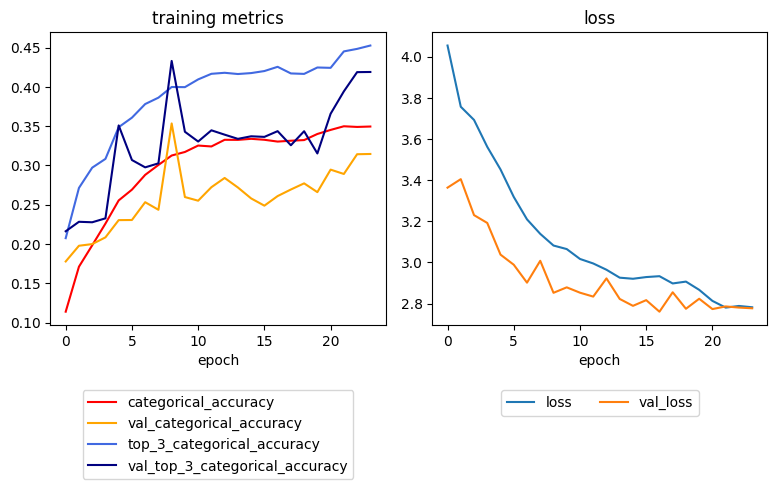

In [18]:
log = pd.read_csv(log_path)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20*cm, 15*cm))

ax1.plot(log['epoch'], log['categorical_accuracy'], label='categorical_accuracy', color='red')
ax1.plot(log['epoch'], log['val_categorical_accuracy'], label='val_categorical_accuracy', color='orange')
ax1.plot(log['epoch'], log[f'top_{top_k}_categorical_accuracy'], label=f'top_{top_k}_categorical_accuracy', color='royalblue')
ax1.plot(log['epoch'], log[f'val_top_{top_k}_categorical_accuracy'], label=f'val_top_{top_k}_categorical_accuracy', color='navy')
ax1.set_title('training metrics')
ax1.set_xlabel('epoch')
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=1)  # Legend below the plot

ax2.plot(log['epoch'], log['loss'], label='loss')
ax2.plot(log['epoch'], log['val_loss'], label='val_loss')
ax2.set_title('loss')
ax2.set_xlabel('epoch')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)  # Legend below the plot

fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.savefig(f'{checkpoint_path}/metrics_loss.svg')
plt.show()

In [19]:
# load old model, if needed
if model is None:
    model = load_model(model_path)

In [20]:
# evaluate model
score = model.evaluate(x=Generator(X_test, y_test, 128, max_sequence_length))
print(f'Test loss: {score[0]}')
print(f'Test accuracy: {score[1]}')

  1/407 ━━━━━━━━━━━━━━━━━━━━ 4:13 623ms/step - categorical_accuracy: 0.3438 - loss: 2.3819 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3438 - w_top_3_categorical_accuracy: 0.4922

  4/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.3568 - loss: 2.4376 - top_3_categorical_accuracy: 0.4749 - w_categorical_accuracy: 0.3568 - w_top_3_categorical_accuracy: 0.4749   

  7/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3614 - loss: 2.4314 - top_3_categorical_accuracy: 0.4752 - w_categorical_accuracy: 0.3614 - w_top_3_categorical_accuracy: 0.4752

 10/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3692 - loss: 2.4088 - top_3_categorical_accuracy: 0.4807 - w_categorical_accuracy: 0.3692 - w_top_3_categorical_accuracy: 0.4807

 13/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3736 - loss: 2.3982 - top_3_categorical_accuracy: 0.4836 - w_categorical_accuracy: 0.3736 - w_top_3_categorical_accuracy: 0.4836

 16/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3754 - loss: 2.3929 - top_3_categorical_accuracy: 0.4844 - w_categorical_accuracy: 0.3754 - w_top_3_categorical_accuracy: 0.4844

 19/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3765 - loss: 2.3888 - top_3_categorical_accuracy: 0.4851 - w_categorical_accuracy: 0.3765 - w_top_3_categorical_accuracy: 0.4851

 22/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3781 - loss: 2.3816 - top_3_categorical_accuracy: 0.4867 - w_categorical_accuracy: 0.3781 - w_top_3_categorical_accuracy: 0.4867

 25/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3791 - loss: 2.3775 - top_3_categorical_accuracy: 0.4878 - w_categorical_accuracy: 0.3791 - w_top_3_categorical_accuracy: 0.4878

 28/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3793 - loss: 2.3756 - top_3_categorical_accuracy: 0.4883 - w_categorical_accuracy: 0.3793 - w_top_3_categorical_accuracy: 0.4883

 31/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3796 - loss: 2.3740 - top_3_categorical_accuracy: 0.4888 - w_categorical_accuracy: 0.3796 - w_top_3_categorical_accuracy: 0.4888

 34/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3798 - loss: 2.3725 - top_3_categorical_accuracy: 0.4893 - w_categorical_accuracy: 0.3798 - w_top_3_categorical_accuracy: 0.4893

 37/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3800 - loss: 2.3711 - top_3_categorical_accuracy: 0.4897 - w_categorical_accuracy: 0.3800 - w_top_3_categorical_accuracy: 0.4897

 40/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3801 - loss: 2.3697 - top_3_categorical_accuracy: 0.4901 - w_categorical_accuracy: 0.3801 - w_top_3_categorical_accuracy: 0.4901

 43/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3803 - loss: 2.3681 - top_3_categorical_accuracy: 0.4904 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4904

 46/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3804 - loss: 2.3670 - top_3_categorical_accuracy: 0.4905 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4905

 49/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3804 - loss: 2.3665 - top_3_categorical_accuracy: 0.4904 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4904

 52/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3804 - loss: 2.3661 - top_3_categorical_accuracy: 0.4904 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4904

 55/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3804 - loss: 2.3655 - top_3_categorical_accuracy: 0.4905 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4905

 58/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3805 - loss: 2.3647 - top_3_categorical_accuracy: 0.4906 - w_categorical_accuracy: 0.3805 - w_top_3_categorical_accuracy: 0.4906

 61/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3807 - loss: 2.3639 - top_3_categorical_accuracy: 0.4908 - w_categorical_accuracy: 0.3807 - w_top_3_categorical_accuracy: 0.4908

 64/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3808 - loss: 2.3633 - top_3_categorical_accuracy: 0.4909 - w_categorical_accuracy: 0.3808 - w_top_3_categorical_accuracy: 0.4909

 67/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3808 - loss: 2.3628 - top_3_categorical_accuracy: 0.4910 - w_categorical_accuracy: 0.3808 - w_top_3_categorical_accuracy: 0.4910

 71/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3809 - loss: 2.3620 - top_3_categorical_accuracy: 0.4912 - w_categorical_accuracy: 0.3809 - w_top_3_categorical_accuracy: 0.4912

 74/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3811 - loss: 2.3613 - top_3_categorical_accuracy: 0.4914 - w_categorical_accuracy: 0.3811 - w_top_3_categorical_accuracy: 0.4914

 77/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3812 - loss: 2.3605 - top_3_categorical_accuracy: 0.4916 - w_categorical_accuracy: 0.3812 - w_top_3_categorical_accuracy: 0.4916

 80/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3813 - loss: 2.3598 - top_3_categorical_accuracy: 0.4919 - w_categorical_accuracy: 0.3813 - w_top_3_categorical_accuracy: 0.4919

 83/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3814 - loss: 2.3591 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3814 - w_top_3_categorical_accuracy: 0.4921

 87/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3815 - loss: 2.3582 - top_3_categorical_accuracy: 0.4924 - w_categorical_accuracy: 0.3815 - w_top_3_categorical_accuracy: 0.4924

 90/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3816 - loss: 2.3576 - top_3_categorical_accuracy: 0.4925 - w_categorical_accuracy: 0.3816 - w_top_3_categorical_accuracy: 0.4925

 93/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3817 - loss: 2.3571 - top_3_categorical_accuracy: 0.4927 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4927

 96/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3817 - loss: 2.3566 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4928

 99/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3817 - loss: 2.3562 - top_3_categorical_accuracy: 0.4929 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4929

102/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3558 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4930

105/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3554 - top_3_categorical_accuracy: 0.4931 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4931

108/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3552 - top_3_categorical_accuracy: 0.4931 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4931

111/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3550 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

114/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3549 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

117/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3548 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

120/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3546 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

123/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3543 - top_3_categorical_accuracy: 0.4933 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4933

126/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3541 - top_3_categorical_accuracy: 0.4933 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4933

129/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3539 - top_3_categorical_accuracy: 0.4933 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4933

132/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3538 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

135/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3818 - loss: 2.3536 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3818 - w_top_3_categorical_accuracy: 0.4932

138/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3817 - loss: 2.3535 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4932

141/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3817 - loss: 2.3534 - top_3_categorical_accuracy: 0.4931 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4931

144/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3817 - loss: 2.3534 - top_3_categorical_accuracy: 0.4931 - w_categorical_accuracy: 0.3817 - w_top_3_categorical_accuracy: 0.4931

147/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3816 - loss: 2.3533 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.3816 - w_top_3_categorical_accuracy: 0.4930

150/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3816 - loss: 2.3533 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.3816 - w_top_3_categorical_accuracy: 0.4930

153/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3816 - loss: 2.3533 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.3816 - w_top_3_categorical_accuracy: 0.4930

157/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3815 - loss: 2.3532 - top_3_categorical_accuracy: 0.4929 - w_categorical_accuracy: 0.3815 - w_top_3_categorical_accuracy: 0.4929

160/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3815 - loss: 2.3531 - top_3_categorical_accuracy: 0.4929 - w_categorical_accuracy: 0.3815 - w_top_3_categorical_accuracy: 0.4929

163/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3815 - loss: 2.3531 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.3815 - w_top_3_categorical_accuracy: 0.4928

166/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3814 - loss: 2.3531 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.3814 - w_top_3_categorical_accuracy: 0.4928

169/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3814 - loss: 2.3531 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.3814 - w_top_3_categorical_accuracy: 0.4928

172/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3813 - loss: 2.3531 - top_3_categorical_accuracy: 0.4927 - w_categorical_accuracy: 0.3813 - w_top_3_categorical_accuracy: 0.4927

175/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3813 - loss: 2.3531 - top_3_categorical_accuracy: 0.4927 - w_categorical_accuracy: 0.3813 - w_top_3_categorical_accuracy: 0.4927

178/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - categorical_accuracy: 0.3812 - loss: 2.3531 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.3812 - w_top_3_categorical_accuracy: 0.4926

181/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3812 - loss: 2.3531 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.3812 - w_top_3_categorical_accuracy: 0.4926

184/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3812 - loss: 2.3531 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.3812 - w_top_3_categorical_accuracy: 0.4926

187/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3811 - loss: 2.3531 - top_3_categorical_accuracy: 0.4925 - w_categorical_accuracy: 0.3811 - w_top_3_categorical_accuracy: 0.4925

191/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3811 - loss: 2.3531 - top_3_categorical_accuracy: 0.4925 - w_categorical_accuracy: 0.3811 - w_top_3_categorical_accuracy: 0.4925

195/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3810 - loss: 2.3532 - top_3_categorical_accuracy: 0.4925 - w_categorical_accuracy: 0.3810 - w_top_3_categorical_accuracy: 0.4925

199/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3810 - loss: 2.3532 - top_3_categorical_accuracy: 0.4924 - w_categorical_accuracy: 0.3810 - w_top_3_categorical_accuracy: 0.4924

202/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3809 - loss: 2.3532 - top_3_categorical_accuracy: 0.4924 - w_categorical_accuracy: 0.3809 - w_top_3_categorical_accuracy: 0.4924

205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3809 - loss: 2.3532 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.3809 - w_top_3_categorical_accuracy: 0.4923

208/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3809 - loss: 2.3532 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.3809 - w_top_3_categorical_accuracy: 0.4923

211/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3809 - loss: 2.3533 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.3809 - w_top_3_categorical_accuracy: 0.4923

214/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3808 - loss: 2.3533 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.3808 - w_top_3_categorical_accuracy: 0.4923

217/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3808 - loss: 2.3533 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3808 - w_top_3_categorical_accuracy: 0.4922

220/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3808 - loss: 2.3533 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3808 - w_top_3_categorical_accuracy: 0.4922

223/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3807 - loss: 2.3533 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3807 - w_top_3_categorical_accuracy: 0.4922

226/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3807 - loss: 2.3534 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3807 - w_top_3_categorical_accuracy: 0.4922

229/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3806 - loss: 2.3534 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3806 - w_top_3_categorical_accuracy: 0.4921

232/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.3806 - loss: 2.3535 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3806 - w_top_3_categorical_accuracy: 0.4921

236/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3806 - loss: 2.3535 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3806 - w_top_3_categorical_accuracy: 0.4921

239/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3805 - loss: 2.3536 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3805 - w_top_3_categorical_accuracy: 0.4921

242/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3805 - loss: 2.3537 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3805 - w_top_3_categorical_accuracy: 0.4920

245/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3805 - loss: 2.3537 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3805 - w_top_3_categorical_accuracy: 0.4920

248/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3538 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4920

251/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3539 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4920

254/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3539 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4920

257/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4920

260/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

263/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

266/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3541 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

269/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

272/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

275/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

279/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3540 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

283/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3539 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

286/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3539 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

289/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3539 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

292/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3538 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

295/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3538 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

298/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3538 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

301/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3537 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

304/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3537 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

308/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3536 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

311/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3535 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4920

314/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3535 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

317/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3534 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

320/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3534 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

323/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3533 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

326/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3533 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

329/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3532 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

332/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3532 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

336/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3531 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

339/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3531 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

342/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3531 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

346/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3531 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

349/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3530 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4921

352/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3530 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

356/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3530 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

359/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3529 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

362/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3529 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

365/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3529 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

368/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3529 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

371/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3528 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

375/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3528 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3803 - loss: 2.3528 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3803 - w_top_3_categorical_accuracy: 0.4922

381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3528 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

384/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3527 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

387/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3527 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

390/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3527 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

393/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3526 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

396/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3526 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

399/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3526 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

403/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3525 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

406/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.3804 - loss: 2.3525 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3804 - loss: 2.3525 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922

407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 19ms/step - categorical_accuracy: 0.3804 - loss: 2.3524 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.3804 - w_top_3_categorical_accuracy: 0.4922


Test loss: 2.3469252586364746
Test accuracy: 0.38117271661758423


In [21]:
# print classification report
y_pred = model.predict(x=Generator(X_test, y_test, 128, max_sequence_length))
y_pred = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

report = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan)
report_dict = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan, output_dict=True)

print(report)

# save classification report to file
with open(f'{checkpoint_path}/classification_report.txt', 'w') as f:
    json.dump(report_dict, f)

  1/407 ━━━━━━━━━━━━━━━━━━━━ 5:00 741ms/step

  5/407 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step   

  8/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 12/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 16/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 20/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 24/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 27/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 31/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 35/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 39/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 42/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 46/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 50/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 53/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 56/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 59/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 61/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 65/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 69/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 72/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 75/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 79/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 83/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 87/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 91/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 94/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 98/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

102/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

106/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

110/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

114/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

118/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

122/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

126/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

130/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

134/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

138/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

142/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

146/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

150/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

154/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

158/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

162/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

165/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

169/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

173/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

177/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

180/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

184/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

188/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

192/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

196/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

200/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

203/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

206/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

210/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

214/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

218/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

222/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

225/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

229/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

233/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

237/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

241/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

245/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

249/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

253/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

256/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

260/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

264/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

268/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

272/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

276/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

280/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

284/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

288/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

292/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

296/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

300/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

303/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

307/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

311/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

315/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

319/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

322/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

326/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

331/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

335/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

339/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

342/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

346/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

350/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

353/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

357/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

361/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

369/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

373/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

377/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

386/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

390/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

393/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

396/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

400/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

403/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step


                 precision    recall  f1-score   support

      adjkerntz       0.00      0.00      0.00        11
         alpine       0.81      0.84      0.82       560
          anvil       0.27      0.17      0.21       378
          atrun        nan      0.00      0.00       237
            awk       0.00      0.00      0.00         5
       basename       0.00      0.00      0.00         2
           bash        nan      0.00      0.00     12512
            cat        nan      0.00      0.00        26
        cleanup       0.34      0.47      0.40       276
            cmp        nan      0.00      0.00         5
             cp        nan      0.00      0.00        30
           cron       0.24      1.00      0.39       624
           date       0.14      1.00      0.25      1218
             dd       0.00      0.00      0.00       125
       dhclient       0.00      0.18      0.00        17
          dmesg       0.00      0.00      0.00        15
          egrep        nan    

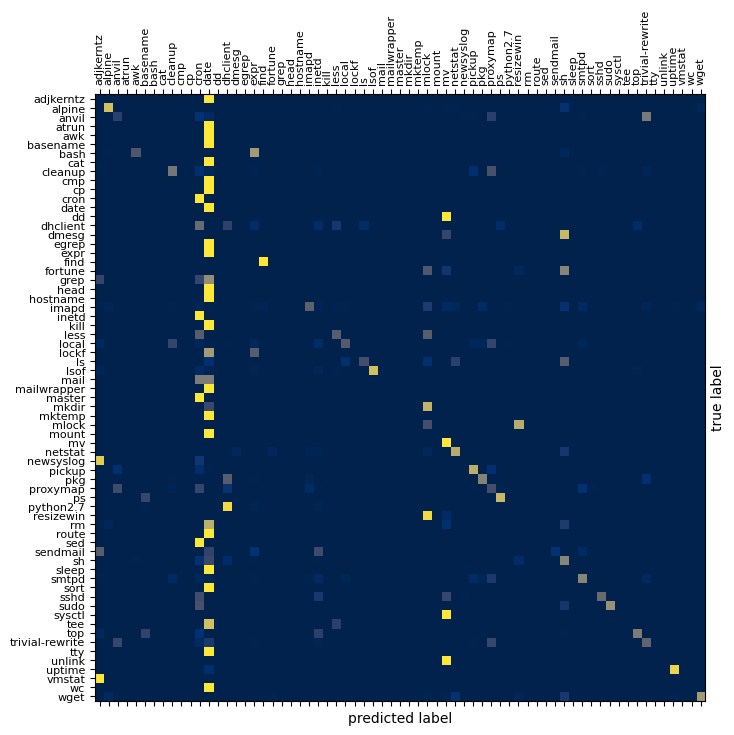

In [22]:
# print confusion matrix
# labels explicitly set, because current model may not predict all labels
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(labels_cardinality), normalize='true')

# Replace all NaN values with 0
conf_matrix = np.nan_to_num(conf_matrix)

# Verify the distinct labels align correctly
distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(20*cm, 20*cm))

ax.matshow(conf_matrix, cmap='cividis', aspect='auto')

# Set class names on axes
ax.set_xticks(range(len(distinct_labels)))
ax.set_yticks(range(len(distinct_labels)))
ax.set_xticklabels(distinct_labels, rotation=90, fontsize=8)
ax.set_yticklabels(distinct_labels, fontsize=8)

# Set axis labels "predicted" and "actual"
ax.set_xlabel('predicted label')
ax.set_ylabel('true label')
# y-axis label right side
ax.yaxis.set_label_position('right')

# set figsize
plt.savefig(f'{checkpoint_path}/confusion_matrix.svg')
plt.show()

In [23]:
unique_in_y_pred = [ labels_map[i] for i in np.unique(y_pred) ]
#print("Unique labels in y_pred:", unique_in_y_pred)

unique_not_in_y_pred = [ label for label in distinct_labels if label not in unique_in_y_pred ]
print("Unique labels not in y_pred:", unique_not_in_y_pred)

Unique labels not in y_pred: ['atrun', 'bash', 'cat', 'cmp', 'cp', 'egrep', 'grep', 'head', 'hostname', 'kill', 'lockf', 'mail', 'mailwrapper', 'mkdir', 'mktemp', 'mount', 'route', 'sysctl', 'tty', 'wc']
